In [1]:
import numpy as np
import matplotlib.pyplot as plt
import natsort, glob, h5py
from scipy.optimize import curve_fit
import scipy.signal
import pickle
from matplotlib import cm

In [2]:
from IPython.core.display import display, HTML
display(HTML("<style>.container { width:95% !important; }</style>"))
# changing the display so that the cells fill the whole window

In [3]:
def gauss_fun(x, A, mu, sig):
    return A * np.exp( -(x-mu)**2/(2*sig**2) )

def lin_fun(x, m, x1):
    return m*(x-x1)

def lin_fun_const(x, m):
    return lin_fun(x,m,0)

In [4]:
def rebin_histogram(bins, counts, new_bin_size):
    """Rebin a histogram to a new bin size.
    Parameters:
        bins (np.ndarray): The bin edges of the histogram.
        counts (np.ndarray): The number of counts in each bin.
        new_bin_size (float): The size of the new bins.
    Returns:
        np.ndarray: The new bin edges.
        np.ndarray: The new bin counts.
    """
    # Find the new number of bins
    new_nbins = int((bins[-1] - bins[0]) / new_bin_size)
    # Create the new bin edges
    new_bins = np.linspace(bins[0], bins[-1], new_nbins + 1)
    # Digitize the original bins into the new bins
    digitized_bins = np.digitize(bins, new_bins)
    # Calculate the new counts
    new_counts = np.array([counts[digitized_bins == i].sum() for i in range(1, new_nbins + 1)])

    new_centers = new_bins[:-1] + np.diff(new_bins)/2
    return new_centers, new_counts

In [5]:
def peak_fit_srs10(x_data, y_data, voltage, min_distance=20, max_peaks=5, min_thresh=10, peak_range=500):
    # Find the peaks in the spectrum using the find_peaks function from scipy.signal
    
    peaks_index, _ = scipy.signal.find_peaks(y_data, distance=min_distance)
    
    # Fit each peak with a Gaussian function using the curve_fit function from scipy
    gain_info = [] # parameters to fit the gain
    peak_params = [] # parameters to plot the gaussian
    peak_number = 1 # corresponds to single photoelectron peak
    peaks = [] # list of where all the peaks are that are used in the fits
    peak_cuts = []
    for peak in peaks_index:
        if peak_number > max_peaks: # stopping the loop after we have reached the max number of peaks
            break

        if peak < min_thresh:
            continue
        
        peaks.append(np.array([x_data[peak], y_data[peak]]))
        
        # initial guess for the Gaussian parameters
        amplitude_guess = y_data[peak]
        mean_guess = x_data[peak]
        standard_deviation_guess = 10
        initial_guess = [amplitude_guess, mean_guess, standard_deviation_guess]
        
        # cutting data around each peak
        if peak_number == 1: # trying to not include the pedestal for the first peak
            cut = (x_data < (x_data[peak] + peak_range)) & (x_data > (x_data[peak] - 40))
        else:
            cut = (x_data < (x_data[peak] + peak_range)) & (x_data > (x_data[peak] - peak_range))
        peak_x = x_data[cut] # x values of peak for fitting
        peak_y = y_data[cut] # y values of peak for fitting
        peak_cuts.append([peak_x, peak_y])
        
#         plt.yscale('log')
#         plt.plot(x_data[cut], y_data[cut], alpha=0.5)
        
        # Perform the curve fitting
        try:
            # trying to fit the peaks
            params, params_covariance = curve_fit(gauss_fun, peak_x, peak_y, p0=initial_guess)
            # params are returned as amplitude, mean, std dev
            print('Guess: ', initial_guess)
            print('Params: ', params)
            peak_params.append(params)
            gain_info.append([peak_number, params[1], np.sqrt(params_covariance[1,1])]) # peak number, mean, and covariance
        except RuntimeError as r:
            # if curve fit doesn't work then we will just use the peak amplitude and center that find_peaks found
            print('fit failed')
            params = initial_guess
            peak_params.append(initial_guess)
            gain_info.append([peak, mean_guess, np.nan])
#             xx = np.linspace( x_data[peak] - 2*standard_deviation_guess, x_data[peak] + 2*standard_deviation_guess, 100 )
        
        peak_number += 1 # (goes to n*spe until it reaches max_peak)
        
    plt.show()
    return np.array(peak_params), np.array(gain_info), np.array(peaks), peak_cuts

In [6]:
def gain_fit_const(pe_locations):
    # fitting a line of the peak centers and heights to get the slope (gain) with dc offset correction already applied
    fpts = ~np.isnan(pe_locations[:,1])
    if(np.sum(fpts) < 3):
        return
    # fitting the peak locations to a line to find the gain (slope)
    gain_bp, gain_bc = curve_fit(lin_fun_const, pe_locations[fpts, 0], pe_locations[fpts, 1])

    x = pe_locations[fpts, 0]
    
    return x, gain_bp, gain_bc

# def find_bv(g_vs_v, wavelength):
#     # finding the breakdown voltage using fitted gain data of a certain wavelength (310, 405, or source)
#     data_to_use = np.asarray(g_vs_v[wavelength])
    
#     # fitting the curve 
#     bv_params, bv_cov = curve_fit(lin_fun, data_to_use[:, 0], data_to_use[:, 1], sigma=data_to_use[:, 2])
    
#     return bv_params, bv_cov

## pare this down since we have already done a lot of the work in the dc offset notebook

In [7]:
def plot_fit_gain(pe, counts, gain, volts, file_type, peak_dist, SRS_gain, dc):
    # doing the gain calculations and plotting the results (hopefully store this in a separate script at some point)
    gain_vs_volts = {}
    
    if (SRS_gain == 10):
    # setting the peak range for low gain data
        if volts < 31.5 and volts >=30.5:
            peak_range = 45 # picking a smaller range of values to fit over for the lower OV files
        elif volts < 30.5:
            print('low voltage range')
            peak_range = 25
        else:
            peak_range = 55 
    
    b = pe
    c = counts
    
    # taking into account dc offset
    b += dc
    
    # getting the peak and fit info
    if file_type == 'source':
        peak_info, pe_locs, peaks, data_for_fits = peak_fit_srs10(b, c, volts, min_distance=peak_dist*25/100, min_thresh=17, peak_range=peak_range)
    elif file_type == 405.0:
        peak_info, pe_locs, peaks, data_for_fits = peak_fit_srs10(b, c, volts, min_distance=peak_dist*25/100, min_thresh=17, peak_range=peak_range, max_peaks=4)
    elif file_type == 310.0:
        peak_info, pe_locs, peaks, data_for_fits = peak_fit_srs10(b, c, volts, min_distance=peak_dist*25/100, min_thresh=17, peak_range=peak_range, max_peaks=3)
    
    # starting the plots
    plt.figure(figsize=(18,6))
    
    # calculating and plotting the gain 
    plt.subplot(1,2,2)
    plt.errorbar( pe_locs[:,0], pe_locs[:,1], yerr=pe_locs[:,2], fmt='ko' )

    xx, gain_params, gain_cov = gain_fit_const(pe_locs)
    gain_error = np.sqrt(np.diag(gain_cov))[0]
    plt.plot(xx, lin_fun_const(xx, *gain_params), 'r', label=r'Gain: %.2f $\pm$ %.2f'%(gain_params[0], gain_error))  #(str(np.round(popt_temp[0],2)))+'$\pm$'+str(np.round(np.sqrt(np.diag(pcov_temp))[0],2))+' ADC/PE'
    plt.legend()

    calibration_factor = 1/gain_params[0] # setting the first pe to be the fitted gain
    
    # plotting the calibrated peaks
    plt.subplot(1,2,1)
    plt.grid()
    plt.ylim(0.1, 8000)
    plt.yscale('log')
#     plt.ylim(0.1, np.max(mca_hist)*2)
    plt.xlim(0.1, 1000*calibration_factor)
    plt.xticks(np.arange(0, 9, 1))
    
    b = b*calibration_factor
    peaks[:,0] = peaks[:,0]*calibration_factor
    plt.plot(b, c, 'k')
    plt.plot(peaks[:,0], peaks[:,1], 'o', color='r')
    for fit_params, data_peaks in zip(peak_info, data_for_fits):
        fit_params[1] = fit_params[1]*calibration_factor
        fit_params[2] = fit_params[2]*calibration_factor
        plt.plot(b, gauss_fun(b, *fit_params))
        data_peaks[0] = data_peaks[0]*calibration_factor
        plt.plot(data_peaks[0], data_peaks[1])
    plt.show()
    print(gain_error)
    return gain_params[0], gain_error

In [7]:
with open('data_for_pde.pkl', 'rb') as f: # loading the pde data with the dc offset info
    data = pickle.load(f)

data_NO_FIELD = data[0]
data_POS_FIELD = data[1]
data_NEG_FIELD = data[2]
time_NO_FIELD = data[3]
time_POS_FIELD = data[4]
time_NEG_FIELD = data[5]
offset_means = data[6]

with open('data_for_pde_gain5.pkl', 'rb') as f:
    data_NO_FIELD_srs5 = pickle.load(f)

Guess:  [1570, 203.93707550382175, 10]
Params:  [1515.66283455  203.33506091   24.07303356]
Guess:  [723, 293.95355902030525, 10]
Params:  [640.22310438 296.81610633  30.84700752]
Guess:  [398, 403.97370554045176, 10]
Params:  [377.53631459 396.18447759  29.46944338]
Guess:  [233, 483.98835755510373, 10]
Params:  [215.52667949 488.89014908  37.32235945]
Guess:  [154, 584.0066725734189, 10]
Params:  [147.43912239 589.04097788  33.59865484]


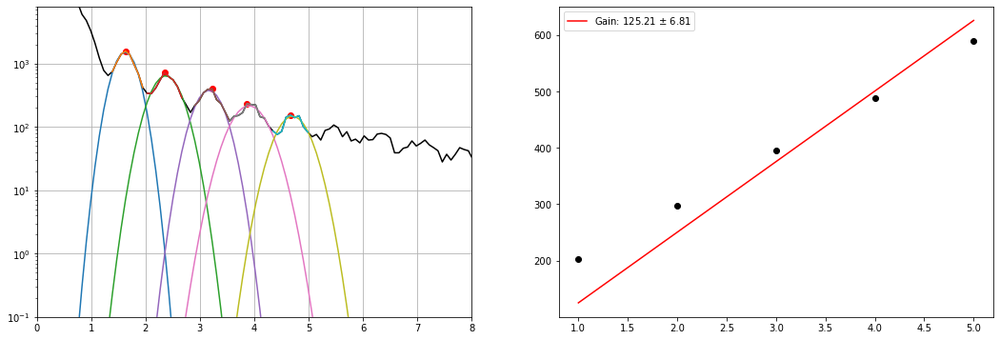

6.806105479198687
Guess:  [1547, 203.93707550382175, 10]
Params:  [1473.75713083  202.30616862   24.98635408]
Guess:  [709, 293.95355902030525, 10]
Params:  [674.7143445  296.03491326  29.49656733]
Guess:  [378, 393.97187403862023, 10]
Params:  [377.31495206 392.9167811   30.37515926]
Guess:  [228, 493.99018905693526, 10]
Params:  [224.8425258  490.57989767  32.85404413]
Guess:  [153, 594.0085040752504, 10]
Params:  [151.83708384 589.92796358  32.98877771]


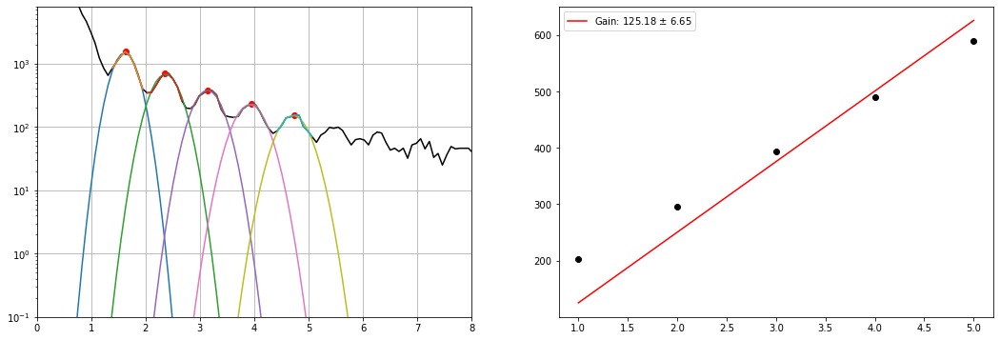

6.6515222316212235
Guess:  [1403, 203.93707550382175, 10]
Params:  [1350.54733889  203.03297295   26.14277465]
Guess:  [641, 303.9553905221367, 10]
Params:  [628.5619625  298.28064534  29.13377888]
Guess:  [375, 393.97187403862023, 10]
Params:  [365.79642309 395.31920099  29.98969026]
Guess:  [220, 503.9920205587668, 10]
Params:  [208.2759199  492.21031549  36.36976148]
Guess:  [158, 584.0066725734189, 10]
Params:  [140.32947668 589.11495457  34.98459156]


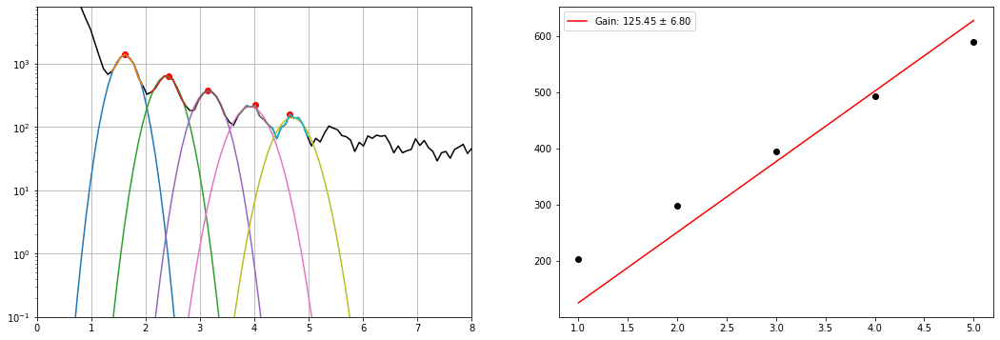

6.799103145751645
Guess:  [1540, 203.93707550382175, 10]
Params:  [1491.47592681  203.33622547   23.60254305]
Guess:  [670, 293.95355902030525, 10]
Params:  [646.36114632 296.59963227  30.92242376]
Guess:  [363, 393.97187403862023, 10]
Params:  [351.79010184 394.62818148  30.63272967]
Guess:  [243, 483.98835755510373, 10]
Params:  [219.01029651 490.02429066  35.00668619]
Guess:  [146, 584.0066725734189, 10]
Params:  [139.49002554 592.92877132  42.39363552]


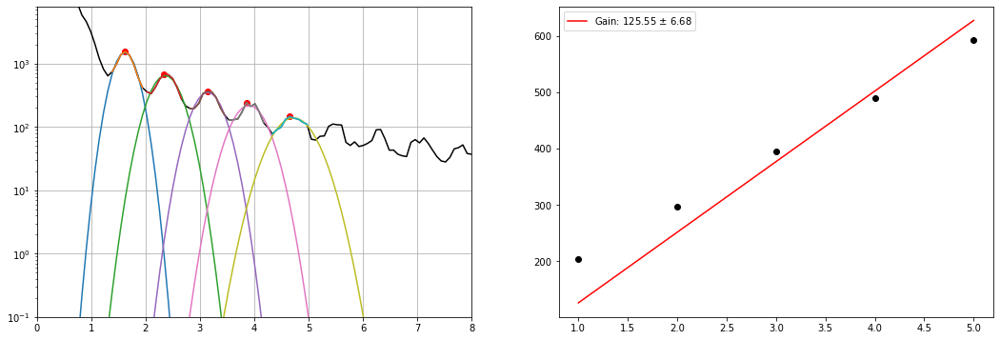

6.675904447670413
Guess:  [1442, 203.93707550382175, 10]
Params:  [1400.67588171  203.14708111   24.75505909]
Guess:  [693, 293.95355902030525, 10]
Params:  [663.94142977 297.35616422  30.11071526]
Guess:  [397, 403.97370554045176, 10]
Params:  [373.23459256 397.15179581  28.84567395]
Guess:  [260, 493.99018905693526, 10]
Params:  [220.81182661 492.6666657   32.16858424]
Guess:  [162, 594.0085040752504, 10]
Params:  [144.63999486 589.45140995  35.06059872]


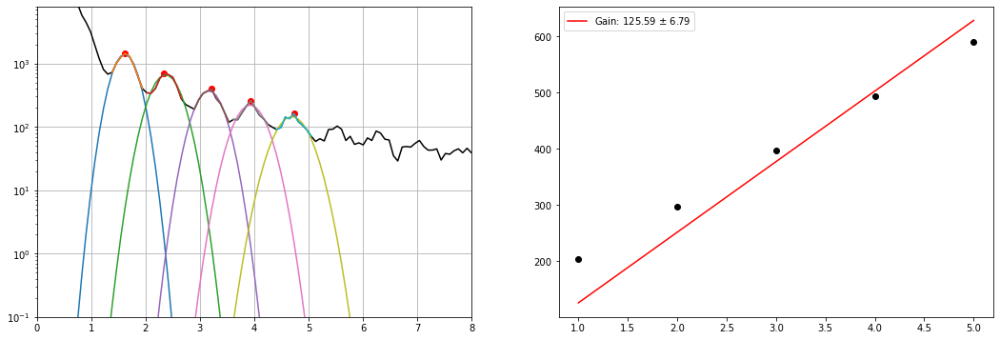

6.788646214257629
Guess:  [1557, 203.93707550382175, 10]
Params:  [1497.21303711  203.16630234   23.98320868]
Guess:  [706, 293.95355902030525, 10]
Params:  [667.07107163 297.51833655  29.59611113]
Guess:  [398, 403.97370554045176, 10]
Params:  [374.72223529 396.43840988  28.54608404]
Guess:  [219, 483.98835755510373, 10]
Params:  [213.58356455 488.76374103  36.92369833]
Guess:  [143, 594.0085040752504, 10]
Params:  [140.35787547 587.31632298  40.21432602]


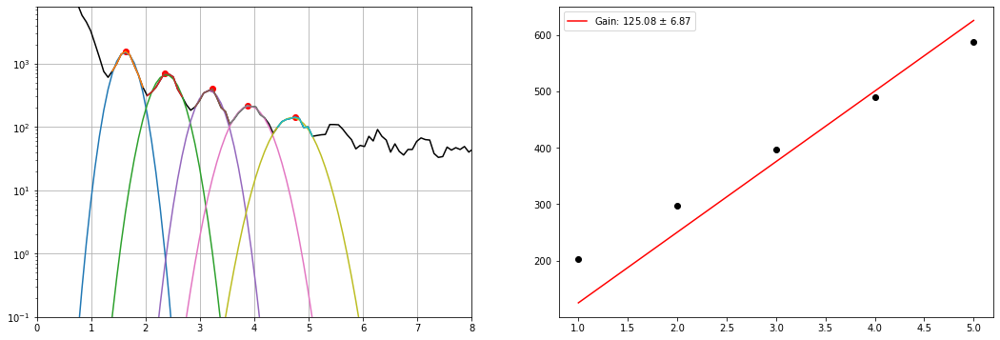

6.866773662698062
Guess:  [1570, 203.93707550382175, 10]
Params:  [1551.39358622  202.22167837   22.46778306]
Guess:  [680, 293.95355902030525, 10]
Params:  [666.93610541 296.08298488  27.96450435]
Guess:  [389, 393.97187403862023, 10]
Params:  [368.30320875 393.69876478  28.74186041]
Guess:  [254, 493.99018905693526, 10]
Params:  [239.87579449 490.92919831  30.4131604 ]
Guess:  [163, 584.0066725734189, 10]
Params:  [148.74409413 583.35218532  33.96009817]


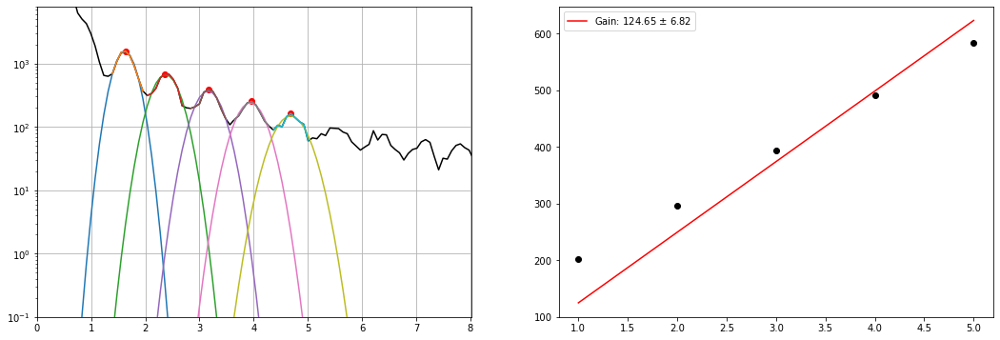

6.824655394563765
Guess:  [1466, 203.93707550382175, 10]
Params:  [1437.28128822  202.15033378   22.83865136]
Guess:  [685, 303.9553905221367, 10]
Params:  [664.32991769 298.60187398  25.72265367]
Guess:  [397, 393.97187403862023, 10]
Params:  [372.46299327 394.41141577  28.15196424]
Guess:  [240, 493.99018905693526, 10]
Params:  [214.04342753 492.56427353  29.97612481]
Guess:  [162, 594.0085040752504, 10]
Params:  [154.06369605 591.46643191  29.57074154]


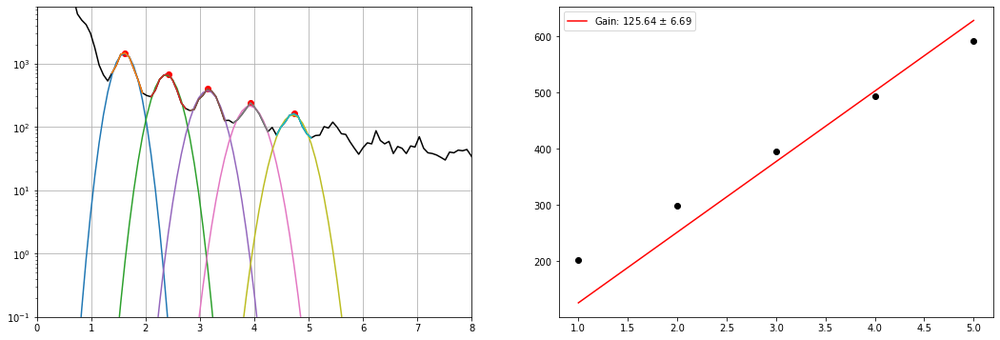

6.6907025601602115
Guess:  [1412, 203.93707550382175, 10]
Params:  [1392.07333409  202.32191428   26.63696492]
Guess:  [654, 293.95355902030525, 10]
Params:  [626.89823785 298.04697921  32.56710953]
Guess:  [405, 403.97370554045176, 10]
Params:  [372.40280956 397.15648375  29.47680174]
Guess:  [246, 493.99018905693526, 10]
Params:  [222.38124741 493.66486648  32.39337822]
Guess:  [156, 604.0103355770818, 10]
Params:  [138.4343681  592.58848024  39.91581171]


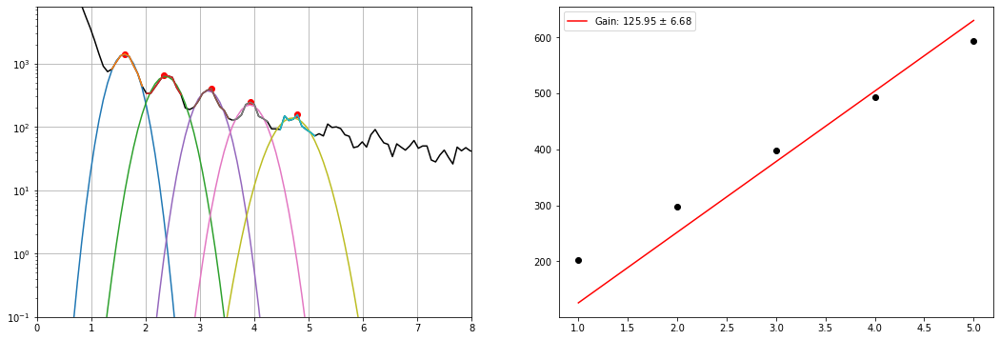

6.680586460021497
Guess:  [1511, 203.93707550382175, 10]
Params:  [1458.38253757  203.09282489   24.44300571]
Guess:  [680, 303.9553905221367, 10]
Params:  [671.47231962 299.30412653  28.54886003]
Guess:  [392, 393.97187403862023, 10]
Params:  [361.85661459 395.55212021  32.40447734]
Guess:  [253, 493.99018905693526, 10]
Params:  [241.41674128 492.24757353  27.99135044]
Guess:  [150, 584.0066725734189, 10]
Params:  [137.7224703  588.75813154  41.71897012]


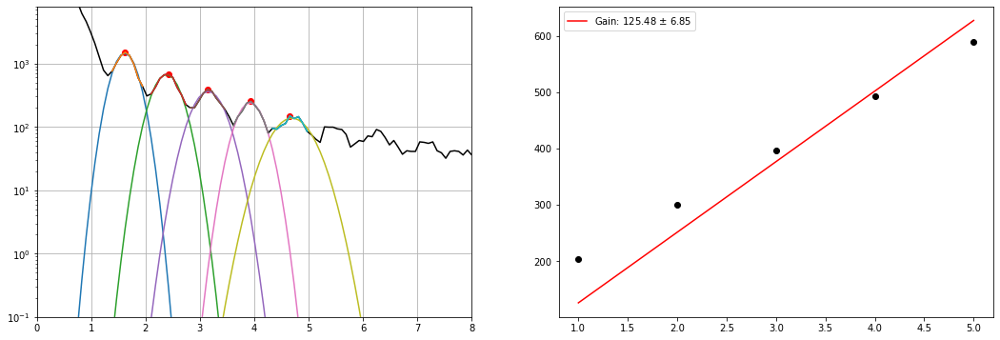

6.846673649717984
Guess:  [1512, 203.93707550382175, 10]
Params:  [1515.56321546  202.29698168   23.14418247]
Guess:  [689, 303.9553905221367, 10]
Params:  [687.15574597 298.09583404  26.63231935]
Guess:  [407, 393.97187403862023, 10]
Params:  [398.19471756 393.0001095   27.44724089]
Guess:  [236, 483.98835755510373, 10]
Params:  [227.25461391 487.35636389  33.96904884]
Guess:  [153, 584.0066725734189, 10]
Params:  [150.62107299 585.25483669  31.37315409]


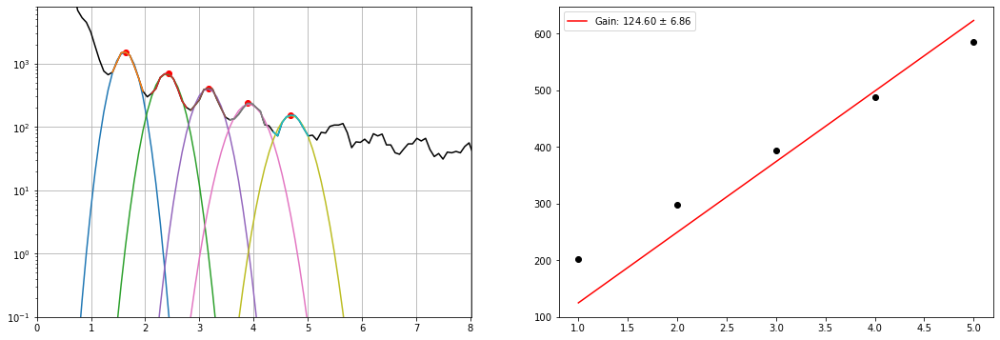

6.8566246270539715
Guess:  [1487, 203.93707550382175, 10]
Params:  [1487.79082214  201.59930828   23.92913705]
Guess:  [714, 293.95355902030525, 10]
Params:  [685.91694389 296.44808124  27.65796906]
Guess:  [438, 393.97187403862023, 10]
Params:  [388.71448575 394.24829973  28.17894756]
Guess:  [253, 493.99018905693526, 10]
Params:  [227.54448017 492.12063533  31.63524922]
Guess:  [154, 594.0085040752504, 10]
Params:  [142.07845249 590.24180273  36.02709378]


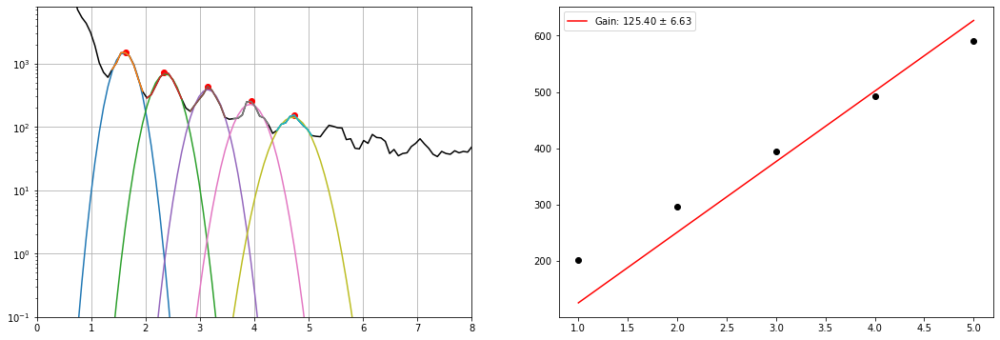

6.625311760550836
Guess:  [1527, 203.93707550382175, 10]
Params:  [1469.78443536  203.00470668   23.0983586 ]
Guess:  [651, 303.9553905221367, 10]
Params:  [650.98038046 299.33424052  27.20008377]
Guess:  [375, 393.97187403862023, 10]
Params:  [358.09239151 393.89634922  29.55124942]
Guess:  [227, 483.98835755510373, 10]
Params:  [219.88146981 491.5719774   35.09210157]
Guess:  [170, 594.0085040752504, 10]
Params:  [142.38475363 591.40465746  32.06314373]


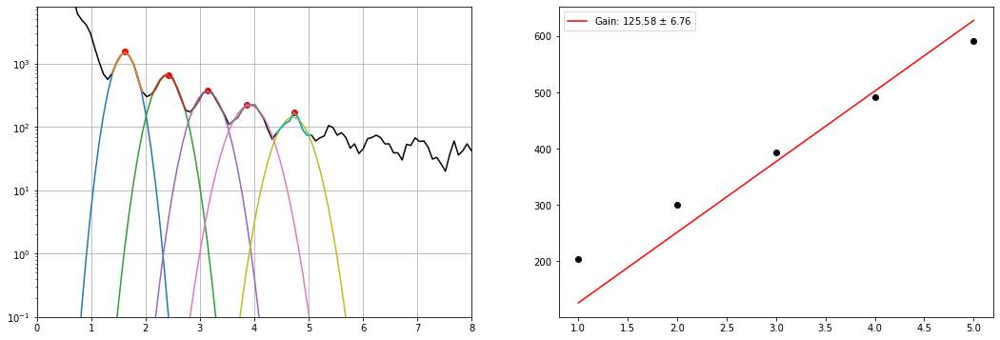

6.761223667503232
Guess:  [1495, 203.93707550382175, 10]
Params:  [1416.20841473  202.48254843   24.28873106]
Guess:  [693, 303.9553905221367, 10]
Params:  [666.31973526 298.69910694  26.61946734]
Guess:  [389, 393.97187403862023, 10]
Params:  [372.37373933 394.15561244  29.55040818]
Guess:  [234, 483.98835755510373, 10]
Params:  [221.25469033 489.20616113  35.51275629]
Guess:  [163, 594.0085040752504, 10]
Params:  [146.40000809 591.65703874  32.57930664]


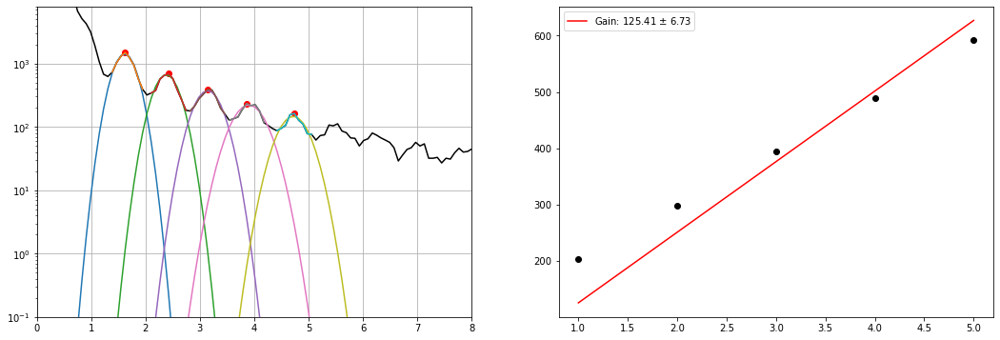

6.728898361085821
Guess:  [1463, 203.93707550382175, 10]
Params:  [1445.97498027  202.54026521   25.07194229]
Guess:  [671, 303.9553905221367, 10]
Params:  [655.28110351 298.96875467  27.30919132]
Guess:  [352, 393.97187403862023, 10]
Params:  [345.0416456  394.15170492  32.59537146]
Guess:  [268, 493.99018905693526, 10]
Params:  [232.72068191 494.27139544  29.52881983]
Guess:  [147, 594.0085040752504, 10]
Params:  [134.64851353 588.36523056  42.48461648]


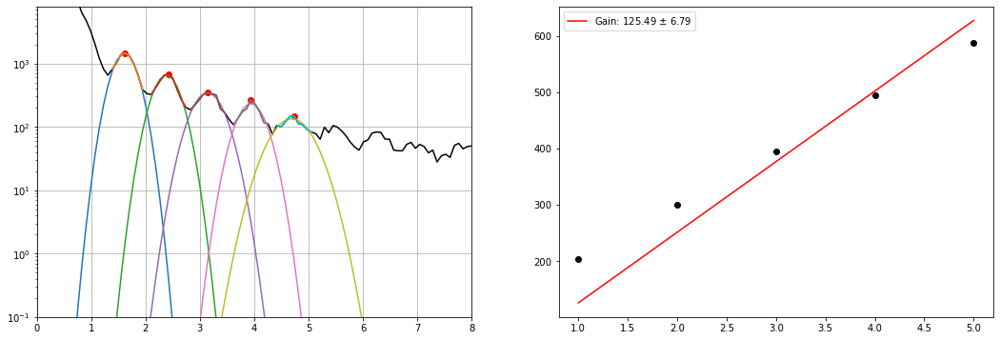

6.78870729875768
Guess:  [1513, 203.93707550382175, 10]
Params:  [1427.05059315  203.11752822   24.5564241 ]
Guess:  [679, 293.95355902030525, 10]
Params:  [637.14461442 296.86841248  30.64856569]
Guess:  [364, 403.97370554045176, 10]
Params:  [353.89057287 395.3244518   30.88236804]
Guess:  [244, 493.99018905693526, 10]
Params:  [223.82298782 490.15823907  32.34855264]
Guess:  [160, 594.0085040752504, 10]
Params:  [152.90694455 588.02472388  33.10697879]


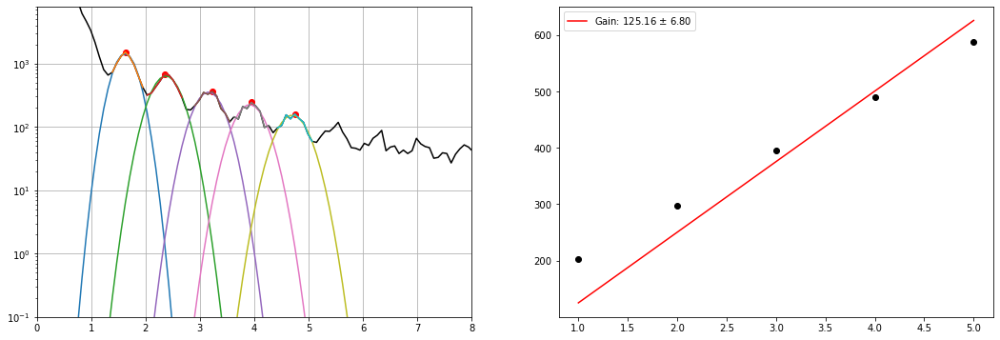

6.8006587252497654
Guess:  [1419, 203.93707550382175, 10]
Params:  [1386.08678022  203.28842436   25.34743623]
Guess:  [748, 293.95355902030525, 10]
Params:  [668.68839565 297.18954931  28.08534434]
Guess:  [401, 403.97370554045176, 10]
Params:  [352.32547819 397.48404943  31.46854083]
Guess:  [216, 493.99018905693526, 10]
Params:  [211.4637056  489.78121195  32.72860465]
Guess:  [150, 584.0066725734189, 10]
Params:  [141.87631866 585.56814631  34.14051051]


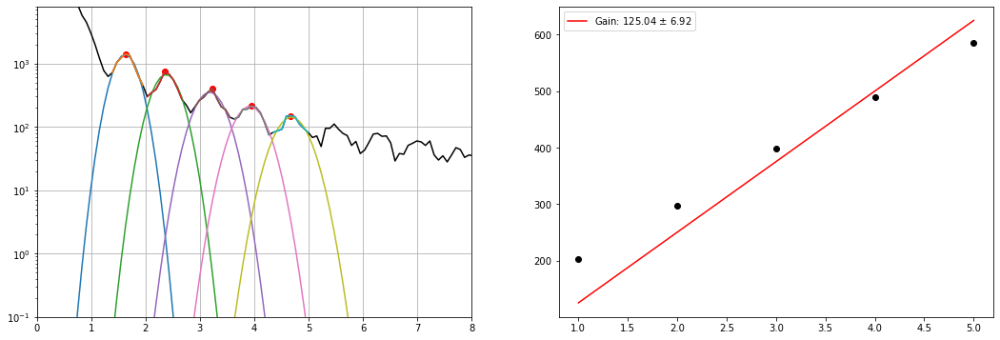

6.915292387366787
Guess:  [1630, 203.93707550382175, 10]
Params:  [1491.73303746  202.06447261   23.5202045 ]
Guess:  [762, 293.95355902030525, 10]
Params:  [707.63662647 296.96963834  26.95501634]
Guess:  [409, 393.97187403862023, 10]
Params:  [387.77264518 395.34317175  29.51143731]
Guess:  [247, 493.99018905693526, 10]
Params:  [228.02696636 490.99054331  29.53681143]
Guess:  [180, 594.0085040752504, 10]
Params:  [157.31452846 587.13173424  31.95961877]


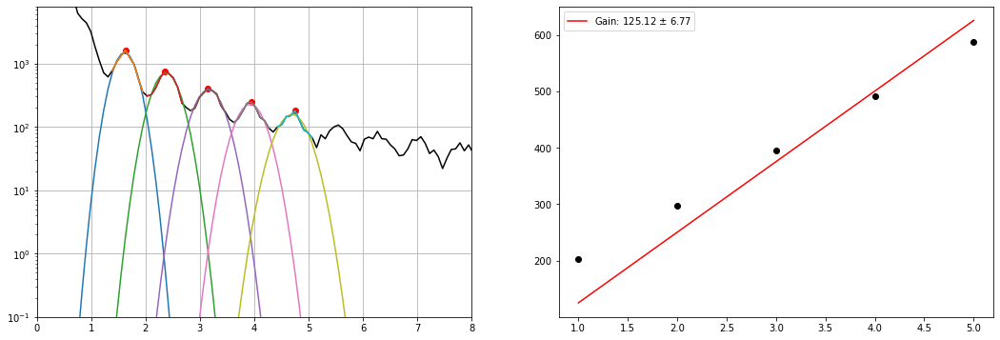

6.7666613504573645
Guess:  [1516, 203.93707550382175, 10]
Params:  [1494.77459296  202.69227995   24.10132665]
Guess:  [694, 293.95355902030525, 10]
Params:  [660.61268675 297.47597752  29.92589162]
Guess:  [380, 393.97187403862023, 10]
Params:  [354.33379164 393.59490348  31.54616275]
Guess:  [241, 493.99018905693526, 10]
Params:  [230.9989643  494.09350633  31.47560987]
Guess:  [154, 594.0085040752504, 10]
Params:  [149.66858121 586.3089214   33.36653906]


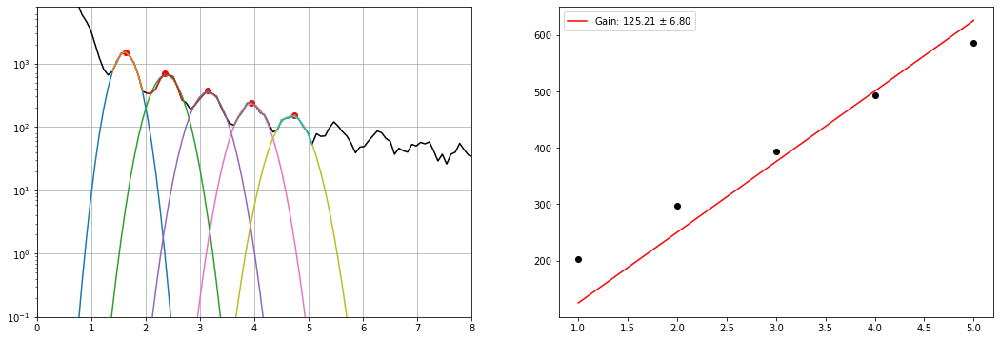

6.797517649916766
Guess:  [1516, 203.93707550382175, 10]
Params:  [1496.44549655  202.35429343   23.86931653]
Guess:  [715, 293.95355902030525, 10]
Params:  [692.52578575 297.2737992   26.64811218]
Guess:  [390, 393.97187403862023, 10]
Params:  [370.51991844 394.60098303  30.45833095]
Guess:  [230, 493.99018905693526, 10]
Params:  [222.44660377 490.61152748  33.06933112]
Guess:  [146, 594.0085040752504, 10]
Params:  [142.34253612 588.90643073  34.29763458]


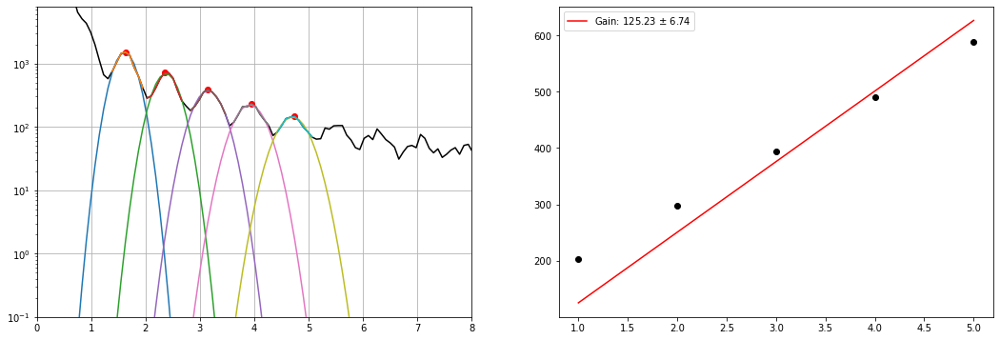

6.738849927775508
Guess:  [1611, 203.93707550382175, 10]
Params:  [1545.25974028  202.01098816   22.99638667]
Guess:  [700, 303.9553905221367, 10]
Params:  [677.76612651 297.90227288  26.40185707]
Guess:  [405, 393.97187403862023, 10]
Params:  [376.22515721 393.26705845  28.94699287]
Guess:  [272, 493.99018905693526, 10]
Params:  [237.411704   493.32640954  30.86163064]
Guess:  [169, 594.0085040752504, 10]
Params:  [154.83169758 589.49003118  30.68505055]


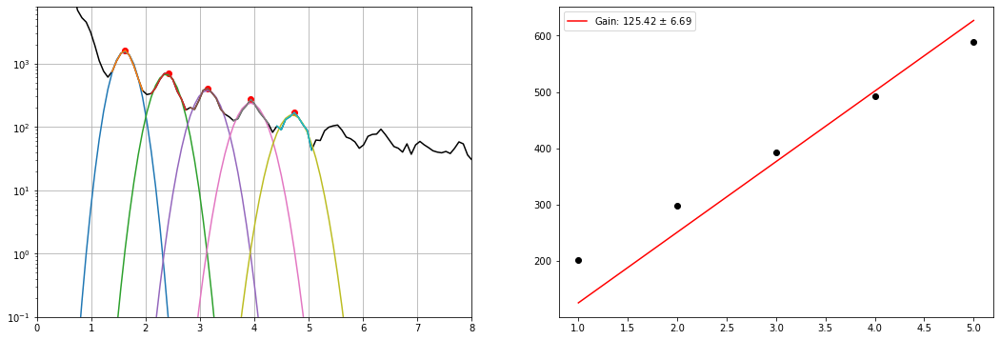

6.692793935580503
Guess:  [1542, 203.93707550382175, 10]
Params:  [1499.17293741  202.26718465   23.27869731]
Guess:  [677, 293.95355902030525, 10]
Params:  [658.61833455 297.35781898  27.68978423]
Guess:  [368, 393.97187403862023, 10]
Params:  [356.55196845 393.40656632  30.18719263]
Guess:  [229, 493.99018905693526, 10]
Params:  [228.26035088 491.22296254  31.14991512]
Guess:  [160, 604.0103355770818, 10]
Params:  [147.4683943  589.89989476  35.89161839]


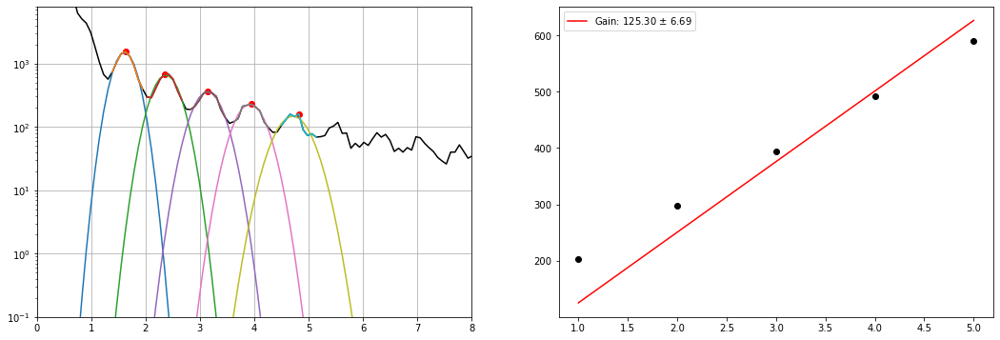

6.693222433350814
Guess:  [1579, 203.93707550382175, 10]
Params:  [1535.2973658   202.80857291   23.21852328]
Guess:  [760, 293.95355902030525, 10]
Params:  [691.1470947  296.69830823  27.51780362]
Guess:  [413, 403.97370554045176, 10]
Params:  [376.58171524 395.07765417  30.08268149]
Guess:  [276, 493.99018905693526, 10]
Params:  [243.9031658  491.81673954  30.61955173]
Guess:  [172, 594.0085040752504, 10]
Params:  [155.05681112 588.87267191  30.65049667]


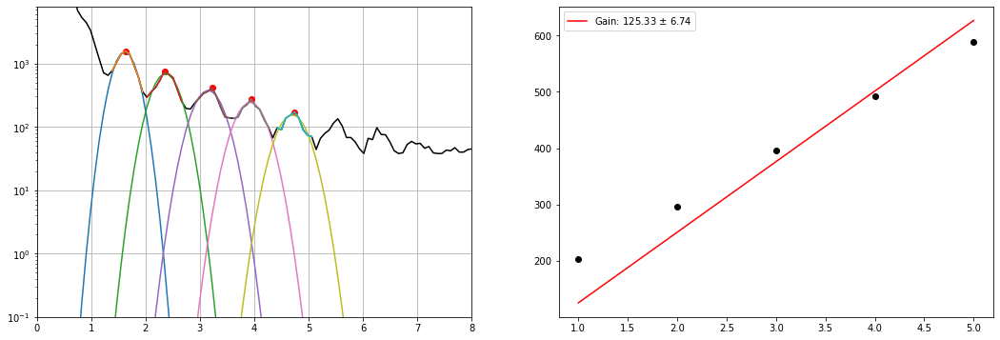

6.743425051767313
Guess:  [1557, 203.93707550382175, 10]
Params:  [1494.56059817  202.5833932    23.27523546]
Guess:  [707, 303.9553905221367, 10]
Params:  [699.09688802 299.15282642  26.68591281]
Guess:  [397, 393.97187403862023, 10]
Params:  [369.09861099 394.2106077   29.74027173]
Guess:  [255, 493.99018905693526, 10]
Params:  [242.12347556 493.98828411  29.64677877]
Guess:  [157, 594.0085040752504, 10]
Params:  [148.06816992 588.16084373  37.49320598]


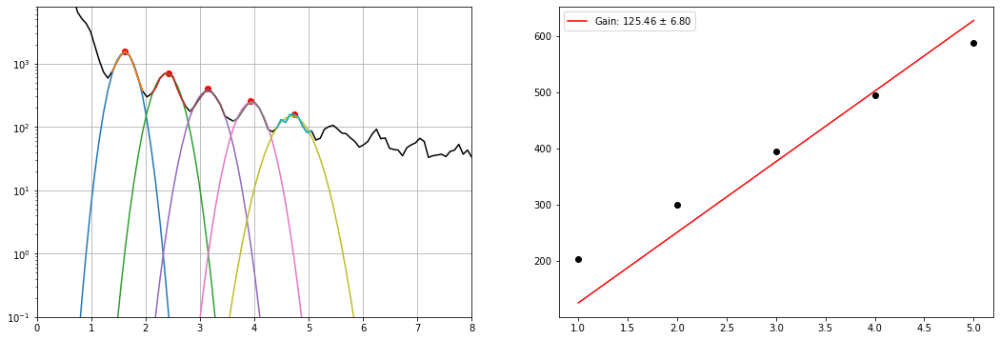

6.8043692169973315
Guess:  [1599, 203.93707550382175, 10]
Params:  [1570.92093458  202.24027432   22.20057356]
Guess:  [697, 293.95355902030525, 10]
Params:  [672.51862844 296.52980206  27.1586286 ]
Guess:  [417, 393.97187403862023, 10]
Params:  [388.26708633 393.53110764  28.90232318]
Guess:  [234, 503.9920205587668, 10]
Params:  [227.73528241 494.49667775  31.37123375]
Guess:  [149, 594.0085040752504, 10]
Params:  [136.32003969 592.96369947  34.16429886]


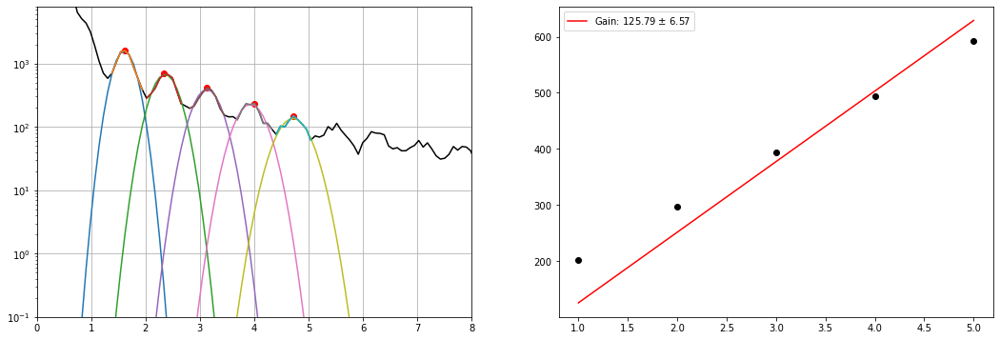

6.5700340448888195
Guess:  [1519, 203.93707550382175, 10]
Params:  [1476.22668869  202.13581558   23.30338414]
Guess:  [701, 303.9553905221367, 10]
Params:  [688.48342023 299.70596499  26.21518184]
Guess:  [390, 383.97004253678875, 10]
Params:  [358.76960223 389.78103701  35.70872532]
Guess:  [202, 493.99018905693526, 10]
Params:  [197.17170811 492.48024301  35.43196586]
Guess:  [162, 584.0066725734189, 10]
Params:  [142.45414829 585.88829101  38.65444942]


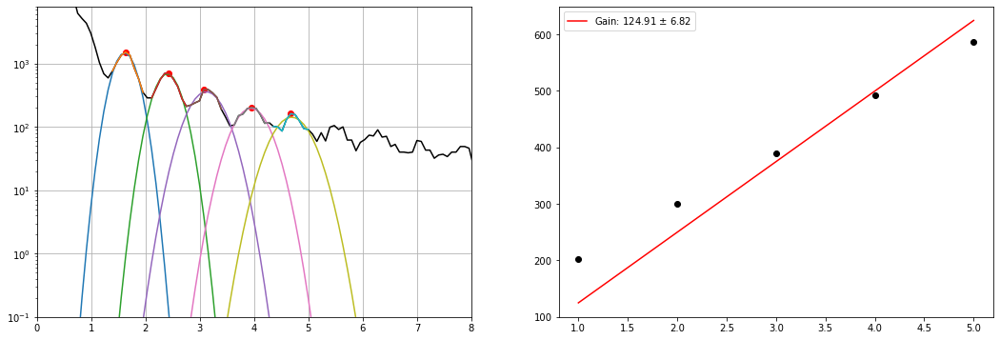

6.817410493484623
Guess:  [1543, 203.93707550382175, 10]
Params:  [1511.30618506  202.69180494   23.42684524]
Guess:  [719, 303.9553905221367, 10]
Params:  [700.02330459 299.10207837  25.75426787]
Guess:  [415, 393.97187403862023, 10]
Params:  [392.69894814 394.1199196   28.47378754]
Guess:  [229, 503.9920205587668, 10]
Params:  [210.87224048 492.91967853  32.23573536]
Guess:  [155, 594.0085040752504, 10]
Params:  [143.33039036 587.02976094  36.20459873]


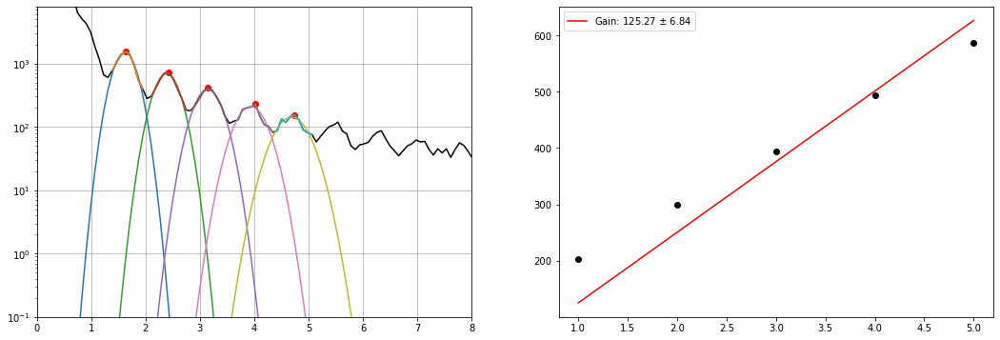

6.842492766270197
Guess:  [1549, 203.93707550382175, 10]
Params:  [1487.39406973  203.20769134   23.6066084 ]
Guess:  [717, 293.95355902030525, 10]
Params:  [657.34856817 298.17373196  28.97863069]
Guess:  [402, 393.97187403862023, 10]
Params:  [380.30219844 394.20672595  30.1102607 ]
Guess:  [253, 493.99018905693526, 10]
Params:  [226.51379844 491.4999837   31.51946564]
Guess:  [164, 594.0085040752504, 10]
Params:  [164.66770227 589.24409358  29.26884853]


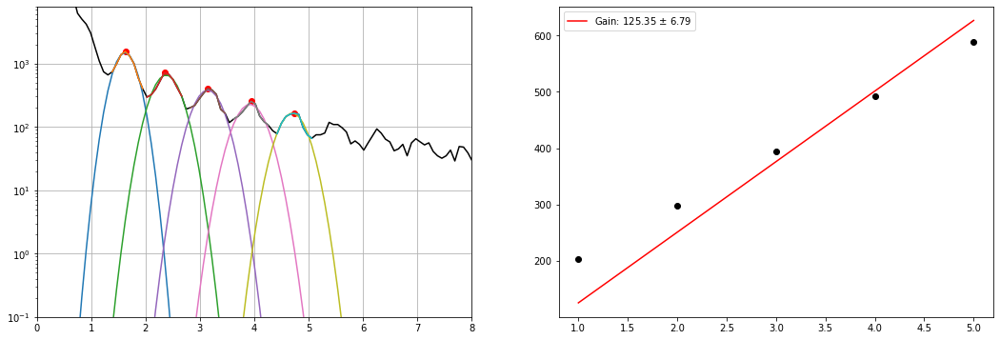

6.79235701517048
Guess:  [1578, 203.93707550382175, 10]
Params:  [1524.21665865  202.02491372   23.29410786]
Guess:  [716, 303.9553905221367, 10]
Params:  [686.25626017 299.23292899  26.63365193]
Guess:  [388, 393.97187403862023, 10]
Params:  [359.85683292 395.56010931  30.40504415]
Guess:  [251, 493.99018905693526, 10]
Params:  [235.81305076 492.18478858  30.60101289]
Guess:  [163, 594.0085040752504, 10]
Params:  [149.05924275 590.67572022  31.25032388]


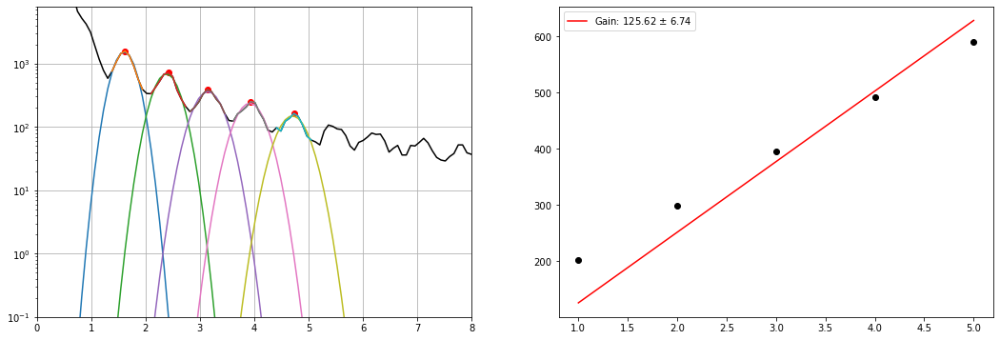

6.7410862170013095
Guess:  [1587, 203.93707550382175, 10]
Params:  [1529.62150508  202.88039274   22.81926234]
Guess:  [759, 293.95355902030525, 10]
Params:  [702.31950377 296.85622438  26.61084284]
Guess:  [390, 403.97370554045176, 10]
Params:  [375.18179223 394.54940386  28.16773642]
Guess:  [262, 493.99018905693526, 10]
Params:  [233.64844687 492.26567549  30.81664314]
Guess:  [161, 594.0085040752504, 10]
Params:  [154.12995876 587.92594115  29.16140006]


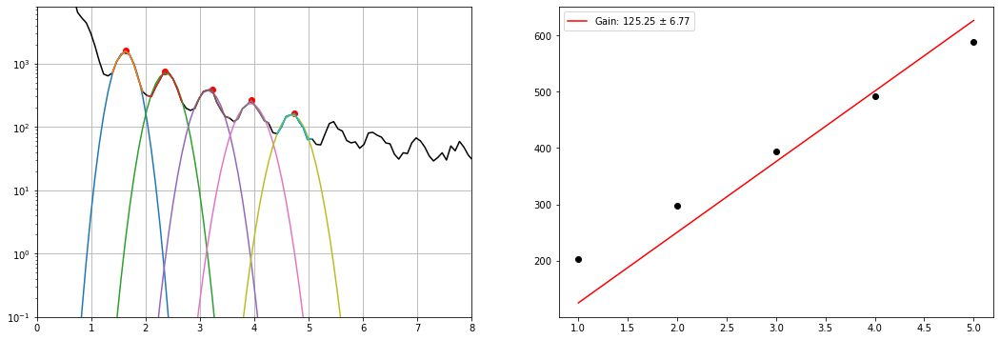

6.766836293332209
Guess:  [1448, 203.93707550382175, 10]
Params:  [1433.46092086  203.00231558   22.45215605]
Guess:  [679, 303.9553905221367, 10]
Params:  [644.83221763 298.52577475  26.10254016]
Guess:  [363, 403.97370554045176, 10]
Params:  [343.67472478 395.91576693  28.71895855]
Guess:  [214, 493.99018905693526, 10]
Params:  [207.00790164 492.96720672  31.72193033]
Guess:  [154, 584.0066725734189, 10]
Params:  [139.21041265 587.73751851  37.62746413]


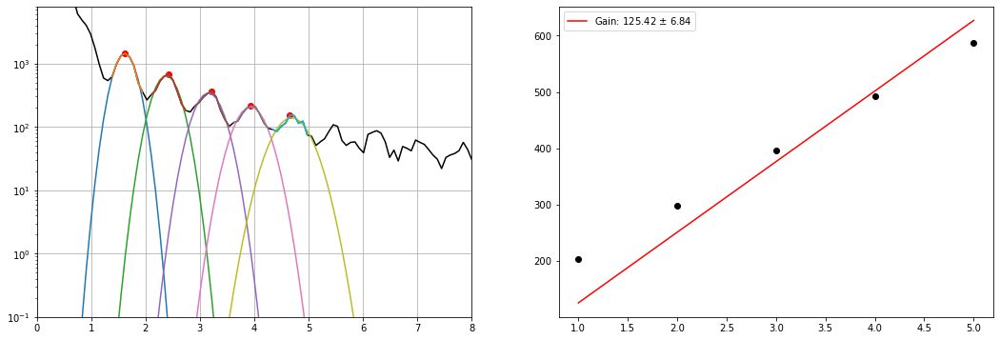

6.843913857904952
Guess:  [1525, 203.93707550382175, 10]
Params:  [1455.53715132  202.70257695   24.30050712]
Guess:  [695, 293.95355902030525, 10]
Params:  [660.35868727 298.54137999  28.85208593]
Guess:  [384, 393.97187403862023, 10]
Params:  [377.74077737 394.44525921  29.01252617]
Guess:  [254, 483.98835755510373, 10]
Params:  [234.37165282 487.7023415   33.59702663]
Guess:  [158, 584.0066725734189, 10]
Params:  [142.61055823 588.27236986  39.75630337]


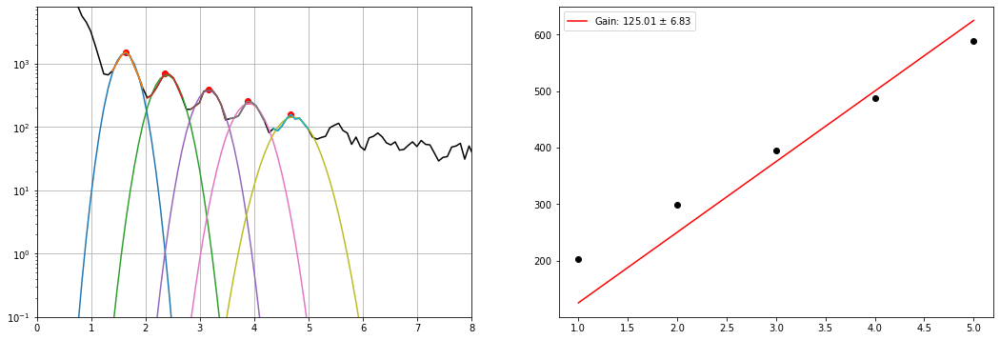

6.833149099734625
Guess:  [1434, 203.93707550382175, 10]
Params:  [1385.13769688  203.15878243   25.47858207]
Guess:  [715, 303.9553905221367, 10]
Params:  [669.68581638 299.33695968  27.97316559]
Guess:  [359, 403.97370554045176, 10]
Params:  [355.16524258 396.65529332  31.3181558 ]
Guess:  [244, 493.99018905693526, 10]
Params:  [220.81779689 492.88381512  34.67350559]
Guess:  [159, 584.0066725734189, 10]
Params:  [146.27922785 587.36072452  36.00615567]


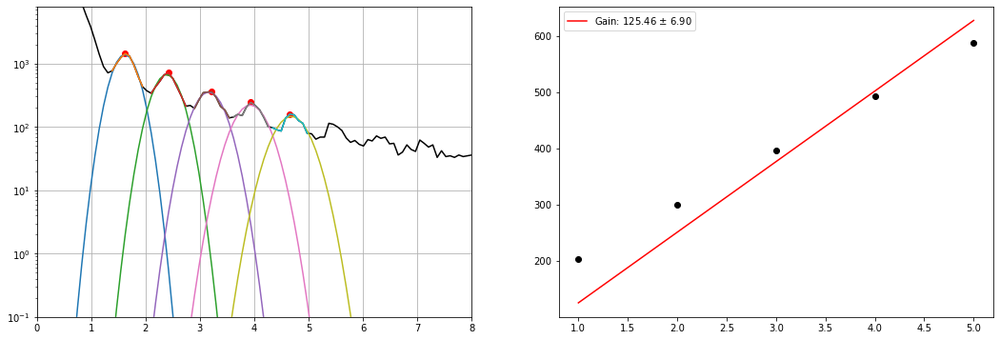

6.89787476429016
Guess:  [1326, 203.93707550382175, 10]
Params:  [1352.16499307  203.22464835   27.58686431]
Guess:  [671, 303.9553905221367, 10]
Params:  [634.30829023 298.55812658  30.58372711]
Guess:  [375, 403.97370554045176, 10]
Params:  [354.39891847 397.99833713  31.56593446]
Guess:  [243, 493.99018905693526, 10]
Params:  [228.61721989 492.37828529  35.73978476]
Guess:  [146, 604.0103355770818, 10]
Params:  [130.63163692 593.75622104  42.09567472]


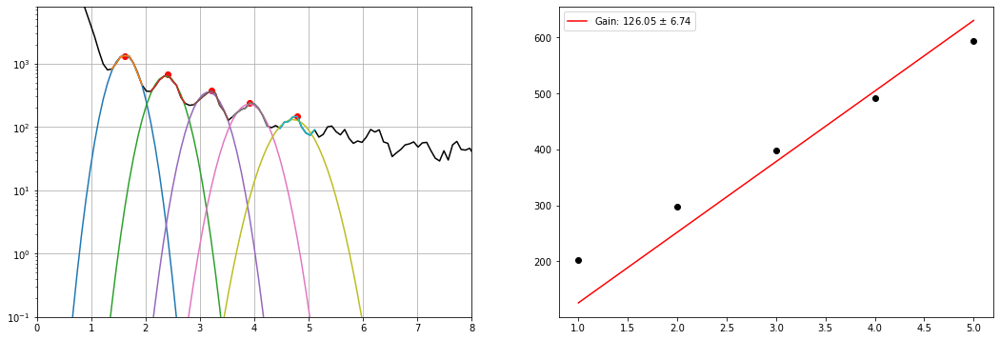

6.73518203381695
Guess:  [1340, 203.93707550382175, 10]
Params:  [1307.30178725  202.94037792   27.94029339]
Guess:  [673, 303.9553905221367, 10]
Params:  [646.68556085 298.87061266  29.30121095]
Guess:  [359, 393.97187403862023, 10]
Params:  [351.10256477 394.08714492  31.3485472 ]
Guess:  [218, 483.98835755510373, 10]
Params:  [202.88821788 489.69344952  38.737862  ]
Guess:  [141, 584.0066725734189, 10]
Params:  [127.49489816 584.06920263  45.67371959]


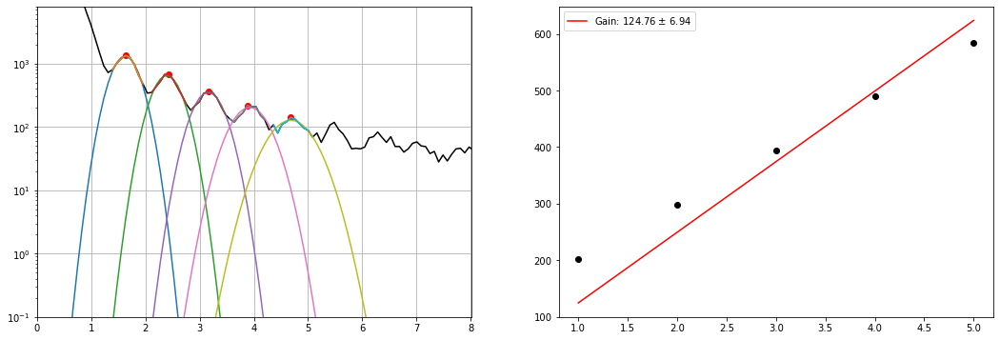

6.943234287817678
Guess:  [401, 203.82027395326875, 10]
Params:  [410.13683237 201.33908739  25.64375069]
Guess:  [320, 293.8367574697523, 10]
Params:  [278.14551043 295.40922655  31.55743722]
Guess:  [220, 383.8532409862358, 10]
Params:  [216.97635916 382.84899426  33.6961824 ]
Guess:  [168, 483.87155600455077, 10]
Params:  [155.48402554 475.52636491  45.26869664]


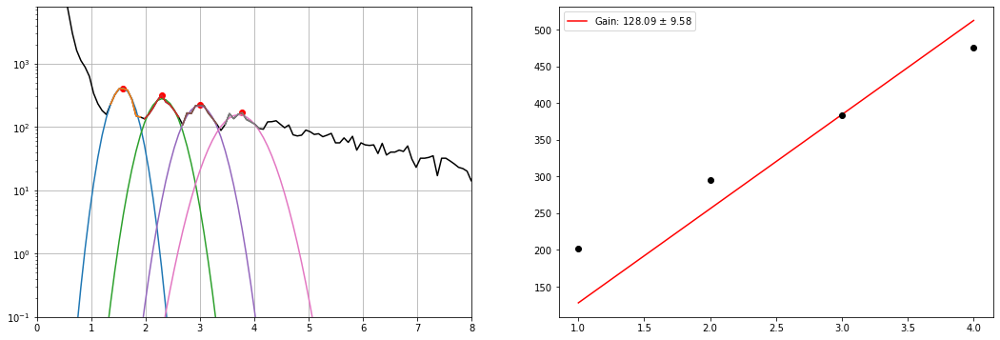

9.581867452852093
Guess:  [431, 203.82027395326875, 10]
Params:  [400.98766387 201.2432099   25.38876394]
Guess:  [302, 293.8367574697523, 10]
Params:  [286.79845896 292.53098937  30.05246206]
Guess:  [206, 393.85507248806726, 10]
Params:  [189.12223447 381.34985674  42.46529308]
Guess:  [163, 473.8697245027193, 10]
Params:  [148.3074715  476.24296888  46.60574227]


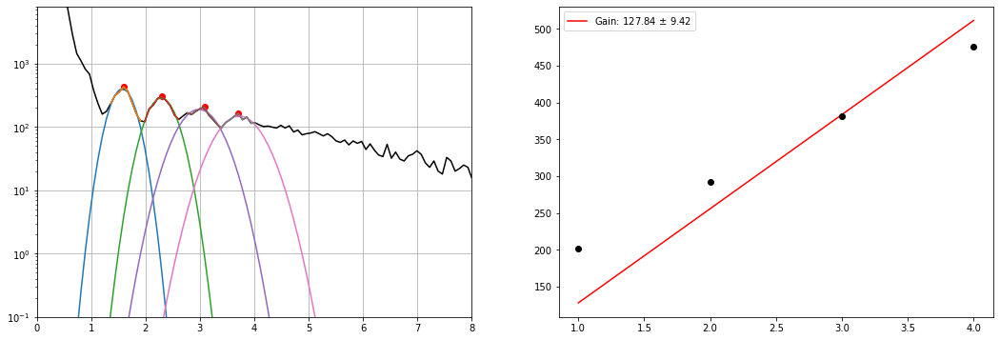

9.418623118321863
Guess:  [394, 193.81844245143722, 10]
Params:  [376.44805074 198.66362507  26.29914879]
Guess:  [279, 293.8367574697523, 10]
Params:  [263.02029224 291.99552883  30.4313308 ]
Guess:  [200, 383.8532409862358, 10]
Params:  [195.69832153 381.9734504   38.88168382]
fit failed


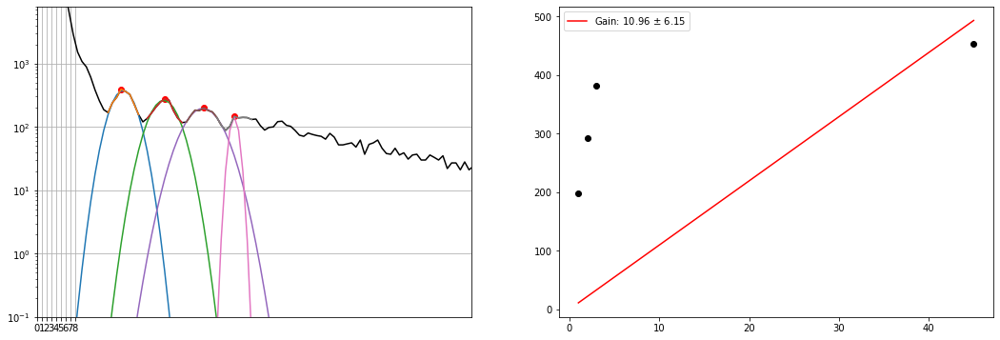

6.1530108332840605
Guess:  [393, 203.82027395326875, 10]
Params:  [396.58639646 202.07381871  25.44584944]
Guess:  [301, 293.8367574697523, 10]
Params:  [278.21425282 293.90881573  29.04825339]
Guess:  [199, 383.8532409862358, 10]
Params:  [197.49832939 382.25400129  38.55502696]
Guess:  [157, 473.8697245027193, 10]
Params:  [148.35365233 472.34969411  44.70839809]


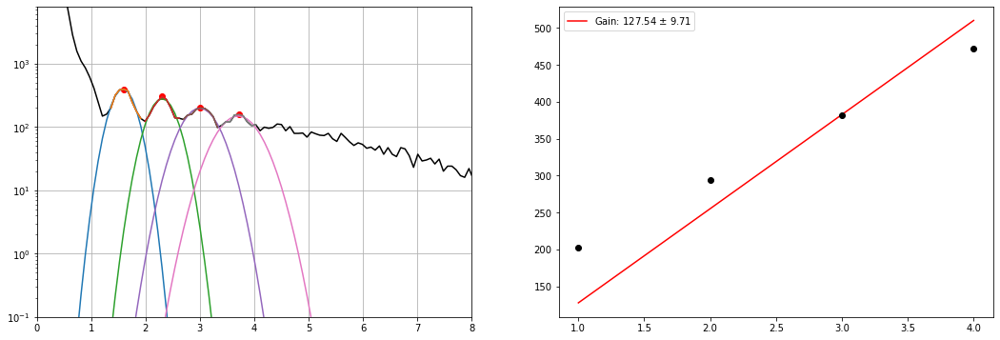

9.714090316876433
Guess:  [423, 203.82027395326875, 10]
Params:  [399.65158671 201.7405665   24.75587005]
Guess:  [292, 293.8367574697523, 10]
Params:  [266.54145438 294.24138914  29.04239339]
Guess:  [199, 373.8514094844043, 10]
Params:  [187.10463028 381.15320634  44.79519829]
Guess:  [157, 493.8733875063823, 10]
Params:  [145.7365226  465.34100952  70.18445256]


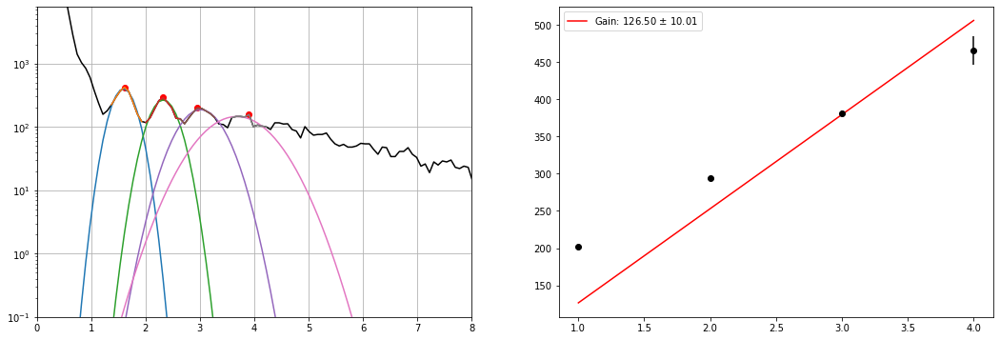

10.009929229697287
Guess:  [418, 203.82027395326875, 10]
Params:  [384.95241614 201.15015513  24.85949647]
Guess:  [260, 293.8367574697523, 10]
Params:  [249.9559348  293.81346023  31.72282714]
Guess:  [207, 393.85507248806726, 10]
Params:  [199.80559325 385.95454362  37.1914457 ]
Guess:  [141, 483.87155600455077, 10]
Params:  [132.35244452 479.38538943  53.34168607]


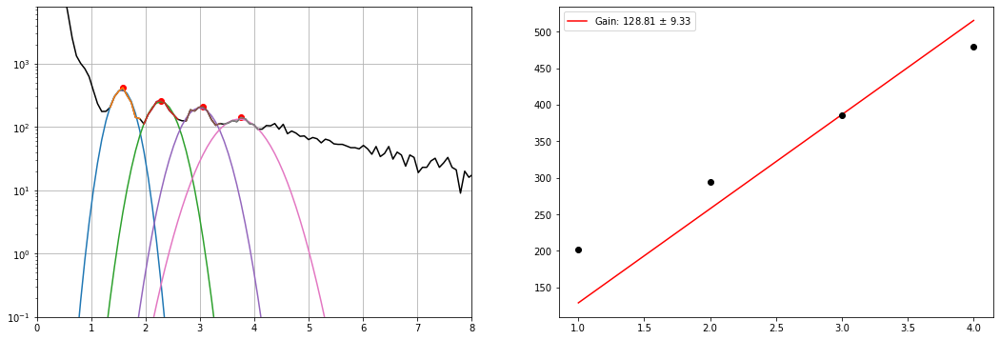

9.326690036399455
Guess:  [428, 203.82027395326875, 10]
Params:  [400.75227833 200.72774688  25.48708132]
Guess:  [287, 293.8367574697523, 10]
Params:  [262.70267745 290.40352736  32.58374038]
Guess:  [229, 383.8532409862358, 10]
Params:  [210.94165933 383.6604132   36.37128332]
Guess:  [146, 473.8697245027193, 10]
Params:  [144.64474623 475.90451659  49.9543301 ]


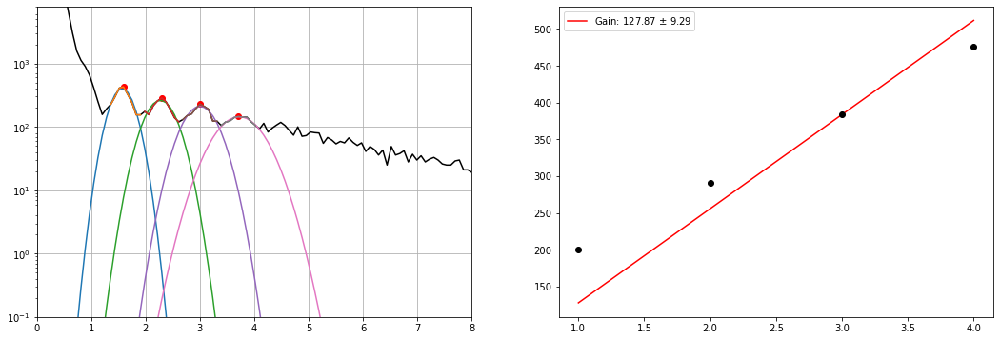

9.294818718211225
Guess:  [415, 203.82027395326875, 10]
Params:  [385.50465799 200.40761122  24.54174077]
Guess:  [293, 293.8367574697523, 10]
Params:  [268.70518103 292.77708103  29.16428656]
Guess:  [213, 383.8532409862358, 10]
Params:  [195.97031545 382.68536722  35.01361446]
Guess:  [158, 473.8697245027193, 10]
Params:  [154.72679241 469.99077961  40.51628799]


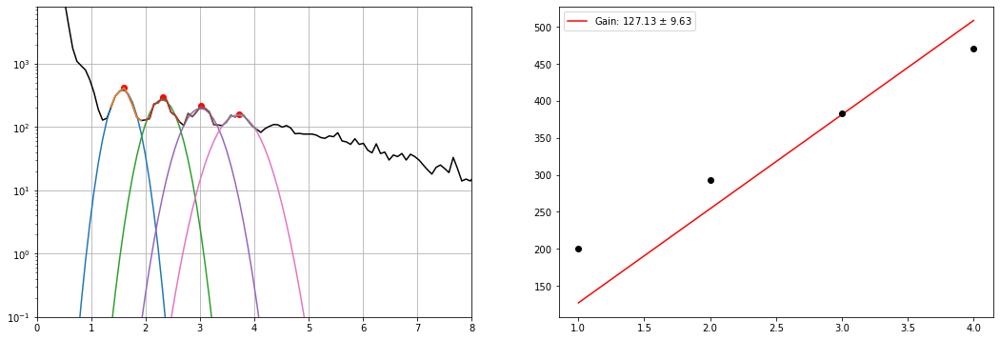

9.625978951134709
Guess:  [398, 203.82027395326875, 10]
Params:  [373.09542989 201.19213002  26.12548789]
Guess:  [271, 293.8367574697523, 10]
Params:  [250.46096916 292.02618503  33.03230657]
Guess:  [195, 383.8532409862358, 10]
Params:  [176.20444793 387.59537484  51.11230338]
Guess:  [142, 483.87155600455077, 10]
Params:  [139.46346881 479.45907111  52.62019312]


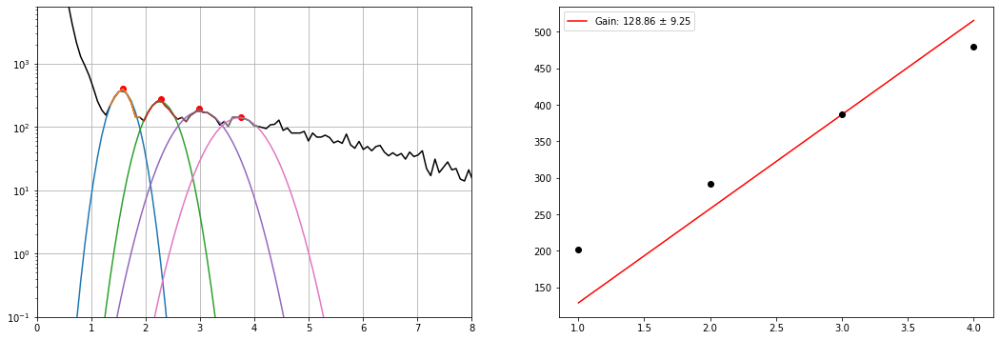

9.252332692912125
Guess:  [386, 203.82027395326875, 10]
Params:  [364.93164367 202.66047962  26.98687915]
Guess:  [277, 293.8367574697523, 10]
Params:  [255.30549392 292.88427473  31.80321783]
Guess:  [190, 373.8514094844043, 10]
Params:  [184.90331638 381.29957089  44.69664757]
Guess:  [157, 473.8697245027193, 10]
Params:  [146.29386457 475.80764415  51.36056479]


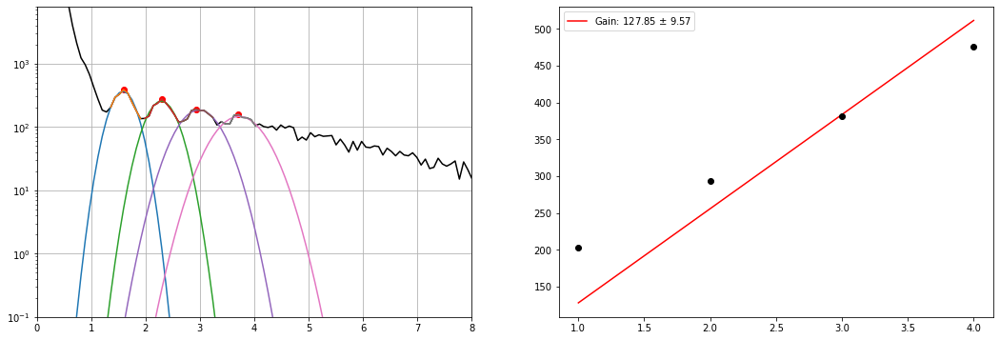

9.574943143739828
Guess:  [405, 203.82027395326875, 10]
Params:  [396.75145937 201.24181386  25.36436554]
Guess:  [262, 293.8367574697523, 10]
Params:  [253.10250091 293.51926649  31.76574494]
Guess:  [211, 373.8514094844043, 10]
Params:  [206.42002691 379.77884812  39.0519324 ]
Guess:  [150, 453.86606149905634, 10]
Params:  [135.34793975 479.78015088 102.67519074]


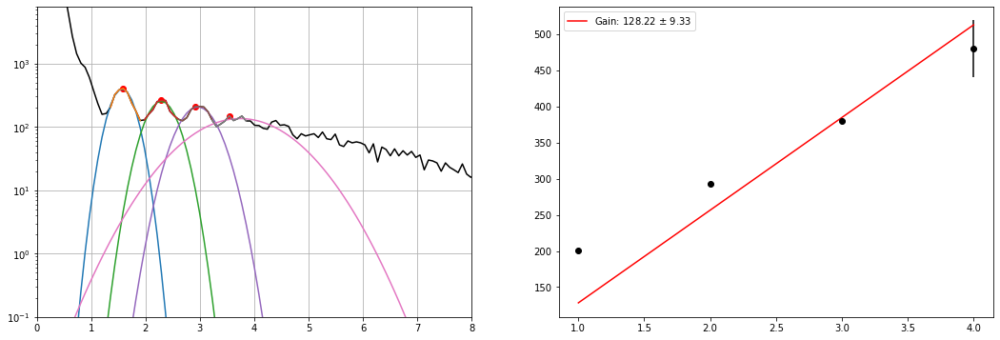

9.325283691306957
Guess:  [458, 193.81844245143722, 10]
Params:  [443.20683582 199.1388081   23.53074855]
Guess:  [304, 293.8367574697523, 10]
Params:  [281.50152407 290.67689075  30.26277616]
Guess:  [226, 373.8514094844043, 10]
Params:  [207.6491279  380.56359063  38.25294787]
Guess:  [156, 463.8678930008878, 10]
Params:  [146.99685119 470.16438526  53.02805118]


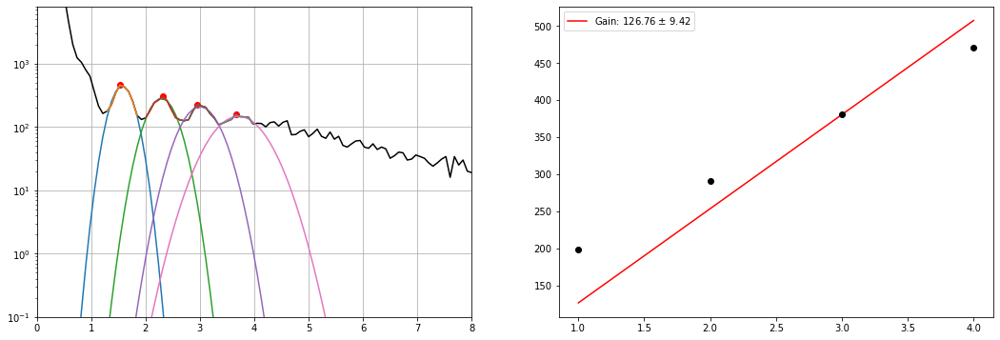

9.415836414222849
Guess:  [395, 203.82027395326875, 10]
Params:  [388.01122783 200.20284177  24.42346689]
Guess:  [286, 293.8367574697523, 10]
Params:  [267.8302787  292.90365173  28.72228383]
Guess:  [213, 383.8532409862358, 10]
Params:  [206.28479304 380.84058627  34.7436772 ]
Guess:  [155, 473.8697245027193, 10]
Params:  [137.62200941 472.65969775  43.66490313]


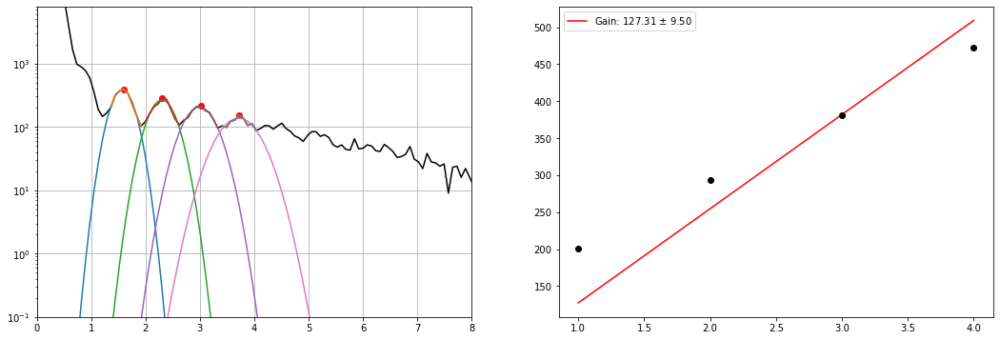

9.497548902304422
Guess:  [398, 193.81844245143722, 10]
Params:  [400.53680196 198.7577837   25.32540629]
Guess:  [261, 283.8349259679208, 10]
Params:  [249.64878833 290.09105011  33.37608817]
Guess:  [192, 373.8514094844043, 10]
Params:  [188.06386632 379.38936391  36.57515629]
Guess:  [160, 473.8697245027193, 10]
Params:  [144.07331778 476.09234886  54.75687992]


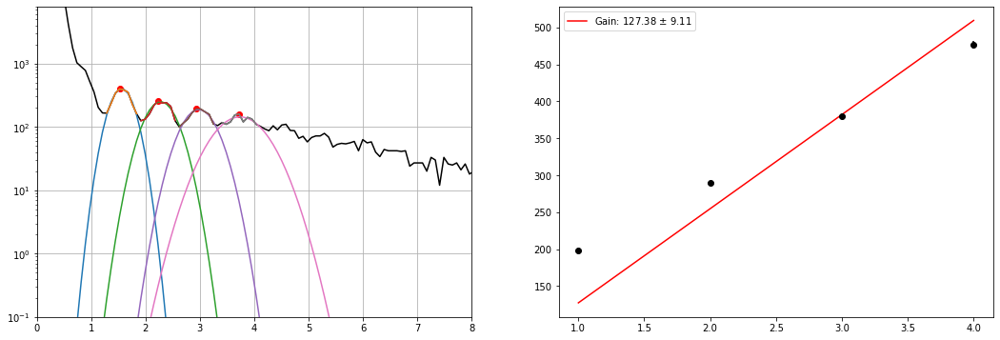

9.109241218144845
Guess:  [384, 203.82027395326875, 10]
Params:  [370.60427657 201.11122192  28.18012807]
Guess:  [287, 303.83858897158376, 10]
Params:  [281.93326695 293.92956621  30.65063207]
Guess:  [220, 383.8532409862358, 10]
Params:  [207.62708946 387.04232939  36.67258479]
Guess:  [163, 483.87155600455077, 10]
Params:  [144.3701079  481.94771754  47.75754515]


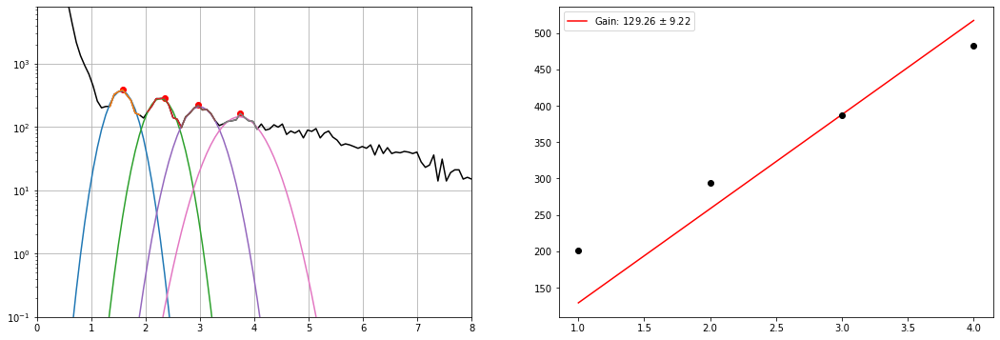

9.218608910974252
Guess:  [404, 203.82027395326875, 10]
Params:  [394.83792102 201.58813924  26.34445634]
Guess:  [268, 283.8349259679208, 10]
Params:  [246.8138102  289.10985338  36.46218153]
Guess:  [204, 383.8532409862358, 10]
Params:  [189.90035624 382.5777516   39.26311994]
Guess:  [166, 473.8697245027193, 10]
Params:  [151.21806949 470.80785553  49.27206008]


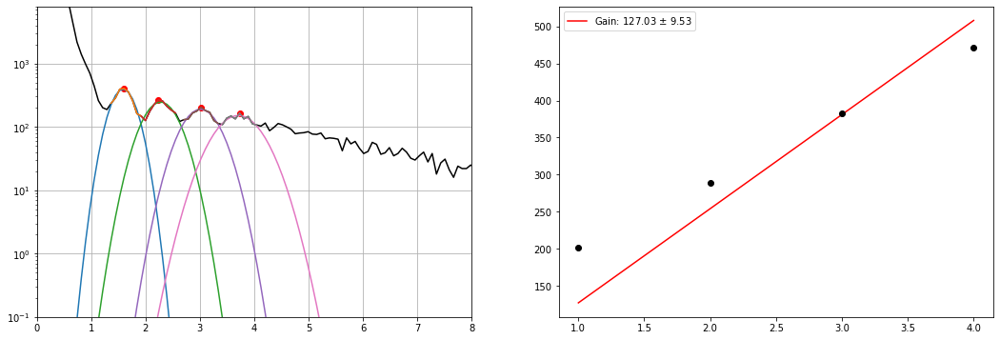

9.534625388201855
Guess:  [415, 193.81844245143722, 10]
Params:  [414.68192603 199.97590088  25.78487001]
Guess:  [295, 293.8367574697523, 10]
Params:  [281.32488648 293.06185537  32.85115209]
Guess:  [228, 383.8532409862358, 10]
Params:  [206.88876903 382.79663245  37.60489271]
Guess:  [171, 473.8697245027193, 10]
Params:  [156.54456529 477.11445844  41.9283657 ]


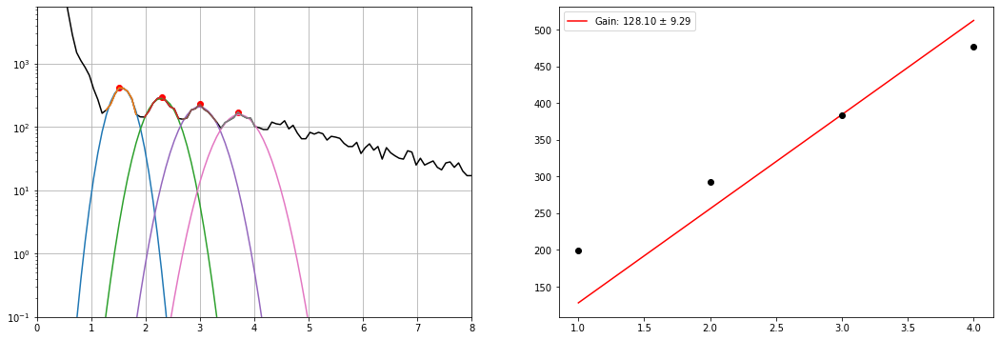

9.292930912949117
Guess:  [442, 193.81844245143722, 10]
Params:  [427.46097659 198.99639868  23.47438373]
Guess:  [290, 293.8367574697523, 10]
Params:  [274.98290482 291.27703277  31.76260816]
Guess:  [220, 383.8532409862358, 10]
Params:  [208.53552248 383.94163911  35.89099266]
Guess:  [169, 473.8697245027193, 10]
Params:  [159.84403881 472.31294888  44.37395277]


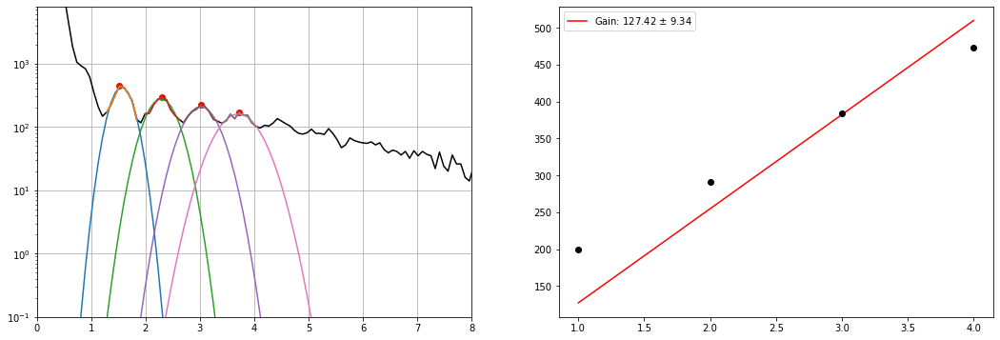

9.339261557564127
Guess:  [448, 203.82027395326875, 10]
Params:  [412.7826484  199.97824264  24.77901241]
Guess:  [291, 293.8367574697523, 10]
Params:  [274.74742631 291.69375439  32.45467633]
Guess:  [221, 383.8532409862358, 10]
Params:  [204.83450865 384.24252205  34.51113752]
Guess:  [167, 463.8678930008878, 10]
Params:  [159.58434968 468.4286038   50.76391696]


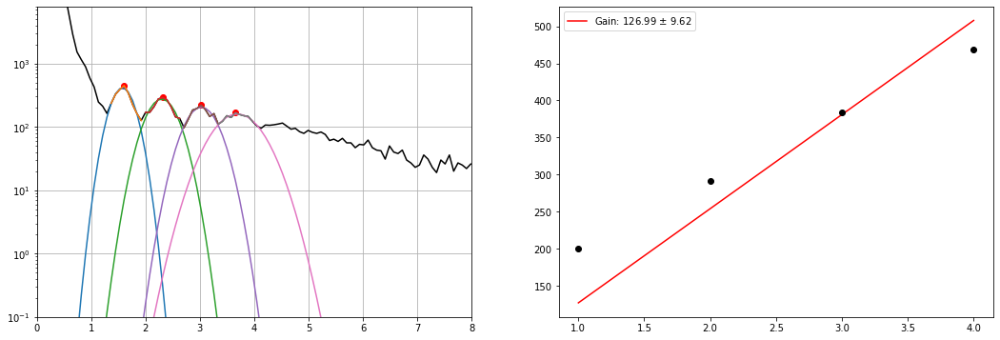

9.616566207197737
Guess:  [402, 203.82027395326875, 10]
Params:  [407.33468727 200.38998272  23.65861916]
Guess:  [272, 283.8349259679208, 10]
Params:  [251.74163374 288.38185216  32.35011679]
Guess:  [210, 373.8514094844043, 10]
Params:  [200.09033497 381.11338356  41.12950407]
Guess:  [156, 483.87155600455077, 10]
Params:  [140.92614796 479.93523739  47.0214037 ]


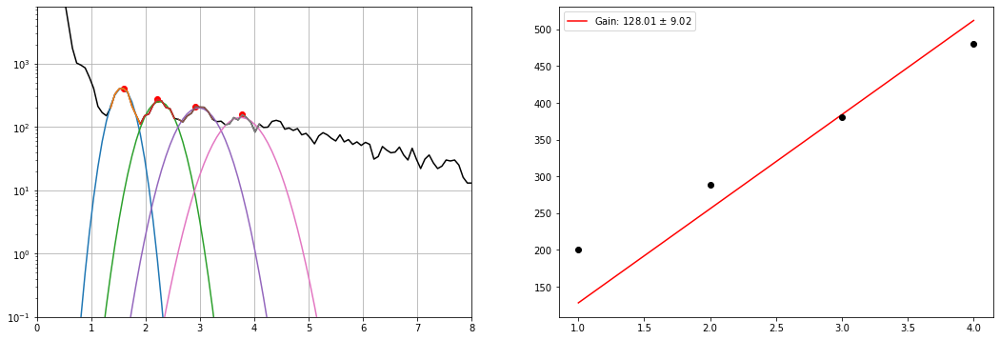

9.02180921238407
Guess:  [411, 203.82027395326875, 10]
Params:  [404.72424053 199.04682147  25.90297161]
Guess:  [298, 293.8367574697523, 10]
Params:  [286.99020282 293.04808454  28.89290327]
Guess:  [205, 383.8532409862358, 10]
Params:  [204.57921336 382.73473014  35.91099673]
Guess:  [142, 473.8697245027193, 10]
Params:  [142.43438074 470.57503574  49.01336237]


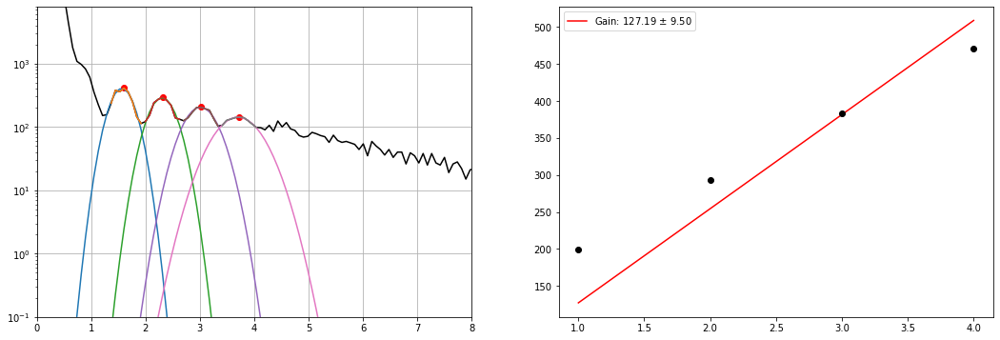

9.49740995974486
Guess:  [399, 193.81844245143722, 10]
Params:  [400.33105187 199.82049378  24.01496012]
Guess:  [289, 293.8367574697523, 10]
Params:  [278.10517315 292.00126623  29.58136443]
Guess:  [204, 393.85507248806726, 10]
Params:  [194.75141328 387.63217855  41.3465591 ]
Guess:  [146, 473.8697245027193, 10]
Params:  [141.46221048 470.28155885  48.97136487]


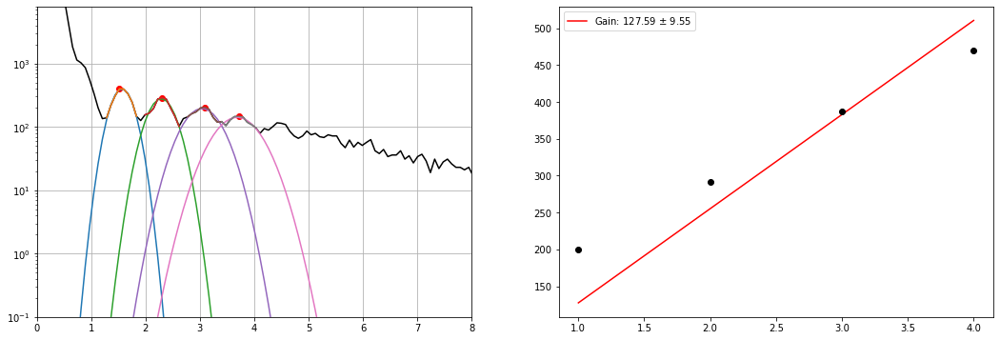

9.546943300190565
Guess:  [434, 203.82027395326875, 10]
Params:  [428.5108049  200.70996807  23.57449639]
Guess:  [305, 293.8367574697523, 10]
Params:  [278.88201876 292.98955849  29.13077391]
Guess:  [239, 383.8532409862358, 10]
Params:  [211.58719162 384.75922675  35.0485419 ]
Guess:  [158, 473.8697245027193, 10]
Params:  [155.83400869 474.2435785   41.92923796]


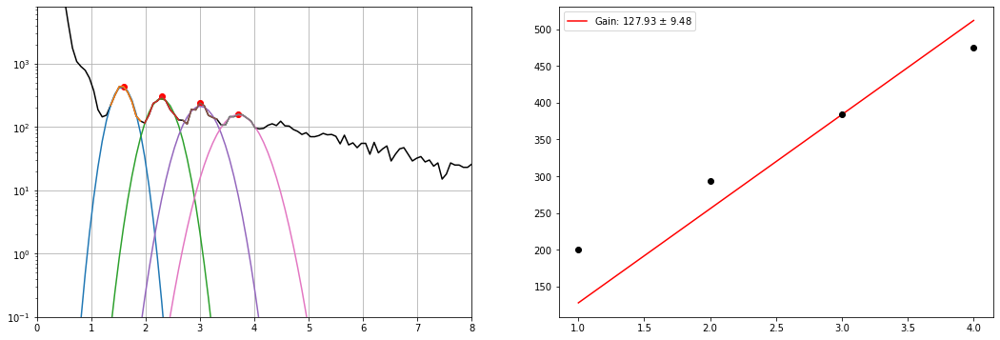

9.4756702013585
Guess:  [431, 203.82027395326875, 10]
Params:  [420.00941389 201.42081834  24.49021563]
Guess:  [310, 293.8367574697523, 10]
Params:  [263.17876639 291.54718266  31.03094709]
Guess:  [213, 393.85507248806726, 10]
Params:  [201.31290453 385.20125799  37.61519598]
Guess:  [162, 483.87155600455077, 10]
Params:  [143.29954348 477.06975699  51.73296074]


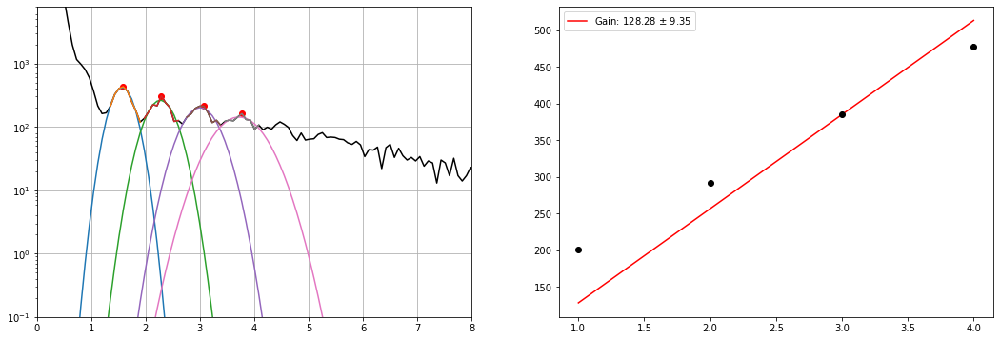

9.353212705276977
Guess:  [433, 203.82027395326875, 10]
Params:  [414.09263571 200.22813896  25.06528047]
Guess:  [265, 293.8367574697523, 10]
Params:  [252.2499965  292.23490483  33.36837708]
Guess:  [194, 383.8532409862358, 10]
Params:  [183.41837619 381.62376234  39.34610777]
Guess:  [148, 473.8697245027193, 10]
Params:  [141.54640024 473.37286668  50.53683284]


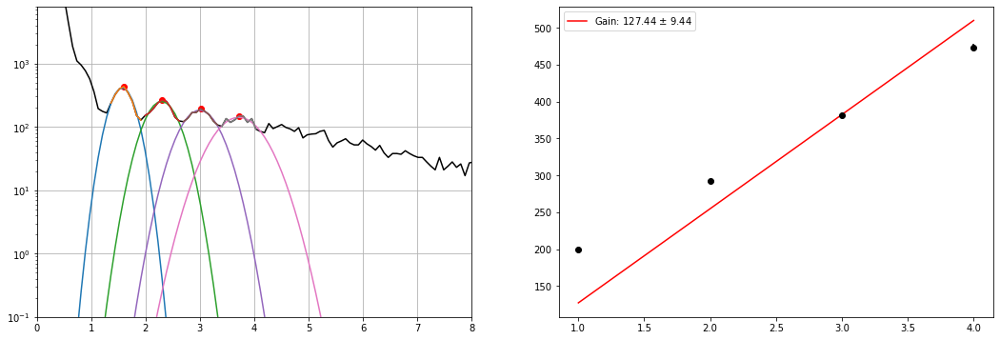

9.438696739082847
Guess:  [445, 203.82027395326875, 10]
Params:  [423.02304078 200.28221737  23.61332266]
Guess:  [299, 293.8367574697523, 10]
Params:  [276.43689839 290.6964569   29.84624079]
Guess:  [215, 383.8532409862358, 10]
Params:  [206.08463368 381.48511548  35.96999682]
Guess:  [158, 453.86606149905634, 10]
Params:  [133.92539892 466.95016985 136.78377326]


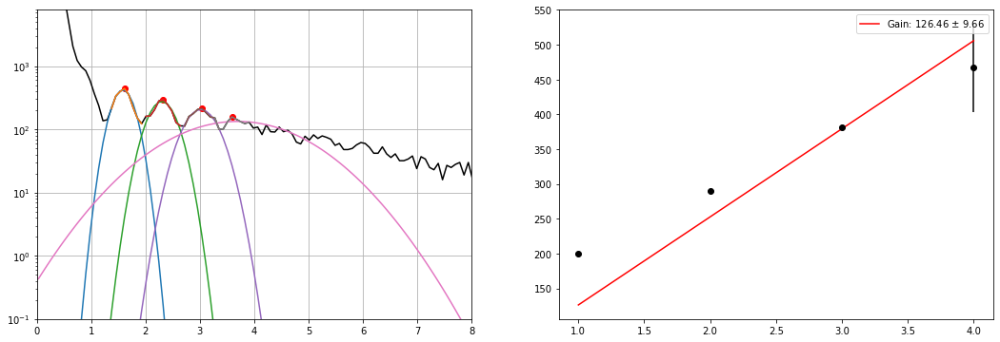

9.65725422062
Guess:  [437, 203.82027395326875, 10]
Params:  [419.98641171 201.4649818   23.77359298]
Guess:  [286, 303.83858897158376, 10]
Params:  [257.81651062 294.57000487  33.64301938]
Guess:  [208, 393.85507248806726, 10]
Params:  [190.41545813 387.50548294  38.8742561 ]
Guess:  [147, 473.8697245027193, 10]
Params:  [147.31767901 472.17319704  43.65627353]


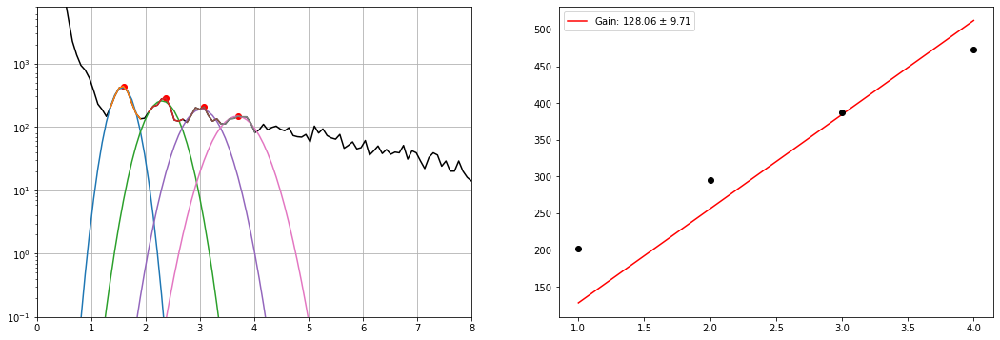

9.708588232402045
Guess:  [405, 203.82027395326875, 10]
Params:  [392.55315326 200.88745058  25.48047703]
Guess:  [291, 293.8367574697523, 10]
Params:  [275.30767953 293.59446727  29.20091599]
Guess:  [211, 373.8514094844043, 10]
Params:  [195.90293189 382.59460783  37.64519354]
Guess:  [144, 483.87155600455077, 10]
Params:  [141.81647033 471.59102065  48.00109245]


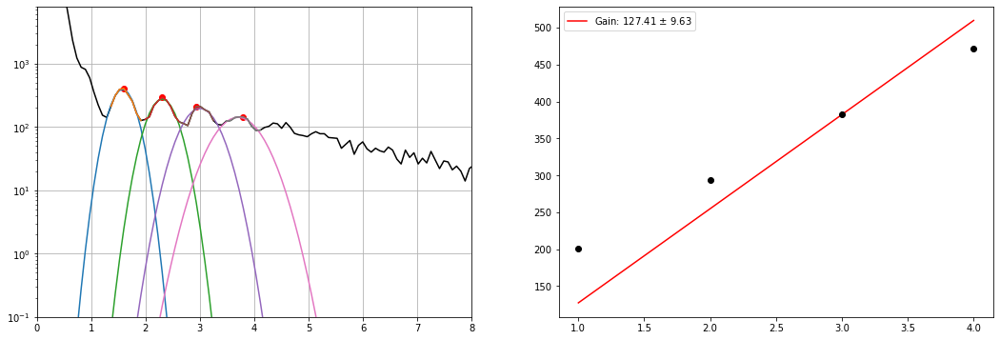

9.63226787703246
Guess:  [379, 203.82027395326875, 10]
Params:  [379.83603185 201.32864681  25.89086268]
Guess:  [262, 293.8367574697523, 10]
Params:  [257.51788945 291.99815643  28.87913835]
Guess:  [216, 383.8532409862358, 10]
Params:  [189.87740454 384.41478505  37.95551182]
Guess:  [144, 483.87155600455077, 10]
Params:  [139.12470646 477.24351722  41.35223168]


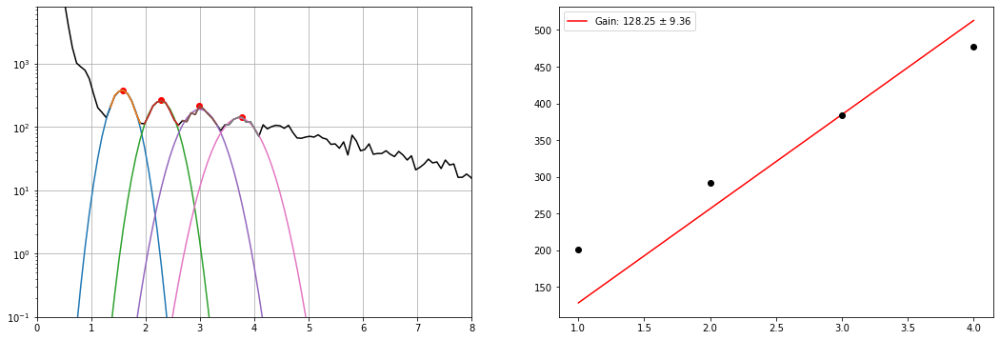

9.356664968828852
Guess:  [390, 203.82027395326875, 10]
Params:  [379.27796929 199.46650263  25.04421944]
Guess:  [283, 293.8367574697523, 10]
Params:  [274.45057944 293.02851516  27.63054124]
Guess:  [217, 383.8532409862358, 10]
Params:  [196.5842509  382.86584871  37.5951614 ]
Guess:  [149, 463.8678930008878, 10]
Params:  [140.83412779 466.38951026  49.82967251]


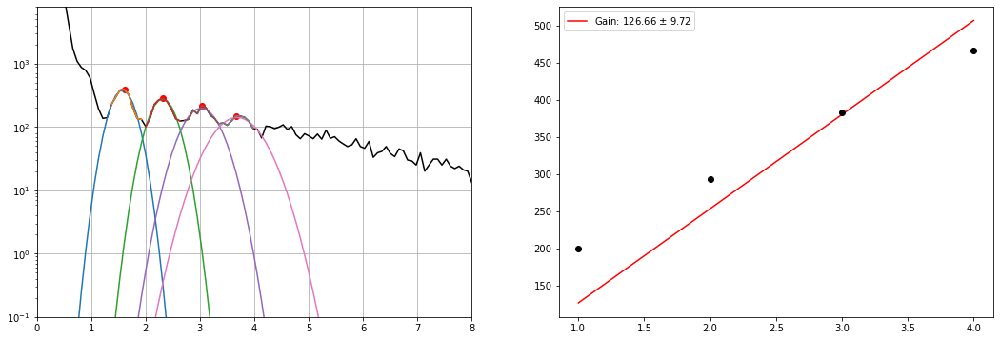

9.721672544696332
Guess:  [399, 193.81844245143722, 10]
Params:  [392.26164507 199.69331112  24.050772  ]
Guess:  [274, 283.8349259679208, 10]
Params:  [268.90545381 289.68300226  28.23423565]
Guess:  [203, 373.8514094844043, 10]
Params:  [194.08957603 380.14190374  37.66607633]
Guess:  [144, 483.87155600455077, 10]
Params:  [143.2739232  473.27922365  47.96858584]


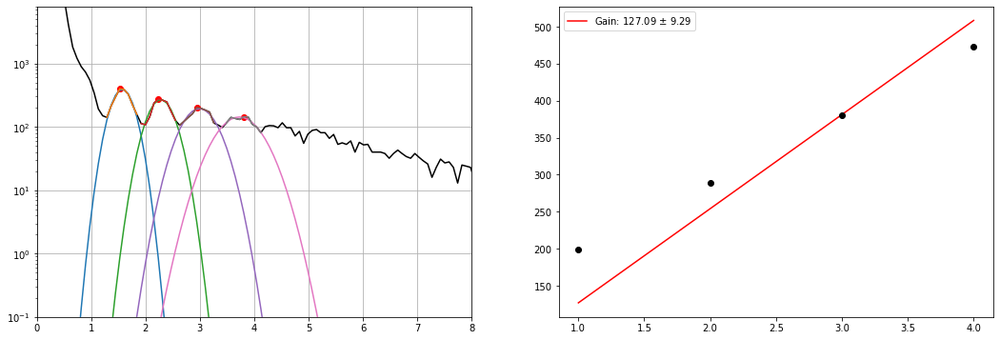

9.287767986548907
Guess:  [429, 203.82027395326875, 10]
Params:  [413.27502404 199.60471461  24.13329982]
Guess:  [278, 293.8367574697523, 10]
Params:  [269.83433014 290.80820868  31.85278057]
Guess:  [207, 373.8514094844043, 10]
Params:  [199.87625992 383.39533019  39.6928092 ]
Guess:  [159, 473.8697245027193, 10]
Params:  [150.24667081 467.50621984  43.77639335]


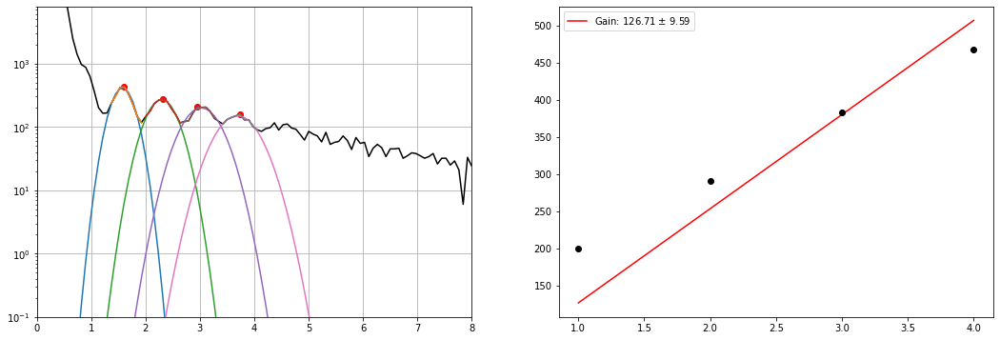

9.585478346442502
Guess:  [416, 193.81844245143722, 10]
Params:  [405.26337943 199.71821107  24.9334952 ]
Guess:  [279, 283.8349259679208, 10]
Params:  [266.64353832 290.18784417  33.26244725]
Guess:  [238, 373.8514094844043, 10]
Params:  [207.69268728 382.0790646   38.90925663]
Guess:  [158, 473.8697245027193, 10]
Params:  [149.73604118 473.12620885  52.77820168]


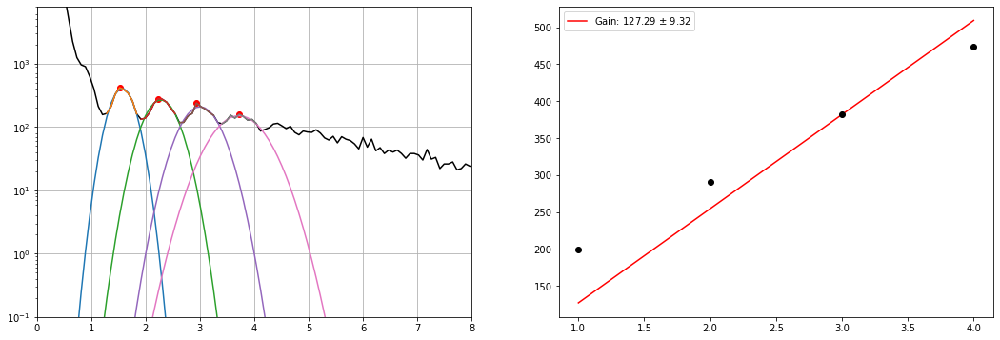

9.31679579834815
Guess:  [364, 203.82027395326875, 10]
Params:  [357.97275537 201.0456871   31.84131759]
Guess:  [257, 303.83858897158376, 10]
Params:  [247.66988609 294.89914598  37.62384209]
Guess:  [199, 383.8532409862358, 10]
Params:  [187.29148709 381.24107981  46.7988142 ]
Guess:  [145, 473.8697245027193, 10]
Params:  [137.81024959 470.66957254  60.98216399]


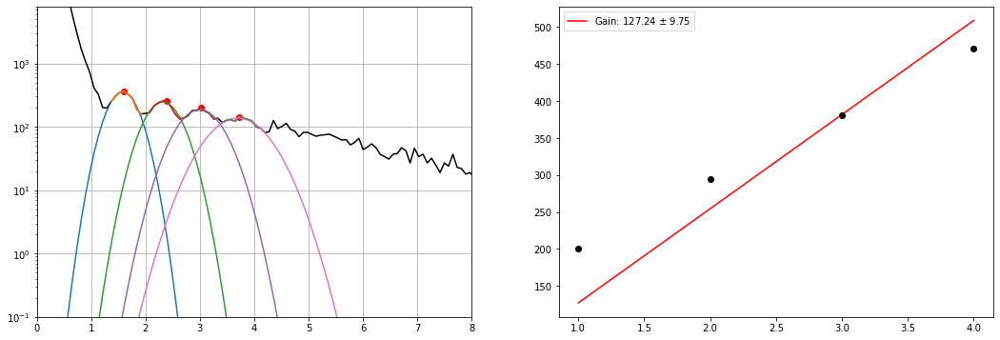

9.745296821712932
Guess:  [416, 193.81844245143722, 10]
Params:  [387.3005453  197.46461563  27.56919366]
Guess:  [296, 293.8367574697523, 10]
Params:  [271.79408435 292.39350912  31.43624219]
Guess:  [240, 383.8532409862358, 10]
Params:  [202.6836923  382.61368386  37.36753476]
Guess:  [159, 483.87155600455077, 10]
Params:  [155.78985822 475.65931413  40.72218989]


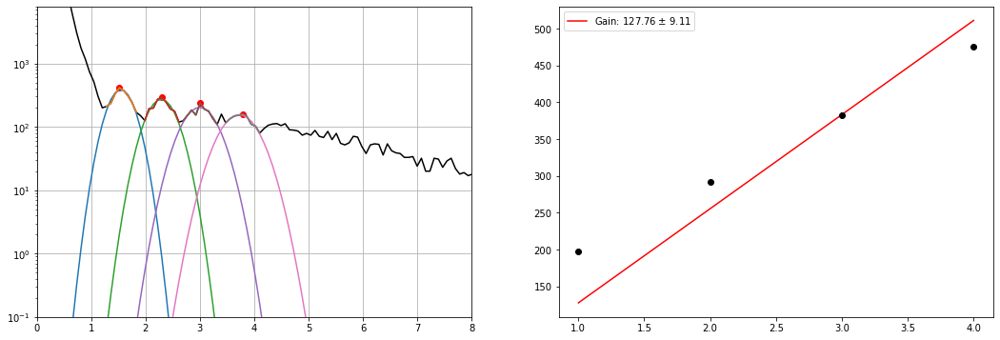

9.110815219005461
Guess:  [255, 203.88771290577262, 10]
Params:  [236.28434166 200.48365563  28.49386978]
Guess:  [134, 293.9041964222561, 10]
Params:  [125.62121284 292.82722945  27.79172938]
Guess:  [75, 393.9225114405711, 10]
Params:  [ 74.81997908 393.08981722  39.68751966]


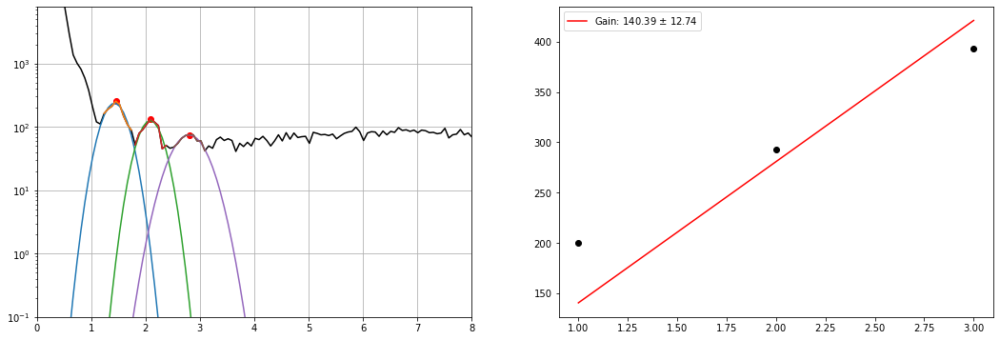

12.740374019704126
Guess:  [245, 203.88771290577262, 10]
Params:  [235.32316793 201.10648886  24.02248956]
Guess:  [119, 293.9041964222561, 10]
Params:  [121.60696432 296.69484354  29.45622745]
Guess:  [78, 383.9206799387396, 10]
Params:  [ 75.23126198 389.802497    32.05220446]


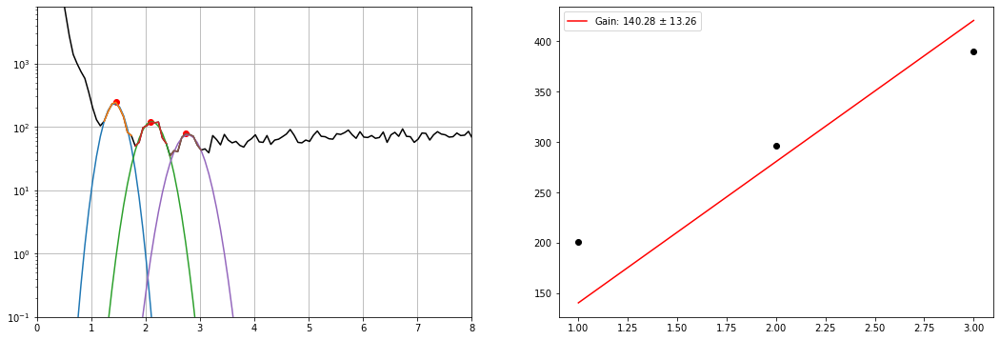

13.260469614346015
Guess:  [247, 203.88771290577262, 10]
Params:  [224.60431677 201.86967728  23.52530206]
Guess:  [107, 293.9041964222561, 10]
Params:  [103.70728137 297.08739961  34.48380887]
Guess:  [86, 393.9225114405711, 10]
Params:  [ 74.16960507 394.01537805  34.49710252]


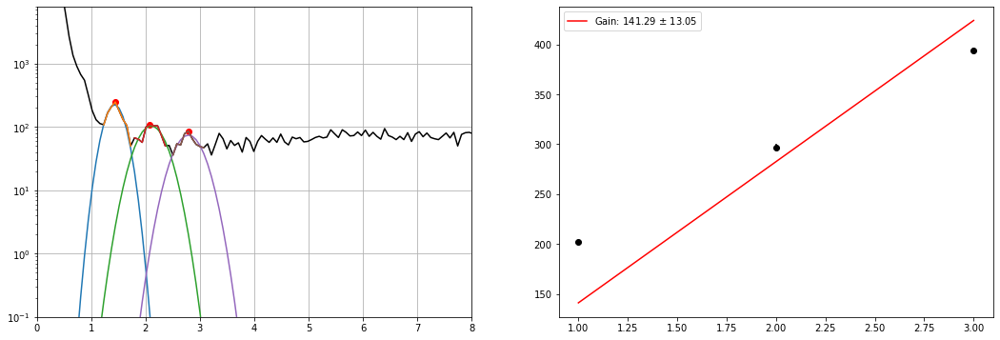

13.054364773753415
Guess:  [247, 203.88771290577262, 10]
Params:  [235.85691344 203.35007352  23.85530284]
Guess:  [134, 293.9041964222561, 10]
Params:  [112.21063412 293.07644269  29.14848805]
Guess:  [71, 383.9206799387396, 10]
Params:  [ 65.98053433 390.43608448  41.0486122 ]


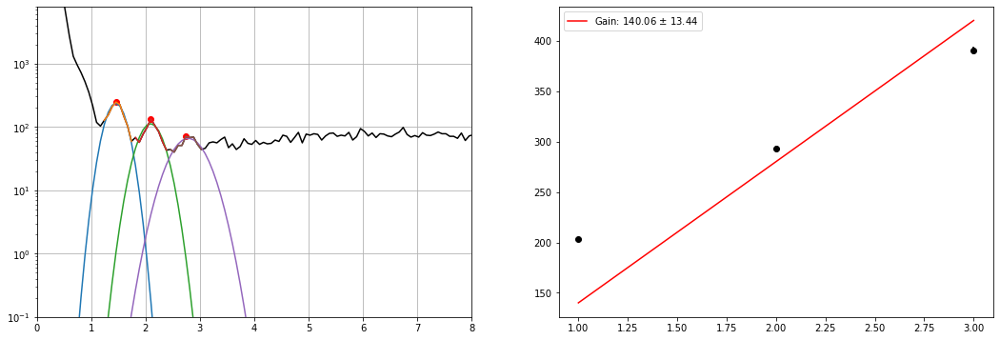

13.440614519214185
Guess:  [237, 203.88771290577262, 10]
Params:  [231.8032878  202.04771409  25.30388319]
Guess:  [130, 293.9041964222561, 10]
Params:  [114.87430743 298.35899881  30.54736824]
Guess:  [72, 383.9206799387396, 10]
Params:  [ 67.38888145 391.68166144  43.73663341]


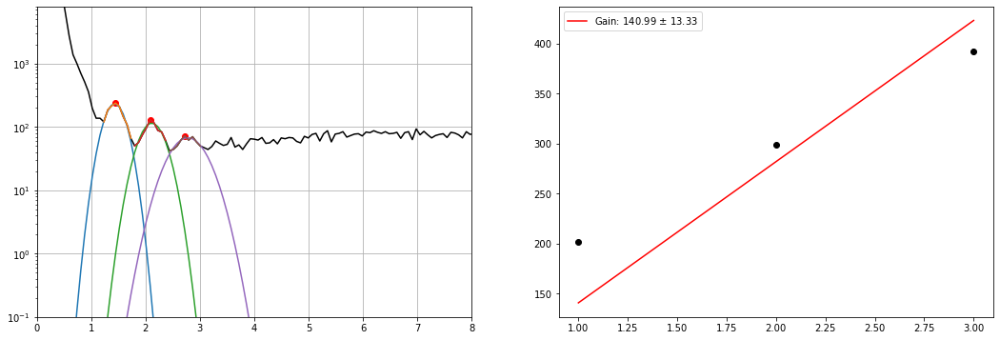

13.329982239468288
Guess:  [279, 203.88771290577262, 10]
Params:  [262.72837605 201.66672827  23.20963229]
Guess:  [113, 293.9041964222561, 10]
Params:  [106.92274256 295.54097784  35.78585604]
Guess:  [90, 393.9225114405711, 10]
Params:  [ 76.39335812 389.07261175  30.5569651 ]


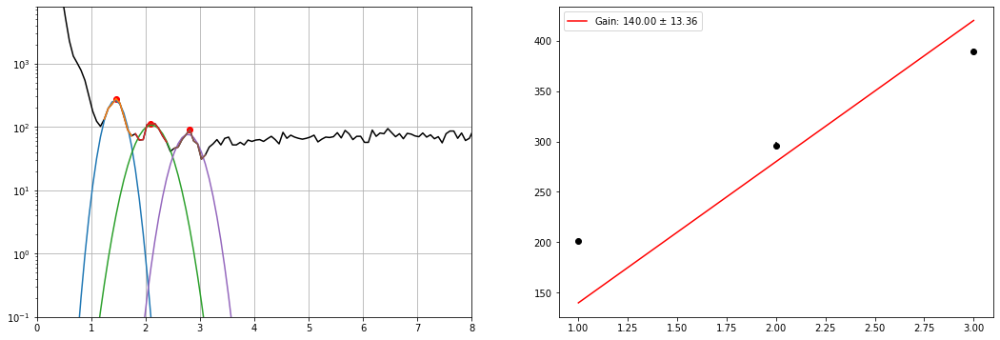

13.364145413888373
Guess:  [252, 193.88588140394108, 10]
Params:  [239.89239717 198.21271876  23.17640523]
Guess:  [116, 293.9041964222561, 10]
Params:  [111.90420532 294.97558657  28.52269747]
Guess:  [79, 393.9225114405711, 10]
Params:  [ 70.95977806 397.98936026  43.7700263 ]


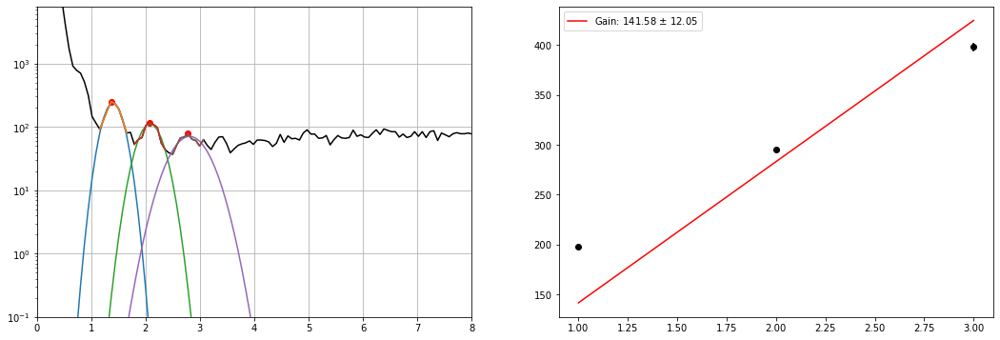

12.045256482953405
Guess:  [232, 193.88588140394108, 10]
Params:  [231.95462689 200.22691635  27.86545455]
Guess:  [117, 283.90236492042465, 10]
Params:  [ 97.31512141 288.63926441  42.70194341]
Guess:  [84, 393.9225114405711, 10]
Params:  [ 73.25503974 388.74436344  44.6906873 ]


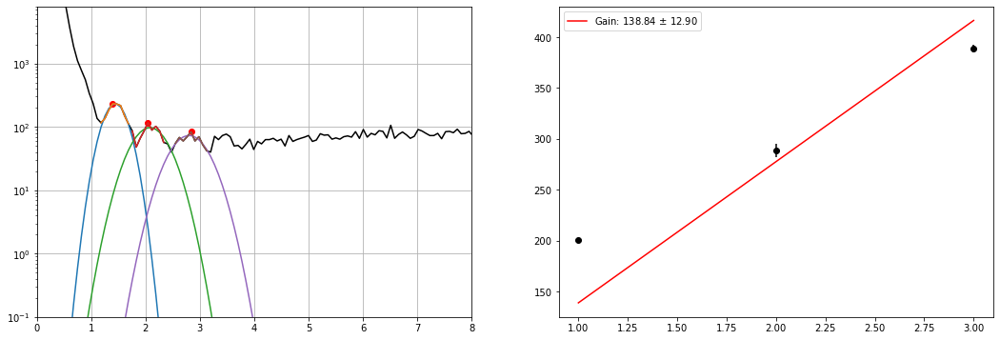

12.90064366499105
Guess:  [231, 203.88771290577262, 10]
Params:  [213.8352001  202.72191425  26.23887446]
Guess:  [131, 303.9060279240876, 10]
Params:  [120.13921681 297.02375466  29.40548569]
Guess:  [79, 393.9225114405711, 10]
Params:  [ 76.06558735 394.23610023  34.60504888]


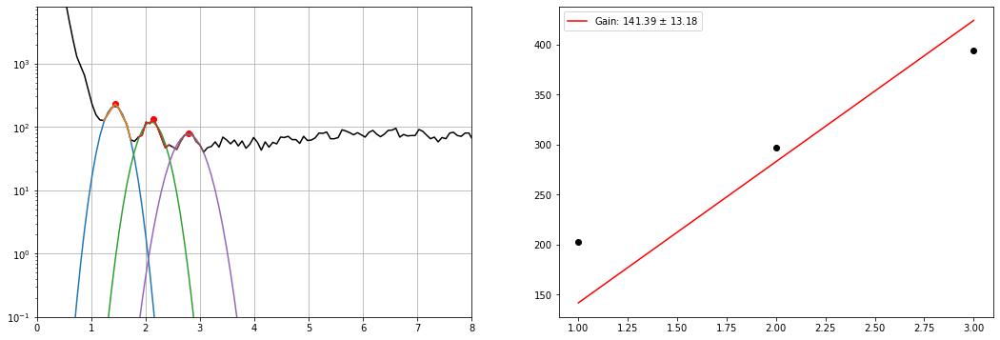

13.175364721726687
Guess:  [244, 203.88771290577262, 10]
Params:  [241.8135773  201.79048248  24.22082642]
Guess:  [118, 293.9041964222561, 10]
Params:  [113.02129185 294.54495846  31.22701391]
Guess:  [91, 393.9225114405711, 10]
Params:  [ 77.66955762 392.36483865  34.82016379]


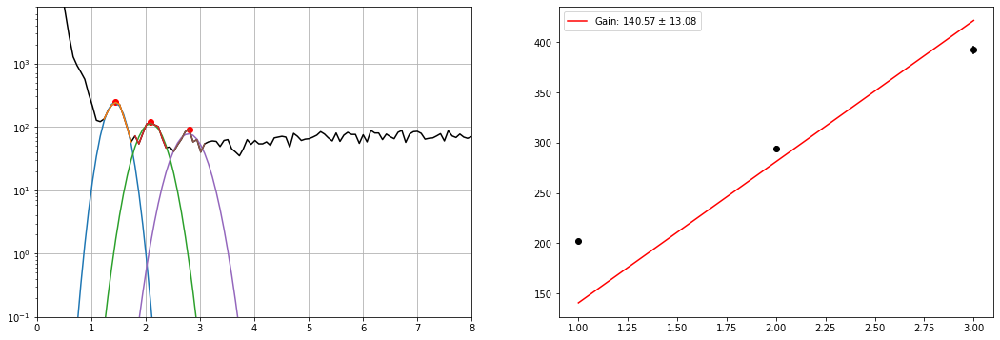

13.077760356140603
Guess:  [275, 193.88588140394108, 10]
Params:  [258.56520113 199.26195726  27.29684804]
Guess:  [124, 303.9060279240876, 10]
Params:  [119.59950596 297.00846431  32.35428034]
Guess:  [95, 393.9225114405711, 10]
Params:  [ 82.87968738 385.44248402  38.71654885]


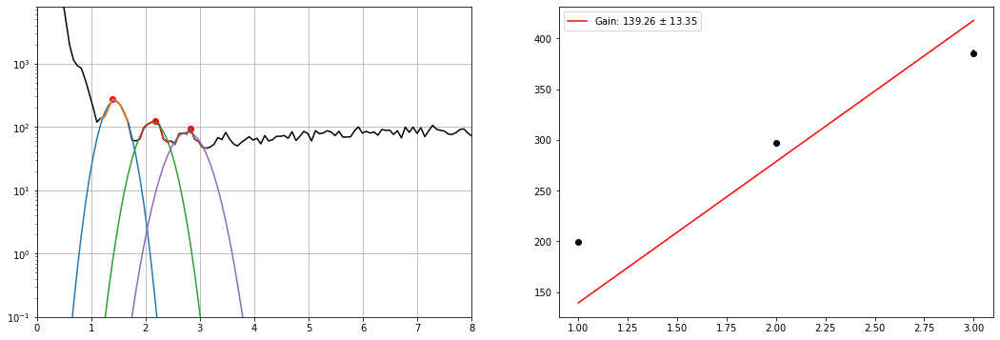

13.346713188690346
Guess:  [230, 203.88771290577262, 10]
Params:  [239.00737832 198.83487232  23.50417473]
Guess:  [129, 303.9060279240876, 10]
Params:  [110.26296084 296.84388848  30.70333921]
Guess:  [83, 393.9225114405711, 10]
Params:  [ 74.03095775 390.60346224  36.29474118]


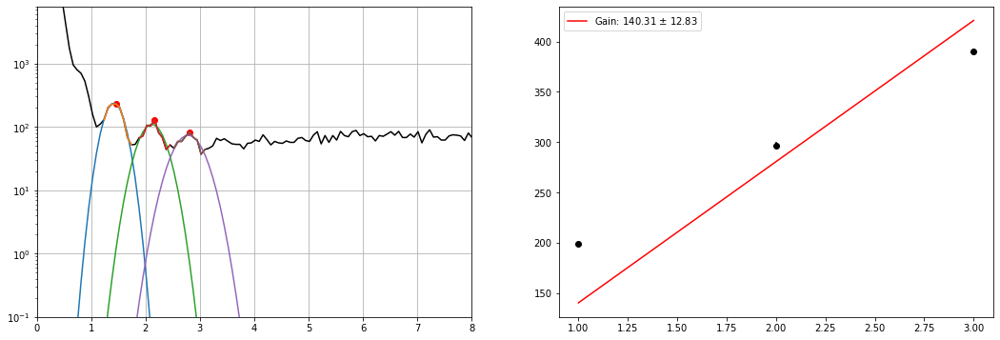

12.82864287861793
Guess:  [264, 203.88771290577262, 10]
Params:  [247.20767846 201.4860399   24.58854472]
Guess:  [124, 293.9041964222561, 10]
Params:  [114.54605532 291.34168099  29.35467487]
Guess:  [100, 383.9206799387396, 10]
Params:  [ 83.51395291 385.409813    30.11630016]


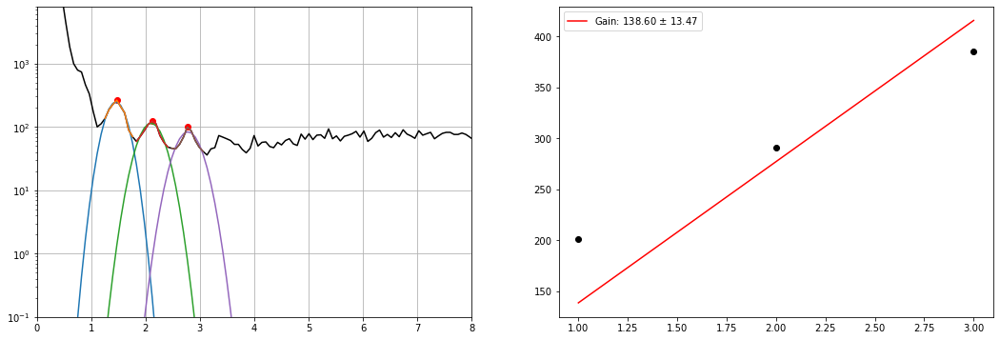

13.467161974895038
Guess:  [244, 193.88588140394108, 10]
Params:  [235.44624676 201.40517819  27.98879209]
Guess:  [121, 293.9041964222561, 10]
Params:  [116.58102873 298.0040805   32.91904469]
Guess:  [78, 383.9206799387396, 10]
Params:  [ 70.95150583 393.46135052  40.41819754]


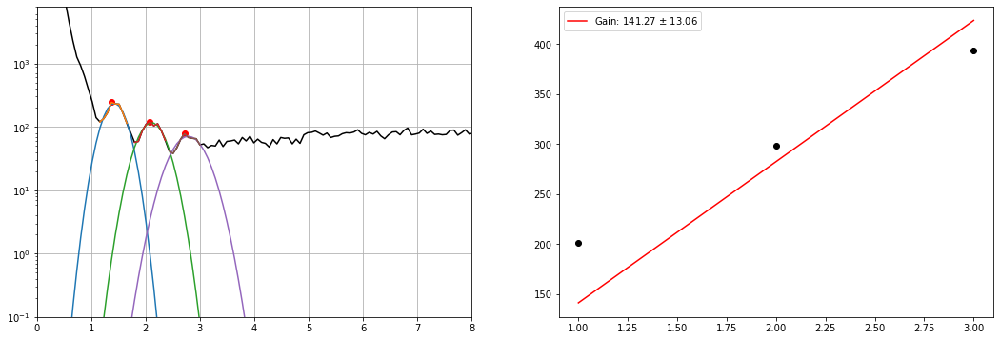

13.060871192816771
Guess:  [223, 193.88588140394108, 10]
Params:  [218.22936033 199.67875626  29.825694  ]
Guess:  [113, 303.9060279240876, 10]
Params:  [108.74990481 296.30468142  35.19968026]
Guess:  [77, 383.9206799387396, 10]
Params:  [ 67.28856311 383.76551388  40.43025725]


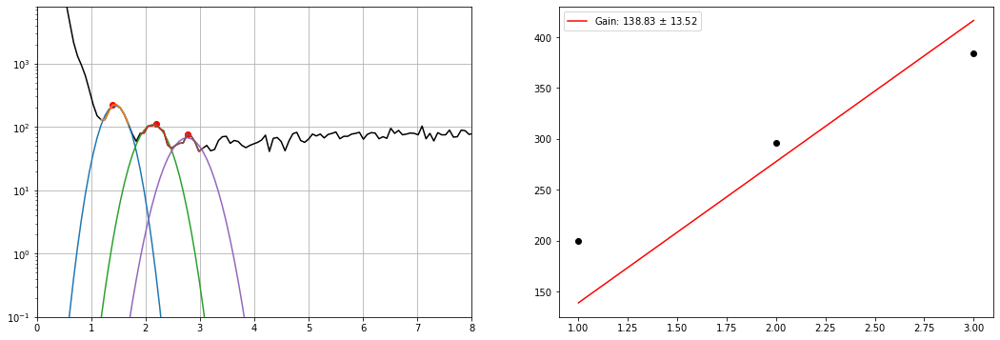

13.523903615015511
Guess:  [258, 203.88771290577262, 10]
Params:  [243.65793476 200.79750213  24.35131907]
Guess:  [118, 293.9041964222561, 10]
Params:  [114.1870289  294.89537698  30.40457712]
Guess:  [77, 393.9225114405711, 10]
Params:  [ 72.65685004 386.44872492  39.43419641]


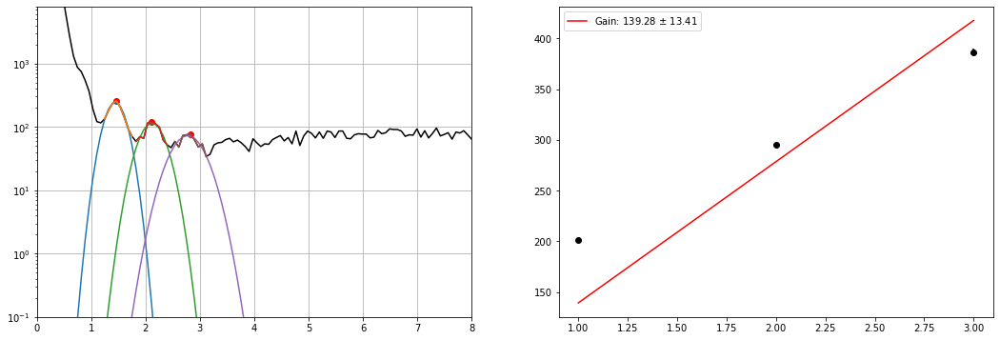

13.411961245306536
Guess:  [251, 203.88771290577262, 10]
Params:  [248.73530036 202.75407441  24.02572468]
Guess:  [123, 293.9041964222561, 10]
Params:  [116.65227023 296.96368553  30.83019268]
Guess:  [83, 393.9225114405711, 10]
Params:  [ 76.08740645 391.48180617  37.27455334]


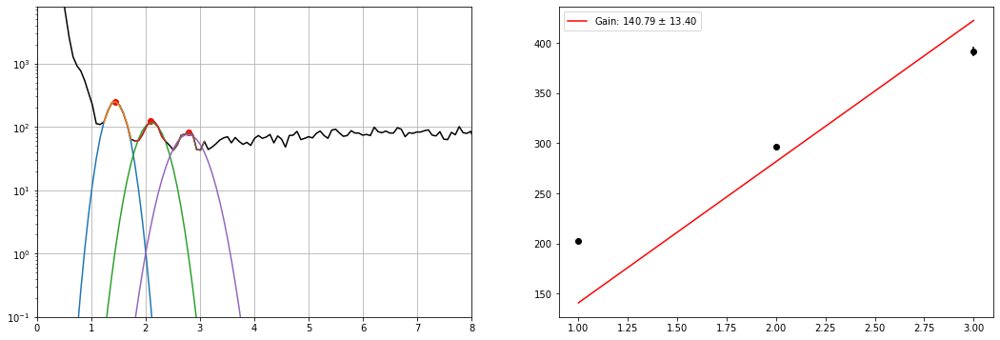

13.403470273601997
Guess:  [284, 203.88771290577262, 10]
Params:  [264.02076183 203.2158523   22.43325584]
Guess:  [121, 283.90236492042465, 10]
Params:  [112.03398122 292.69690663  31.39129372]
Guess:  [78, 373.91884843690815, 10]
Params:  [ 67.90664466 386.19055017  41.69925081]


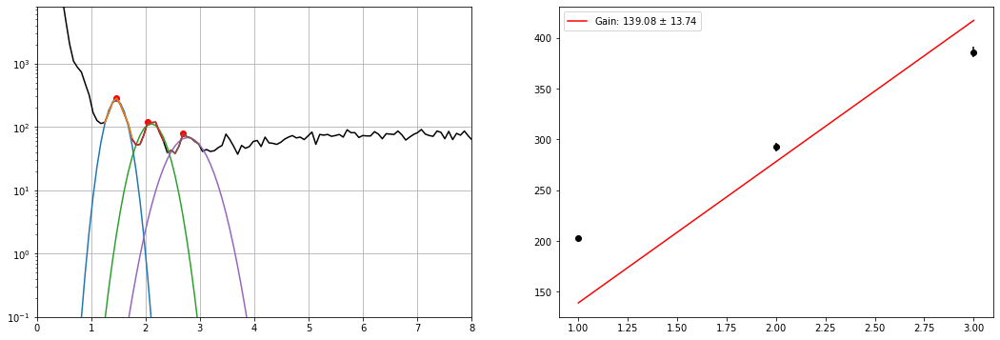

13.743566470430281
Guess:  [264, 203.88771290577262, 10]
Params:  [247.4464714  200.58564292  24.68576939]
Guess:  [117, 293.9041964222561, 10]
Params:  [112.06763639 294.21894785  29.75855882]
Guess:  [76, 393.9225114405711, 10]
Params:  [ 74.3690728  394.89166378  38.98418494]


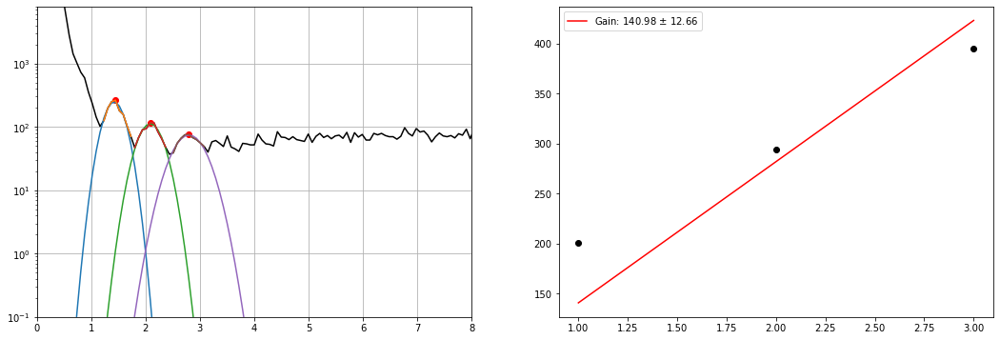

12.662971440456818
Guess:  [247, 203.88771290577262, 10]
Params:  [233.79826098 202.5313194   23.71144679]
Guess:  [126, 283.90236492042465, 10]
Params:  [111.9345094  293.96291629  33.63030222]
Guess:  [77, 403.92434294240263, 10]
Params:  [ 72.99105733 391.34900321  46.77578331]


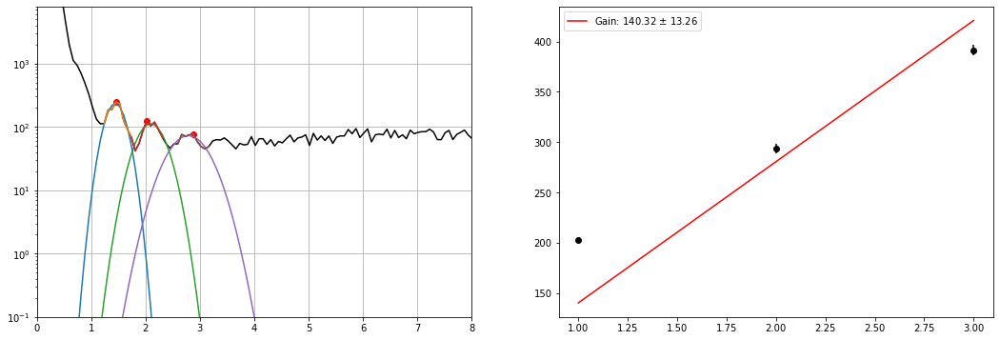

13.261867218733805
Guess:  [237, 203.88771290577262, 10]
Params:  [237.14637071 201.79570009  24.77989468]
Guess:  [129, 293.9041964222561, 10]
Params:  [121.00559706 293.44407314  28.91192432]
Guess:  [76, 383.9206799387396, 10]
Params:  [ 72.9477562  387.42005723  42.32164451]


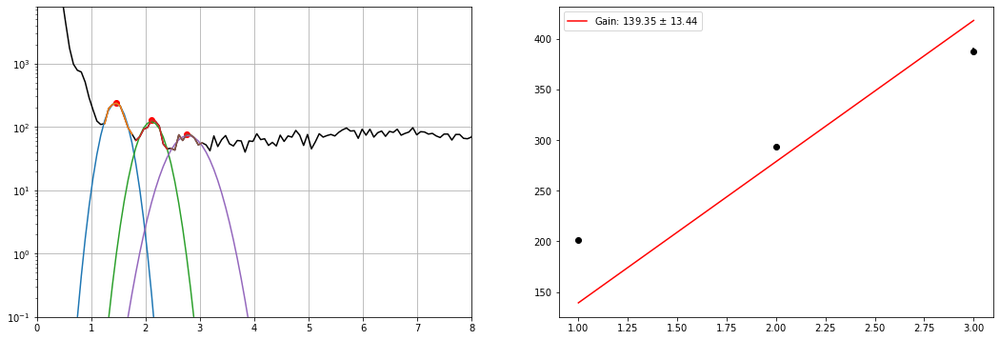

13.436419685904486
Guess:  [262, 203.88771290577262, 10]
Params:  [263.44119075 201.45055804  22.82243046]
Guess:  [116, 303.9060279240876, 10]
Params:  [110.42541359 296.82252759  32.85980942]
Guess:  [84, 393.9225114405711, 10]
Params:  [ 74.49814347 394.5095528   35.86062292]


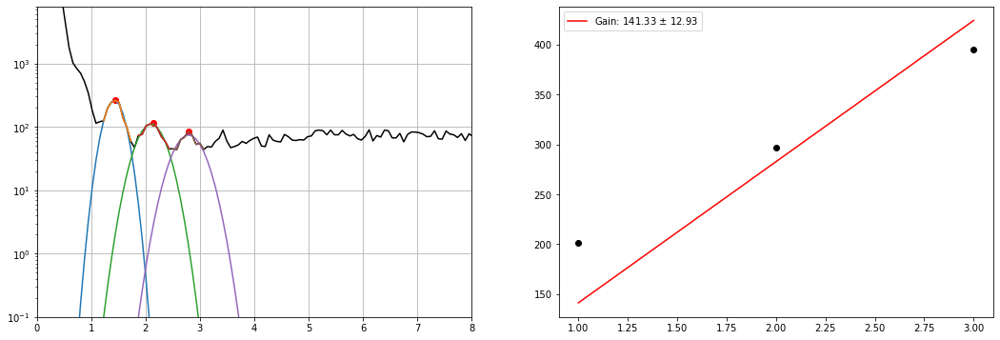

12.934112538520898
Guess:  [268, 203.88771290577262, 10]
Params:  [260.3606278  201.65566982  23.38056033]
Guess:  [134, 293.9041964222561, 10]
Params:  [128.63711428 293.59602912  27.31636345]
Guess:  [86, 393.9225114405711, 10]
Params:  [ 74.6954743  390.02636949  39.34579675]


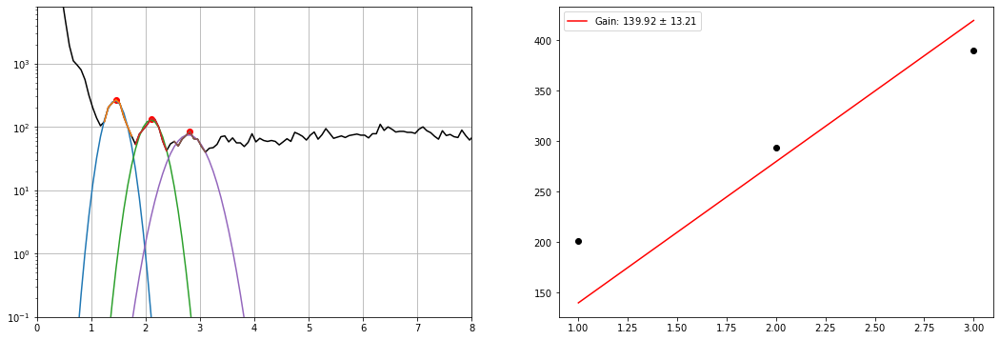

13.207965475230484
Guess:  [250, 203.88771290577262, 10]
Params:  [239.71506923 200.03329056  24.53621872]
Guess:  [115, 293.9041964222561, 10]
Params:  [108.97607594 296.41759366  31.79497485]
Guess:  [92, 393.9225114405711, 10]
Params:  [ 84.30711422 391.2941632   31.04092291]


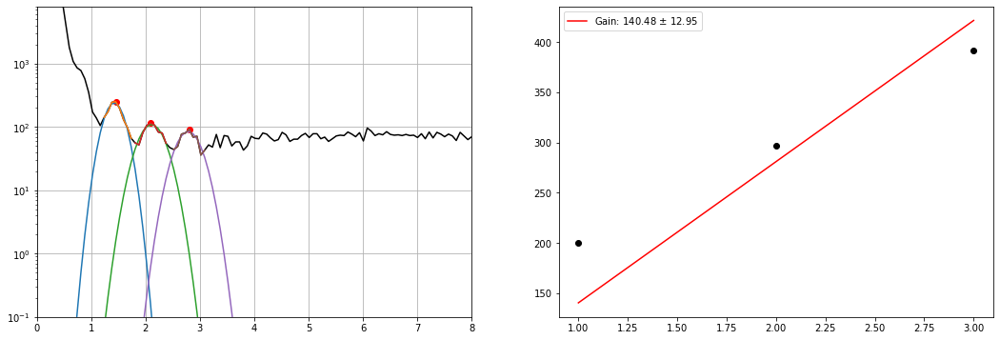

12.948114817588912
Guess:  [260, 193.88588140394108, 10]
Params:  [252.44115245 200.61683374  25.80843742]
Guess:  [145, 293.9041964222561, 10]
Params:  [117.41811353 293.57351175  29.06073149]
Guess:  [100, 393.9225114405711, 10]
Params:  [ 91.00018963 389.82706371  31.13442167]


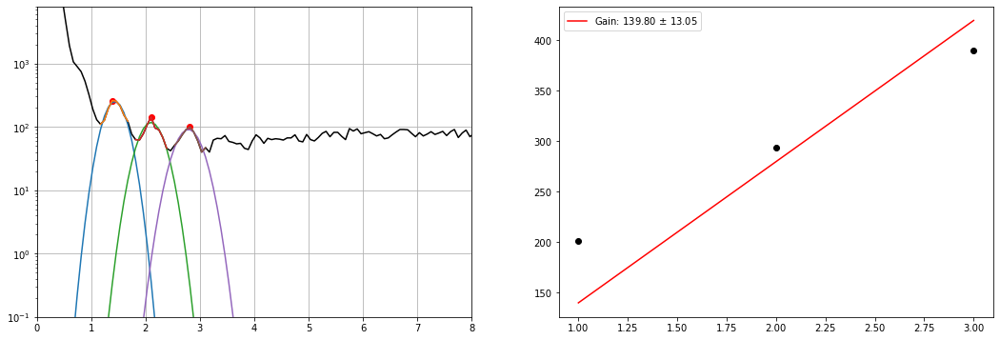

13.05004753690206
Guess:  [242, 193.88588140394108, 10]
Params:  [239.71333838 200.81994104  26.8009966 ]
Guess:  [120, 293.9041964222561, 10]
Params:  [118.23380744 296.41440877  30.30736987]
Guess:  [99, 393.9225114405711, 10]
Params:  [ 75.28167185 386.25137928  41.94677187]


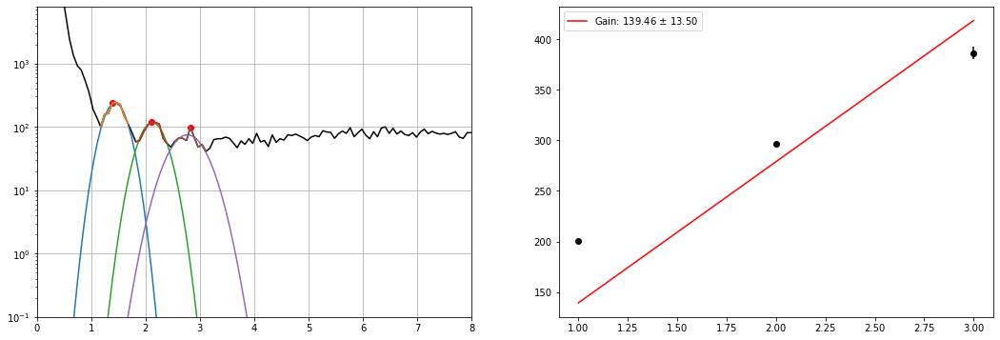

13.500456131028939
Guess:  [248, 203.88771290577262, 10]
Params:  [242.20066842 200.16004668  24.77023439]
Guess:  [130, 293.9041964222561, 10]
Params:  [114.11256512 294.22329084  27.54709909]
Guess:  [88, 393.9225114405711, 10]
Params:  [ 72.10878962 387.79647921  40.82156642]


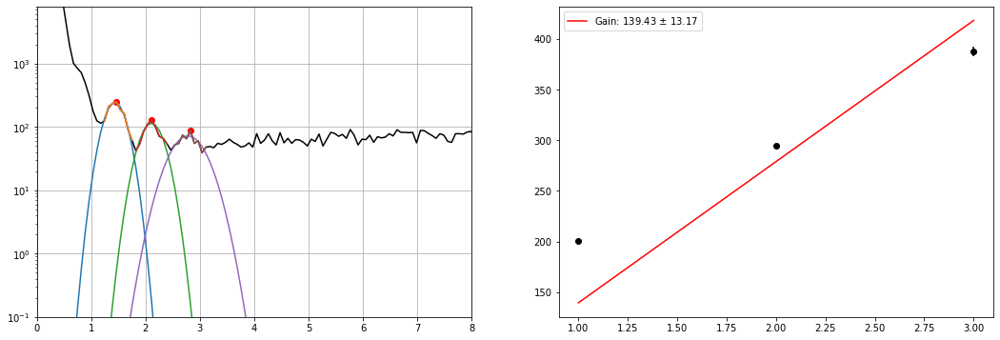

13.166548498317985
Guess:  [259, 203.88771290577262, 10]
Params:  [242.8032999  200.27555965  24.18028824]
Guess:  [126, 293.9041964222561, 10]
Params:  [118.38553142 294.1892089   26.73308726]
Guess:  [75, 393.9225114405711, 10]
Params:  [ 73.19362427 389.52743173  37.35824318]


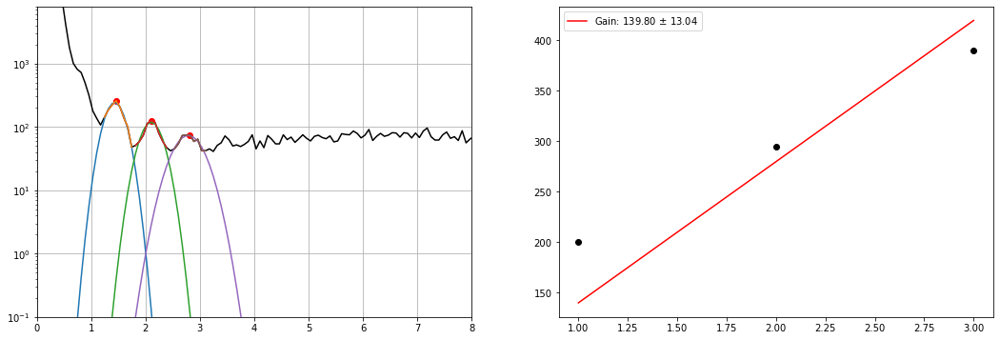

13.04184004733751
Guess:  [248, 203.88771290577262, 10]
Params:  [239.02219557 200.42500244  24.30780717]
Guess:  [110, 293.9041964222561, 10]
Params:  [104.04588933 295.09805877  34.99901934]
Guess:  [84, 393.9225114405711, 10]
Params:  [ 68.42822618 395.23802834  51.37633019]


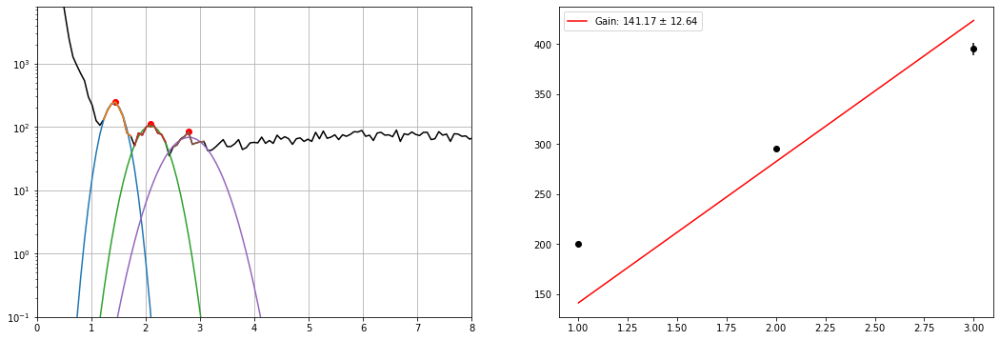

12.63954634990875
Guess:  [253, 203.88771290577262, 10]
Params:  [241.20001304 201.5501042   23.01341776]
Guess:  [136, 293.9041964222561, 10]
Params:  [123.98765821 292.86286022  24.7211246 ]
Guess:  [79, 393.9225114405711, 10]
Params:  [ 69.75313609 389.51136106  42.66561265]


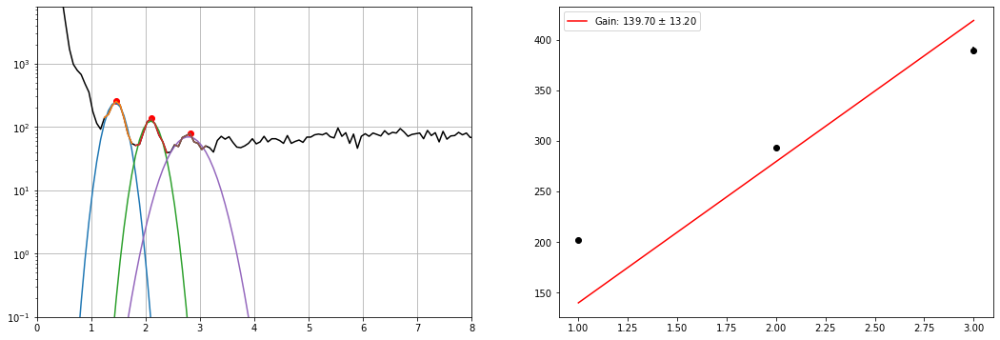

13.204668365481544
Guess:  [241, 193.88588140394108, 10]
Params:  [229.70313929 201.49724773  24.02840583]
Guess:  [128, 293.9041964222561, 10]
Params:  [110.64436159 297.48711862  26.77980742]
Guess:  [80, 393.9225114405711, 10]
Params:  [ 71.70690139 392.0476902   36.21728919]


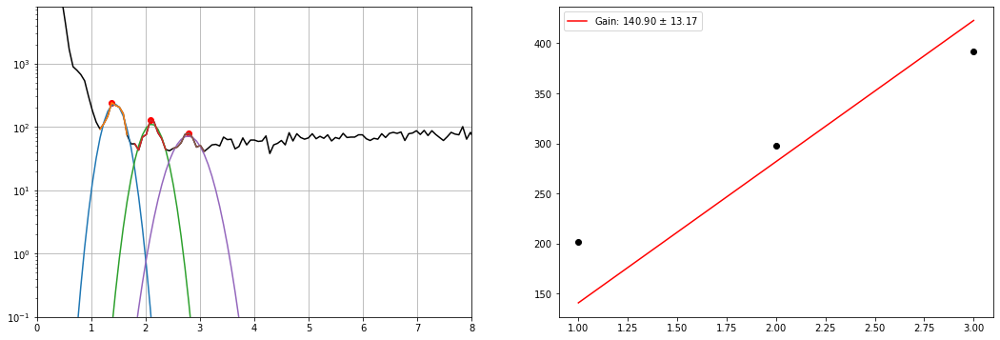

13.171500948420913
Guess:  [275, 203.88771290577262, 10]
Params:  [273.41674014 202.01402293  23.81585501]
Guess:  [120, 303.9060279240876, 10]
Params:  [123.11473739 296.00266343  30.29770933]
Guess:  [86, 413.92617444423416, 10]
Params:  [ 76.66419526 393.27879797  52.28983064]


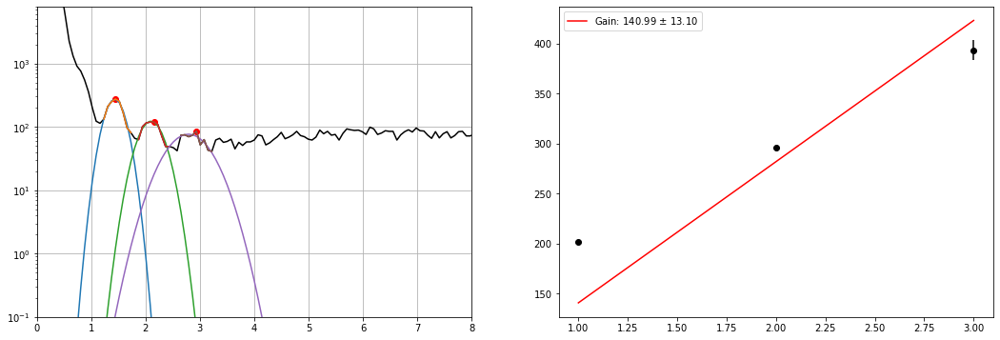

13.095983366820375
Guess:  [234, 203.88771290577262, 10]
Params:  [224.58924059 203.73670225  26.88298764]
Guess:  [104, 303.9060279240876, 10]
Params:  [ 96.16610168 298.25388071  37.25519809]
Guess:  [81, 393.9225114405711, 10]
Params:  [ 72.12446116 389.29065859  39.292141  ]


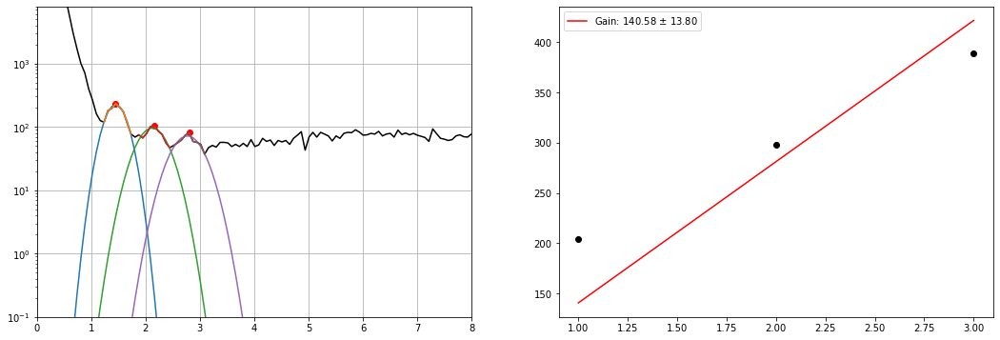

13.802082542223658
Guess:  [220, 193.88588140394108, 10]
Params:  [225.21265329 199.39134667  29.13508599]
Guess:  [117, 303.9060279240876, 10]
Params:  [113.16938032 297.39029266  33.84131614]
Guess:  [81, 373.91884843690815, 10]
Params:  [ 68.22669091 378.96847762  51.8669733 ]


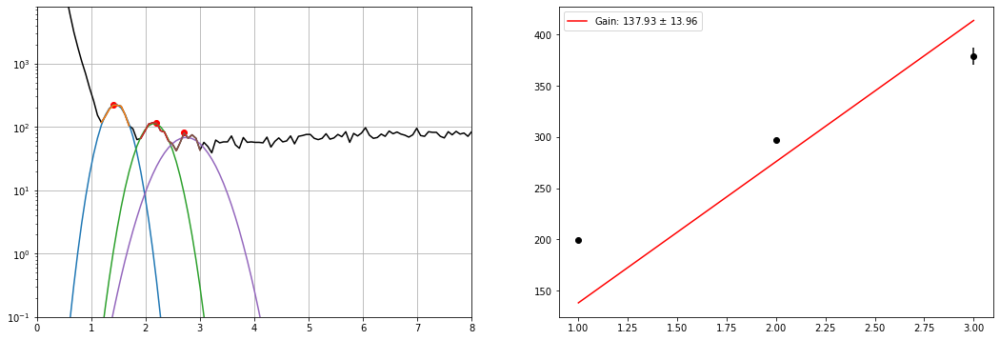

13.956039192766974


In [9]:
SRS_gain_10 = 10 # gain on the SRS bandpass filter
# peak_threshold = 700 # upper bound of pedestal
# breakdown = 27.4 # breakdown voltage of the SiPM
pedestal_10 = 275 # center of noise pedestal peak
for file_type, data in data_POS_FIELD.items():
    data['new_gain'] = np.empty(len(data['gain']))
    data['new_gain_err'] = np.empty(len(data['gain_err']))
    for i, (pe_data, counts, gain, volts) in enumerate(zip(data['pe_data'], data['counts'], data['gain'], data['file_volts'])):
        new_gain, new_gain_err = plot_fit_gain(pe_data, counts, gain, volts, file_type, 25, SRS_gain_10, offset_means[file_type]) # pe, counts, voltage, file type, distance, gain, dc offset
        data['new_gain'][i] = new_gain
        data['new_gain_err'][i] = new_gain_err

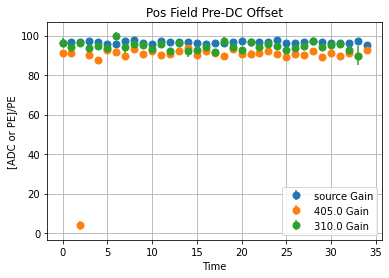

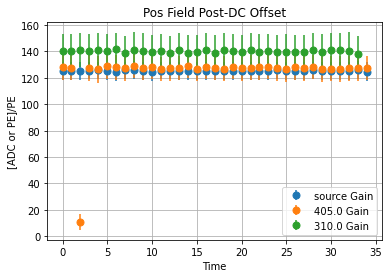

In [10]:
# plotting the gain over time

# getting the "time"
time_POS_FIELD = {}
plt.figure(figsize=(6,4))
plt.ylabel('[ADC or PE]/PE')
plt.xlabel('Time')
plt.title('Pos Field Pre-DC Offset')
plt.grid()

for key in data_POS_FIELD:
    time_POS_FIELD[key] = np.arange(0, len(data_POS_FIELD[key]['gain']))
    plt.errorbar(time_POS_FIELD[key],data_POS_FIELD[key]['gain'],yerr=data_POS_FIELD[key]['gain_err'],fmt='o',ms=7,label= str(key)+' Gain')
plt.legend(loc='best')
plt.figure(figsize=(6,4))
for key in data_POS_FIELD:
    plt.errorbar(time_POS_FIELD[key],data_POS_FIELD[key]['new_gain'],yerr=data_POS_FIELD[key]['new_gain_err'],fmt='o',ms=7,label= str(key)+' Gain')
# plt.errorbar(time_NO_FIELD,NO_FIELD_pe_corrected_gain,yerr=NO_FIELD_pe_corrected_gain_err,fmt='o',ms=7,label='PE Calibrated Gain')

plt.ylabel('[ADC or PE]/PE')
plt.xlabel('Time')
plt.title('Pos Field Post-DC Offset')
plt.grid()
plt.legend(loc='best')
# plt.savefig('NO_FIELD_gain_comparison.pdf')
plt.show()

In [8]:
calibrated_data_POS = {}
calibrated_data_NEG = {}
calibrated_data_NO = {}

for file_type, data_pos, data_neg, data_no in zip(data_POS_FIELD.keys(), data_POS_FIELD.values(), data_NEG_FIELD.values(), data_NO_FIELD.values()):
# calibrating the data using the pre-dc offset gain fits
    
#     # making a mask to eliminate outlier data
#     mask_pos = np.ma.masked_array(data_POS_FIELD[file_type]['dc_offset'], np.isnan(data_POS_FIELD[file_type]['dc_offset']))
#     mask_neg = np.ma.masked_array(data_NEG_FIELD[file_type]['dc_offset'], np.isnan(data_NEG_FIELD[file_type]['dc_offset']))
#     mask_no = np.ma.masked_array(data_NO_FIELD[file_type]['dc_offset'], np.isnan(data_NO_FIELD[file_type]['dc_offset']))
    
    mean_gain_pos = np.mean(data_POS_FIELD[file_type]['gain'])
    mean_gain_neg = np.mean(data_NEG_FIELD[file_type]['gain'])
    mean_gain_no = np.mean(data_NO_FIELD[file_type]['gain'])
    
#     # calibrating for all fields
#     if file_type != 'source':
#         # subtracting the source off of the LED data
#         data_POS_FIELD[file_type]['counts'] = data_POS_FIELD[file_type]['counts'] - np.mean(data_POS_FIELD[file_type]['counts'], axis=0)
#         data_NEG_FIELD[file_type]['counts'] = data_NEG_FIELD[file_type]['counts'] - np.mean(data_NEG_FIELD[file_type]['counts'], axis=0)
#         data_NO_FIELD[file_type]['counts'] = data_NO_FIELD[file_type]['counts'] - np.mean(data_NO_FIELD[file_type]['counts'], axis=0)
        
    calibrated_data_POS[file_type] = data_pos['pe_data']/mean_gain_pos + offset_means[file_type]
    calibrated_data_NEG[file_type] = data_neg['pe_data']/mean_gain_neg + offset_means[file_type]
    calibrated_data_NO[file_type] = data_no['pe_data']/mean_gain_no + offset_means[file_type]

calibrated_data_NO_srs5 = {}

for file_type, data_no in zip(data_NO_FIELD_srs5.keys(), data_NO_FIELD_srs5.values()):
    # assuming the gain is half that of the srs gain 10 data
    mean_gain_no = np.mean(data_NO_FIELD[file_type]['gain'])/2
    
    calibrated_data_NO_srs5[file_type] = data_no['pe_data']/mean_gain_no + offset_means[file_type]

<Figure size 1440x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

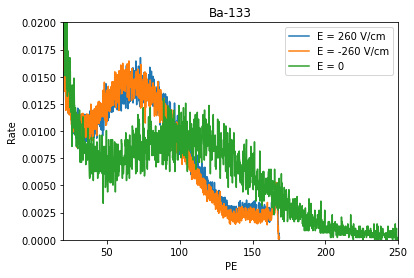

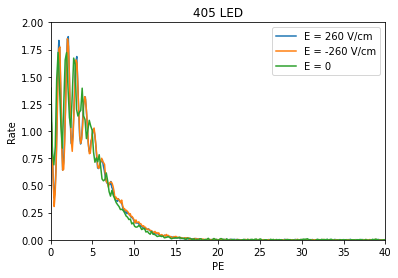

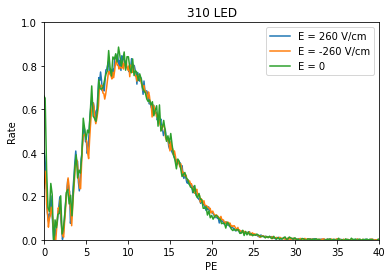

In [9]:
col_list = ['k', 'b', 'purple']
norm_range = [30, 120]
norm_range_0 = [50, 200]
fig1 = plt.figure(figsize=(20,4))
fig2 = plt.figure(figsize=(6,4))
for i, file_type in enumerate(['source', 405.0, 310.0]):
    b_pos = np.mean(calibrated_data_POS[file_type], axis=0)
    c_pos = np.mean(data_POS_FIELD[file_type]['counts'], axis=0)
    b_neg = np.mean(calibrated_data_NEG[file_type], axis=0)
    c_neg = np.mean(data_NEG_FIELD[file_type]['counts'], axis=0)
    b_no = np.mean(calibrated_data_NO_srs5[file_type], axis=0)
    c_no = np.mean(data_NO_FIELD_srs5[file_type]['counts'], axis=0)
    
    gpts_pos = (b_pos < norm_range[1]) & (b_pos > norm_range[0])
    norm_fac_pos = np.trapz(c_pos[gpts_pos], b_pos[gpts_pos])
    gpts_neg = (b_neg < norm_range[1]) & (b_neg > norm_range[0])
    norm_fac_neg = np.trapz(c_neg[gpts_neg], b_neg[gpts_neg])
    gpts_no = (b_no < norm_range_0[1]) & (b_no > norm_range_0[0])
    norm_fac_no = np.trapz(c_no[gpts_no], b_no[gpts_no])
#     else:
#         norm_fac_pos = 1
#         norm_fac_neg = 1
#         norm_fac_no = 1

    if(file_type == "source"):
        ref_hist_pos = c_pos/norm_fac_pos
        ref_hist_neg = c_neg/norm_fac_neg
        ref_hist_no = c_no/norm_fac_no
#     try:
    new_c_pos = c_pos/norm_fac_pos
    new_c_neg = c_neg/norm_fac_neg
    new_c_no = c_no/norm_fac_no
#     except ValueError:
#         new_c = c/norm_fac[:-1]
    if file_type == 'source':
        plt.figure()
        plt.title('Ba-133')
        plt.ylabel('Rate')
        plt.xlabel('PE')
        plt.plot(b_pos, new_c_pos, label='E = 260 V/cm')
        plt.plot(b_neg, new_c_neg, label='E = -260 V/cm')
        plt.plot(b_no, new_c_no, label='E = 0')
        plt.ylim(0, .02)
        plt.xlim(20, 250)
        plt.legend()
        plt.savefig('sourceplot.jpeg')
#     plt.xlim(0,1000)
    elif file_type == 405.0:
        plt.figure()
        plt.title('405 LED')
        plt.ylabel('Rate')
        plt.xlabel('PE')
        plt.plot(b_pos, new_c_pos - ref_hist_pos, label='E = 260 V/cm')
        plt.plot(b_neg, new_c_neg - ref_hist_neg, label='E = -260 V/cm')
        plt.plot(b_no, new_c_no - ref_hist_no, label='E = 0')
        plt.ylim(0, 2)
        plt.xlim(0,40)
        plt.legend()
        plt.savefig('405plot.jpeg')
        
#     try:
    elif file_type == 310.0:
        plt.figure()
        plt.title('310 LED')
        plt.ylabel('Rate')
        plt.xlabel('PE')
        plt.plot(b_pos, new_c_pos - ref_hist_pos, label='E = 260 V/cm')
        plt.plot(b_neg, new_c_neg - ref_hist_neg, label='E = -260 V/cm')
        plt.plot(b_no, new_c_no - ref_hist_no, label='E = 0')
        plt.ylim(0, 1)
        plt.xlim(0,40)
        plt.legend()
        plt.savefig('310plot.jpeg')
#     except ValueError:
#         plt.plot(b, new_c - ref_hist[:-1], color=col_list[i])
#     plt.ylim(0,0.5)
#     plt.xlim(0,40)

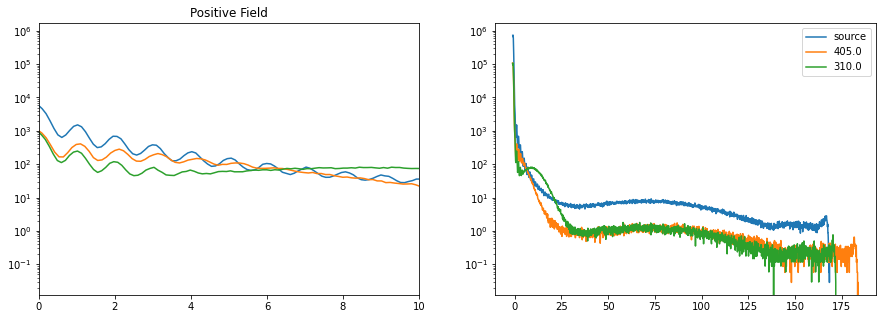

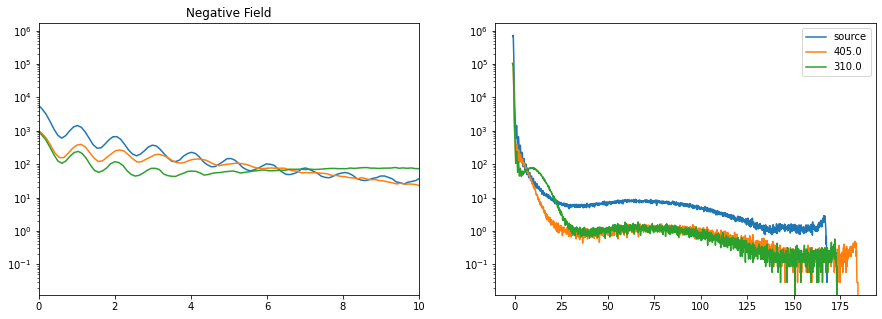

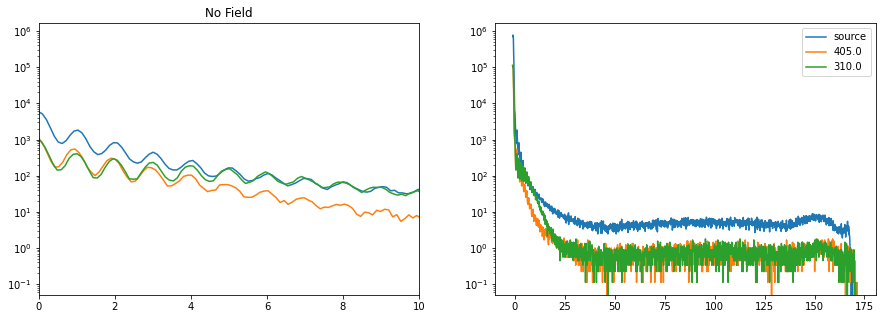

In [11]:
mean_data_pos = {'source':{}, 405.0:{}, 310.0:{}}
mean_data_neg = {'source':{}, 405.0:{}, 310.0:{}}
mean_data_no = {'source':{}, 405.0:{}, 310.0:{}}

plt.figure(figsize=(15,5))

for file_type in data_POS_FIELD:
#     if file_type == 405.0:
#         calibrated_data_POS[file_type] = np.concatenate((calibrated_data_POS[file_type][:2], calibrated_data_POS[file_type][3:]))
    plt.subplot(1,2,1)
    plt.title('Positive Field')
    plt.yscale('log')
    plt.xlim(0, 10)
    mean_data_pos[file_type]['pe_data'] = np.mean(calibrated_data_POS[file_type], axis=0)
    mean_data_pos[file_type]['counts'] = np.mean(data_POS_FIELD[file_type]['counts'], axis=0)
    plt.plot(mean_data_pos[file_type]['pe_data'], mean_data_pos[file_type]['counts'], label=file_type)
#     for x, y in zip(calibrated_data_POS[file_type], data_POS_FIELD[file_type]['counts']):
#         plt.plot(x, y)
    plt.subplot(1,2,2)
    plt.yscale('log')
    plt.plot(mean_data_pos[file_type]['pe_data'], mean_data_pos[file_type]['counts'], label=file_type)
#     plt.plot(calibrated_data_POS[file_type][0], data_POS_FIELD[file_type]['counts'][0], label=file_type)
plt.legend()
plt.savefig('posfieldplot.jpeg')

plt.figure(figsize=(15,5))
for file_type in data_NEG_FIELD:
    plt.subplot(1,2,1)
    plt.title('Negative Field')
    plt.yscale('log')
    plt.xlim(0, 10)
    mean_data_neg[file_type]['pe_data'] = np.mean(calibrated_data_NEG[file_type], axis=0)
    mean_data_neg[file_type]['counts'] = np.mean(data_NEG_FIELD[file_type]['counts'], axis=0)
    plt.plot(mean_data_neg[file_type]['pe_data'], mean_data_neg[file_type]['counts'], label=file_type)
#     for x, y in zip(calibrated_data_NEG[file_type], data_NEG_FIELD[file_type]['counts']):
#         plt.plot(x, y)
    plt.subplot(1,2,2)
    plt.yscale('log')
    plt.plot(mean_data_neg[file_type]['pe_data'], mean_data_neg[file_type]['counts'], label=file_type)
#     plt.plot(calibrated_data_POS[file_type][0], data_POS_FIELD[file_type]['counts'][0], label=file_type)
plt.legend()
plt.savefig('negfieldplot.jpeg')

plt.figure(figsize=(15,5))
for file_type in data_NO_FIELD:
    plt.subplot(1,2,1)
    plt.title('No Field')
    plt.yscale('log')
    plt.xlim(0, 10)
    mean_data_no[file_type]['pe_data'] = np.mean(calibrated_data_NO[file_type], axis=0)
    mean_data_no[file_type]['counts'] = np.mean(data_NO_FIELD[file_type]['counts'], axis=0)
    plt.plot(mean_data_no[file_type]['pe_data'], mean_data_no[file_type]['counts'], label=file_type)
#     for x, y in zip(calibrated_data_NO[file_type], data_NO_FIELD[file_type]['counts']):
#         plt.plot(x, y)
    plt.subplot(1,2,2)
    plt.yscale('log')
    plt.plot(mean_data_no[file_type]['pe_data'], mean_data_no[file_type]['counts'], label=file_type)
#     plt.plot(calibrated_data_POS[file_type][0], data_POS_FIELD[file_type]['counts'][0], label=file_type)
plt.legend()
plt.savefig('nofieldplot.jpeg')

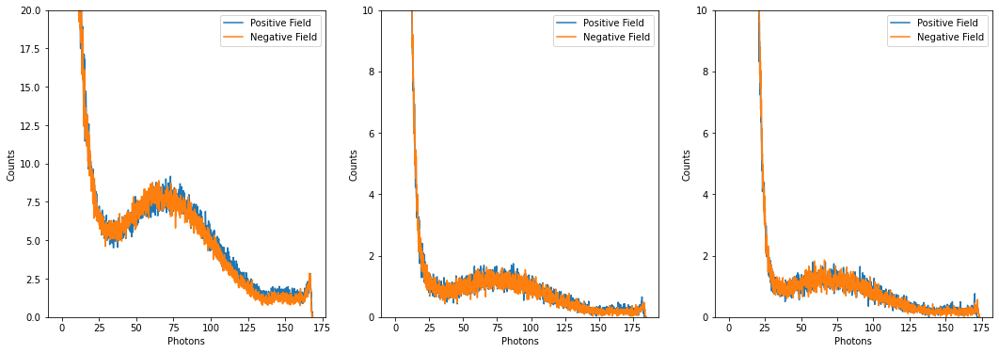

In [14]:
plt.figure(figsize=(18,6))
for i, file_type in enumerate(['source', 405.0, 310.0]):
    plt.subplot(1,3,i+1)
    if file_type == 'source':
        plt.ylim(0, 20)
    elif file_type == 405.0:
        plt.ylim(0, 10)
        
    elif file_type == 310.0:
        plt.ylim (0, 10)
    # plt.xlim(0, 20)
    # plt.yscale('log')
    plt.ylabel('Counts')
    plt.xlabel('Photons')
    plt.plot(mean_data_pos[file_type]['pe_data'], mean_data_pos[file_type]['counts'], label='Positive Field')
    plt.plot(mean_data_neg[file_type]['pe_data'], mean_data_neg[file_type]['counts'], label='Negative Field')
#     plt.plot(mean_data_no[file_type]['pe_data'], mean_data_no[file_type]['counts'], label='No Field')
    plt.legend()

## splitting the plots up by time

In [34]:
# splitting arrays into sections of 3
combined_POS = {'source':{}, 405.0:{}, 310.0:{}}
combined_NEG = {'source':{}, 405.0:{}, 310.0:{}}
for file_type in calibrated_data_POS.keys():
    n_splits_pos = 5#int(len(calibrated_data_POS[file_type])/3)
    n_splits_neg = 5#int(len(calibrated_data_NEG[file_type])/3)
    # ignoring no field for now
    
    combined_POS[file_type]['pe_data'] = np.array_split(calibrated_data_POS[file_type], n_splits_pos)
    combined_NEG[file_type]['pe_data'] = np.array_split(calibrated_data_NEG[file_type], n_splits_neg)
    combined_POS[file_type]['counts'] = np.array_split(data_POS_FIELD[file_type]['counts'], n_splits_pos)
    combined_NEG[file_type]['counts'] = np.array_split(data_NEG_FIELD[file_type]['counts'], n_splits_neg)
    
    
    for i, (each_pos, each_neg, each_pos_counts, each_neg_counts) in enumerate(zip(combined_POS[file_type]['pe_data'], combined_NEG[file_type]['pe_data'], combined_POS[file_type]['counts'], combined_NEG[file_type]['counts'])):
        combined_POS[file_type]['pe_data'][i] = np.mean(each_pos, axis=0)
        combined_NEG[file_type]['pe_data'][i] = np.mean(each_neg, axis=0)
        combined_POS[file_type]['counts'][i] = np.mean(each_pos_counts, axis=0)
        combined_NEG[file_type]['counts'][i] = np.mean(each_neg_counts, axis=0)
        
    for i, (each_pos, each_neg, each_pos_counts, each_neg_counts) in enumerate(zip(combined_POS[file_type]['pe_data'], combined_NEG[file_type]['pe_data'], combined_POS[file_type]['counts'], combined_NEG[file_type]['counts'])):
        if file_type == 'source':
            b_pos, c_pos = rebin_histogram(each_pos, each_pos_counts, 5)
            b_neg, c_neg = rebin_histogram(each_neg, each_neg_counts, 5)
            combined_POS[file_type]['pe_data'][i] = b_pos
            combined_NEG[file_type]['pe_data'][i] = b_neg
            combined_POS[file_type]['counts'][i] = c_pos
            combined_NEG[file_type]['counts'][i] = c_neg
    
#     if file_type != 'source':
        
        

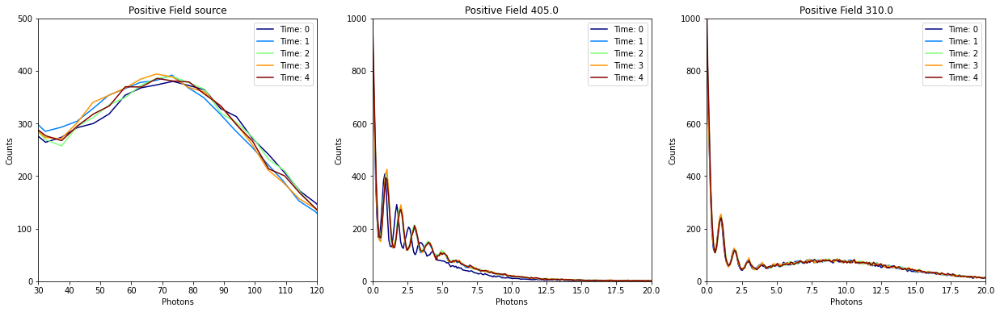

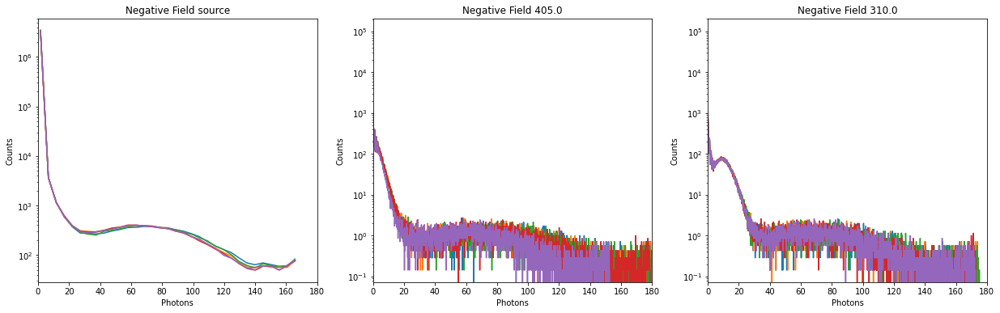

In [41]:
plt.figure(figsize=(21,6))
plt.title('SiPM Response in Positive Electric Field')
for i, file_type in enumerate(combined_POS):
    plt.subplot(1,3,i+1)
    plt.title('Positive Field {}'.format(file_type))
    plt.xlabel('Photons')
    plt.ylabel('Counts')
    colors = cm.jet(np.linspace(0,1,len(combined_POS[file_type]['pe_data'])))
#     plt.xlim(0,180)
#     plt.yscale('log')
    if file_type == 'source':
        plt.xlim(30, 120)
        plt.ylim(0, 500)
#         plt.yscale('log')
    elif file_type == 405.0:
        plt.xlim(0, 20)
        plt.ylim(0, 1000)
    elif file_type == 310.0:
        plt.xlim(0, 20)
        plt.ylim(0, 1000)
#     plt.plot(np.mean(calibrated_data_POS[file_type], axis=0), np.mean(data_POS_FIELD[file_type]['counts'], axis=0))
    for i, (each_pos, each_counts, color) in enumerate(zip(combined_POS[file_type]['pe_data'], combined_POS[file_type]['counts'], colors)):
        plt.plot(each_pos, each_counts, color=color, label='Time: {}'.format(i))
#     for each_neg in combined_NEG[file_type]:
    plt.legend()

plt.figure(figsize=(21,6))
plt.title('SiPM Response in Negative Electric Field')
for i, file_type in enumerate(combined_NEG):
    colors = cm.jet(np.linspace(0,1,len(combined_NEG[file_type])))
    plt.subplot(1,3,i+1)
    plt.title('Negative Field {}'.format(file_type))
    plt.xlabel('Photons')
    plt.ylabel('Counts')
    plt.xlim(0,180)
    plt.yscale('log')
    for each_neg, each_counts in zip(combined_NEG[file_type]['pe_data'], combined_NEG[file_type]['counts']):
        plt.plot(each_neg, each_counts)

IDK if we need this

In [6]:
def rebin_center(hx,h,bins):
    # rebinning the data with the new x values corresponding to the mean of the old?
    h_rebin=[]
    hx_rebin=[]
    for i in range(int(len(h)/bins)):
        start_idx=i*bins
        end_idx=(i+1)*bins
        h_rebin.append(np.sum(h[start_idx:end_idx]))
        hx_rebin.append(np.mean(hx[start_idx:end_idx])) # finding the mean of the x values in the bin
    # hx_rebin=range(len(h_rebin))
    return np.array(hx_rebin), np.array(h_rebin)

C:\Data\20220630\LXe_Full_Source_PDE\mca_keith_31.00OV_0.h5


c:\Users\nEXO\anaconda3\lib\site-packages\scipy\optimize\minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


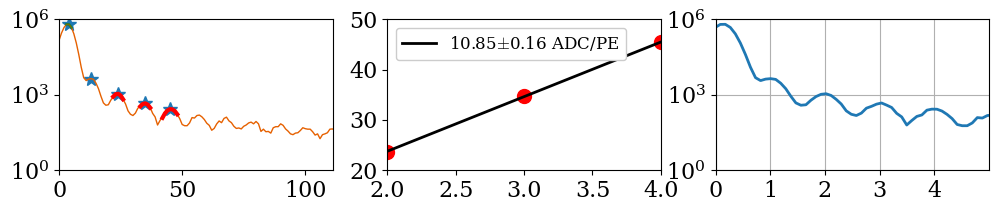

C:\Data\20220630\LXe_Full_Source_PDE\mca_keith_31.00OV_1.h5


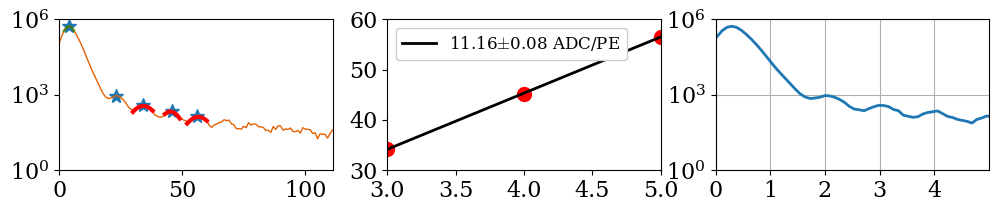

C:\Data\20220630\LXe_Full_Source_PDE\mca_keith_31.00OV_2.h5


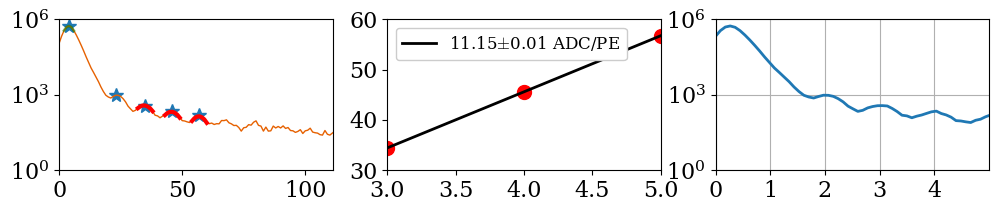

C:\Data\20220630\LXe_Full_Source_PDE\mca_keith_31.00OV_3.h5


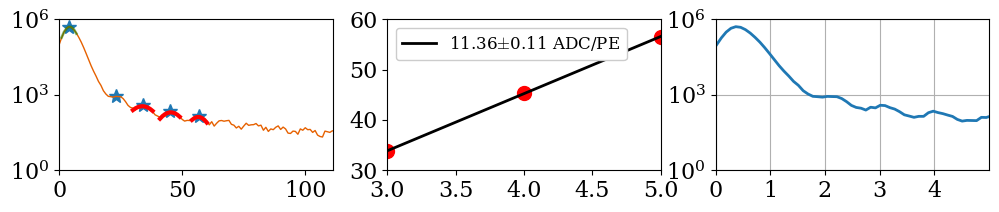

C:\Data\20220630\LXe_Full_Source_PDE\mca_keith_31.00OV_4.h5


c:\Users\nEXO\anaconda3\lib\site-packages\scipy\optimize\minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


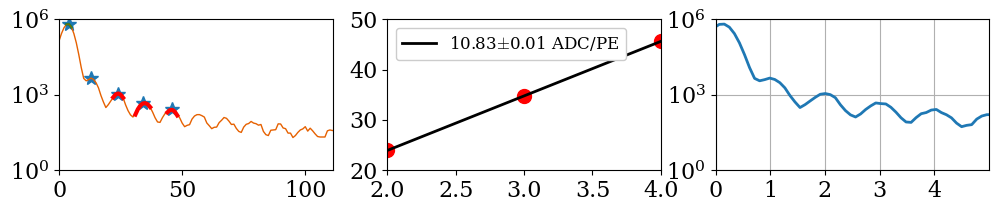

C:\Data\20220630\LXe_Full_Source_PDE\mca_keith_31.00OV_5.h5


c:\Users\nEXO\anaconda3\lib\site-packages\scipy\optimize\minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


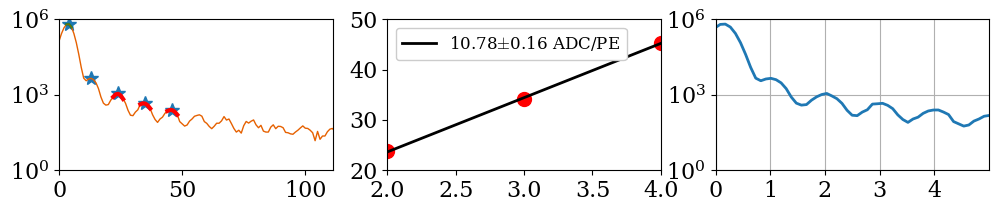

C:\Data\20220630\LXe_Full_Source_PDE\mca_keith_31.00OV_6.h5


c:\Users\nEXO\anaconda3\lib\site-packages\scipy\optimize\minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


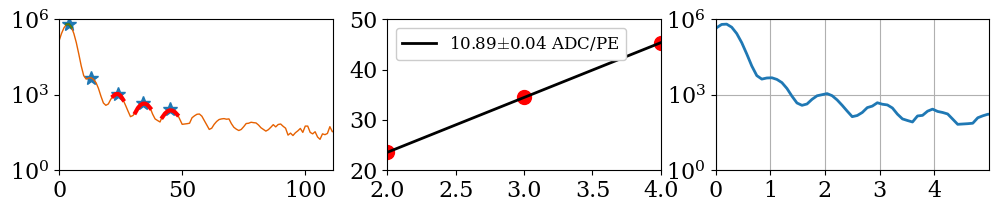

C:\Data\20220630\LXe_Full_Source_PDE\mca_keith_31.00OV_7.h5


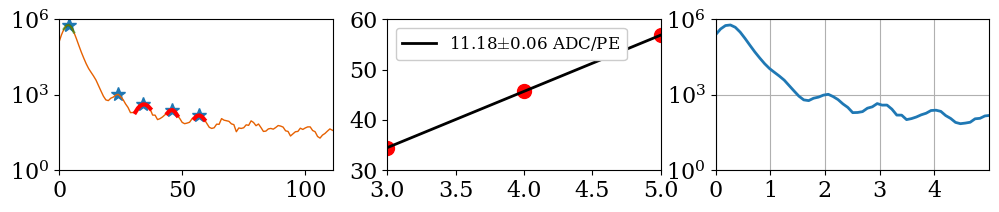

C:\Data\20220630\LXe_Full_Source_PDE\mca_keith_31.00OV_8.h5


c:\Users\nEXO\anaconda3\lib\site-packages\scipy\optimize\minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


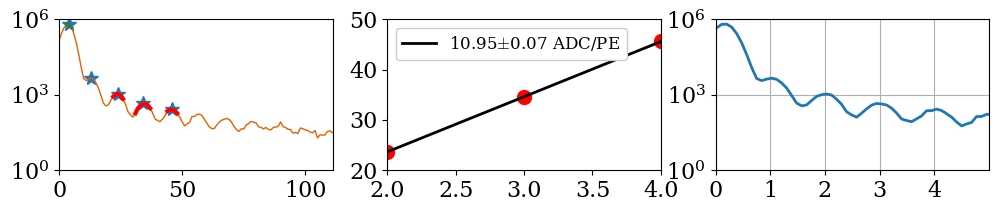

C:\Data\20220630\LXe_Full_Source_PDE\mca_keith_31.00OV_9.h5


c:\Users\nEXO\anaconda3\lib\site-packages\scipy\optimize\minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


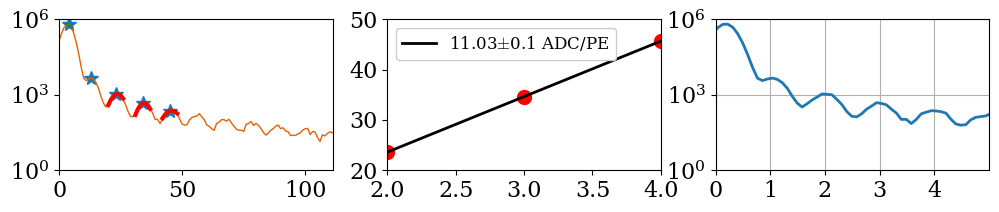

C:\Data\20220630\LXe_Full_Source_PDE\mca_keith_31.00OV_10.h5


c:\Users\nEXO\anaconda3\lib\site-packages\scipy\optimize\minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


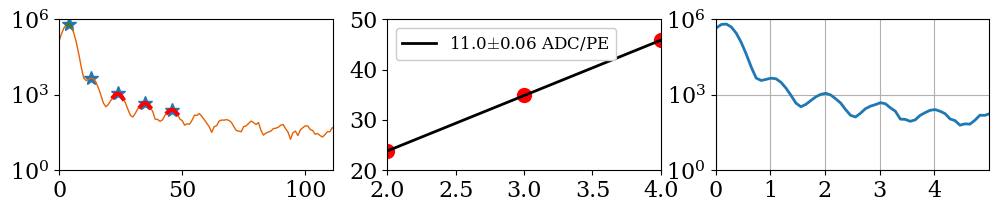

C:\Data\20220630\LXe_Full_Source_PDE\mca_keith_31.00OV_11.h5


c:\Users\nEXO\anaconda3\lib\site-packages\scipy\optimize\minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


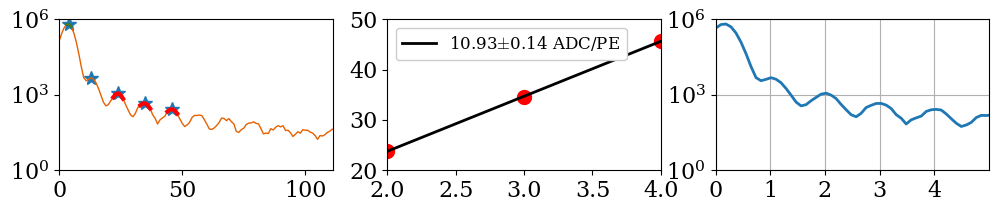

C:\Data\20220630\LXe_Full_Source_PDE\mca_keith_31.00OV_12.h5


c:\Users\nEXO\anaconda3\lib\site-packages\scipy\optimize\minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


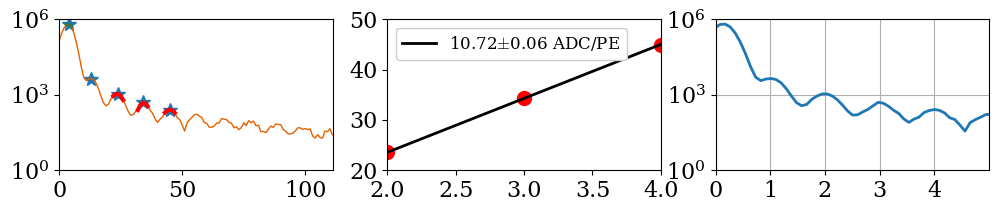

C:\Data\20220630\LXe_Full_Source_PDE\mca_keith_31.00OV_13.h5


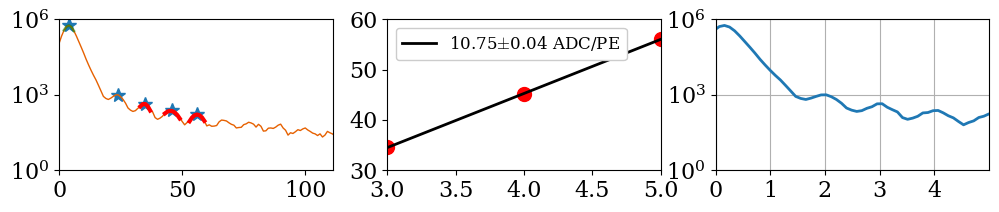

C:\Data\20220630\LXe_Full_Source_PDE\mca_keith_31.00OV_14.h5


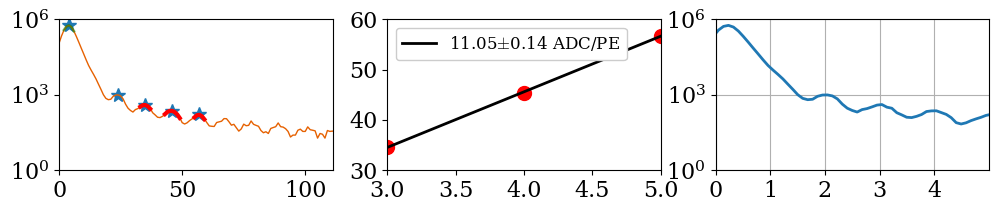

C:\Data\20220630\LXe_Full_Source_PDE\mca_keith_31.00OV_15.h5


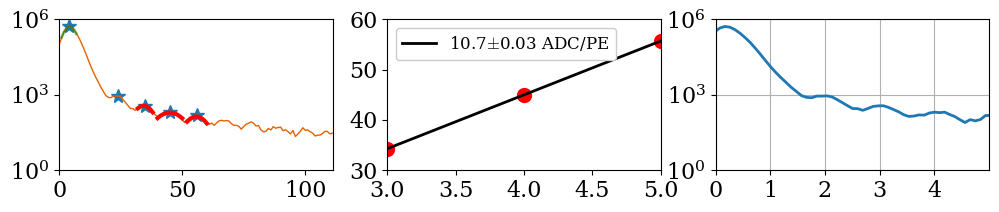

C:\Data\20220630\LXe_Full_Source_PDE\mca_keith_31.00OV_16.h5


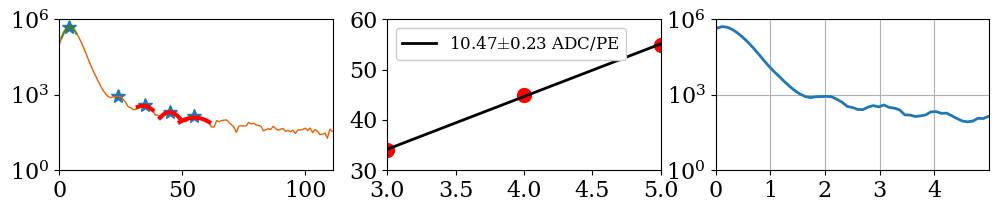

C:\Data\20220630\LXe_Full_Source_PDE\mca_keith_31.00OV_17.h5


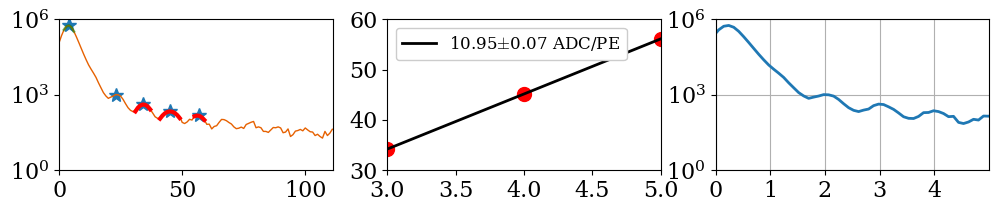

C:\Data\20220630\LXe_Full_Source_PDE\mca_keith_31.00OV_18.h5


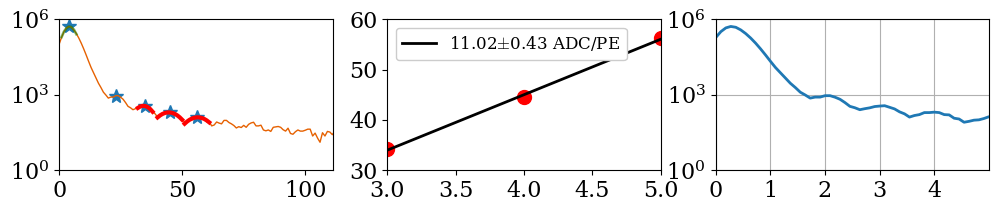

C:\Data\20220630\LXe_Full_Source_PDE\mca_keith_31.00OV_19.h5


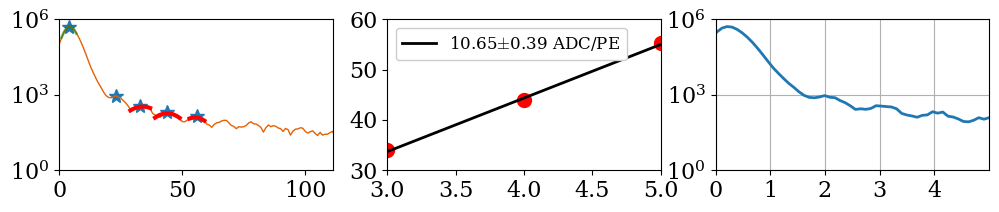

C:\Data\20220630\LXe_Full_Source_PDE\mca_keith_31.00OV_20.h5


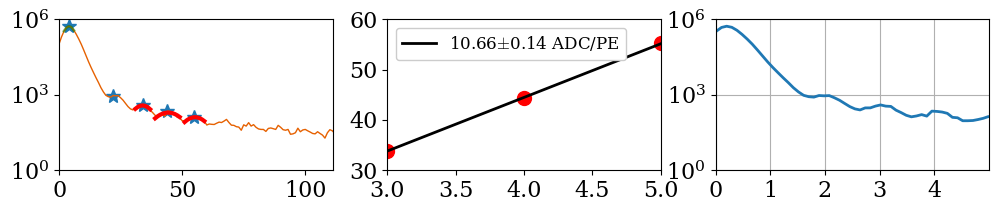

C:\Data\20220630\LXe_Full_Source_PDE\mca_keith_31.00OV_21.h5


c:\Users\nEXO\anaconda3\lib\site-packages\scipy\optimize\minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


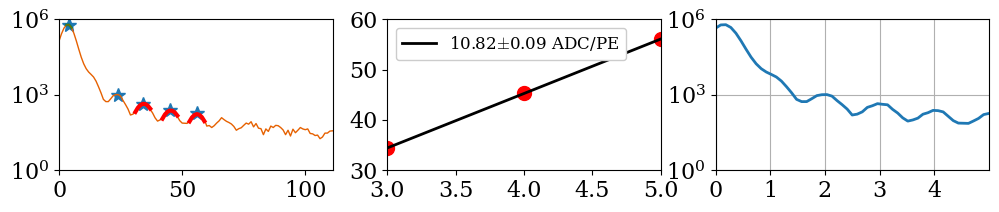

C:\Data\20220630\LXe_Full_Source_PDE\mca_keith_31.00OV_22.h5


c:\Users\nEXO\anaconda3\lib\site-packages\scipy\optimize\minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


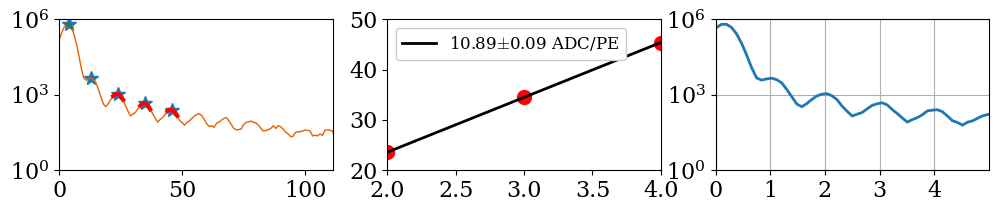

C:\Data\20220630\LXe_Full_Source_PDE\mca_keith_31.00OV_23.h5


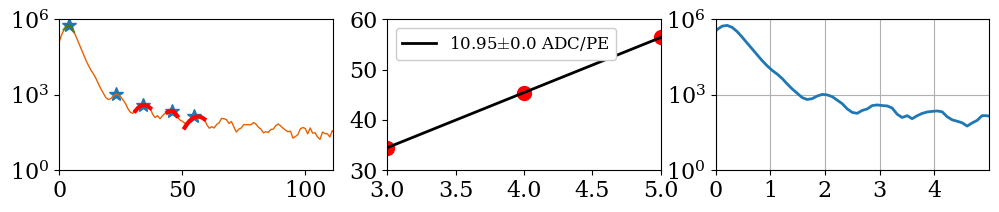

C:\Data\20220630\LXe_Full_Source_PDE\mca_keith_31.00OV_24.h5


c:\Users\nEXO\anaconda3\lib\site-packages\scipy\optimize\minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


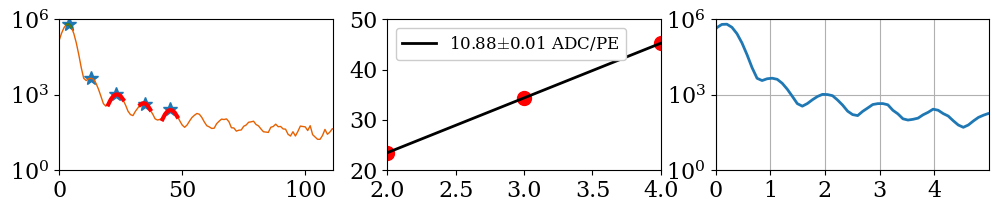

C:\Data\20220630\LXe_Full_Source_PDE\mca_keith_31.00OV_25.h5


c:\Users\nEXO\anaconda3\lib\site-packages\scipy\optimize\minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


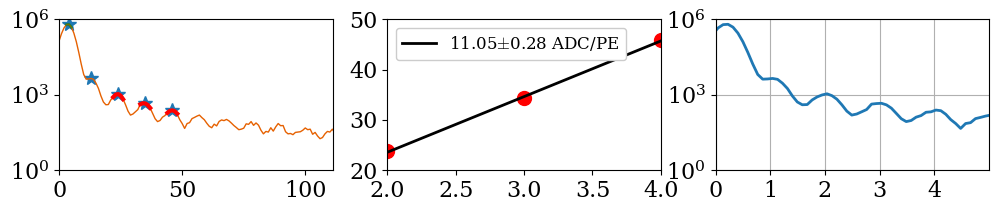

C:\Data\20220630\LXe_Full_Source_PDE\mca_keith_31.00OV_26.h5


c:\Users\nEXO\anaconda3\lib\site-packages\scipy\optimize\minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


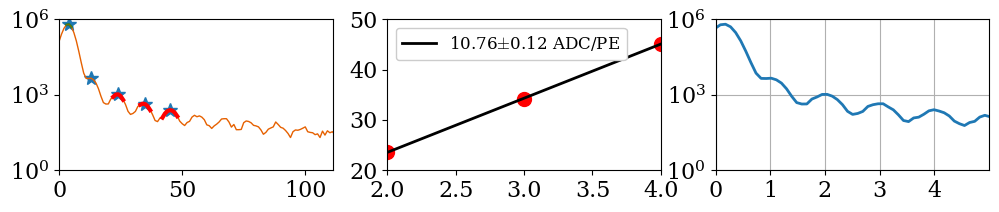

C:\Data\20220630\LXe_Full_Source_PDE\mca_keith_31.00OV_27.h5


c:\Users\nEXO\anaconda3\lib\site-packages\scipy\optimize\minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\Users\nEXO\anaconda3\lib\site-packages\scipy\optimize\minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


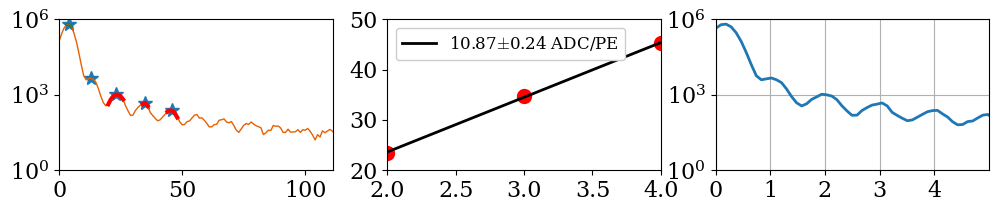

C:\Data\20220630\LXe_Full_Source_PDE\mca_keith_31.00OV_28.h5


c:\Users\nEXO\anaconda3\lib\site-packages\scipy\optimize\minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


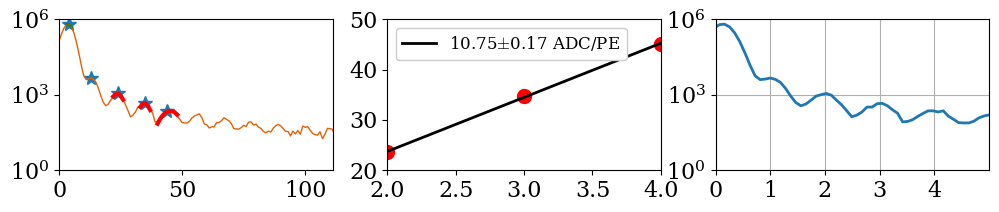

C:\Data\20220630\LXe_Full_Source_PDE\mca_keith_31.00OV_29.h5


c:\Users\nEXO\anaconda3\lib\site-packages\scipy\optimize\minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


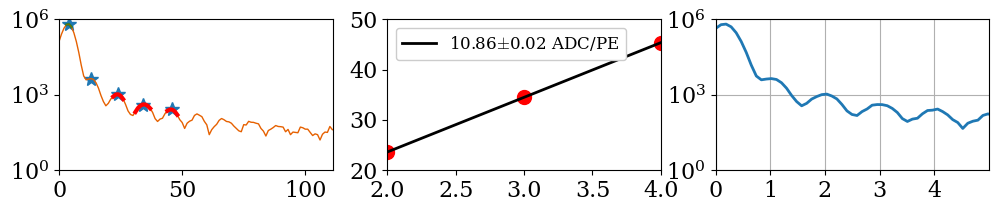

C:\Data\20220630\LXe_Full_Source_PDE\mca_keith_31.00OV_30.h5


c:\Users\nEXO\anaconda3\lib\site-packages\scipy\optimize\minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


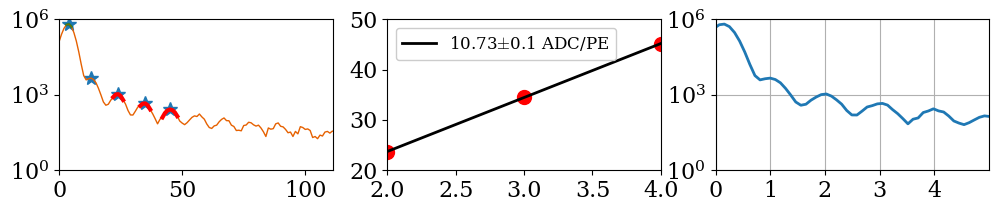

C:\Data\20220630\LXe_Full_Source_PDE\mca_keith_31.00OV_31.h5


c:\Users\nEXO\anaconda3\lib\site-packages\scipy\optimize\minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


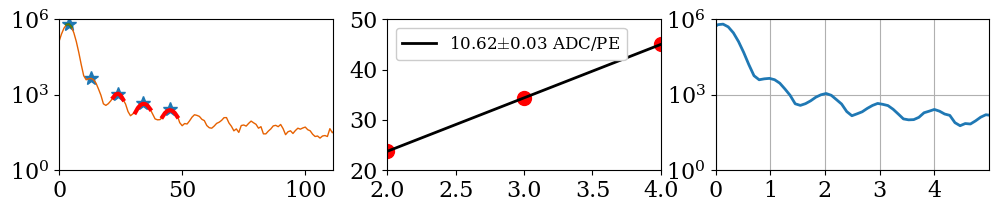

C:\Data\20220630\LXe_Full_Source_PDE\mca_keith_31.00OV_32.h5


c:\Users\nEXO\anaconda3\lib\site-packages\scipy\optimize\minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


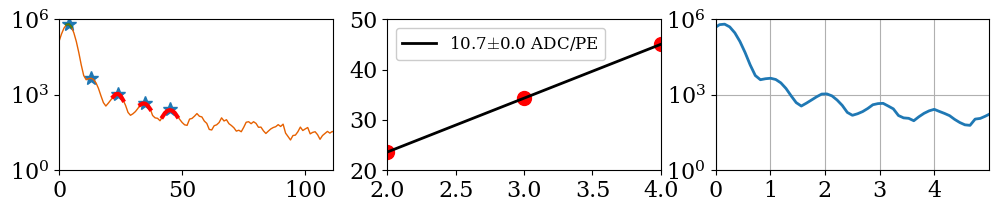

C:\Data\20220630\LXe_Full_Source_PDE\mca_keith_31.00OV_33.h5


c:\Users\nEXO\anaconda3\lib\site-packages\scipy\optimize\minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


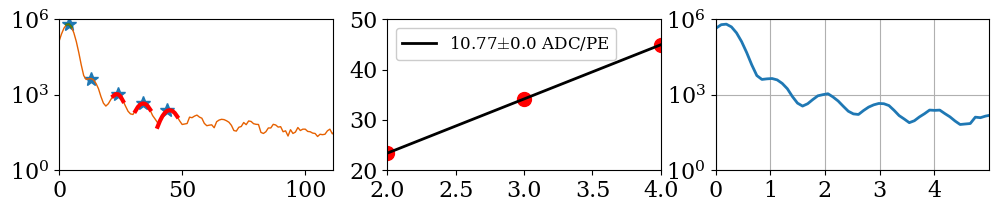

C:\Data\20220630\LXe_Full_Source_PDE\mca_keith_31.00OV_34.h5


c:\Users\nEXO\anaconda3\lib\site-packages\scipy\optimize\minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


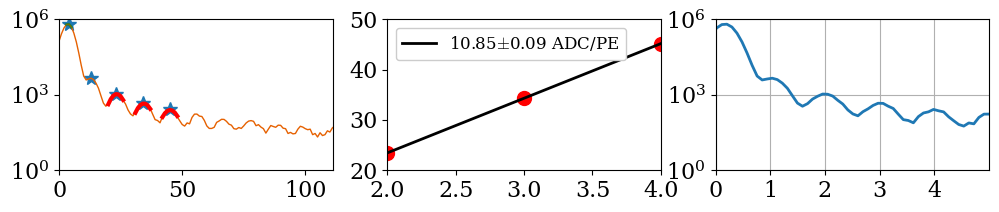

C:\Data\20220630\LXe_Full_Source_PDE\mca_keith_31.00OV_35.h5


c:\Users\nEXO\anaconda3\lib\site-packages\scipy\optimize\minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\Users\nEXO\anaconda3\lib\site-packages\scipy\optimize\minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


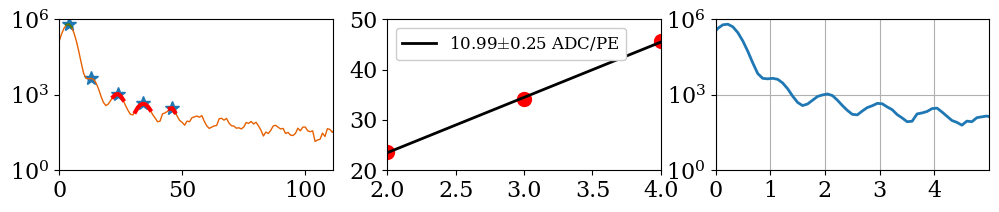

C:\Data\20220630\LXe_Full_Source_PDE\mca_keith_31.00OV_36.h5


c:\Users\nEXO\anaconda3\lib\site-packages\scipy\optimize\minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


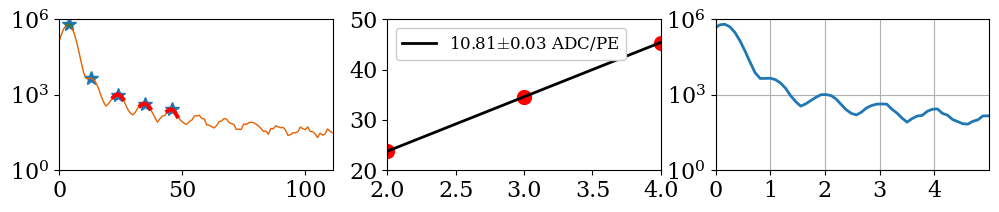

C:\Data\20220630\LXe_Full_Source_PDE\mca_keith_31.00OV_37.h5


c:\Users\nEXO\anaconda3\lib\site-packages\scipy\optimize\minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


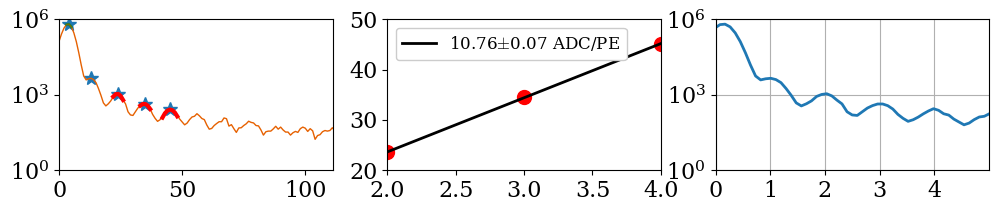

C:\Data\20220630\LXe_Full_Source_PDE\mca_keith_31.00OV_38.h5


c:\Users\nEXO\anaconda3\lib\site-packages\scipy\optimize\minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


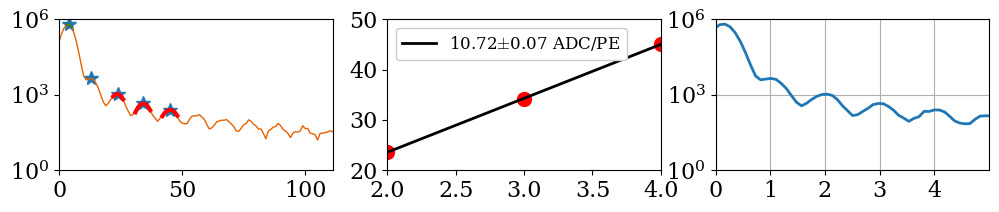

C:\Data\20220630\LXe_Full_Source_PDE\mca_keith_31.00OV_39.h5


c:\Users\nEXO\anaconda3\lib\site-packages\scipy\optimize\minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


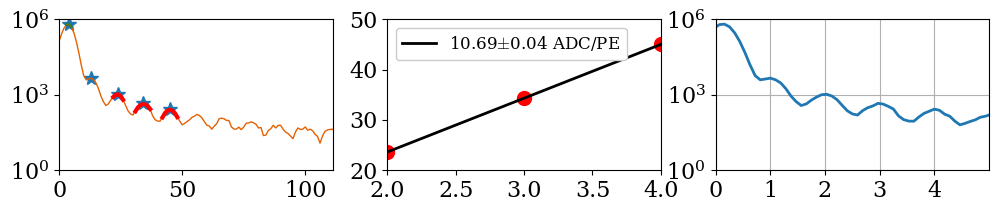

C:\Data\20220630\LXe_Full_Source_PDE\mca_keith_31.00OV_40.h5


c:\Users\nEXO\anaconda3\lib\site-packages\scipy\optimize\minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\Users\nEXO\anaconda3\lib\site-packages\scipy\optimize\minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


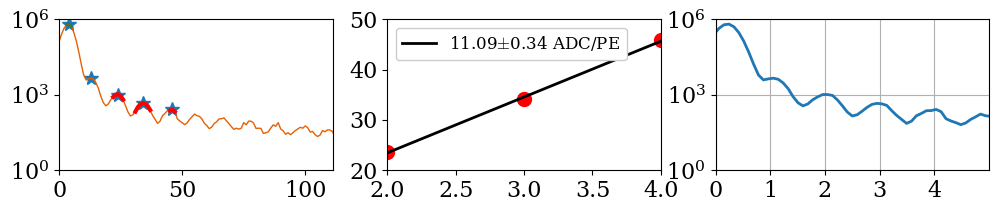

C:\Data\20220630\LXe_Full_Source_PDE\mca_keith_31.00OV_41.h5


c:\Users\nEXO\anaconda3\lib\site-packages\scipy\optimize\minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


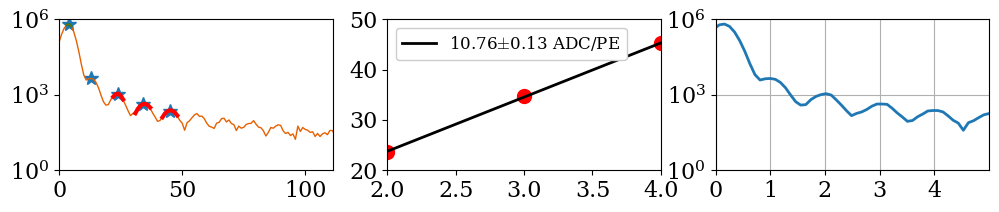

C:\Data\20220630\LXe_Full_Source_PDE\mca_keith_31.00OV_42.h5


c:\Users\nEXO\anaconda3\lib\site-packages\scipy\optimize\minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


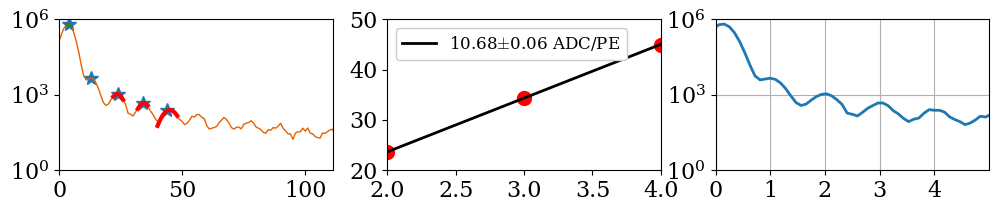

C:\Data\20220630\LXe_Full_Source_PDE\mca_keith_31.00OV_43.h5


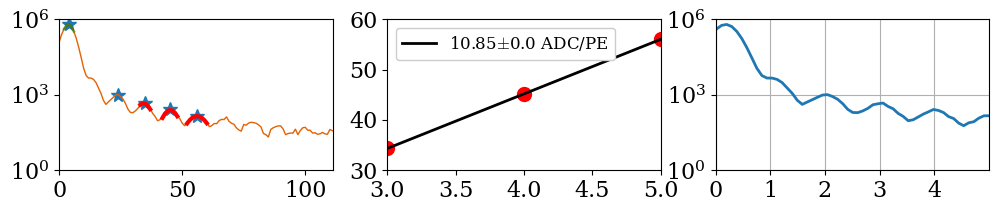

C:\Data\20220630\LXe_Full_Source_PDE\mca_keith_31.00OV_44.h5


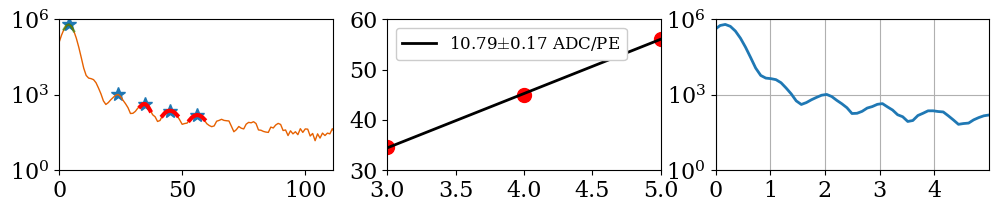

C:\Data\20220630\LXe_Full_Source_PDE\mca_keith_31.00OV_45.h5


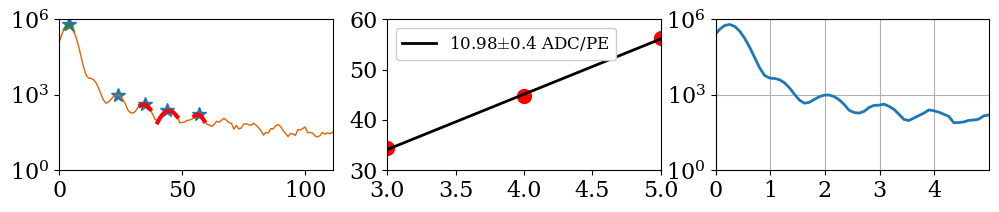

C:\Data\20220630\LXe_Full_Source_PDE\mca_keith_31.00OV_46.h5


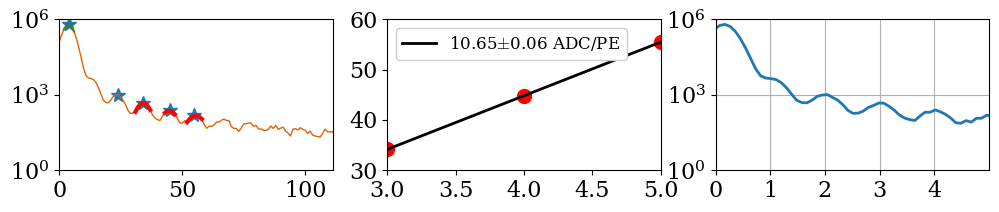

C:\Data\20220630\LXe_Full_Source_PDE\mca_keith_31.00OV_47.h5


c:\Users\nEXO\anaconda3\lib\site-packages\scipy\optimize\minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


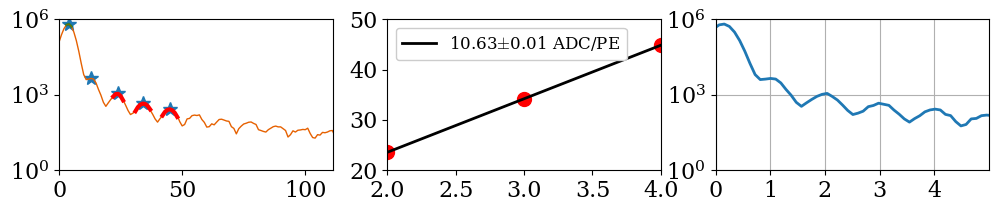

C:\Data\20220630\LXe_Full_Source_PDE\mca_keith_31.00OV_48.h5


c:\Users\nEXO\anaconda3\lib\site-packages\scipy\optimize\minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


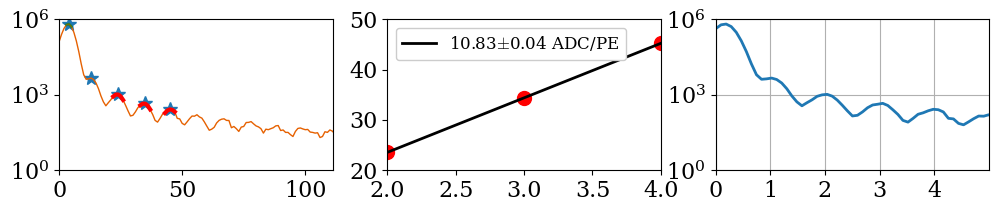

C:\Data\20220630\LXe_Full_Source_PDE\mca_keith_31.00OV_49.h5


c:\Users\nEXO\anaconda3\lib\site-packages\scipy\optimize\minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


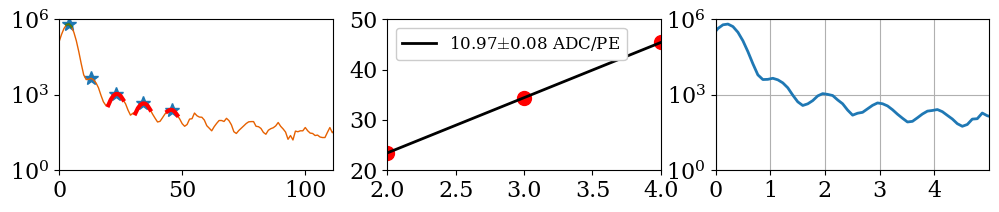

C:\Data\20220630\LXe_Full_Source_PDE\mca_keith_31.00OV_50.h5


c:\Users\nEXO\anaconda3\lib\site-packages\scipy\optimize\minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


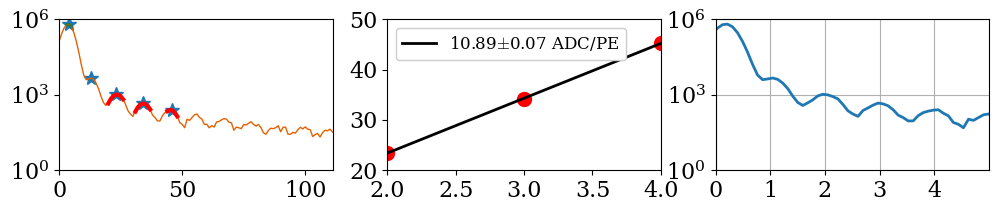

C:\Data\20220630\LXe_Full_Source_PDE\mca_keith_31.00OV_51.h5


c:\Users\nEXO\anaconda3\lib\site-packages\scipy\optimize\minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


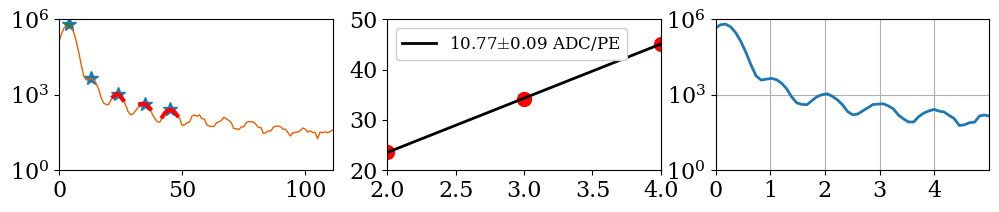

C:\Data\20220630\LXe_Full_Source_PDE\mca_keith_31.00OV_52.h5


c:\Users\nEXO\anaconda3\lib\site-packages\scipy\optimize\minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


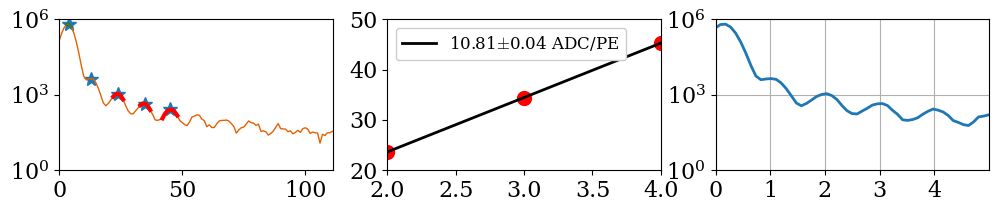

C:\Data\20220630\LXe_Full_Source_PDE\mca_keith_31.00OV_53.h5


c:\Users\nEXO\anaconda3\lib\site-packages\scipy\optimize\minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


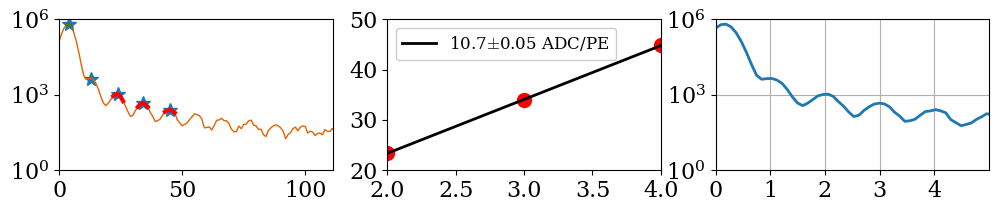

C:\Data\20220630\LXe_Full_Source_PDE\mca_keith_31.00OV_54.h5


c:\Users\nEXO\anaconda3\lib\site-packages\scipy\optimize\minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


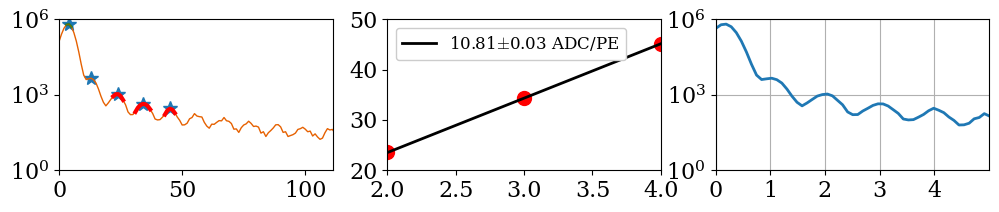

C:\Data\20220630\LXe_Full_Source_PDE\mca_keith_31.00OV_55.h5


c:\Users\nEXO\anaconda3\lib\site-packages\scipy\optimize\minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


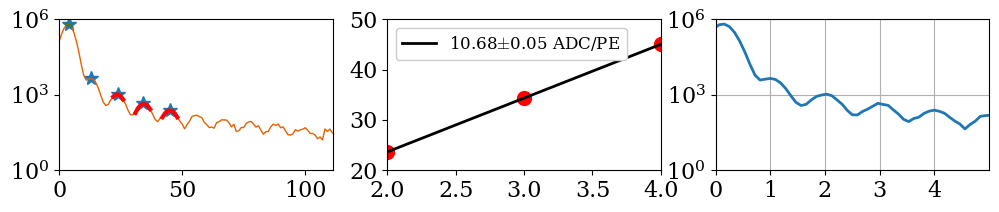

In [10]:
NO_FIELD_calib_pe,NO_FIELD_calib_count,NO_FIELD_gain_list,NO_FIELD_gain_err=gain_calculator(NO_FIELD,9,4)

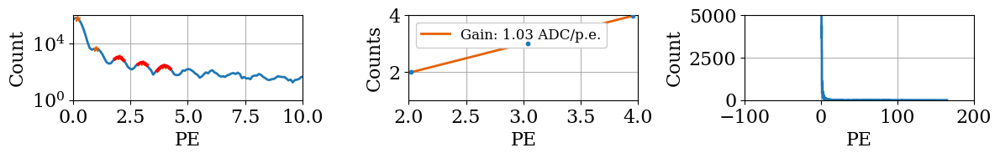

4.603524430349338e-10


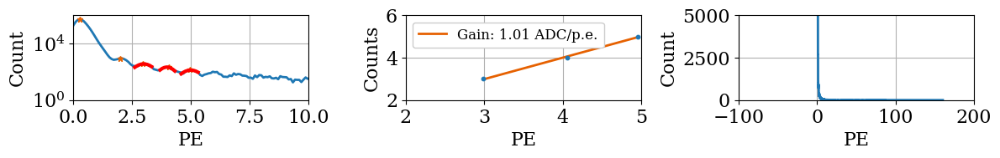

5.319363326925193e-10


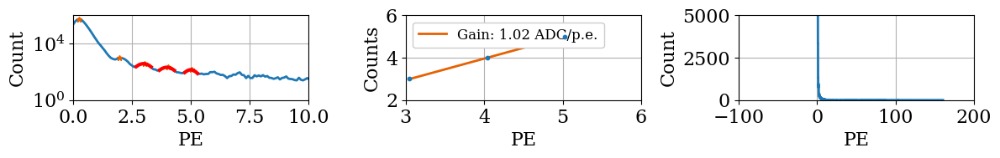

5.374512662224864e-10


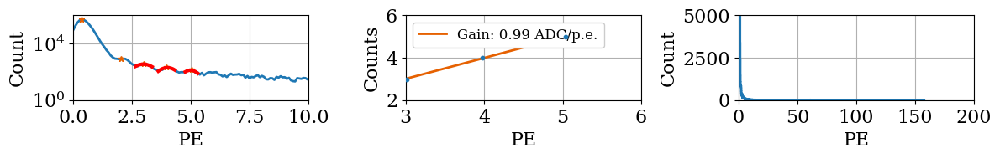

6.500339307698989e-10


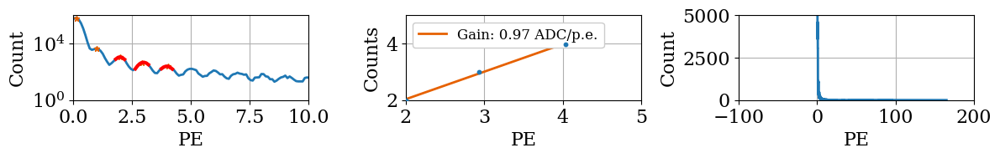

4.617155582328975e-10


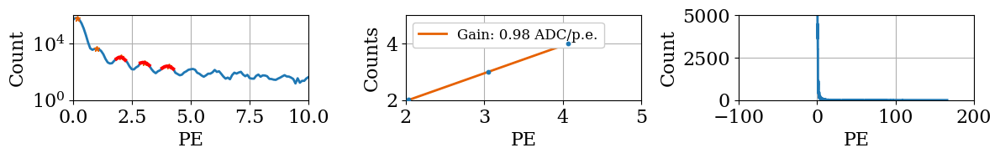

4.6166578222044e-10


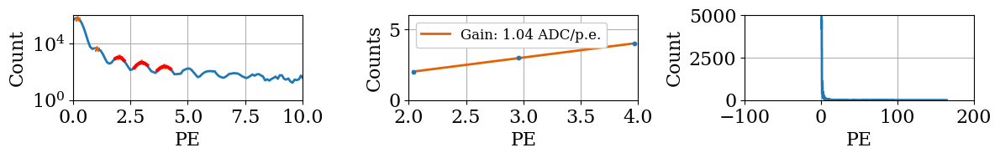

4.661613813398194e-10


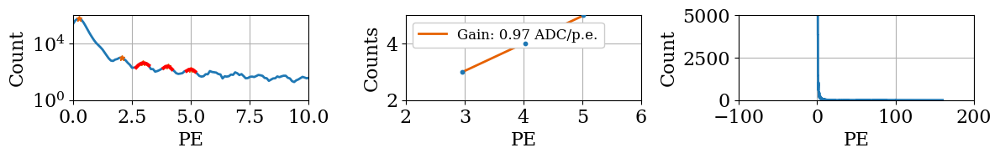

4.949182083467816e-10


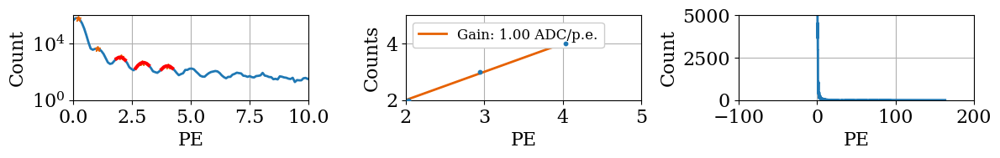

4.640757414150816e-10


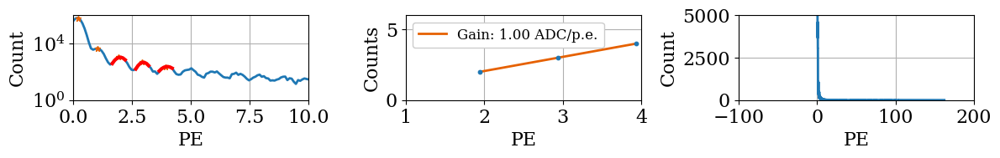

4.629226547580234e-10


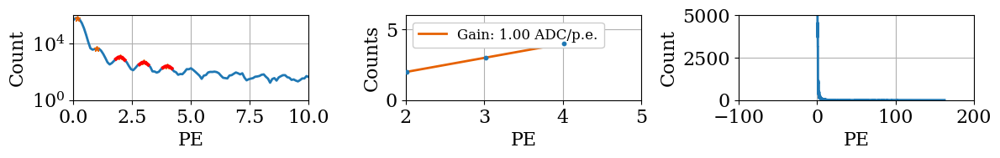

4.490643018690904e-10


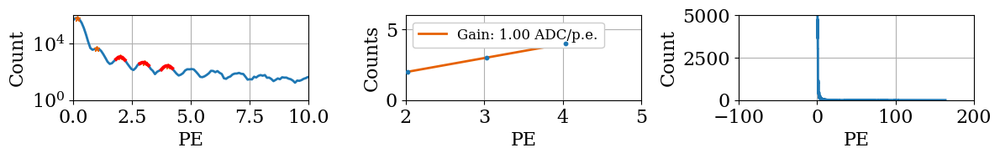

4.667351316639035e-10


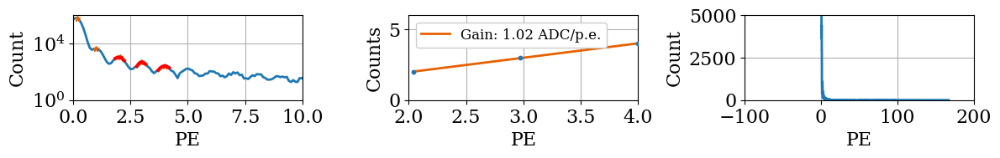

4.762864588600659e-10


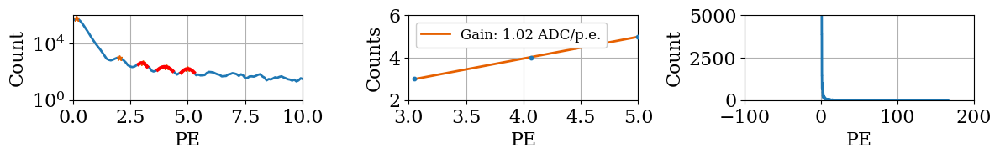

4.981857743933481e-10


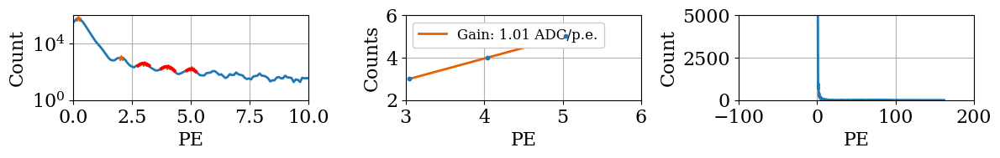

5.126069020618814e-10


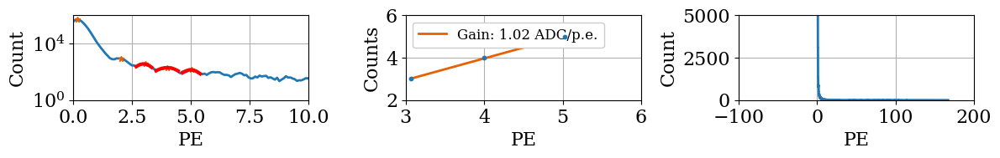

5.132242665068594e-10


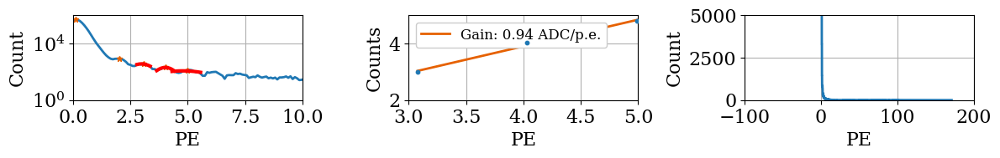

5.255332880191106e-10


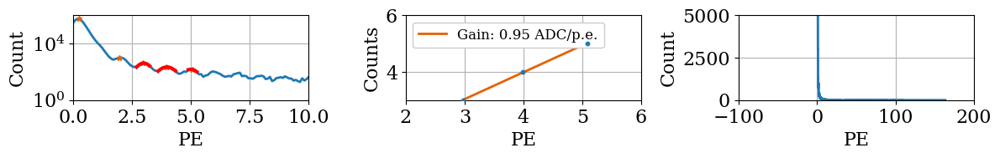

5.270716048451134e-10


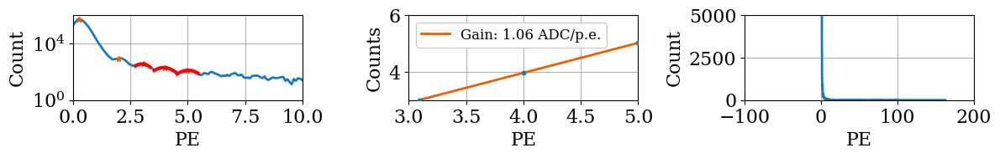

5.437476525160145e-10


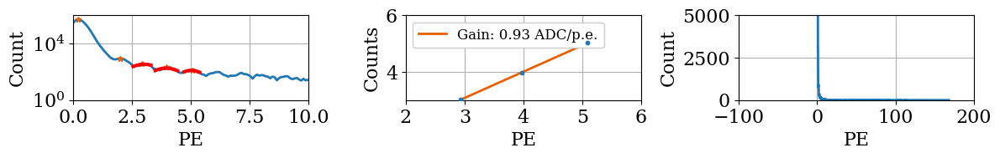

5.571207821966495e-10


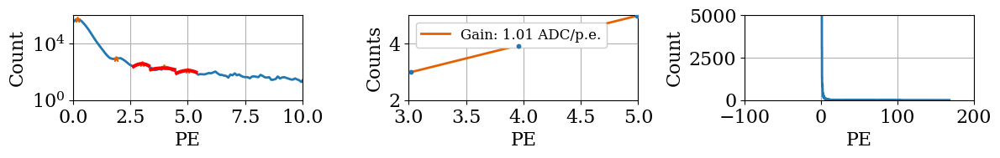

5.544270270144842e-10


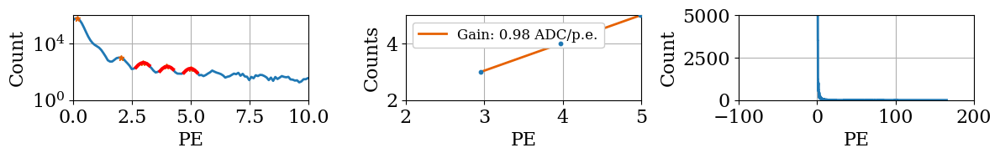

4.807883944438369e-10


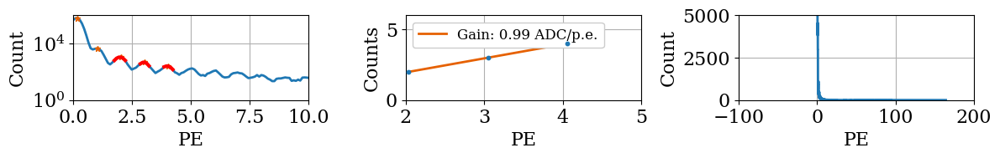

4.703698782452017e-10


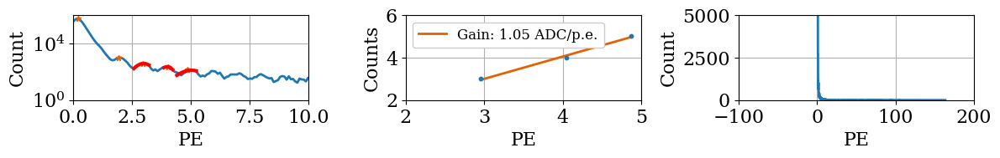

5.134053385610187e-10


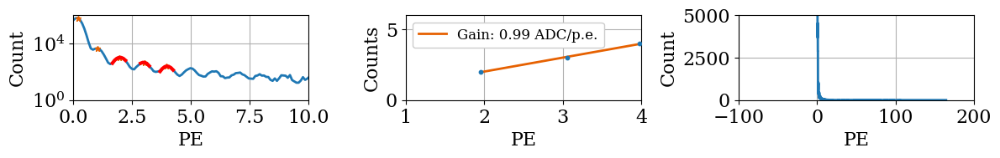

4.742835486166233e-10


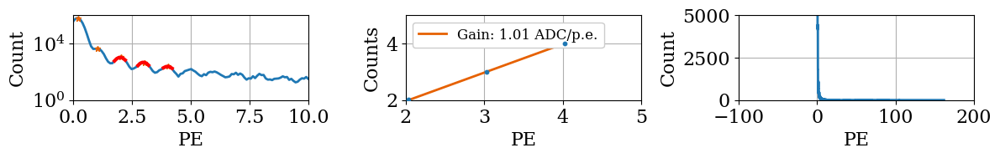

4.693114837877733e-10


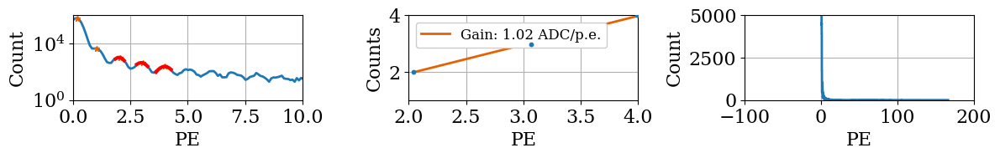

4.6333443765799776e-10


c:\Users\nEXO\anaconda3\lib\site-packages\scipy\optimize\minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


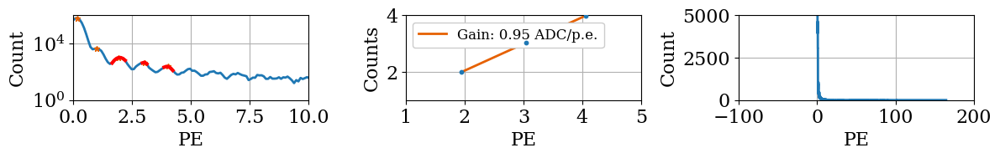

4.6504468665625047e-10


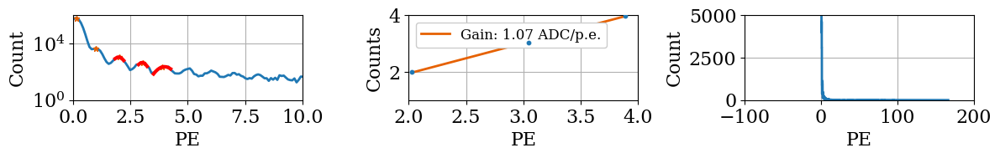

4.752365627104169e-10


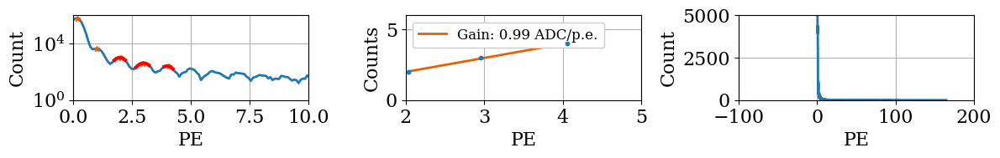

4.750772815289976e-10


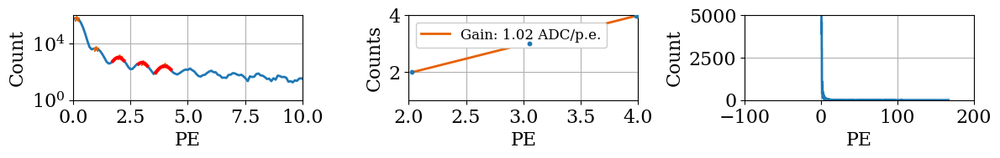

4.671302335341237e-10


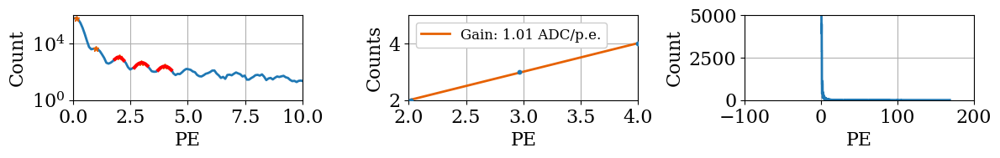

4.792458410516635e-10


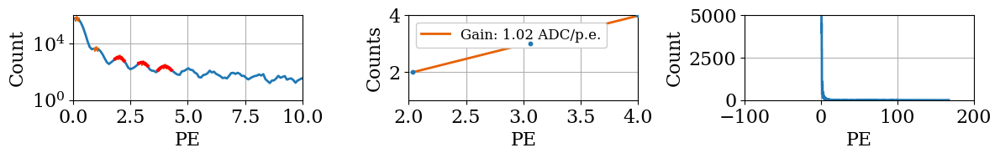

4.772320740044518e-10


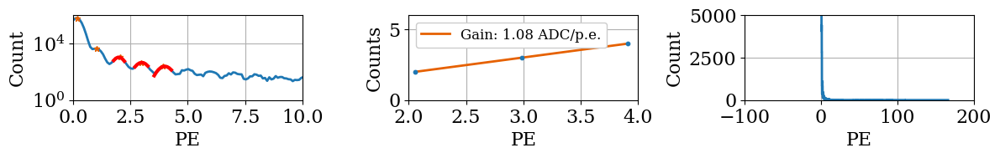

4.749128854126539e-10


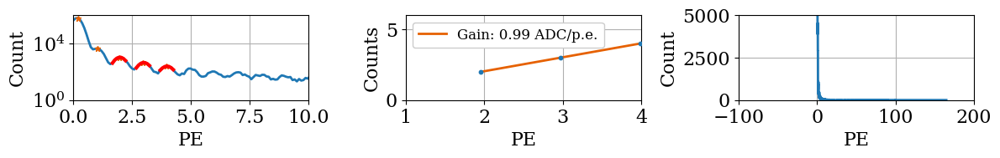

4.672327376510458e-10


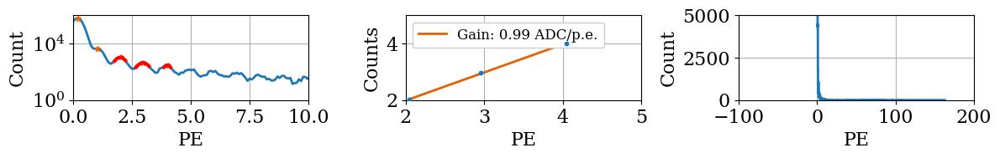

4.746025577711077e-10


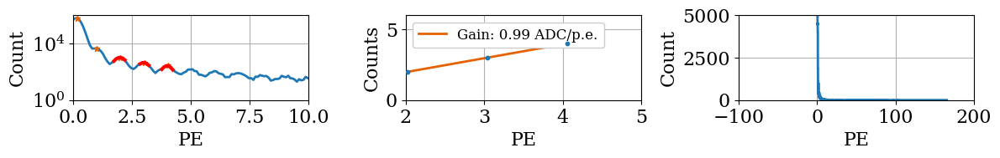

4.673098681043464e-10


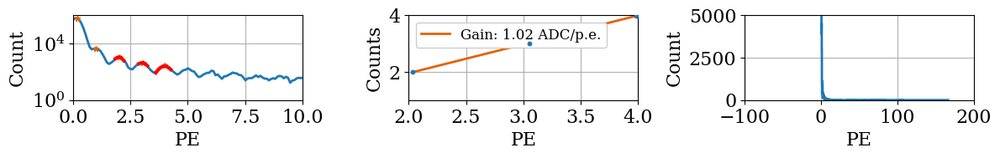

4.648030400008799e-10


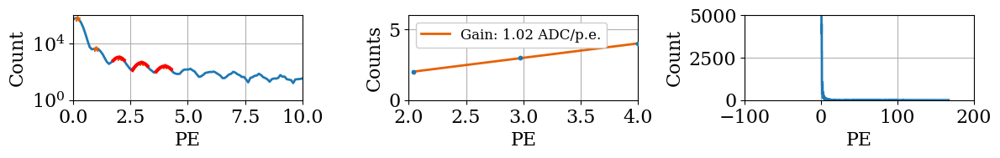

4.759969174473054e-10


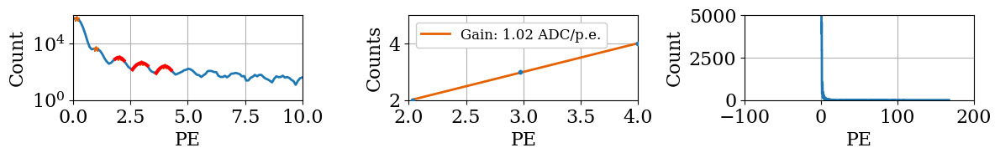

4.72611679995283e-10


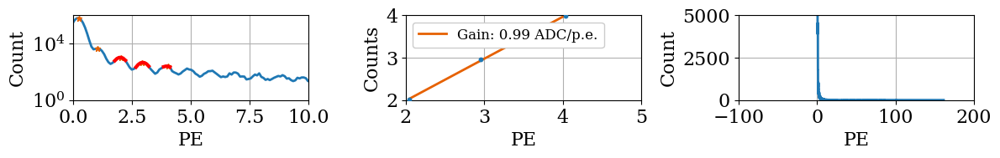

4.6550659740309974e-10


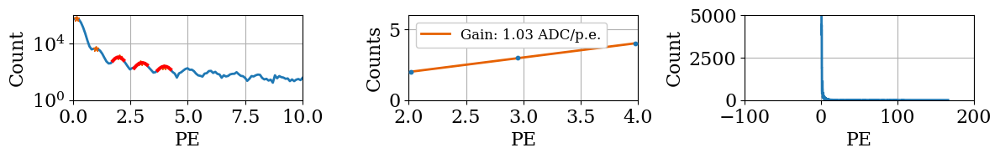

4.6483087281431074e-10


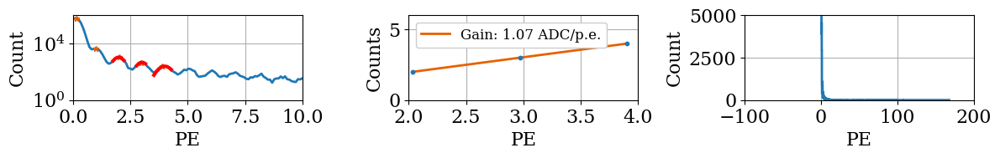

4.738332429443809e-10


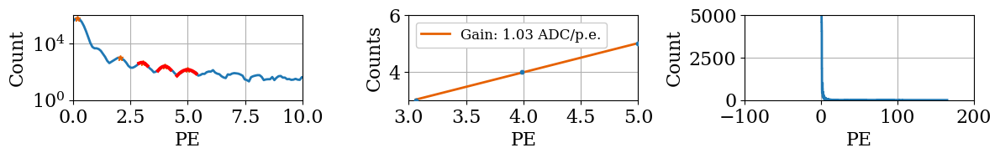

4.828050914480639e-10


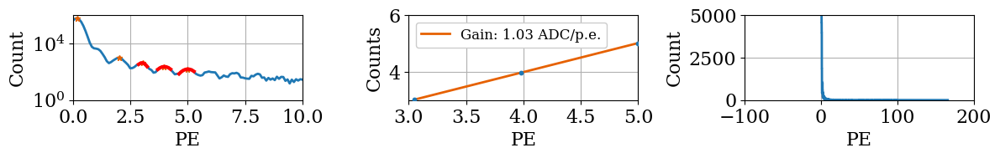

4.678261585739138e-10


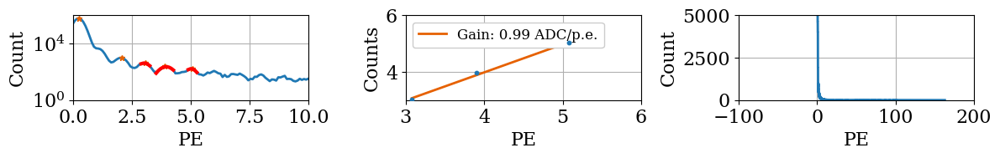

4.768870979416146e-10


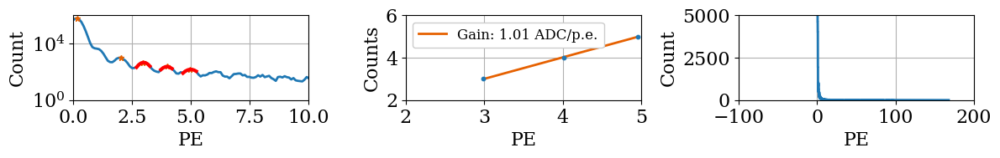

4.769614642683732e-10


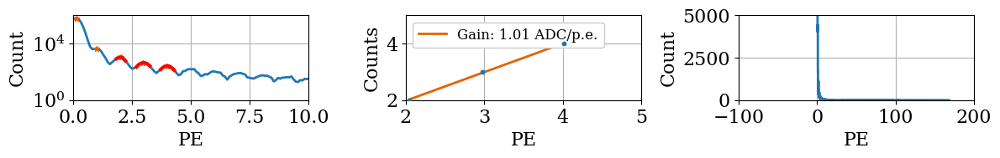

4.782574768685401e-10


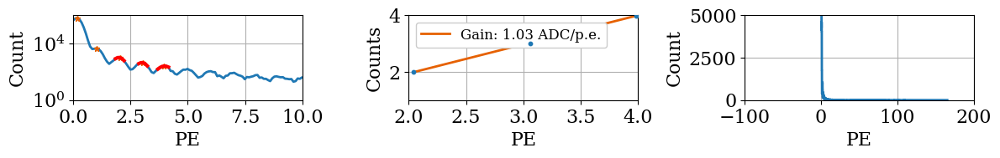

4.6443935311655376e-10


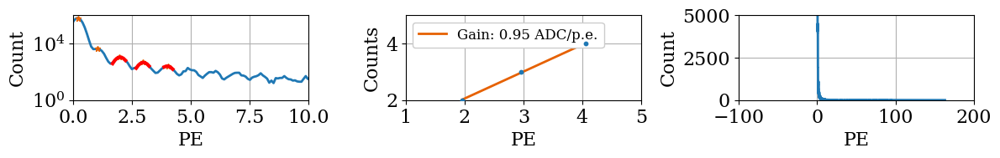

4.642297899657886e-10


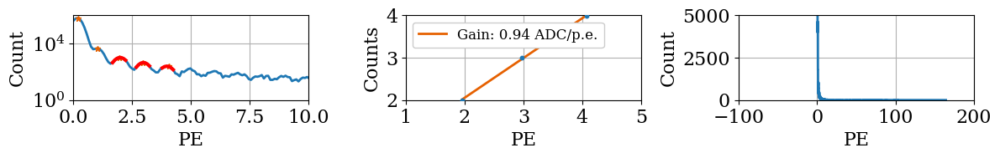

4.683402434241343e-10


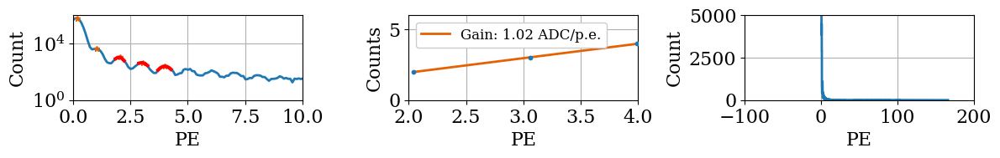

4.759044503185982e-10


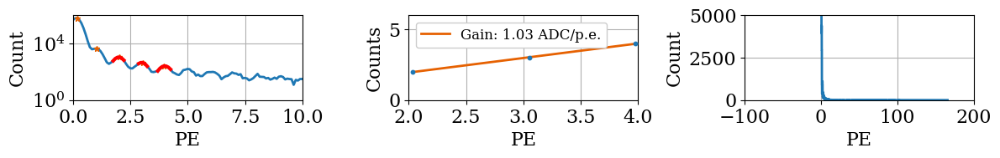

4.690906631206124e-10


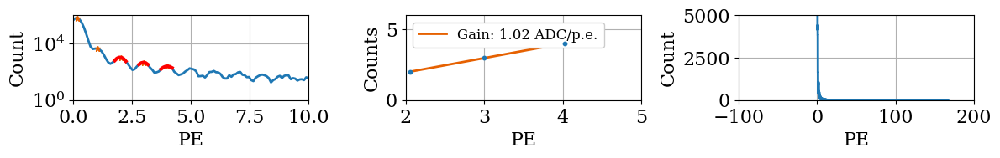

4.728132269129898e-10


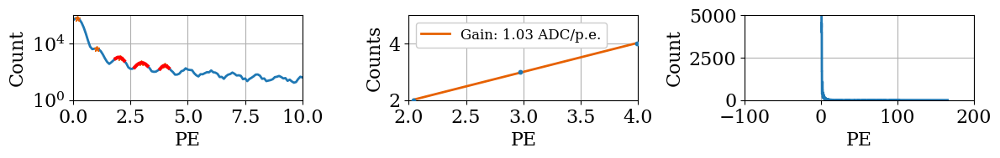

4.706017323192345e-10


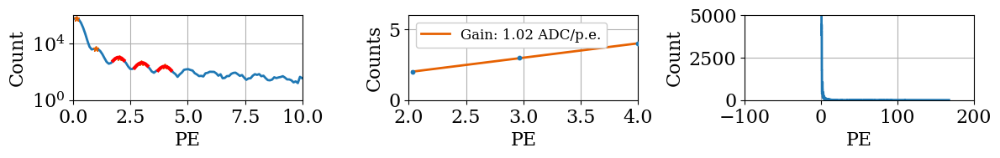

4.6029847812122494e-10


In [11]:
NO_FIELD_pe_corrected_gain=[]
NO_FIELD_pe_corrected_gain_err=[]
NO_FIELD_calib_pe_updated=[]

# looping through calibrated data that was generated by gain_calculator
for x,y in zip(NO_FIELD_calib_pe,NO_FIELD_calib_count):
    plt.figure(figsize=(12,2))
    plt.subplot(1,3,1)
    plt.plot(x,y)
    plt.yscale('log')
    plt.xlim(0,10)
    plt.grid()
    plt.xlabel('PE')
    plt.ylabel('Count')
    
    ####### It looks like the code is refitting the peaks that we just fit? idk why
    ####### I think that we already have that info from the gain calcuator
    
    N_peaks=4
    PROMINENCE=1E3 #This prominence is re-set here to ensure that every file starts out with a high prominence
    
    peaks,pdict=find_peaks(y,prominence=PROMINENCE,distance=5)
    peak_length=len(peaks)
    
#     We want to ensure that using a high prominence gives us at least N_peaks peaks to fit a straight line to. If it doesn't we reduce prominence till we get at least 3 peaks. N_peaks is set above
    while (peak_length<N_peaks+1):
        PROMINENCE=PROMINENCE-1
            
        peaks,pdict=find_peaks(y,prominence=PROMINENCE,distance=5)
        peak_length=len(peaks)


        
    plt.plot(x[peaks],y[peaks],'*',ms=5) # plot the peak markers
    first_pe_max=x[peaks[2]] # The x-value of the 3rd peak.Index=1 means the second peak will be used for getting fit parameters
    max_value=y[peaks[2]] # The height of the 3rd peak
    x_idx_array=(y<0.5*max_value) & (x>first_pe_max)# returns a boolean array where both conditions are true
    right_side_x= x[np.where(x_idx_array)[0][0]] #finding the first time where x_idx_array is True
    sigma_guess=np.abs(first_pe_max-right_side_x) #We need this to fit the width of the Gaussian peaks
    cut= (x < first_pe_max+sigma_guess) & (x > first_pe_max-sigma_guess) # This cut helps to fix the width of the peak-fit
    popt,pcov=curve_fit(gauss,x[cut],y[cut],p0=[max_value,first_pe_max,sigma_guess],maxfev=100000) # We use curve_fit to return the optimal parameters and the covariance matrix
    plt.plot(x[cut],gauss(x[cut],*popt),color='r',label='Fit',lw=2) # Here we plot the fit on the 2nd peak to see if everything looks ok.
    
    params_pe = []
    params_pe_count=[]
    for i,peak in enumerate(peaks[2:]): #here we ignore the first peak because it could be the pedestal
        new_first_pe_max=x[peak] #x-value of the peak
        new_max_value=y[peak] #height of the peak
        new_x_idx_array=(y<0.5*new_max_value) & (x>new_first_pe_max) # returns a boolean array where both conditions are true
        new_right_side_x= x[np.where(new_x_idx_array)[0][0]] #finding the first time where x_idx_array is True
        new_sigma_guess=np.abs(new_first_pe_max-new_right_side_x) #We need this to fit the width of the Gaussian peaks


        new_cut= (x < new_first_pe_max+new_sigma_guess) & (x > new_first_pe_max-new_sigma_guess) # This cut helps to fix the width of the peak-fit
        popt_new,pcov_new=curve_fit(gauss,x[new_cut],y[new_cut],p0=[new_max_value,new_first_pe_max,new_sigma_guess],maxfev=100000) # We use curve_fit to return the optimal parameters and the covariance matrix
        plt.plot(x[new_cut],gauss(x[new_cut],*popt_new),color='r',label='Fit',lw=3) # Here we plot the fit on all the peaks
        params_pe.append(popt_new[1]) #Here we append the value of the peak fit mean 
        params_pe_count.append((x[peak]))
        
    ###### I think everything above here is redundant and that we do all this in gain_calculator

    plt.subplot(1,3,2) 
    
    plt.scatter(params_pe_count, np.array(params_pe), s=10, zorder=10)
    popt_line,pcov_line = curve_fit(line, params_pe_count, np.array(params_pe), p0=[10,0])
    plt.plot(params_pe_count, line(params_pe_count, *popt_line), color=colors[1], label='Gain: {:.2f} ADC/p.e.'.format(popt_line[0]))
    NO_FIELD_pe_corrected_gain.append(popt_line[0])
    NO_FIELD_pe_corrected_gain_err.append(np.sqrt(np.diag(pcov_line)[0]))
    plt.legend(loc=2)
    plt.grid()
    plt.xlabel('PE')
    plt.ylabel('Counts')



    plt.subplot(1,3,3) # I think that this is just a zoomed out version of the data
    NO_FIELD_calib_pe_updated.append(x/popt_line[0])
    plt.step(x,y)
    # plt.yscale('log')
    # plt.xlim(0.75,10)
    plt.ylim(0,5000)
    plt.grid()
    plt.xlabel('PE')
    plt.ylabel('Count')
    # print(x,y)



    plt.tight_layout()
    plt.show()


    value=0
    for i,val in enumerate(x):
        if x[i]>0.75:
            # print(i,x[i],y[i])
            value+=x[i]*y[i]
    n_electrons=value*9*((104.83*31)+26.44)
    charge=n_electrons*1.6*10E-19
    current=charge/60
    print(current)


### I think that we can combine the two above cells by just adding a fourth column so doing original peak fits, BV fit, calibrated data showing low PEs, and zoomed out calibrated data

### Not sure what ADC means, so I am confused what is being plotted here

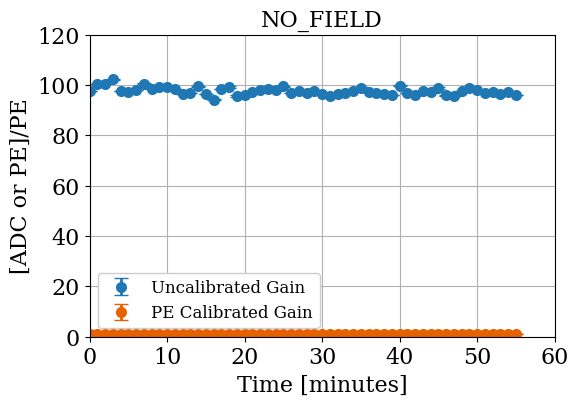

In [12]:
plt.figure(figsize=(6,4))
time_NO_FIELD=np.arange(0,len(NO_FIELD_calib_pe))
plt.errorbar(time_NO_FIELD,NO_FIELD_gain_list*9,yerr=NO_FIELD_gain_err,fmt='o',ms=7,label='Uncalibrated Gain')
plt.errorbar(time_NO_FIELD,NO_FIELD_pe_corrected_gain,yerr=NO_FIELD_pe_corrected_gain_err,fmt='o',ms=7,label='PE Calibrated Gain')

plt.ylabel('[ADC or PE]/PE')
plt.xlabel('Time [minutes]')
plt.title('NO_FIELD')
plt.grid()
plt.legend(loc='best')
plt.savefig('NO_FIELD_gain_comparison.pdf')
plt.show()

### Doing the same here for the positive E field

C:\Data\20220630\LXe_Full_E_field_2kV_source_reposition_PDE\mca_keith_31.00OV_0.h5


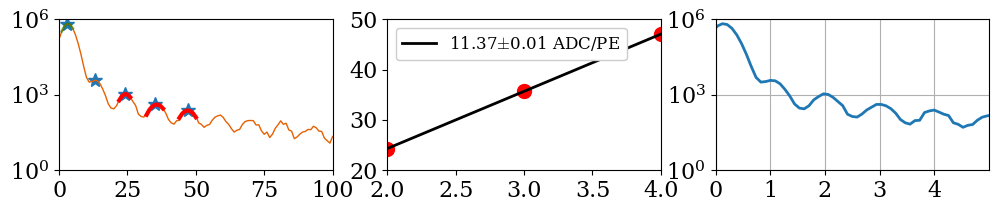

C:\Data\20220630\LXe_Full_E_field_2kV_source_reposition_PDE\mca_keith_31.00OV_1.h5


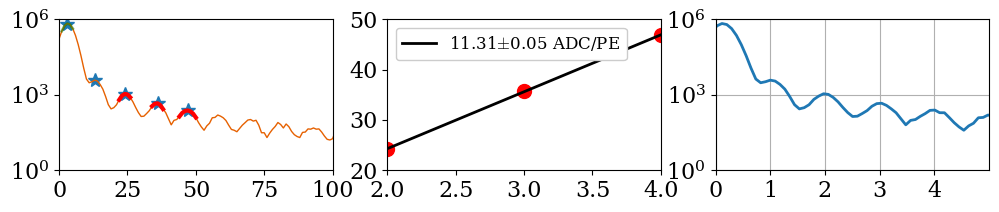

C:\Data\20220630\LXe_Full_E_field_2kV_source_reposition_PDE\mca_keith_31.00OV_2.h5


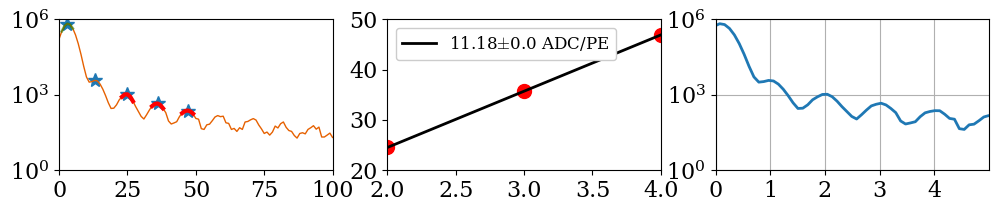

C:\Data\20220630\LXe_Full_E_field_2kV_source_reposition_PDE\mca_keith_31.00OV_3.h5


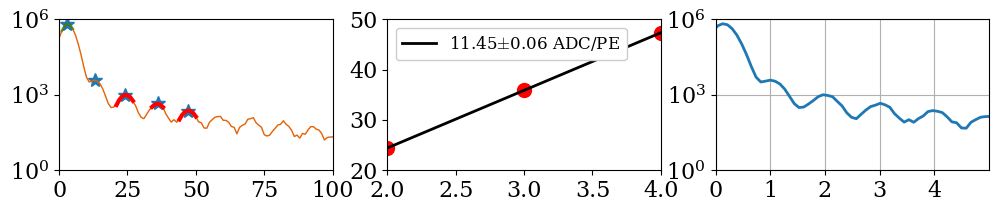

C:\Data\20220630\LXe_Full_E_field_2kV_source_reposition_PDE\mca_keith_31.00OV_4.h5


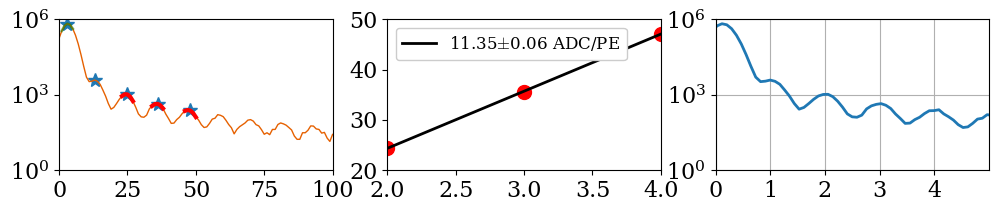

C:\Data\20220630\LXe_Full_E_field_2kV_source_reposition_PDE\mca_keith_31.00OV_5.h5


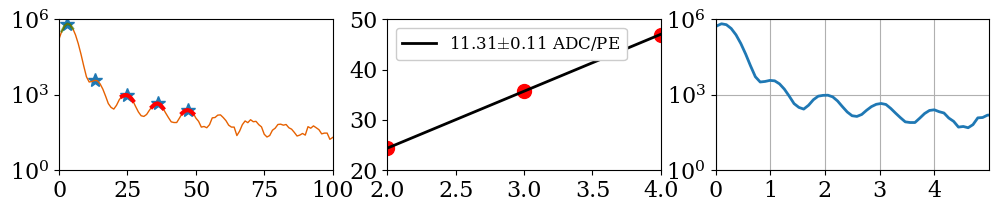

C:\Data\20220630\LXe_Full_E_field_2kV_source_reposition_PDE\mca_keith_31.00OV_6.h5


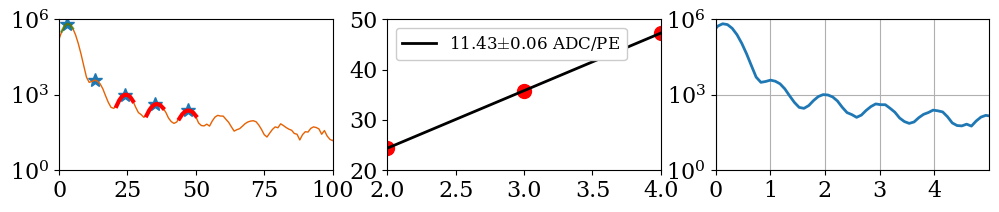

C:\Data\20220630\LXe_Full_E_field_2kV_source_reposition_PDE\mca_keith_31.00OV_7.h5


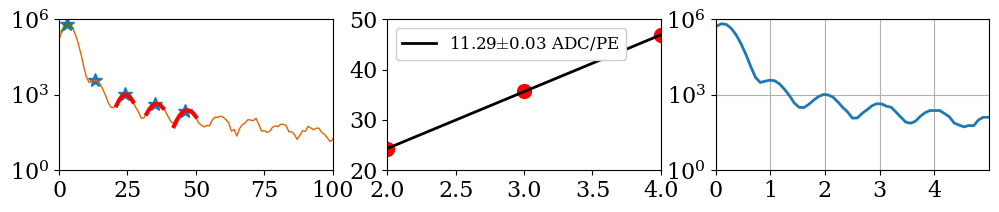

C:\Data\20220630\LXe_Full_E_field_2kV_source_reposition_PDE\mca_keith_31.00OV_8.h5


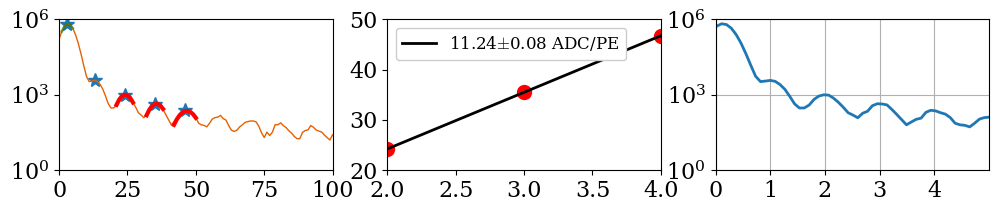

C:\Data\20220630\LXe_Full_E_field_2kV_source_reposition_PDE\mca_keith_31.00OV_9.h5


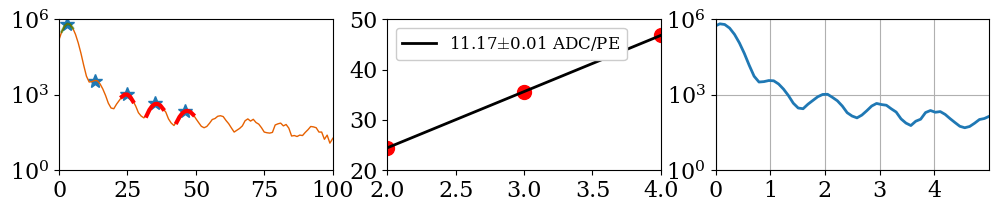

C:\Data\20220630\LXe_Full_E_field_2kV_source_reposition_PDE\mca_keith_31.00OV_10.h5


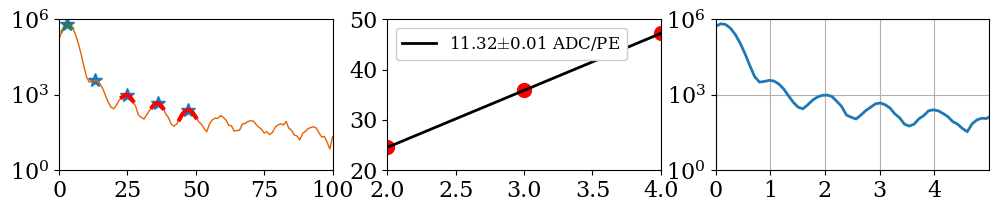

C:\Data\20220630\LXe_Full_E_field_2kV_source_reposition_PDE\mca_keith_31.00OV_11.h5


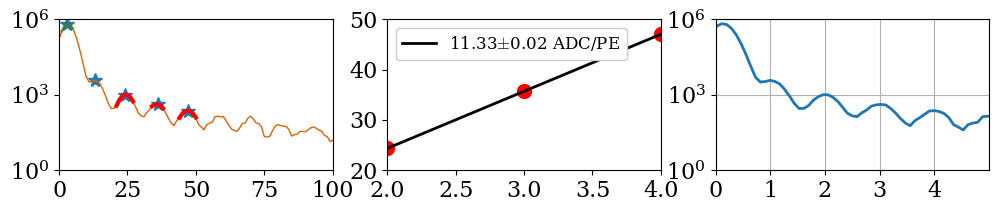

C:\Data\20220630\LXe_Full_E_field_2kV_source_reposition_PDE\mca_keith_31.00OV_12.h5


c:\Users\nEXO\anaconda3\lib\site-packages\scipy\optimize\minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


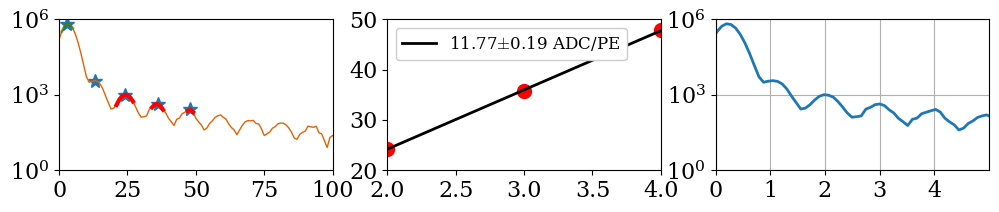

C:\Data\20220630\LXe_Full_E_field_2kV_source_reposition_PDE\mca_keith_31.00OV_13.h5


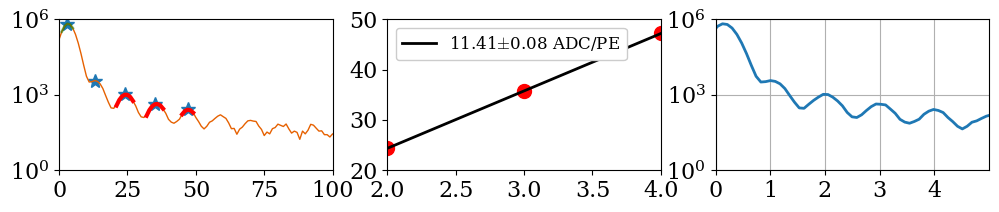

C:\Data\20220630\LXe_Full_E_field_2kV_source_reposition_PDE\mca_keith_31.00OV_14.h5


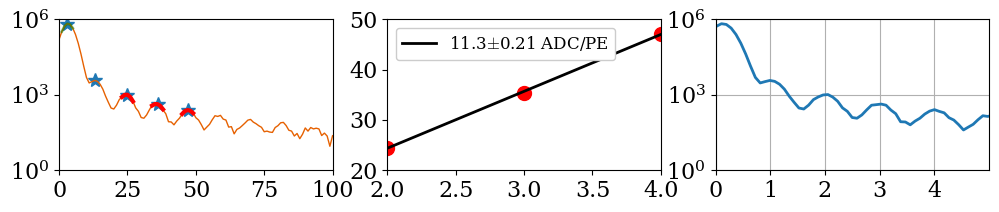

C:\Data\20220630\LXe_Full_E_field_2kV_source_reposition_PDE\mca_keith_31.00OV_15.h5


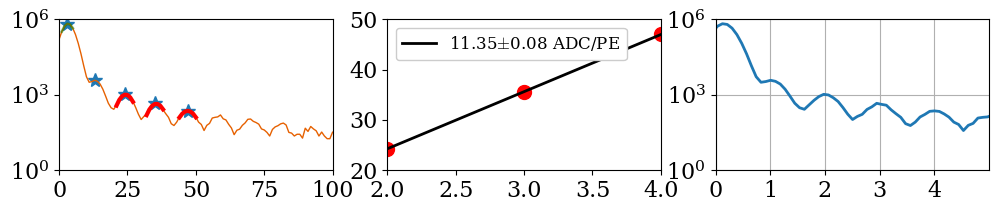

C:\Data\20220630\LXe_Full_E_field_2kV_source_reposition_PDE\mca_keith_31.00OV_16.h5


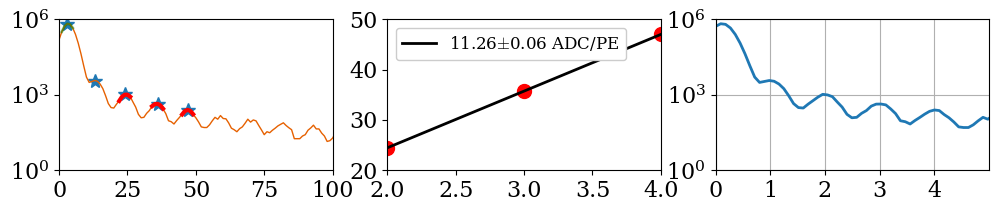

C:\Data\20220630\LXe_Full_E_field_2kV_source_reposition_PDE\mca_keith_31.00OV_17.h5


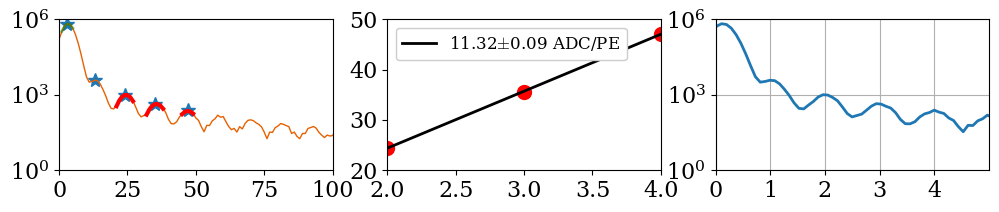

C:\Data\20220630\LXe_Full_E_field_2kV_source_reposition_PDE\mca_keith_31.00OV_18.h5


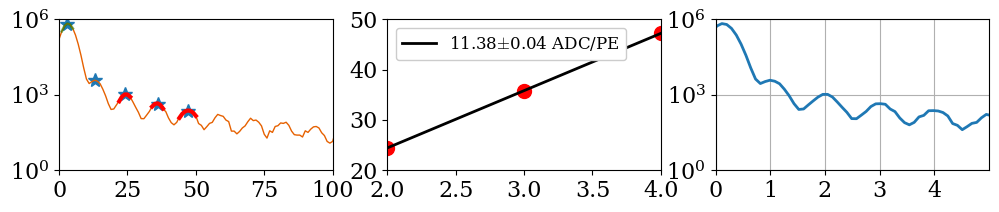

C:\Data\20220630\LXe_Full_E_field_2kV_source_reposition_PDE\mca_keith_31.00OV_19.h5


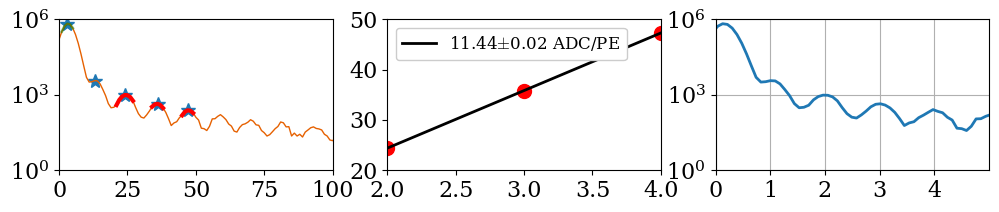

C:\Data\20220630\LXe_Full_E_field_2kV_source_reposition_PDE\mca_keith_31.00OV_20.h5


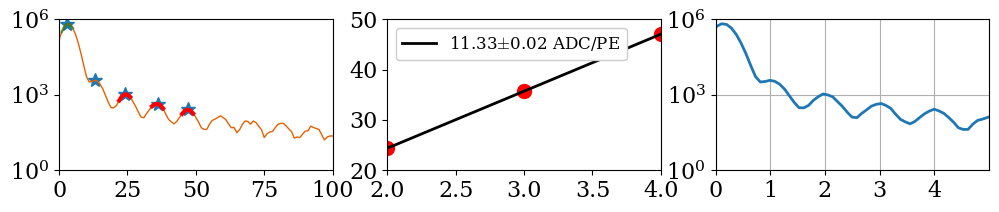

C:\Data\20220630\LXe_Full_E_field_2kV_source_reposition_PDE\mca_keith_31.00OV_21.h5


c:\Users\nEXO\anaconda3\lib\site-packages\scipy\optimize\minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


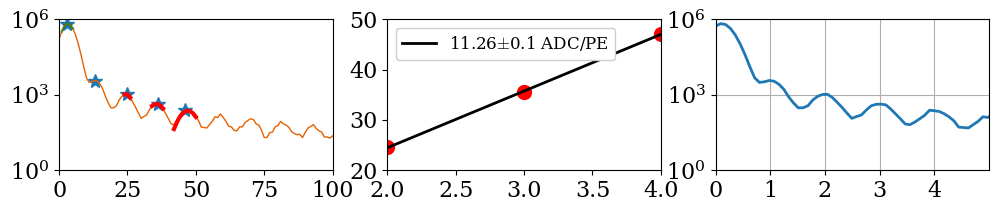

C:\Data\20220630\LXe_Full_E_field_2kV_source_reposition_PDE\mca_keith_31.00OV_22.h5


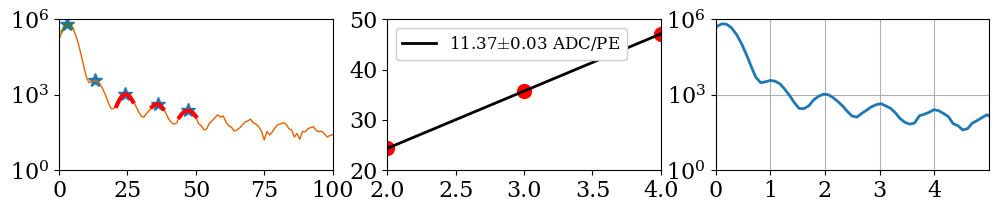

C:\Data\20220630\LXe_Full_E_field_2kV_source_reposition_PDE\mca_keith_31.00OV_23.h5


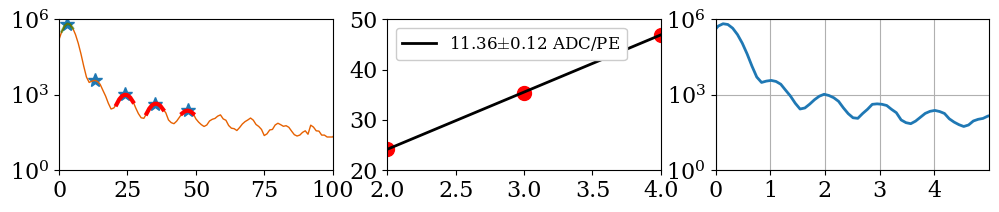

C:\Data\20220630\LXe_Full_E_field_2kV_source_reposition_PDE\mca_keith_31.00OV_24.h5


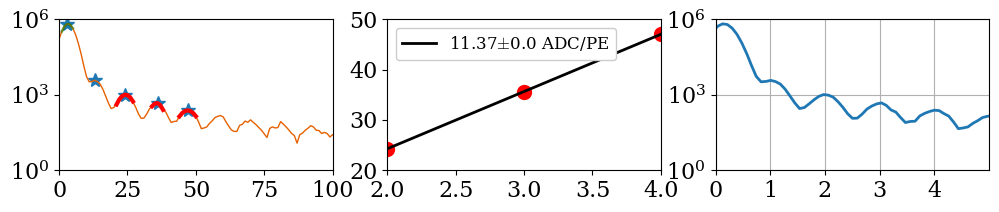

C:\Data\20220630\LXe_Full_E_field_2kV_source_reposition_PDE\mca_keith_31.00OV_25.h5


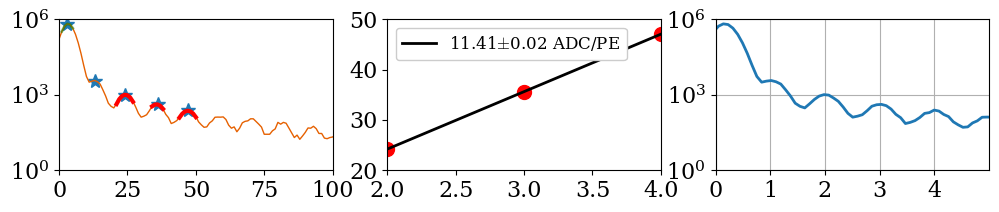

C:\Data\20220630\LXe_Full_E_field_2kV_source_reposition_PDE\mca_keith_31.00OV_26.h5


c:\Users\nEXO\anaconda3\lib\site-packages\scipy\optimize\minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


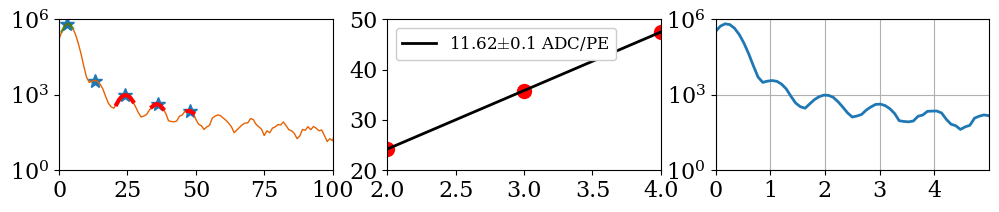

C:\Data\20220630\LXe_Full_E_field_2kV_source_reposition_PDE\mca_keith_31.00OV_27.h5


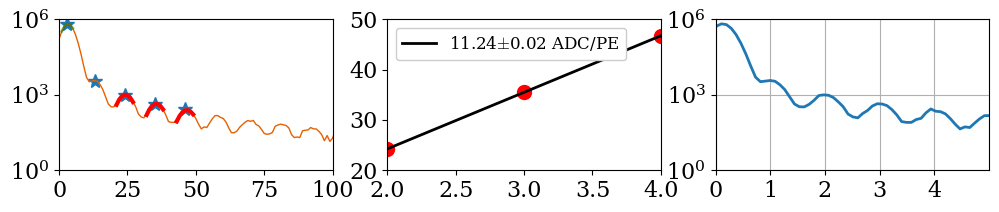

C:\Data\20220630\LXe_Full_E_field_2kV_source_reposition_PDE\mca_keith_31.00OV_28.h5


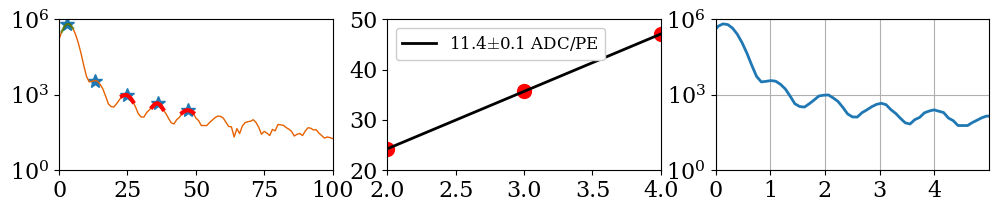

C:\Data\20220630\LXe_Full_E_field_2kV_source_reposition_PDE\mca_keith_31.00OV_29.h5


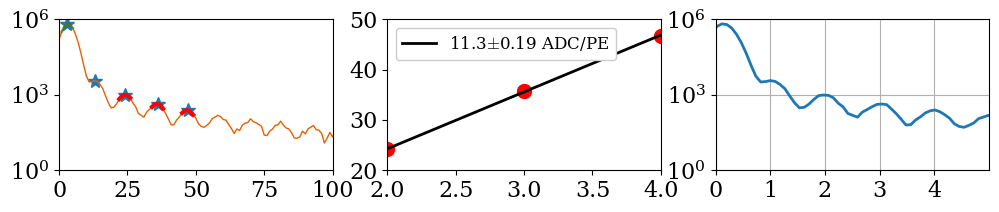

C:\Data\20220630\LXe_Full_E_field_2kV_source_reposition_PDE\mca_keith_31.00OV_30.h5


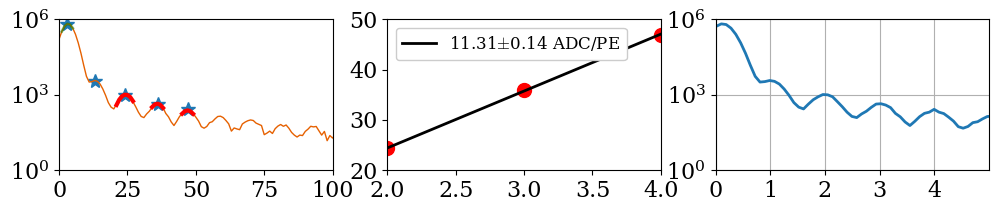

C:\Data\20220630\LXe_Full_E_field_2kV_source_reposition_PDE\mca_keith_31.00OV_31.h5


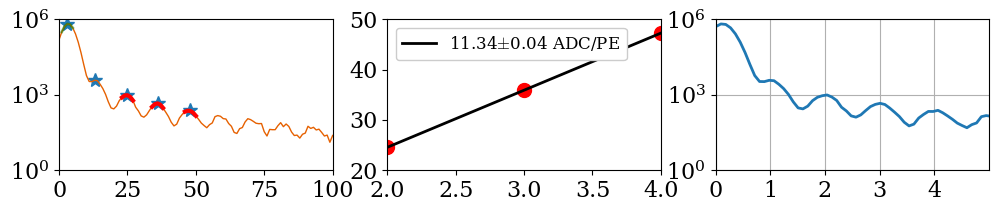

C:\Data\20220630\LXe_Full_E_field_2kV_source_reposition_PDE\mca_keith_31.00OV_32.h5


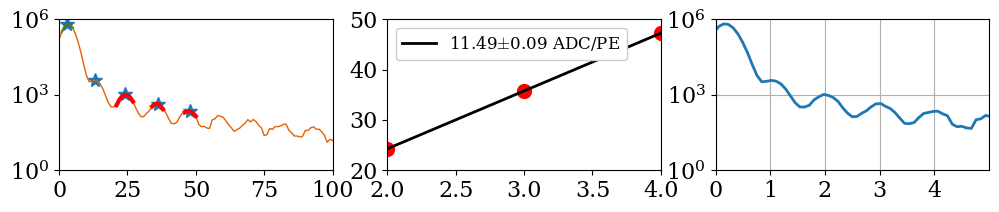

C:\Data\20220630\LXe_Full_E_field_2kV_source_reposition_PDE\mca_keith_31.00OV_33.h5


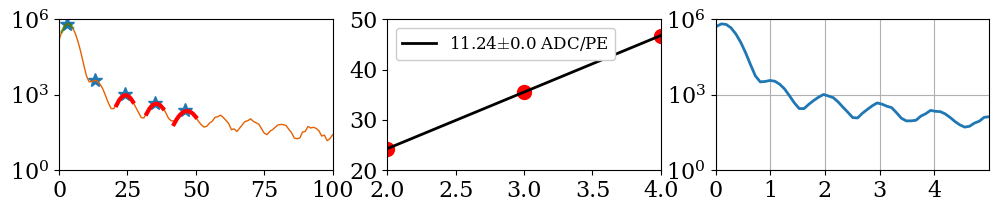

C:\Data\20220630\LXe_Full_E_field_2kV_source_reposition_PDE\mca_keith_31.00OV_34.h5


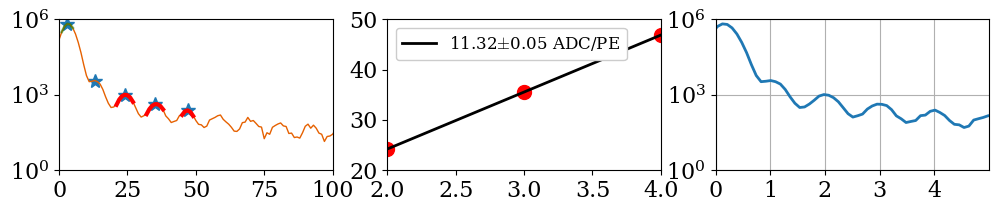

C:\Data\20220630\LXe_Full_E_field_2kV_source_reposition_PDE\mca_keith_31.00OV_35.h5


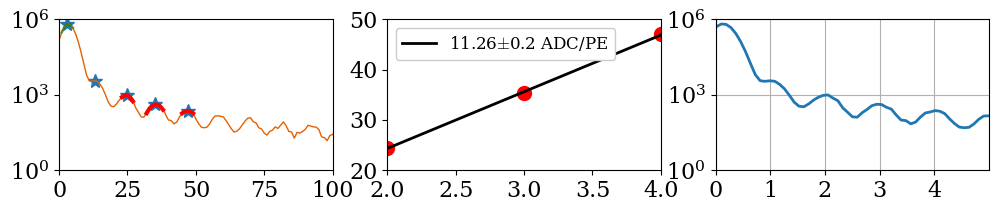

C:\Data\20220630\LXe_Full_E_field_2kV_source_reposition_PDE\mca_keith_31.00OV_36.h5


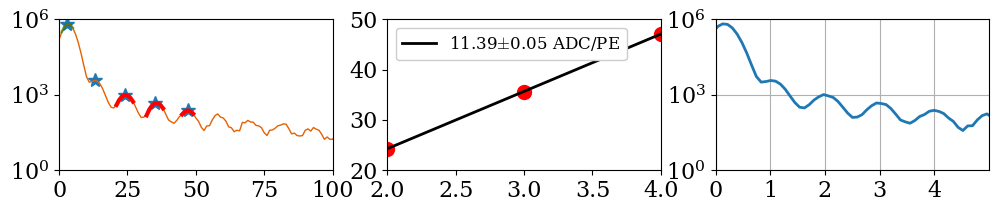

C:\Data\20220630\LXe_Full_E_field_2kV_source_reposition_PDE\mca_keith_31.00OV_37.h5


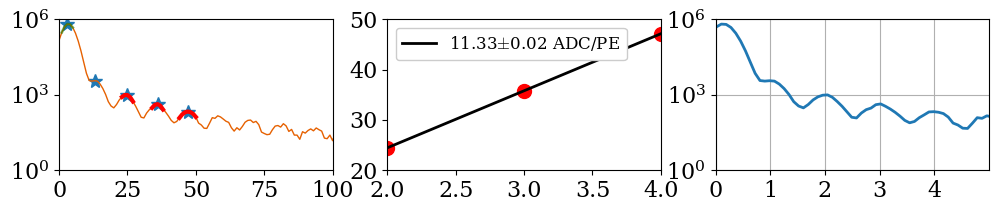

C:\Data\20220630\LXe_Full_E_field_2kV_source_reposition_PDE\mca_keith_31.00OV_38.h5


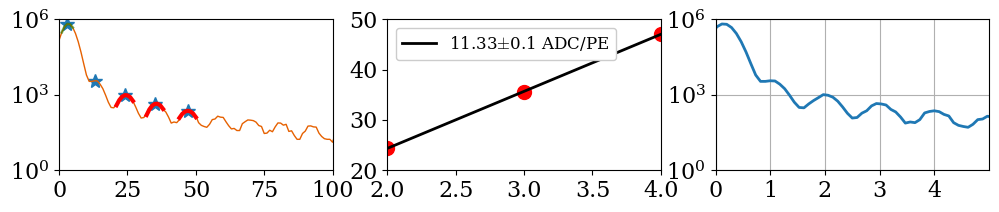

C:\Data\20220630\LXe_Full_E_field_2kV_source_reposition_PDE\mca_keith_31.00OV_39.h5


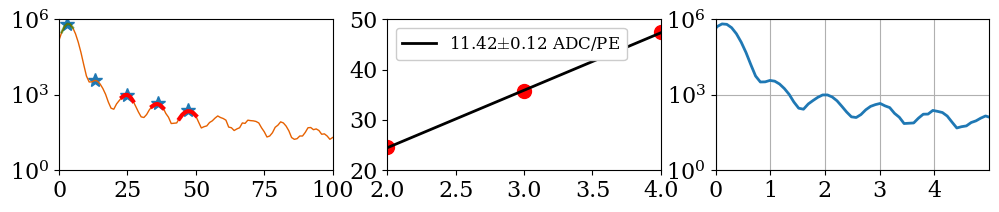

C:\Data\20220630\LXe_Full_E_field_2kV_source_reposition_PDE\mca_keith_31.00OV_40.h5


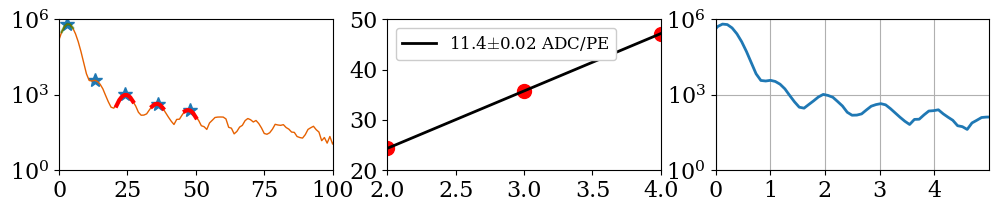

C:\Data\20220630\LXe_Full_E_field_2kV_source_reposition_PDE\mca_keith_31.00OV_41.h5


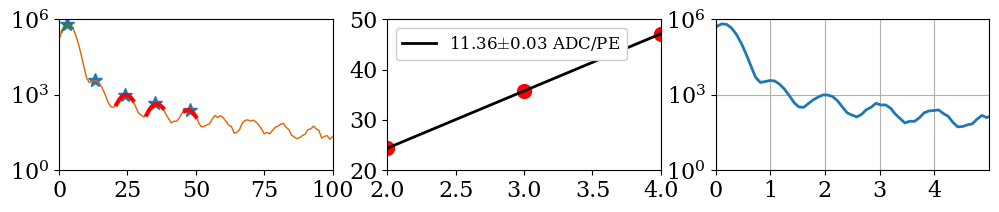

C:\Data\20220630\LXe_Full_E_field_2kV_source_reposition_PDE\mca_keith_31.00OV_42.h5


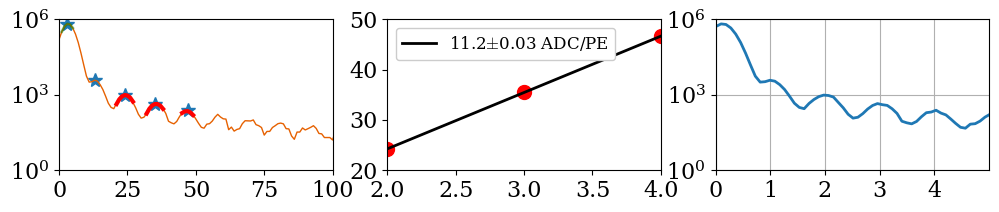

C:\Data\20220630\LXe_Full_E_field_2kV_source_reposition_PDE\mca_keith_31.00OV_43.h5


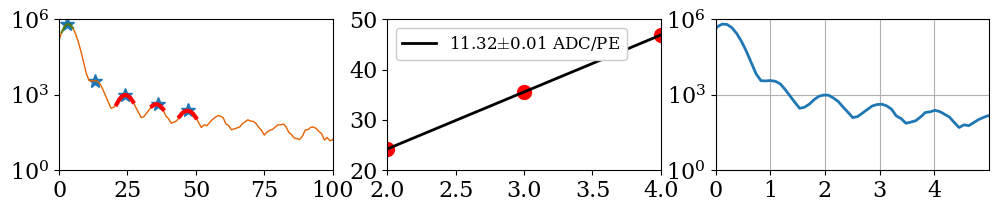

C:\Data\20220630\LXe_Full_E_field_2kV_source_reposition_PDE\mca_keith_31.00OV_44.h5


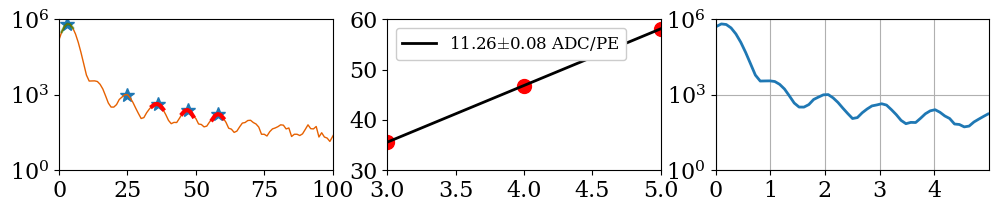

C:\Data\20220630\LXe_Full_E_field_2kV_source_reposition_PDE\mca_keith_31.00OV_45.h5


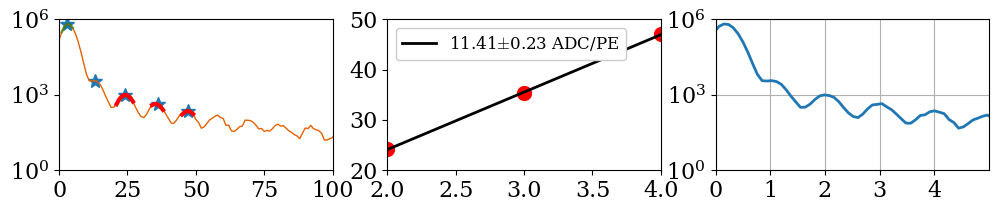

C:\Data\20220630\LXe_Full_E_field_2kV_source_reposition_PDE\mca_keith_31.00OV_46.h5


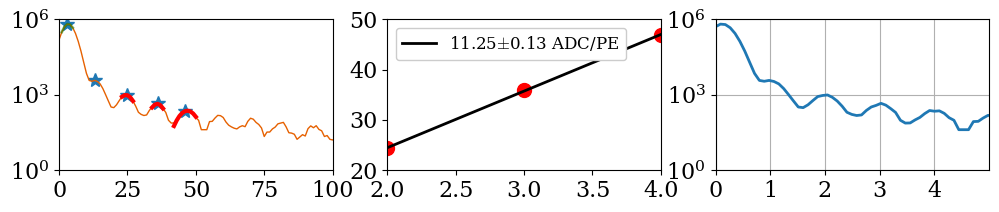

C:\Data\20220630\LXe_Full_E_field_2kV_source_reposition_PDE\mca_keith_31.00OV_47.h5


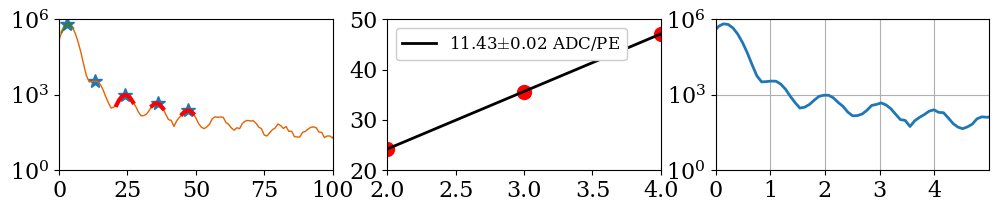

C:\Data\20220630\LXe_Full_E_field_2kV_source_reposition_PDE\mca_keith_31.00OV_48.h5


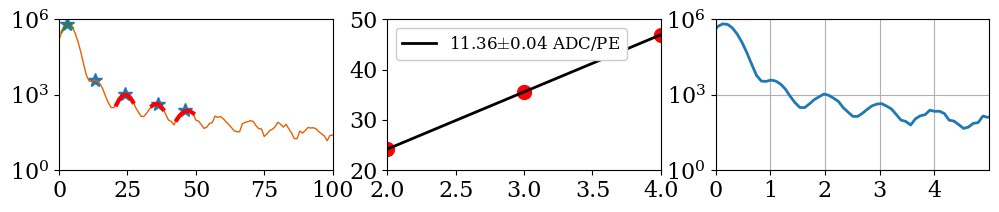

C:\Data\20220630\LXe_Full_E_field_2kV_source_reposition_PDE\mca_keith_31.00OV_49.h5


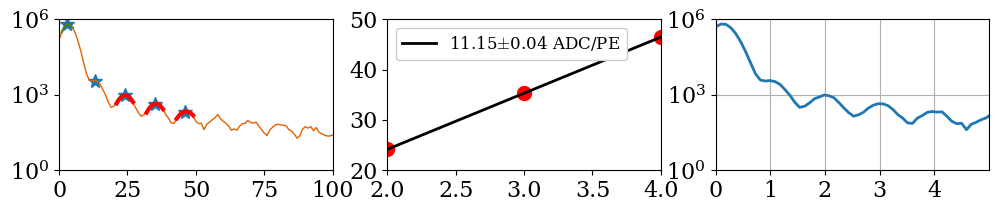

C:\Data\20220630\LXe_Full_E_field_2kV_source_reposition_PDE\mca_keith_31.00OV_50.h5


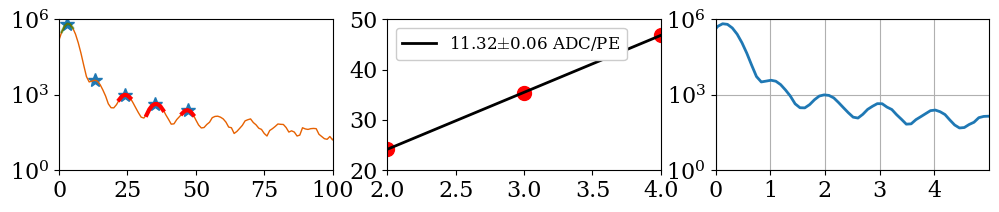

C:\Data\20220630\LXe_Full_E_field_2kV_source_reposition_PDE\mca_keith_31.00OV_51.h5


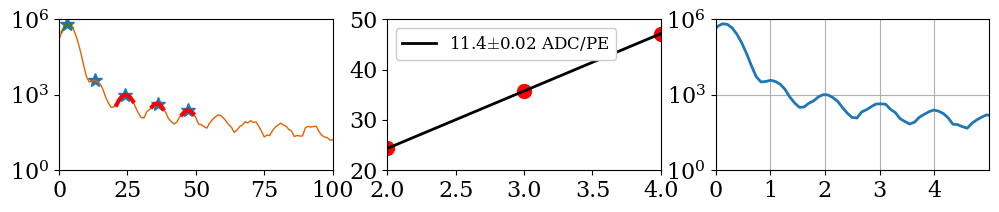

C:\Data\20220630\LXe_Full_E_field_2kV_source_reposition_PDE\mca_keith_31.00OV_52.h5


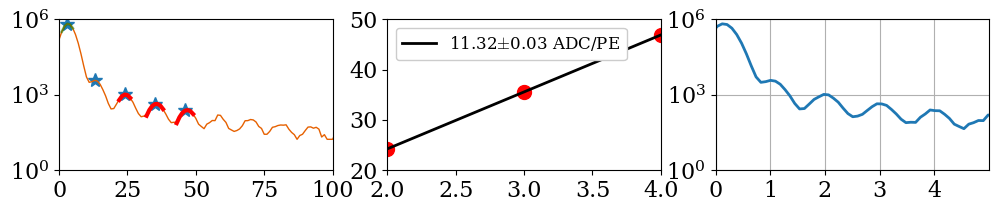

C:\Data\20220630\LXe_Full_E_field_2kV_source_reposition_PDE\mca_keith_31.00OV_53.h5


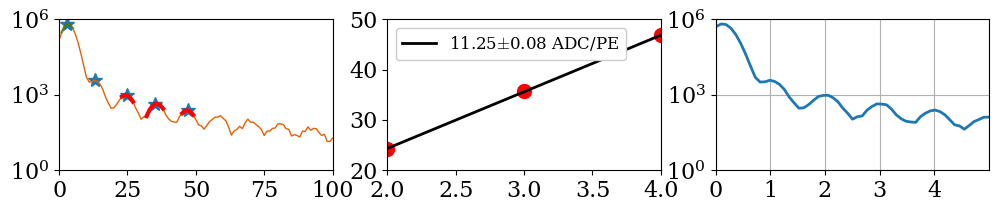

C:\Data\20220630\LXe_Full_E_field_2kV_source_reposition_PDE\mca_keith_31.00OV_54.h5


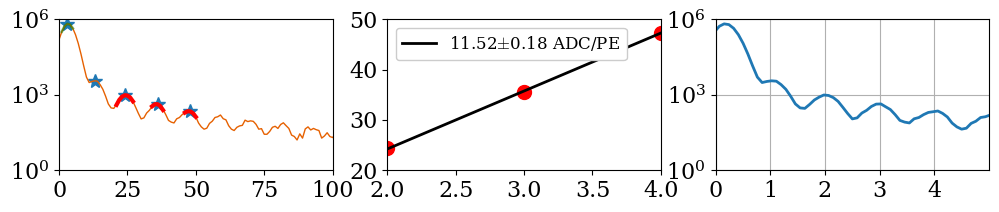

C:\Data\20220630\LXe_Full_E_field_2kV_source_reposition_PDE\mca_keith_31.00OV_55.h5


c:\Users\nEXO\anaconda3\lib\site-packages\scipy\optimize\minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


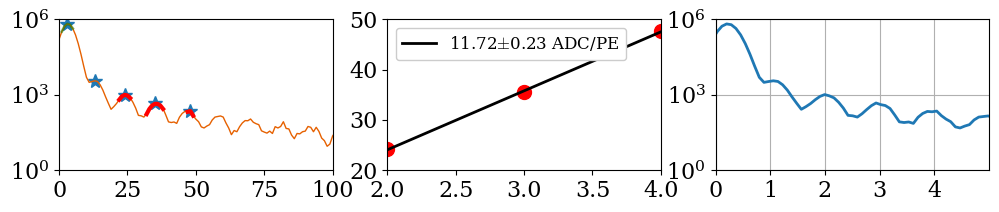

C:\Data\20220630\LXe_Full_E_field_2kV_source_reposition_PDE\mca_keith_31.00OV_56.h5


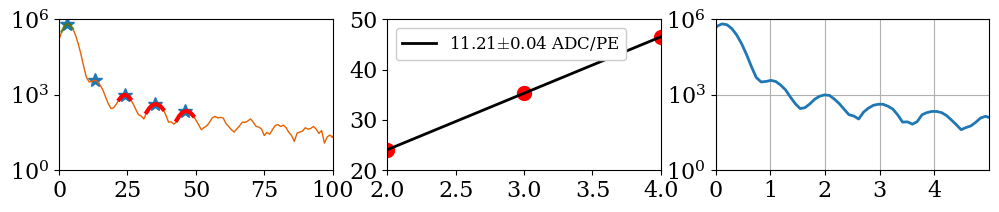

In [13]:
POS_FIELD_calib_pe,POS_FIELD_calib_count,POS_FIELD_gain_list,POS_FIELD_gain_err=gain_calculator(POS_FIELD,10,4)

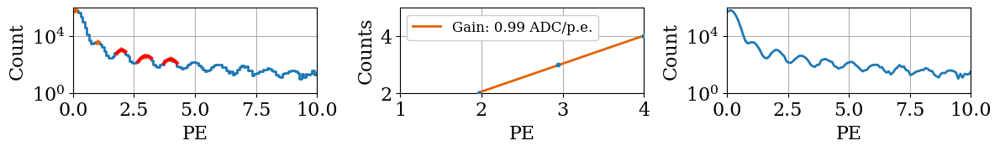

1.072551843046738e-12


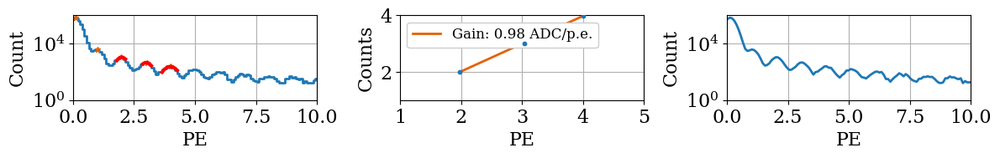

1.0745339881996128e-12


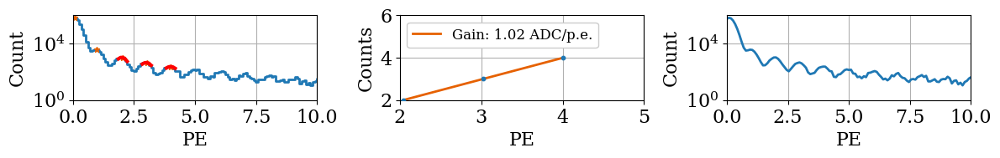

1.0893907215010675e-12


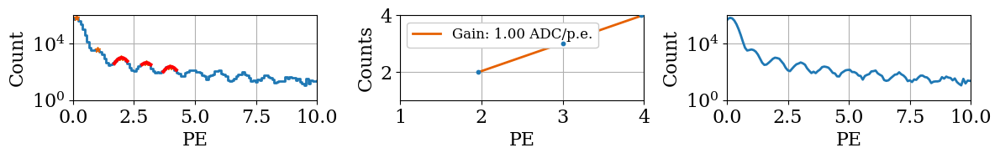

1.0503652026774473e-12


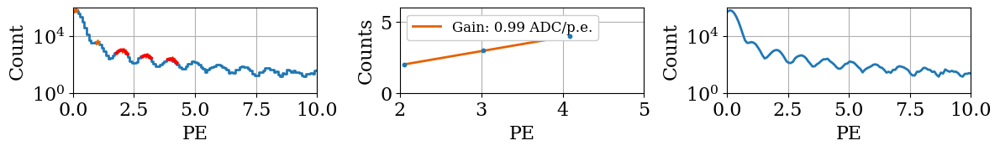

1.074656006589871e-12


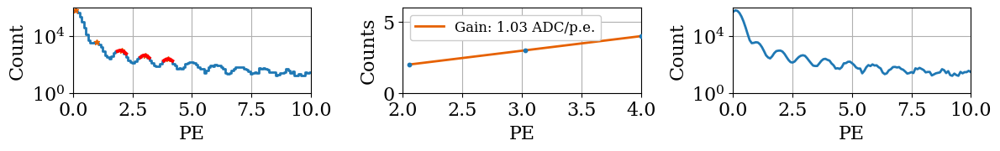

1.0712886289242434e-12


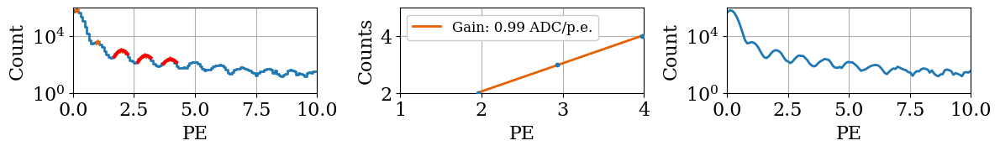

1.0744120720852977e-12


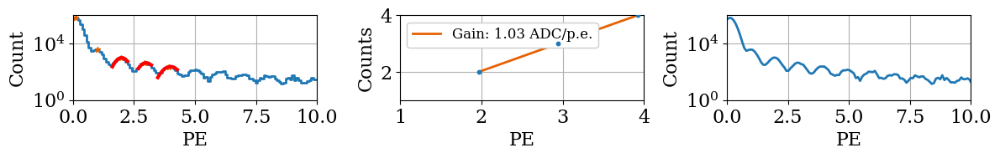

1.0853515783088922e-12


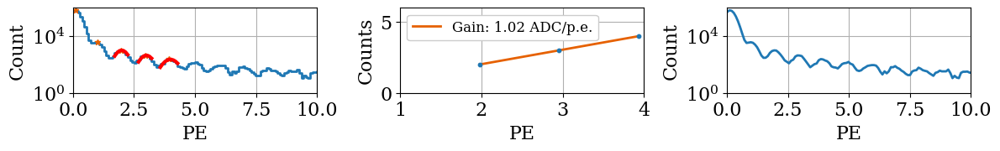

1.0870669990513642e-12


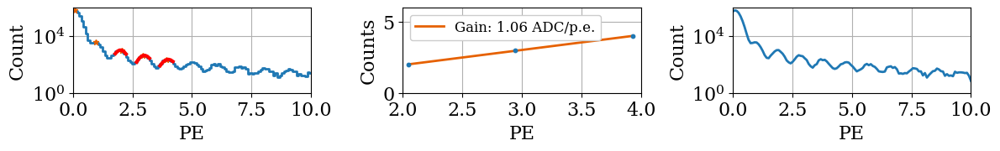

1.091769174626697e-12


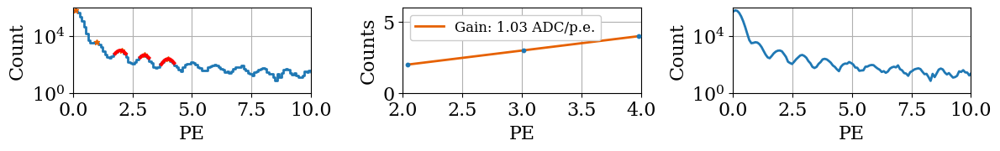

1.078089421438442e-12


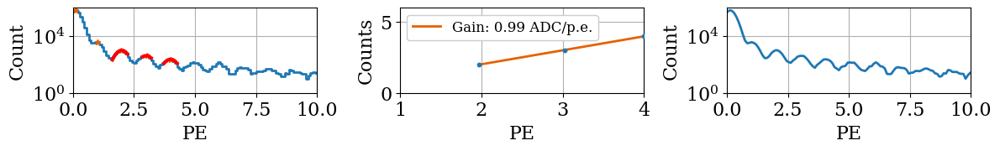

1.0712967853435723e-12


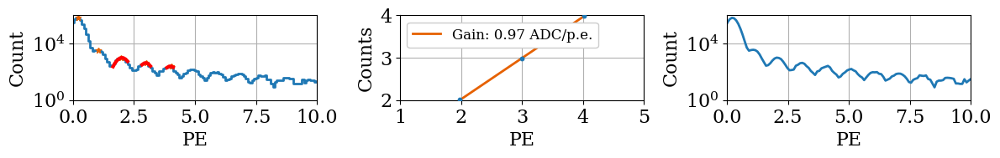

1.0405079556992946e-12


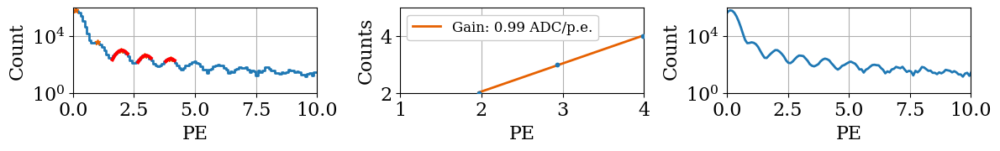

1.0828128465604406e-12


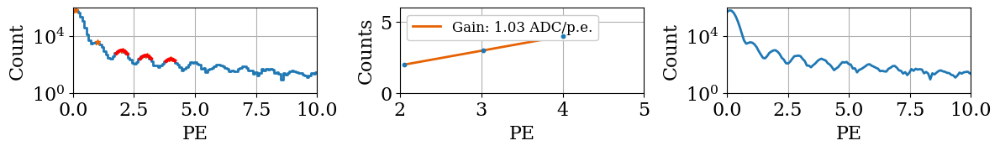

1.0962553462021476e-12


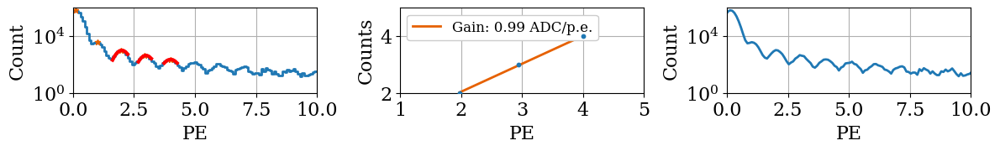

1.0883158089420433e-12


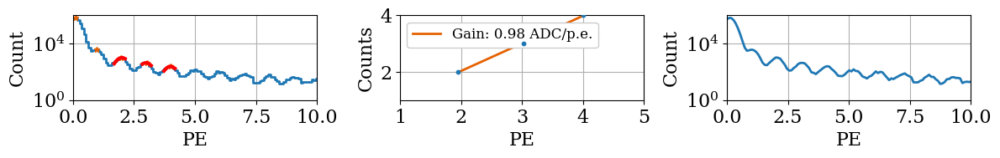

1.0722139466628246e-12


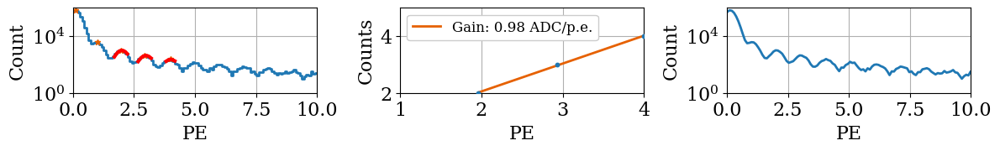

1.0863943732035964e-12


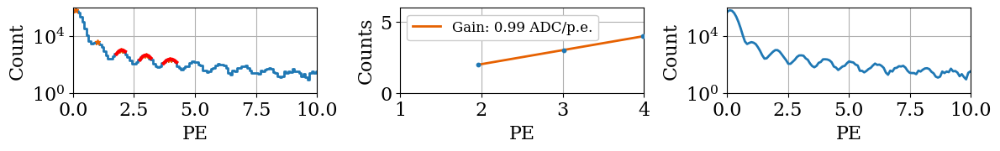

1.0800277836478121e-12


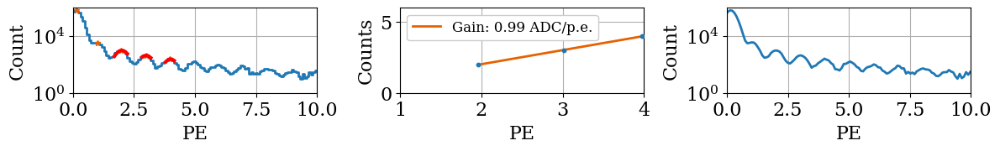

1.058385838032597e-12


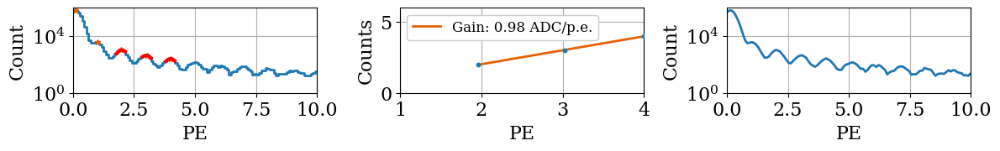

1.0780771356403416e-12


c:\Users\nEXO\anaconda3\lib\site-packages\scipy\optimize\minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\Users\nEXO\anaconda3\lib\site-packages\scipy\optimize\minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


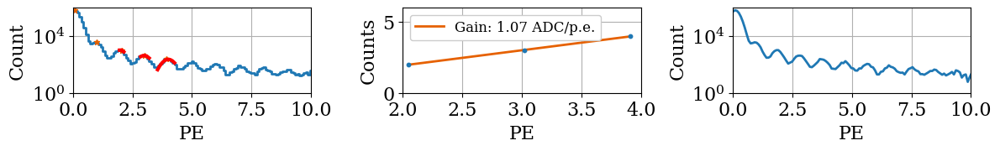

1.1014519855801349e-12


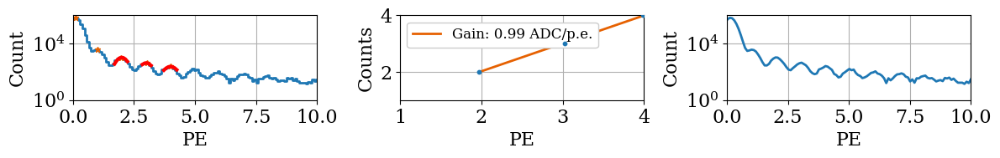

1.072310805846665e-12


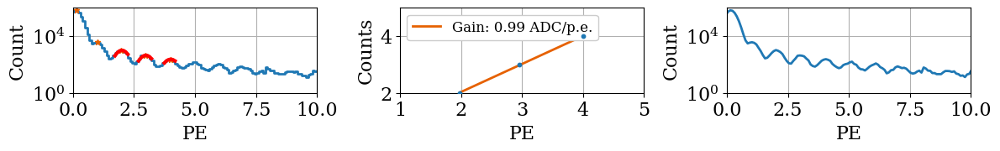

1.0768784789836294e-12


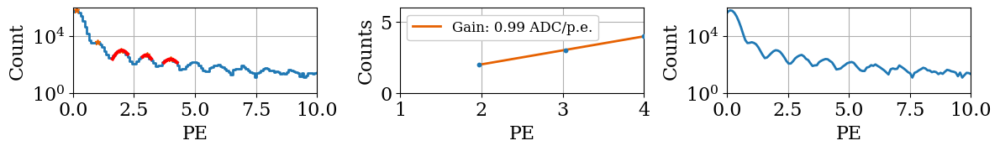

1.0829901950638485e-12


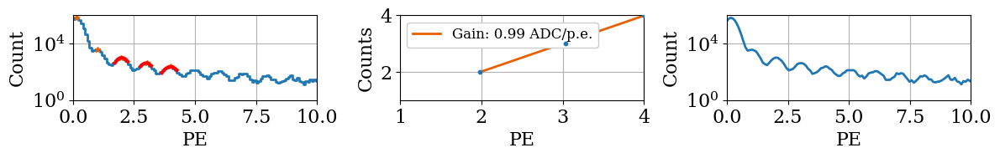

1.0892285031111221e-12


c:\Users\nEXO\anaconda3\lib\site-packages\scipy\optimize\minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


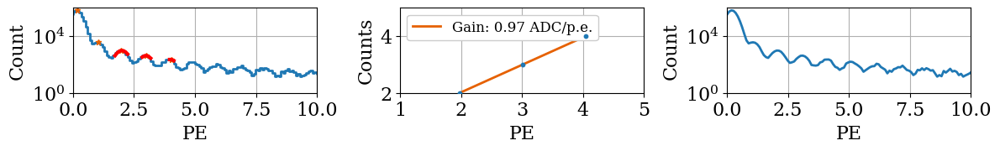

1.0732396838378438e-12


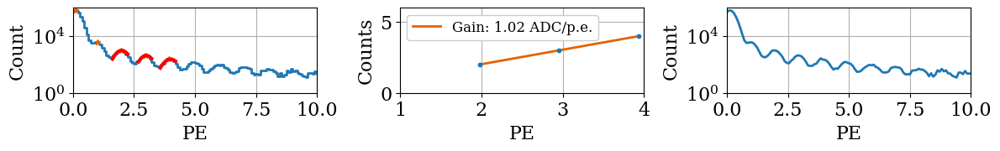

1.0805915415275584e-12


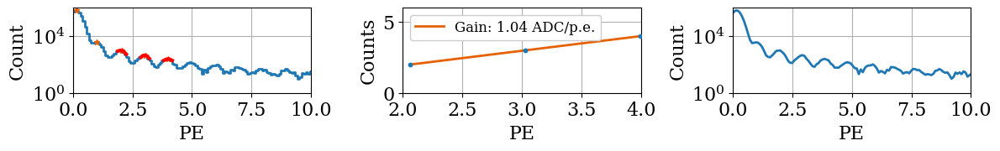

1.0906528710775368e-12


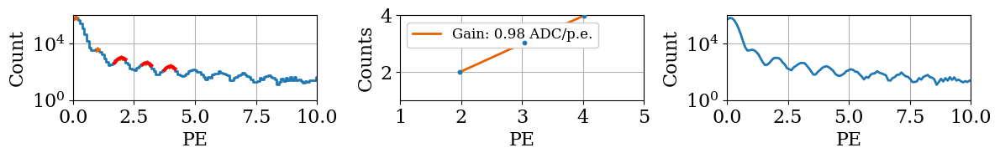

1.0706647153551493e-12


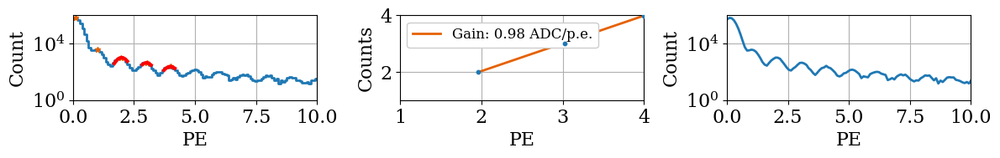

1.0682526184124735e-12


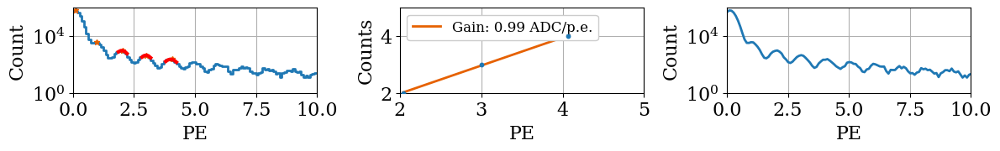

1.0721662431721559e-12


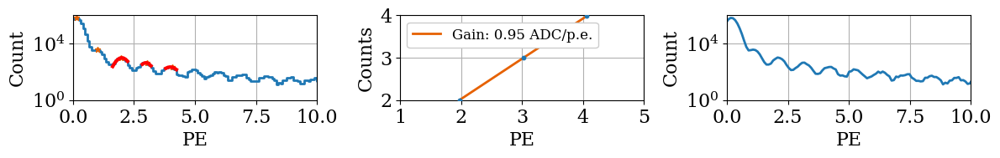

1.0882272659358543e-12


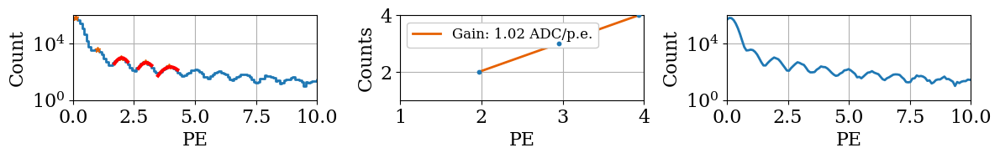

1.0894896937058796e-12


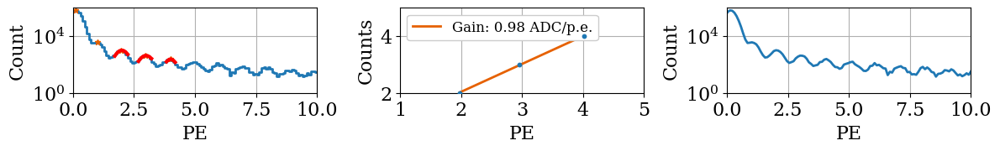

1.0789607348493875e-12


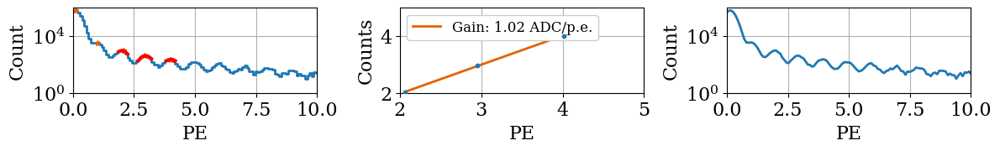

1.0790851172300199e-12


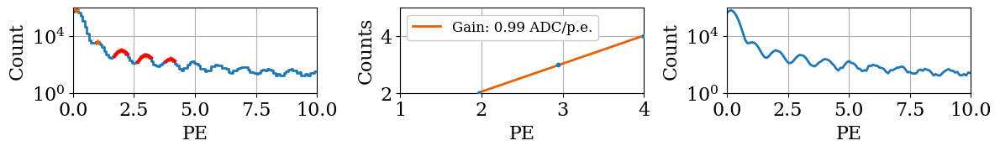

1.078394387836177e-12


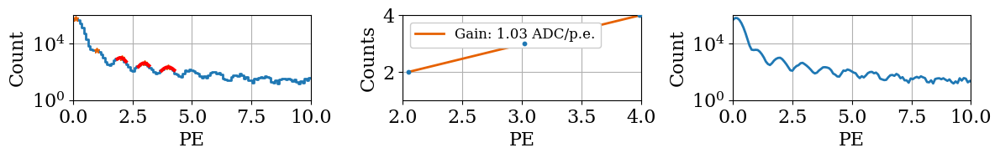

1.068089545620089e-12


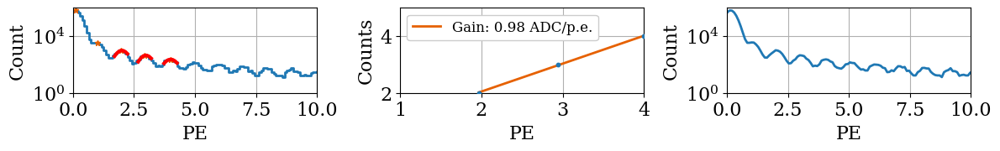

1.058361075456439e-12


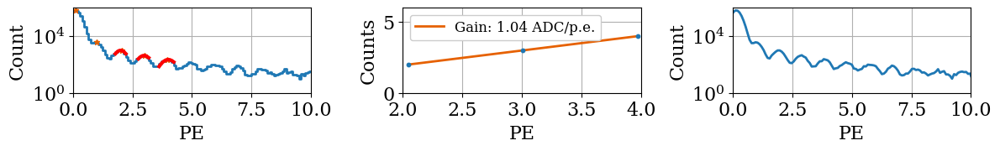

1.0761784358781255e-12


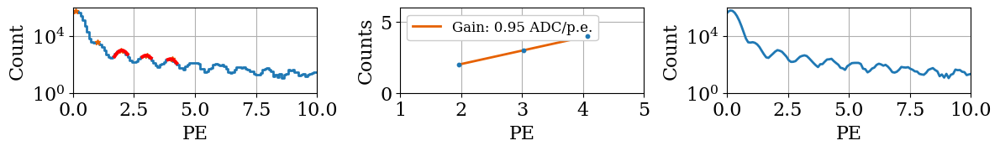

1.0867224871711449e-12


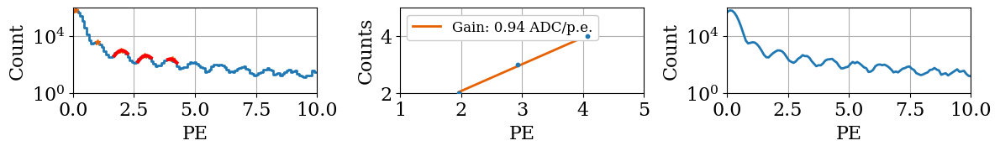

1.0911528618466851e-12


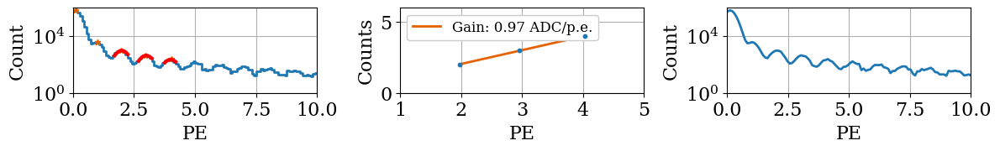

1.0902420485323639e-12


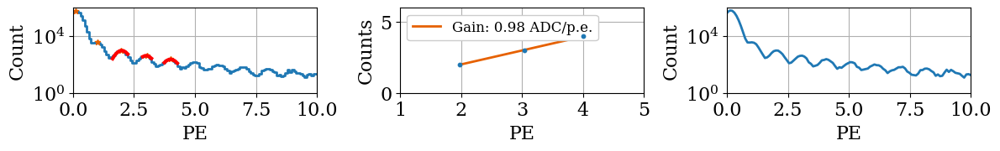

1.0856265350900072e-12


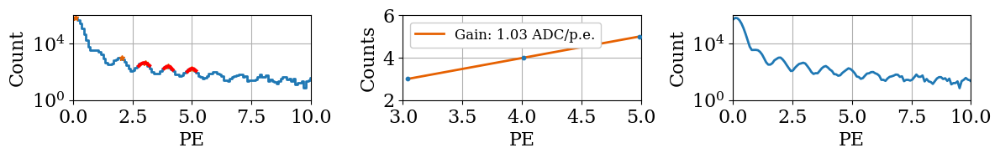

1.103233888788634e-12


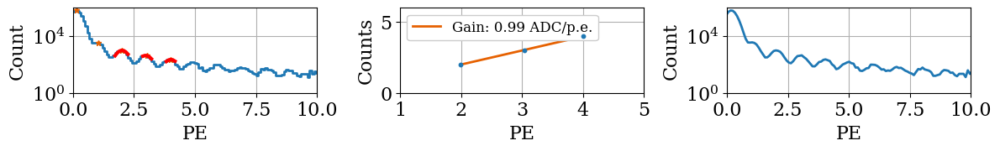

1.073636167549126e-12


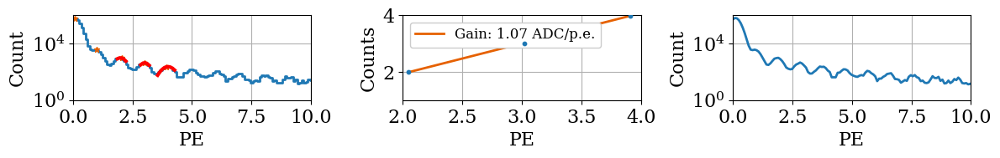

1.1028529809547902e-12


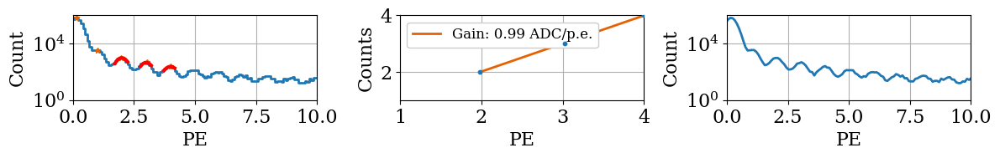

1.0682174538692143e-12


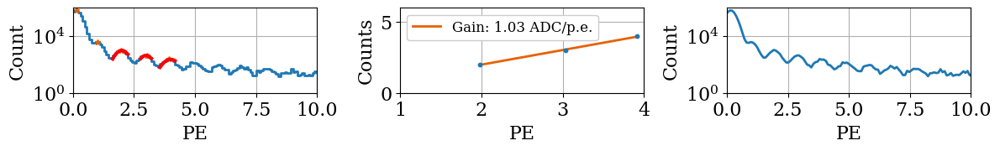

1.0828100347547937e-12


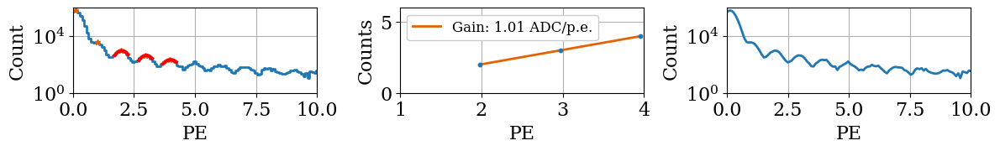

1.1040729149779797e-12


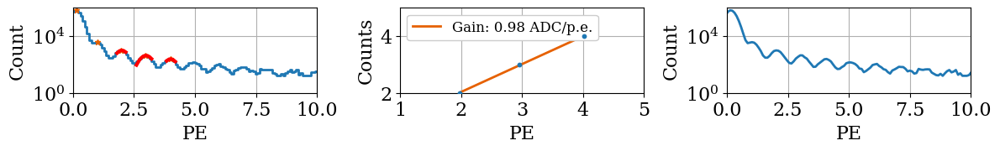

1.093896014560478e-12


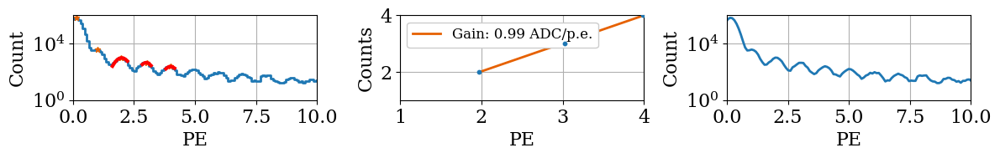

1.0865593484565276e-12


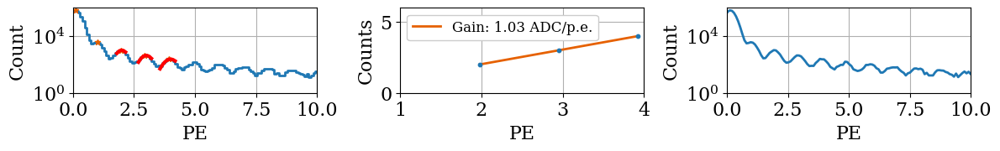

1.0822356138208303e-12


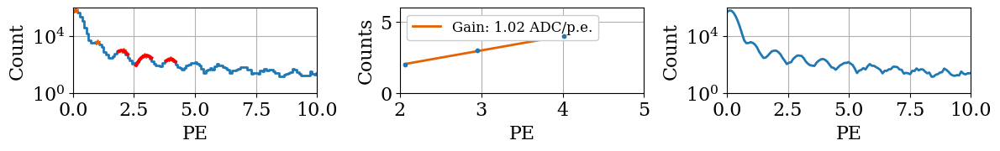

1.0558282078212123e-12


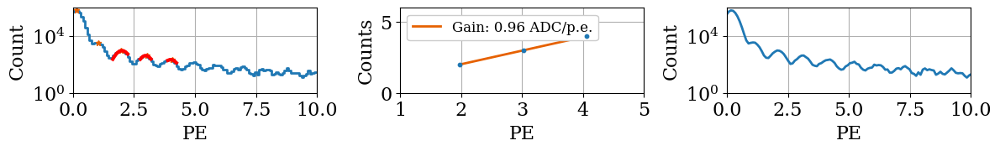

1.0666683690201684e-12


c:\Users\nEXO\anaconda3\lib\site-packages\scipy\optimize\minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


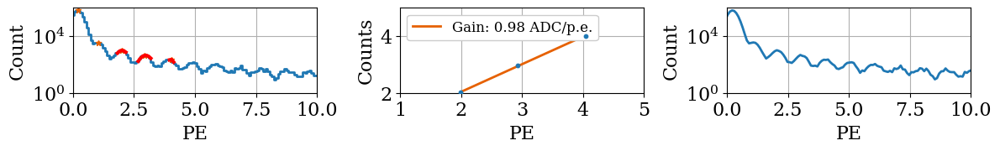

1.0712330798773966e-12


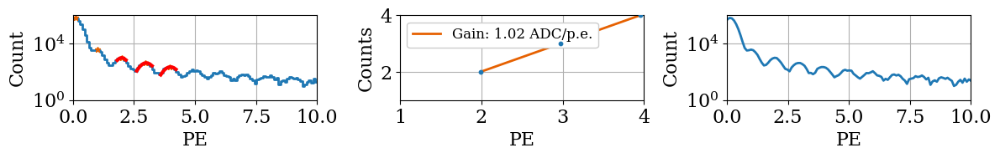

1.0950524629784843e-12


In [14]:
POS_FIELD_pe_corrected_gain=[]
POS_FIELD_pe_corrected_gain_err=[]
POS_FIELD_calib_pe_updated=[]
for x,y in zip(POS_FIELD_calib_pe,POS_FIELD_calib_count):
    plt.figure(figsize=(12,2))
    plt.subplot(1,3,1)
    plt.step(x,y)
    plt.yscale('log')
    plt.xlim(0,10)
    plt.grid()
    plt.xlabel('PE')
    plt.ylabel('Count')
    
    
    N_peaks=4
    PROMINENCE=1E3 #This prominence is re-set here to ensure that every file starts out with a high prominence
    
    peaks,pdict=find_peaks(y,prominence=PROMINENCE,distance=5)
    peak_length=len(peaks)
    
#     We want to ensure that using a high prominence gives us at least N_peaks peaks to fit a straight line to. If it doesn't we reduce prominence till we get at least 3 peaks. N_peaks is set above
    while (peak_length<N_peaks+1):
        PROMINENCE=PROMINENCE-1
            
        peaks,pdict=find_peaks(y,prominence=PROMINENCE,distance=5)
        peak_length=len(peaks)


        
    plt.plot(x[peaks],y[peaks],'*',ms=5) # plot the peak markers
    first_pe_max=x[peaks[2]] # The x-value of the 3rd peak.Index=1 means the second peak will be used for getting fit parameters
    max_value=y[peaks[2]] # The height of the 3rd peak
    x_idx_array=(y<0.5*max_value) & (x>first_pe_max)# returns a boolean array where both conditions are true
    right_side_x= x[np.where(x_idx_array)[0][0]] #finding the first time where x_idx_array is True
    sigma_guess=np.abs(first_pe_max-right_side_x) #We need this to fit the width of the Gaussian peaks
    cut= (x < first_pe_max+sigma_guess) & (x > first_pe_max-sigma_guess) # This cut helps to fix the width of the peak-fit
    popt,pcov=curve_fit(gauss,x[cut],y[cut],p0=[max_value,first_pe_max,sigma_guess],maxfev=100000) # We use curve_fit to return the optimal parameters and the covariance matrix
    plt.plot(x[cut],gauss(x[cut],*popt),color='r',label='Fit',lw=2) # Here we plot the fit on the 2nd peak to see if everything looks ok.
    
    params_pe = []
    params_pe_count=[]
    for i,peak in enumerate(peaks[2:]): #here we ignore the first peak because it could be the pedestal
        new_first_pe_max=x[peak] #x-value of the peak
        new_max_value=y[peak] #height of the peak
        new_x_idx_array=(y<0.5*new_max_value) & (x>new_first_pe_max) # returns a boolean array where both conditions are true
        new_right_side_x= x[np.where(new_x_idx_array)[0][0]] #finding the first time where x_idx_array is True
        new_sigma_guess=np.abs(new_first_pe_max-new_right_side_x) #We need this to fit the width of the Gaussian peaks


        new_cut= (x < new_first_pe_max+new_sigma_guess) & (x > new_first_pe_max-new_sigma_guess) # This cut helps to fix the width of the peak-fit
        popt_new,pcov_new=curve_fit(gauss,x[new_cut],y[new_cut],p0=[new_max_value,new_first_pe_max,new_sigma_guess],maxfev=100000) # We use curve_fit to return the optimal parameters and the covariance matrix
        plt.plot(x[new_cut],gauss(x[new_cut],*popt_new),color='r',label='Fit',lw=3) # Here we plot the fit on all the peaks
        params_pe.append(popt_new[1]) #Here we append the value of the peak fit mean 
        params_pe_count.append((x[peak]))

    plt.subplot(1,3,2) 
    
    plt.scatter(params_pe_count, np.array(params_pe), s=10, zorder=10)
    popt_line,pcov_line = curve_fit(line, params_pe_count, np.array(params_pe), p0=[10,0])
    plt.plot(params_pe_count, line(params_pe_count, *popt_line), color=colors[1], label='Gain: {:.2f} ADC/p.e.'.format(popt_line[0]))
    POS_FIELD_pe_corrected_gain.append(popt_line[0])
    POS_FIELD_pe_corrected_gain_err.append(np.sqrt(np.diag(pcov_line)[0]))
    plt.legend(loc=2)
    plt.grid()
    plt.xlabel('PE')
    plt.ylabel('Counts')

    plt.subplot(1,3,3)
    plt.plot(x/popt_line[0],y)
    POS_FIELD_calib_pe_updated.append(x/popt_line[0])
    plt.yscale('log')
    plt.xlim(0,10)
    plt.grid()
    plt.xlabel('PE')
    plt.ylabel('Count')


    plt.tight_layout()
    plt.show()

    value=0
    for i,val in enumerate(x):
        if x[i]>0.75:
            # print(i,x[i],y[i])
            value+=x[i]*y[i]
    n_electrons=value*10.7*9
    charge=n_electrons*1.6*10E-19
    current=charge/60
    print(current)

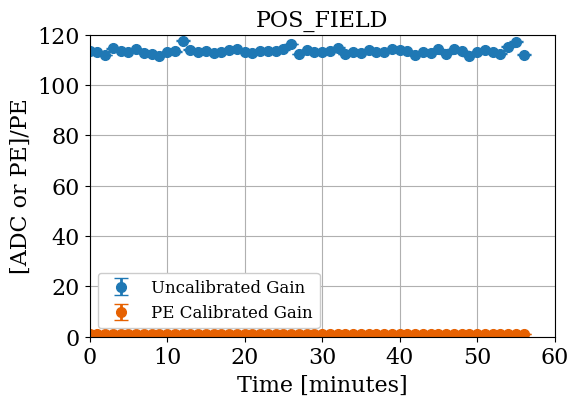

In [15]:
plt.figure(figsize=(6,4))
time_POS_FIELD=np.arange(0,len(POS_FIELD_gain_list))

plt.errorbar(time_POS_FIELD,POS_FIELD_gain_list*10,yerr=POS_FIELD_gain_err,fmt='o',ms=7,label='Uncalibrated Gain')
plt.errorbar(time_POS_FIELD,POS_FIELD_pe_corrected_gain,yerr=POS_FIELD_pe_corrected_gain_err,fmt='o',ms=7,label='PE Calibrated Gain')

plt.ylabel('[ADC or PE]/PE')
plt.xlabel('Time [minutes]')
plt.title('POS_FIELD')
plt.grid()
plt.legend(loc='best')
plt.savefig('POS_FIELD_gain_comparison.pdf')
plt.show()

### Doing the same here for the negative E field

C:\Data\20220630\LXe_Full_E_field_-2kV_source_reposition_PDE\mca_keith_31.00OV_0.h5


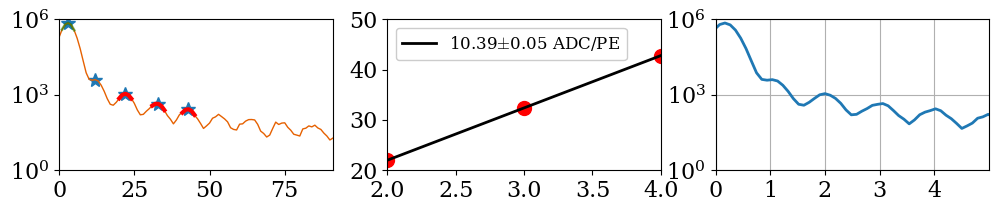

C:\Data\20220630\LXe_Full_E_field_-2kV_source_reposition_PDE\mca_keith_31.00OV_1.h5


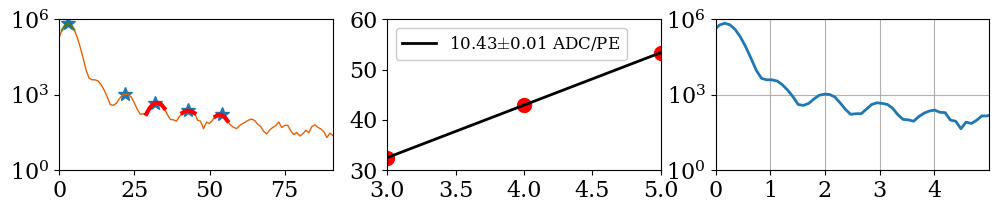

C:\Data\20220630\LXe_Full_E_field_-2kV_source_reposition_PDE\mca_keith_31.00OV_2.h5


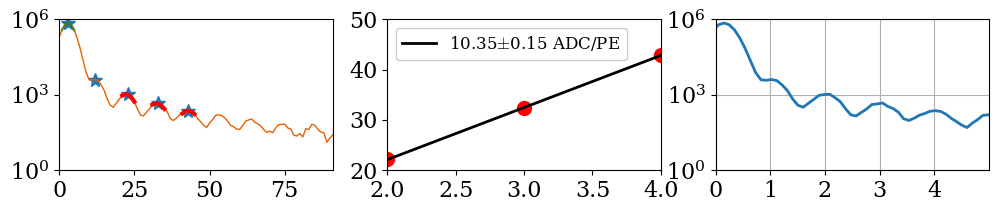

C:\Data\20220630\LXe_Full_E_field_-2kV_source_reposition_PDE\mca_keith_31.00OV_3.h5


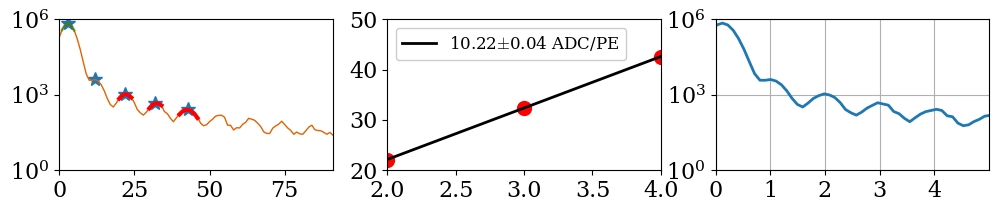

C:\Data\20220630\LXe_Full_E_field_-2kV_source_reposition_PDE\mca_keith_31.00OV_4.h5


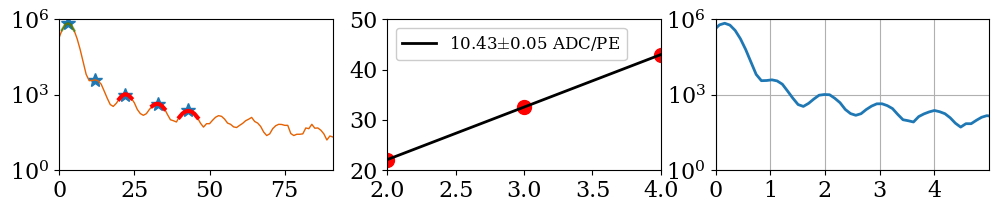

C:\Data\20220630\LXe_Full_E_field_-2kV_source_reposition_PDE\mca_keith_31.00OV_5.h5


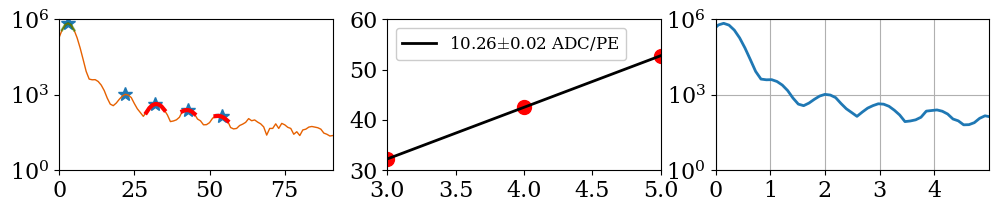

C:\Data\20220630\LXe_Full_E_field_-2kV_source_reposition_PDE\mca_keith_31.00OV_6.h5


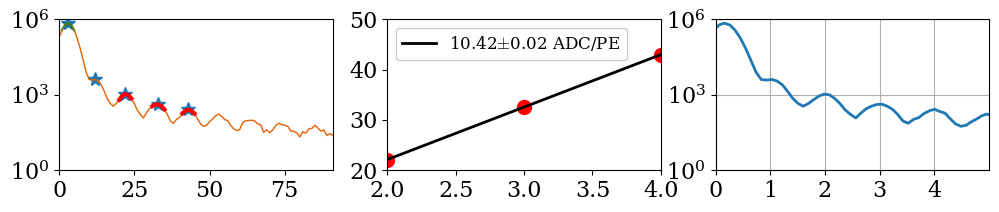

C:\Data\20220630\LXe_Full_E_field_-2kV_source_reposition_PDE\mca_keith_31.00OV_7.h5


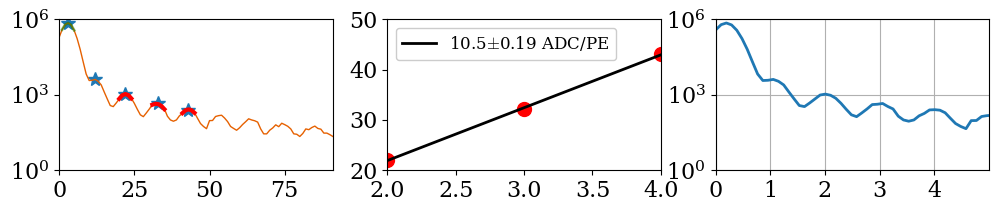

C:\Data\20220630\LXe_Full_E_field_-2kV_source_reposition_PDE\mca_keith_31.00OV_8.h5


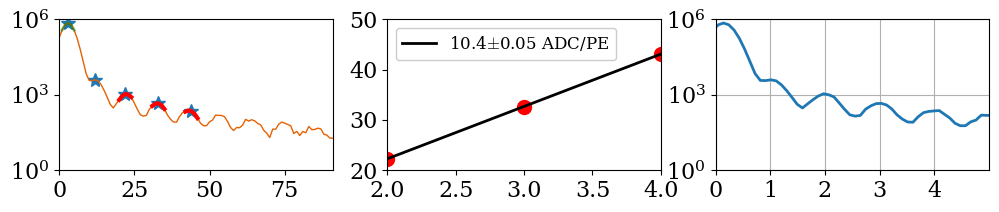

C:\Data\20220630\LXe_Full_E_field_-2kV_source_reposition_PDE\mca_keith_31.00OV_9.h5


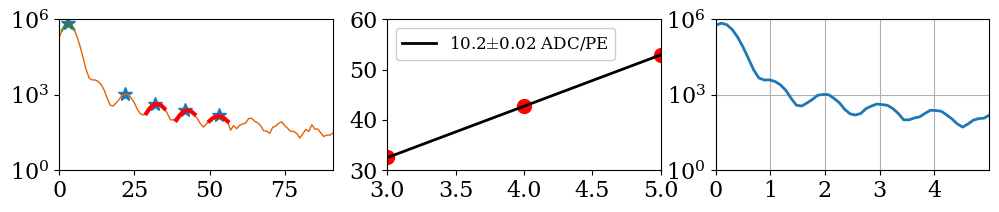

C:\Data\20220630\LXe_Full_E_field_-2kV_source_reposition_PDE\mca_keith_31.00OV_10.h5


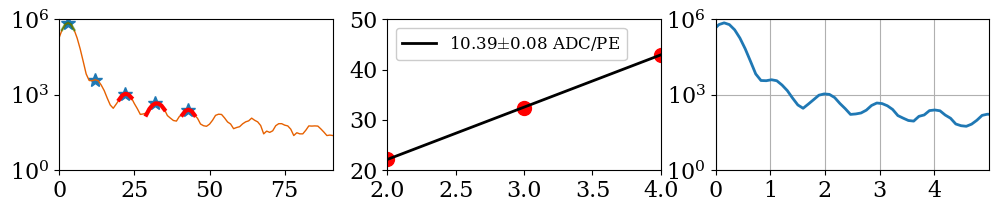

C:\Data\20220630\LXe_Full_E_field_-2kV_source_reposition_PDE\mca_keith_31.00OV_11.h5


c:\Users\nEXO\anaconda3\lib\site-packages\scipy\optimize\minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


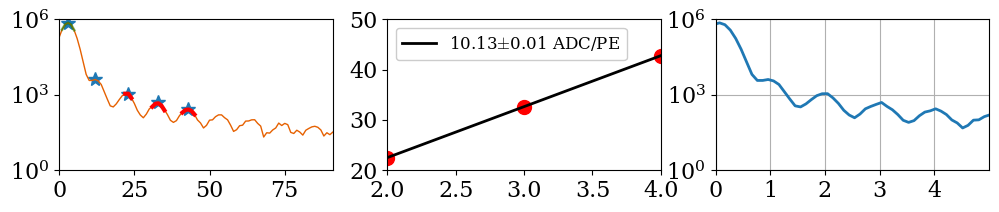

C:\Data\20220630\LXe_Full_E_field_-2kV_source_reposition_PDE\mca_keith_31.00OV_12.h5


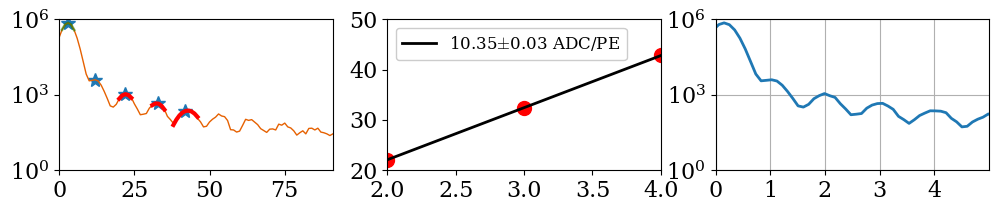

C:\Data\20220630\LXe_Full_E_field_-2kV_source_reposition_PDE\mca_keith_31.00OV_13.h5


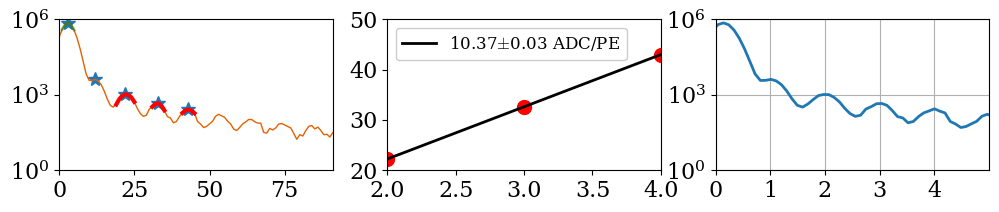

C:\Data\20220630\LXe_Full_E_field_-2kV_source_reposition_PDE\mca_keith_31.00OV_14.h5


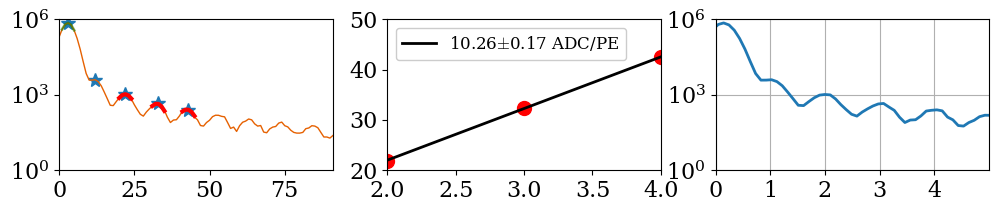

C:\Data\20220630\LXe_Full_E_field_-2kV_source_reposition_PDE\mca_keith_31.00OV_15.h5


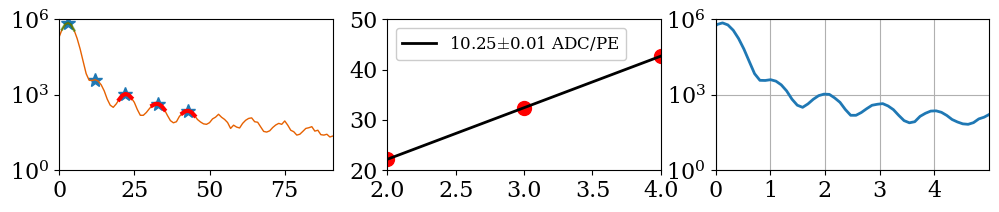

C:\Data\20220630\LXe_Full_E_field_-2kV_source_reposition_PDE\mca_keith_31.00OV_16.h5


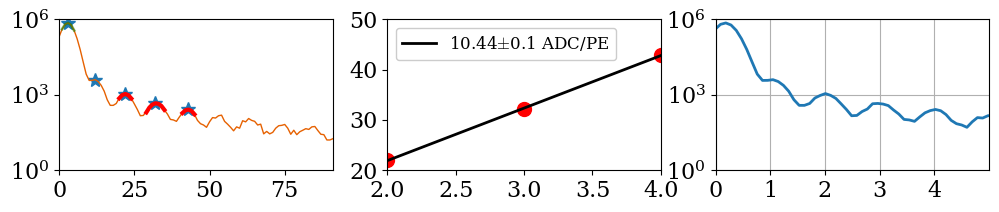

C:\Data\20220630\LXe_Full_E_field_-2kV_source_reposition_PDE\mca_keith_31.00OV_17.h5


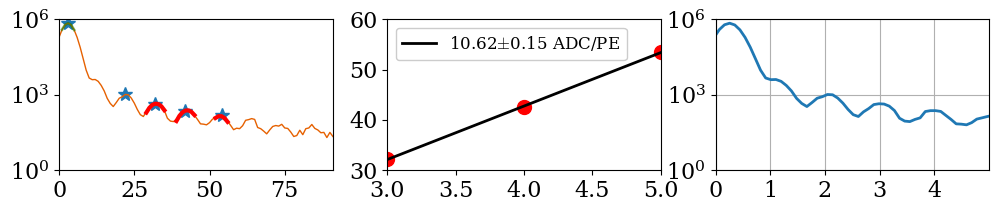

C:\Data\20220630\LXe_Full_E_field_-2kV_source_reposition_PDE\mca_keith_31.00OV_18.h5


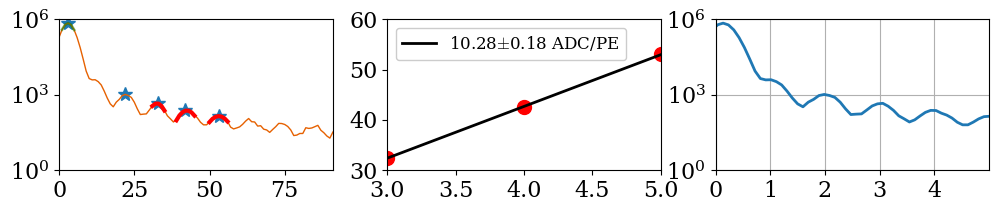

C:\Data\20220630\LXe_Full_E_field_-2kV_source_reposition_PDE\mca_keith_31.00OV_19.h5


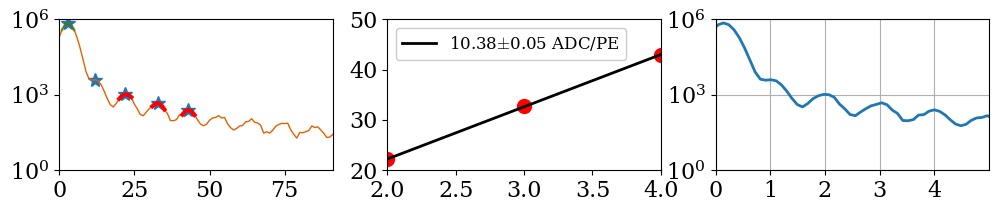

C:\Data\20220630\LXe_Full_E_field_-2kV_source_reposition_PDE\mca_keith_31.00OV_20.h5


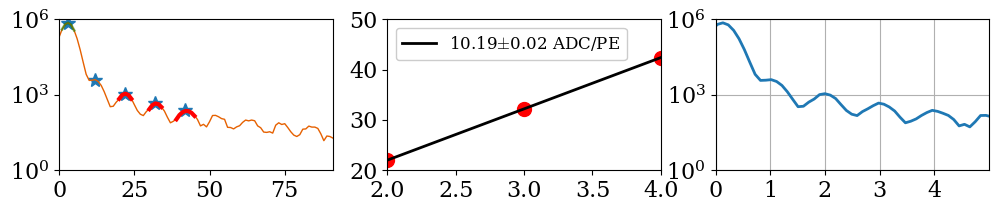

C:\Data\20220630\LXe_Full_E_field_-2kV_source_reposition_PDE\mca_keith_31.00OV_21.h5


c:\Users\nEXO\anaconda3\lib\site-packages\scipy\optimize\minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


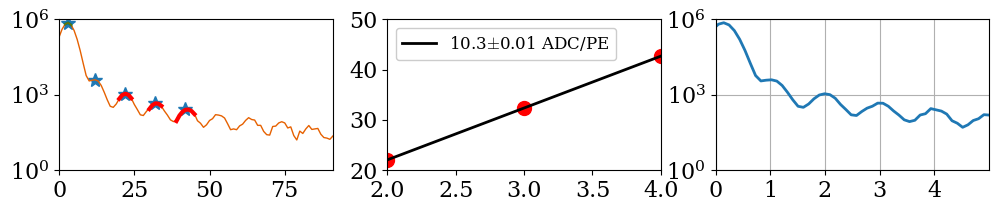

C:\Data\20220630\LXe_Full_E_field_-2kV_source_reposition_PDE\mca_keith_31.00OV_22.h5


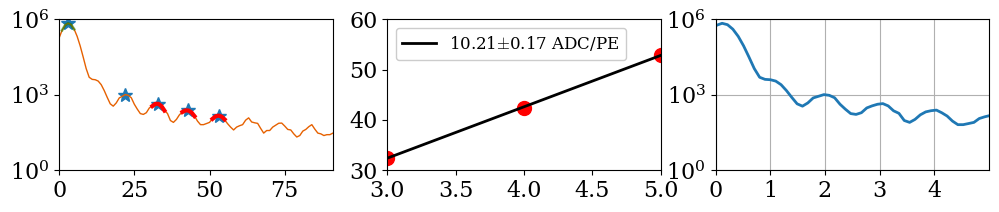

C:\Data\20220630\LXe_Full_E_field_-2kV_source_reposition_PDE\mca_keith_31.00OV_23.h5


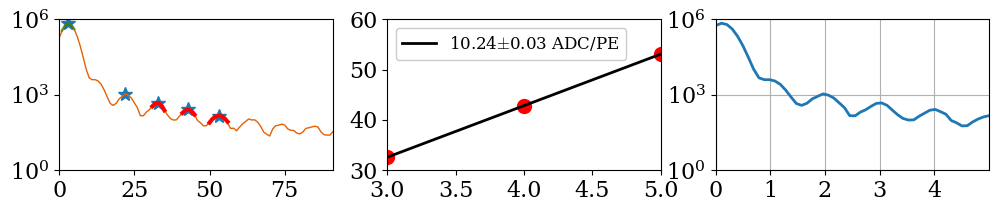

C:\Data\20220630\LXe_Full_E_field_-2kV_source_reposition_PDE\mca_keith_31.00OV_24.h5


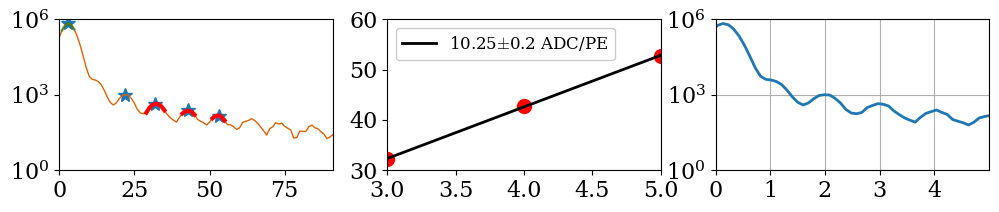

C:\Data\20220630\LXe_Full_E_field_-2kV_source_reposition_PDE\mca_keith_31.00OV_25.h5


c:\Users\nEXO\anaconda3\lib\site-packages\scipy\optimize\minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


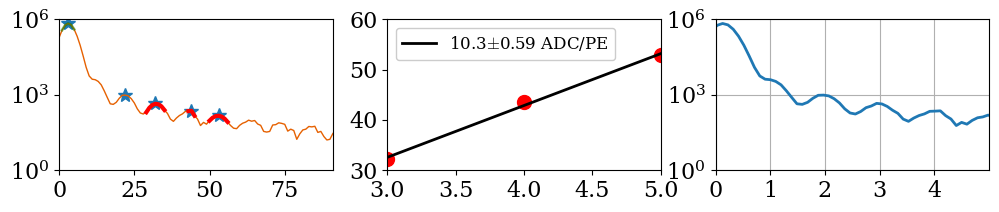

C:\Data\20220630\LXe_Full_E_field_-2kV_source_reposition_PDE\mca_keith_31.00OV_26.h5


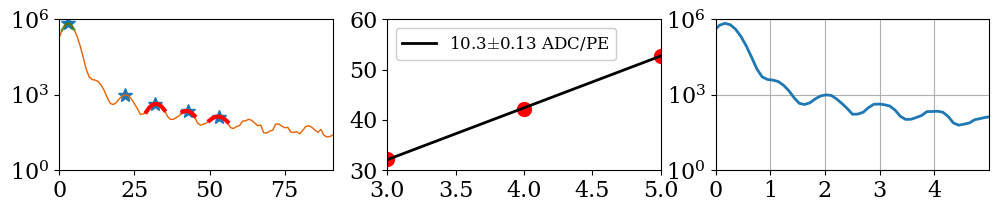

C:\Data\20220630\LXe_Full_E_field_-2kV_source_reposition_PDE\mca_keith_31.00OV_27.h5


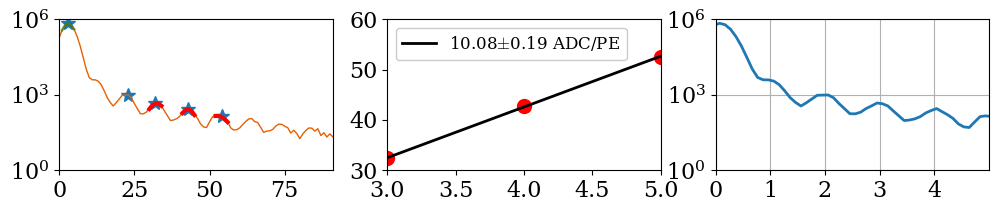

C:\Data\20220630\LXe_Full_E_field_-2kV_source_reposition_PDE\mca_keith_31.00OV_28.h5


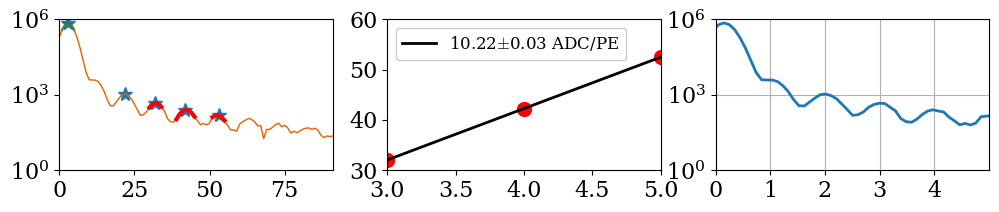

C:\Data\20220630\LXe_Full_E_field_-2kV_source_reposition_PDE\mca_keith_31.00OV_29.h5


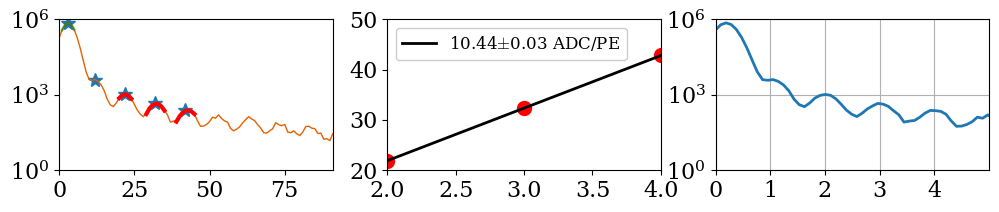

C:\Data\20220630\LXe_Full_E_field_-2kV_source_reposition_PDE\mca_keith_31.00OV_30.h5


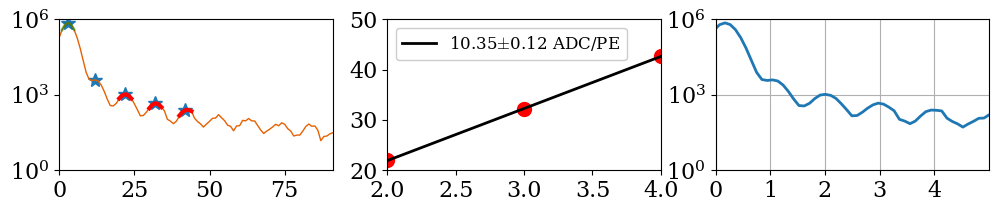

C:\Data\20220630\LXe_Full_E_field_-2kV_source_reposition_PDE\mca_keith_31.00OV_31.h5


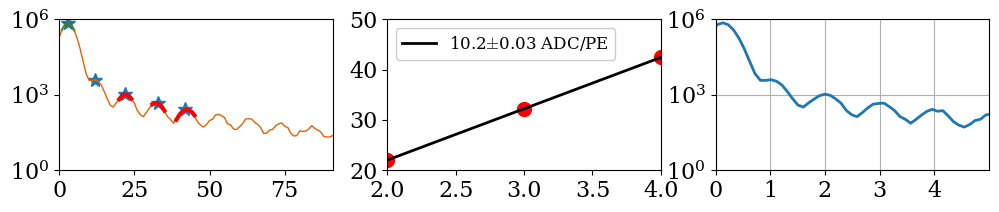

C:\Data\20220630\LXe_Full_E_field_-2kV_source_reposition_PDE\mca_keith_31.00OV_32.h5


c:\Users\nEXO\anaconda3\lib\site-packages\scipy\optimize\minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


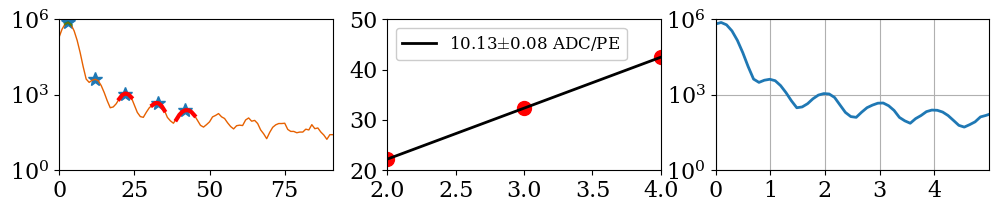

C:\Data\20220630\LXe_Full_E_field_-2kV_source_reposition_PDE\mca_keith_31.00OV_33.h5


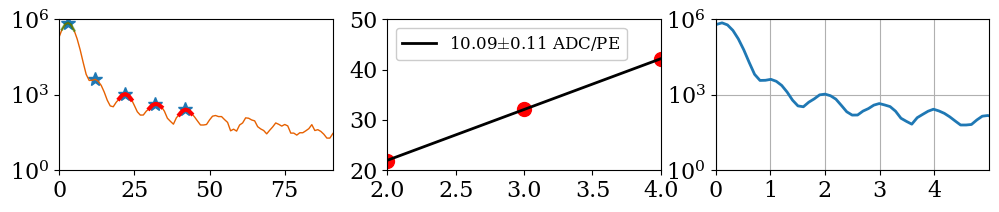

C:\Data\20220630\LXe_Full_E_field_-2kV_source_reposition_PDE\mca_keith_31.00OV_34.h5


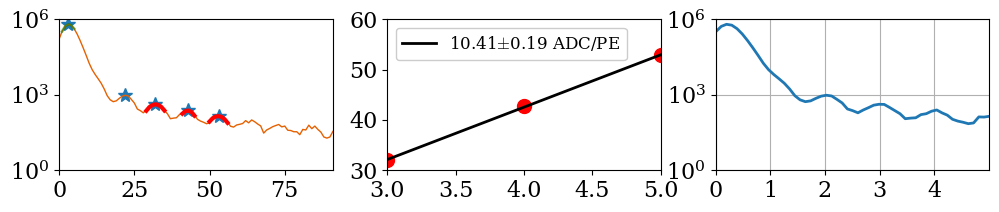

C:\Data\20220630\LXe_Full_E_field_-2kV_source_reposition_PDE\mca_keith_31.00OV_35.h5


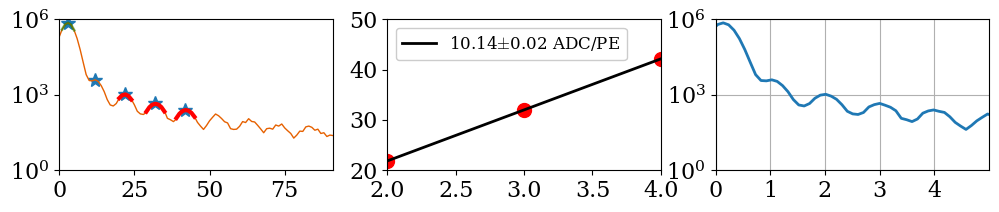

C:\Data\20220630\LXe_Full_E_field_-2kV_source_reposition_PDE\mca_keith_31.00OV_36.h5


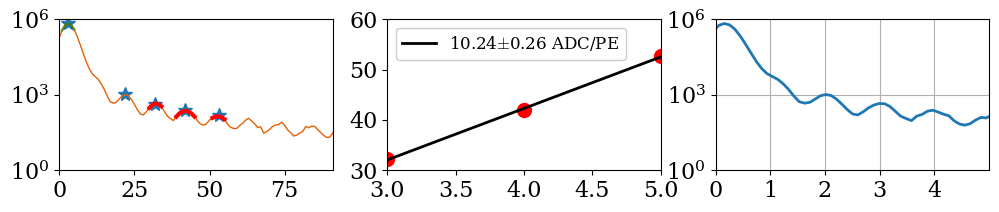

C:\Data\20220630\LXe_Full_E_field_-2kV_source_reposition_PDE\mca_keith_31.00OV_37.h5


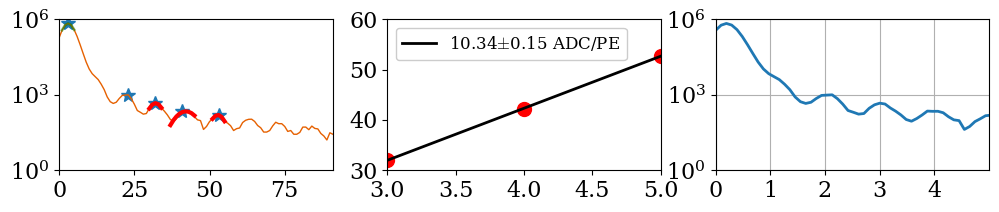

C:\Data\20220630\LXe_Full_E_field_-2kV_source_reposition_PDE\mca_keith_31.00OV_38.h5


c:\Users\nEXO\anaconda3\lib\site-packages\scipy\optimize\minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


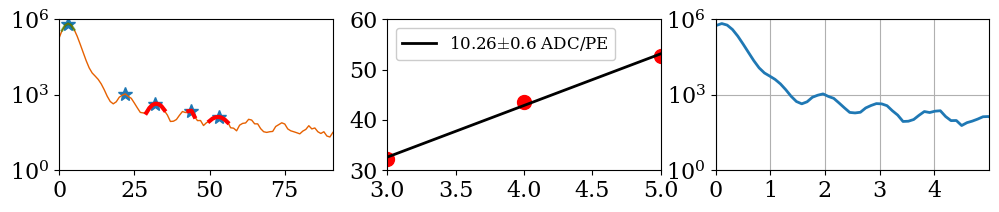

C:\Data\20220630\LXe_Full_E_field_-2kV_source_reposition_PDE\mca_keith_31.00OV_39.h5


c:\Users\nEXO\anaconda3\lib\site-packages\scipy\optimize\minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


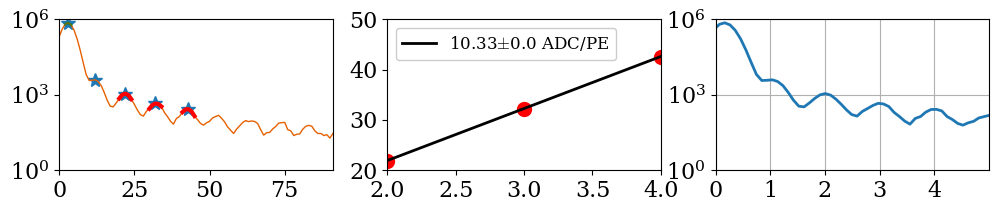

C:\Data\20220630\LXe_Full_E_field_-2kV_source_reposition_PDE\mca_keith_31.00OV_40.h5


c:\Users\nEXO\anaconda3\lib\site-packages\scipy\optimize\minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


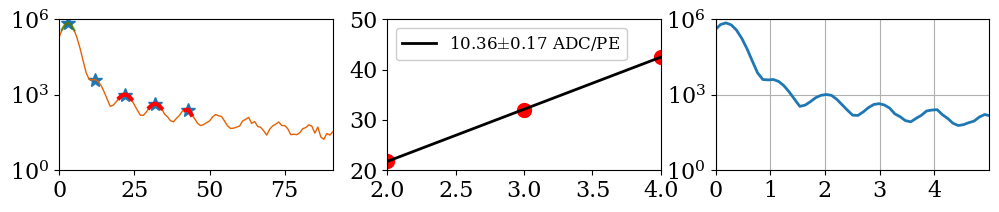

C:\Data\20220630\LXe_Full_E_field_-2kV_source_reposition_PDE\mca_keith_31.00OV_41.h5


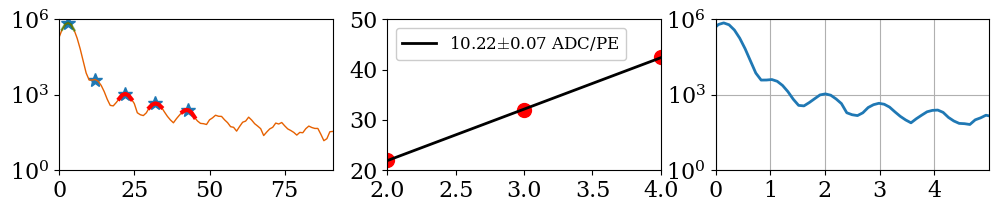

C:\Data\20220630\LXe_Full_E_field_-2kV_source_reposition_PDE\mca_keith_31.00OV_42.h5


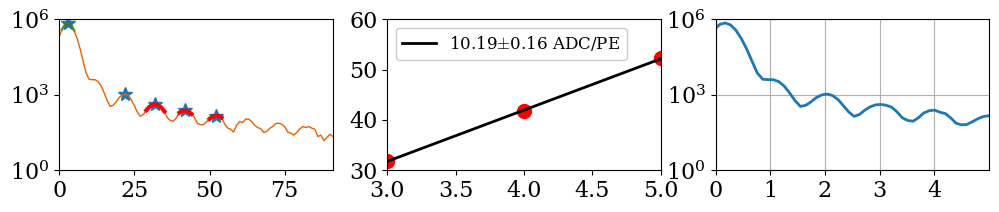

C:\Data\20220630\LXe_Full_E_field_-2kV_source_reposition_PDE\mca_keith_31.00OV_43.h5


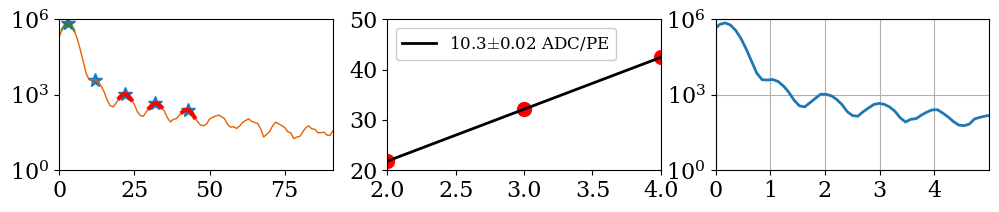

C:\Data\20220630\LXe_Full_E_field_-2kV_source_reposition_PDE\mca_keith_31.00OV_44.h5


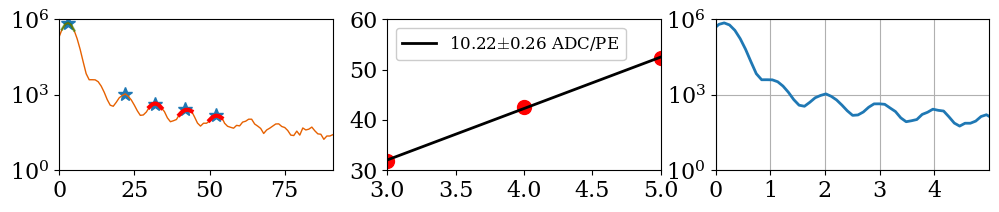

C:\Data\20220630\LXe_Full_E_field_-2kV_source_reposition_PDE\mca_keith_31.00OV_45.h5


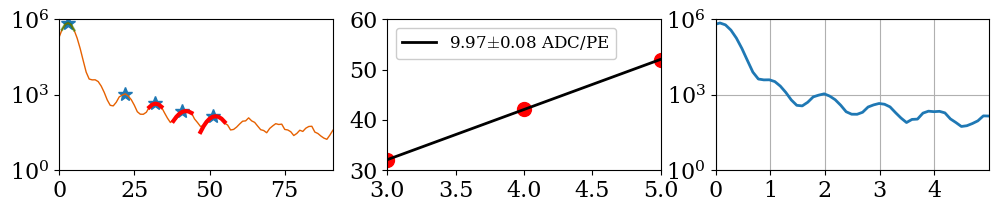

C:\Data\20220630\LXe_Full_E_field_-2kV_source_reposition_PDE\mca_keith_31.00OV_46.h5


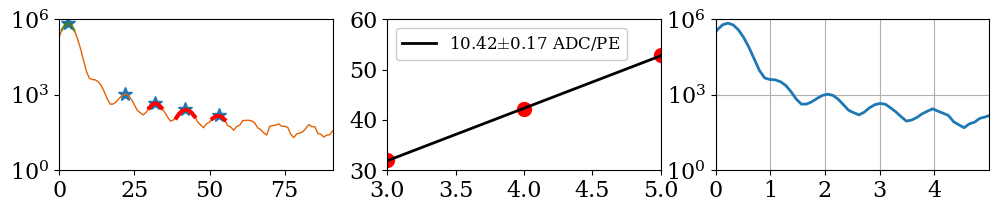

C:\Data\20220630\LXe_Full_E_field_-2kV_source_reposition_PDE\mca_keith_31.00OV_47.h5


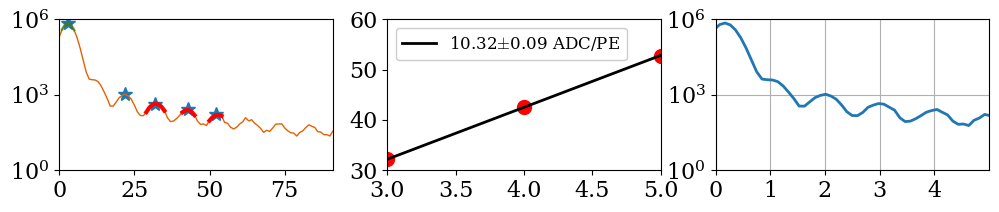

C:\Data\20220630\LXe_Full_E_field_-2kV_source_reposition_PDE\mca_keith_31.00OV_48.h5


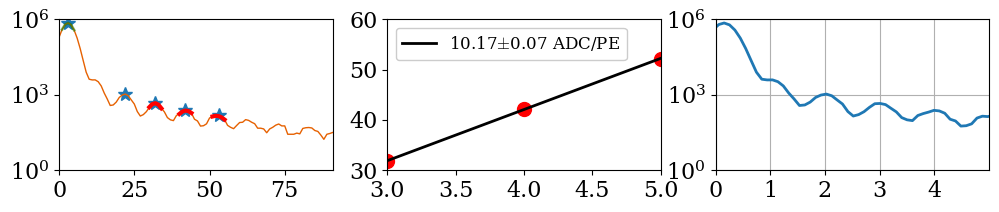

C:\Data\20220630\LXe_Full_E_field_-2kV_source_reposition_PDE\mca_keith_31.00OV_49.h5


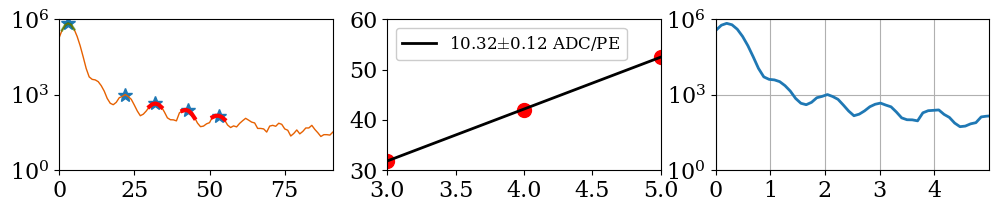

C:\Data\20220630\LXe_Full_E_field_-2kV_source_reposition_PDE\mca_keith_31.00OV_50.h5


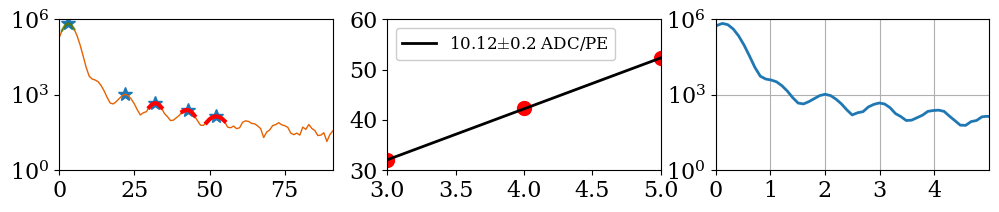

C:\Data\20220630\LXe_Full_E_field_-2kV_source_reposition_PDE\mca_keith_31.00OV_51.h5


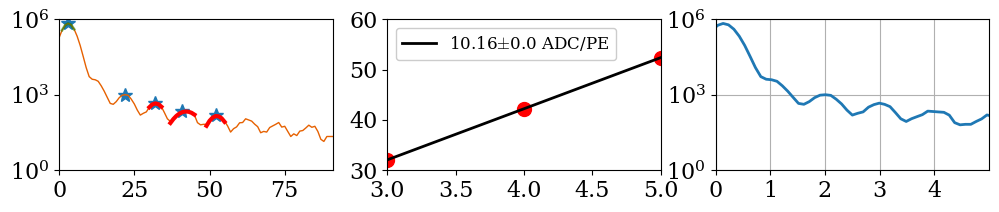

C:\Data\20220630\LXe_Full_E_field_-2kV_source_reposition_PDE\mca_keith_31.00OV_52.h5


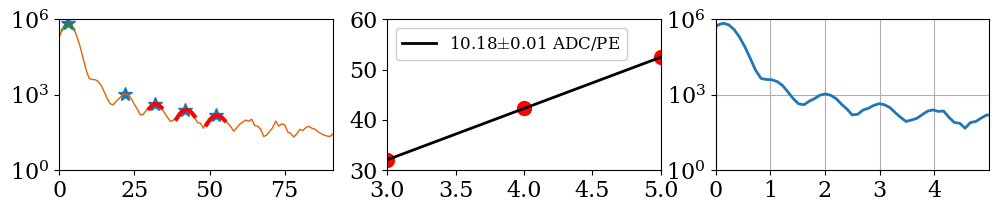

C:\Data\20220630\LXe_Full_E_field_-2kV_source_reposition_PDE\mca_keith_31.00OV_53.h5


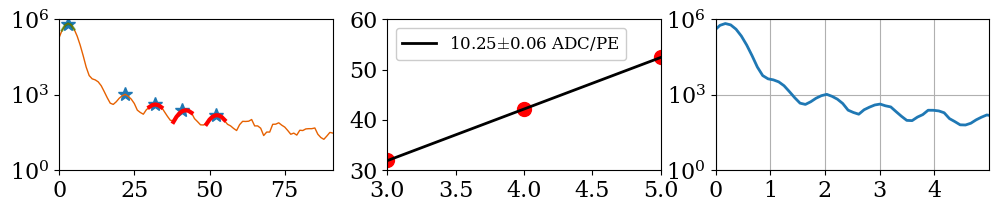

C:\Data\20220630\LXe_Full_E_field_-2kV_source_reposition_PDE\mca_keith_31.00OV_54.h5


c:\Users\nEXO\anaconda3\lib\site-packages\scipy\optimize\minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


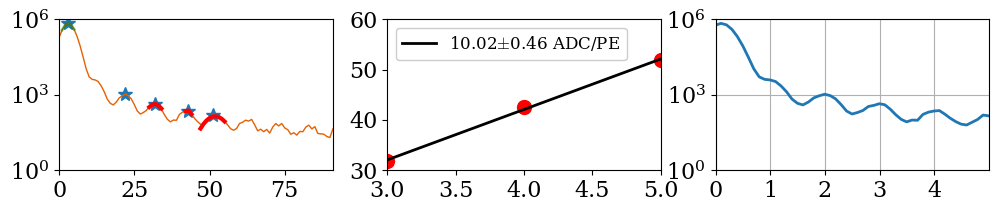

C:\Data\20220630\LXe_Full_E_field_-2kV_source_reposition_PDE\mca_keith_31.00OV_55.h5


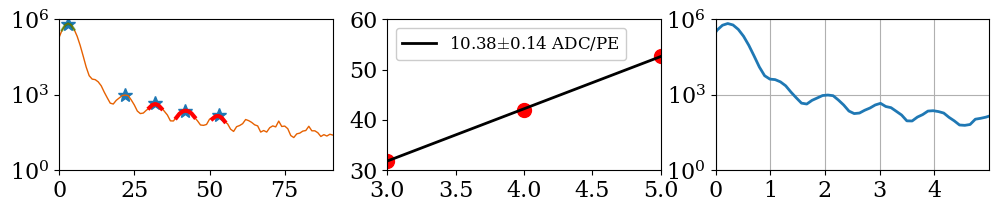

C:\Data\20220630\LXe_Full_E_field_-2kV_source_reposition_PDE\mca_keith_31.00OV_56.h5


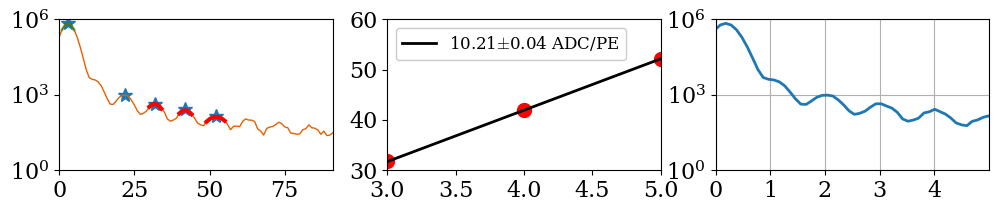

C:\Data\20220630\LXe_Full_E_field_-2kV_source_reposition_PDE\mca_keith_31.00OV_57.h5


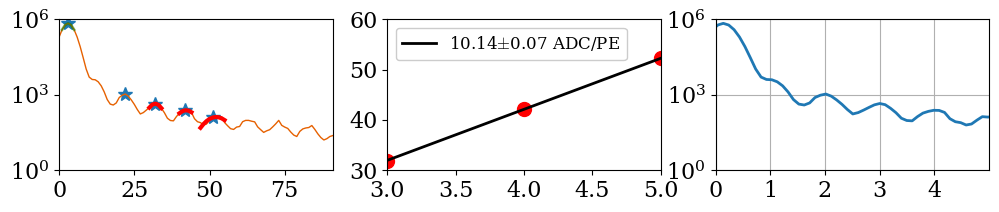

In [16]:
NEG_FIELD_calib_pe,NEG_FIELD_calib_count,NEG_FIELD_gain_list,NEG_FIELD_gain_err=gain_calculator(NEG_FIELD,11,4)

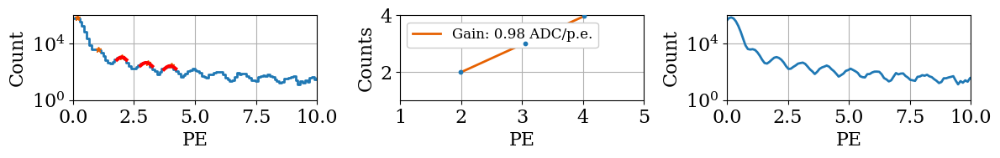

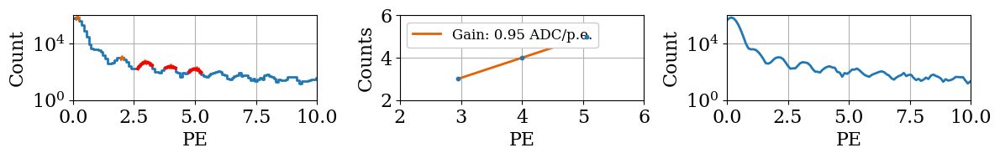

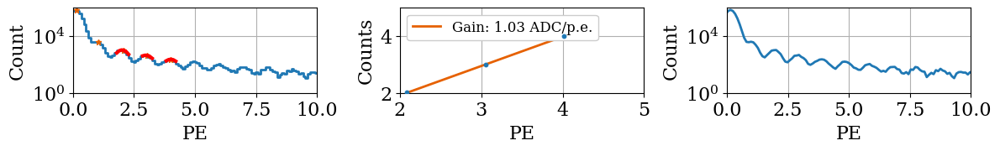

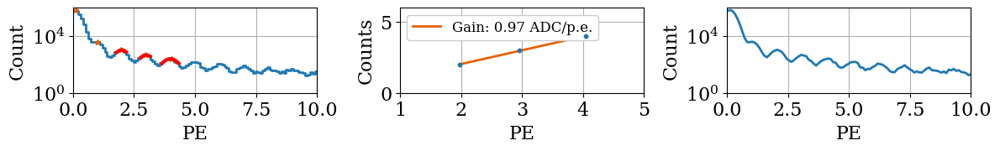

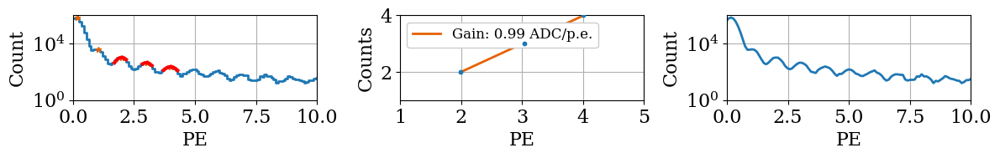

...

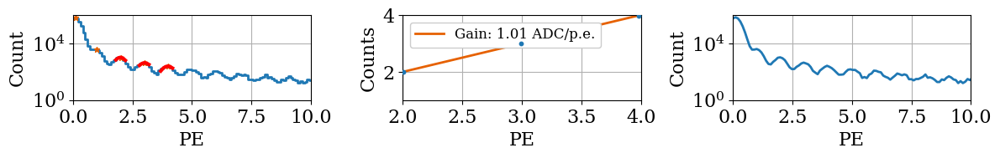

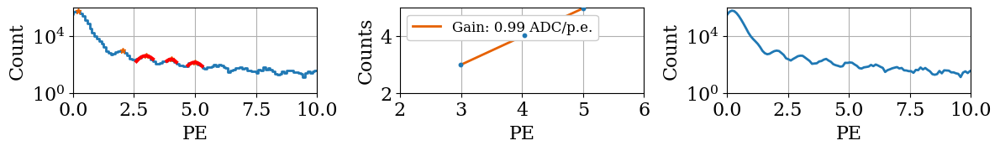

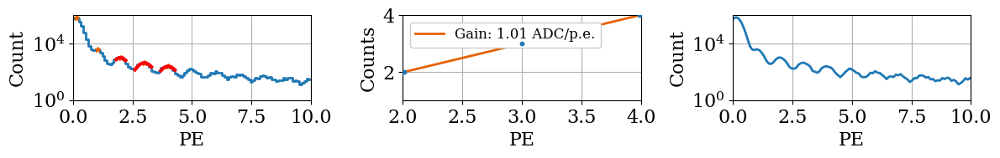

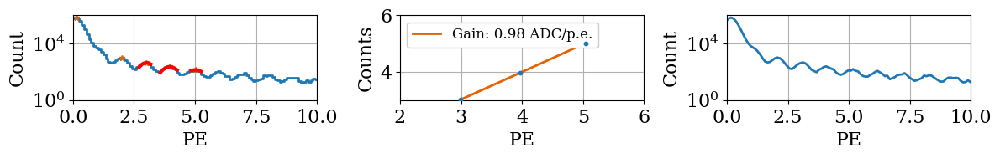

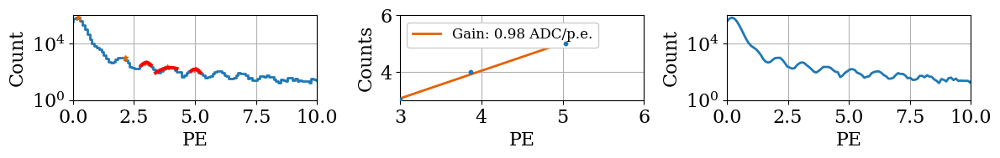

c:\Users\nEXO\anaconda3\lib\site-packages\scipy\optimize\minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


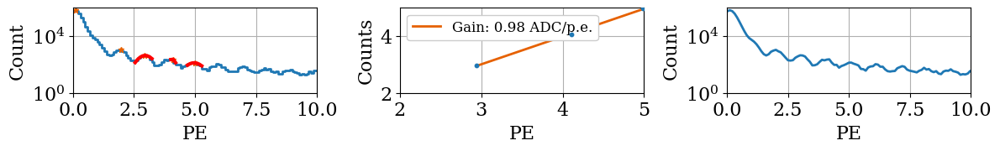

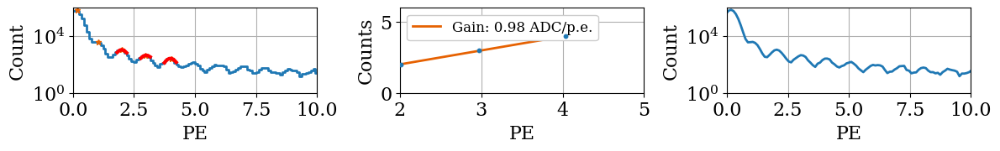

c:\Users\nEXO\anaconda3\lib\site-packages\scipy\optimize\minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


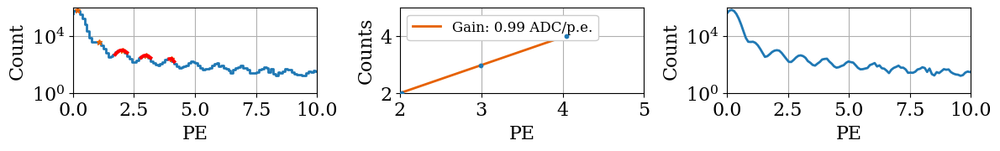

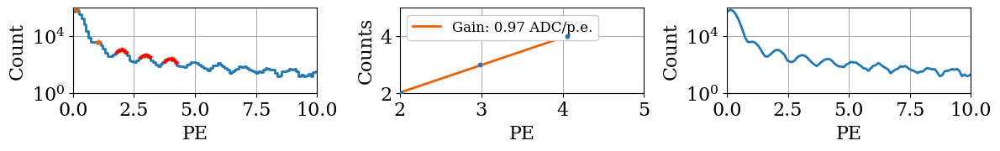

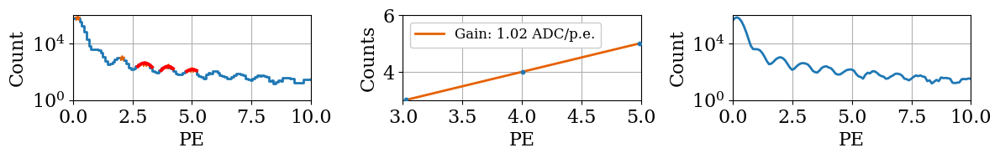

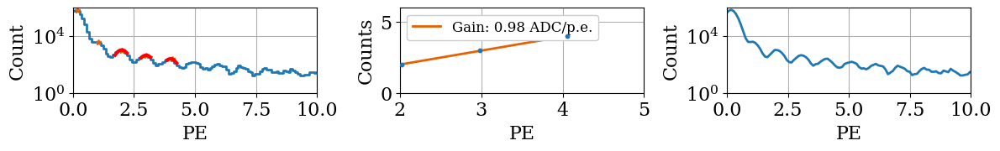

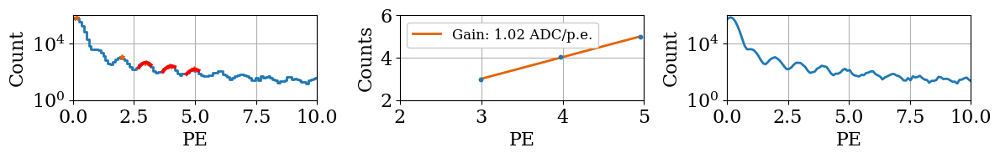

...

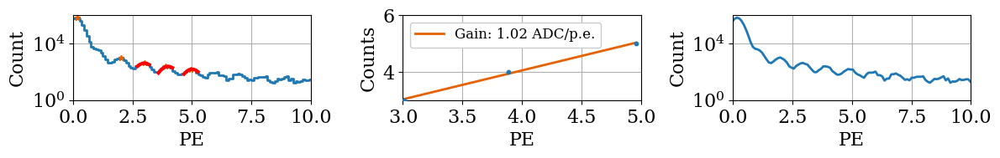

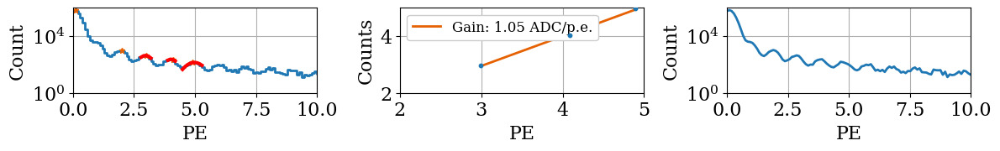

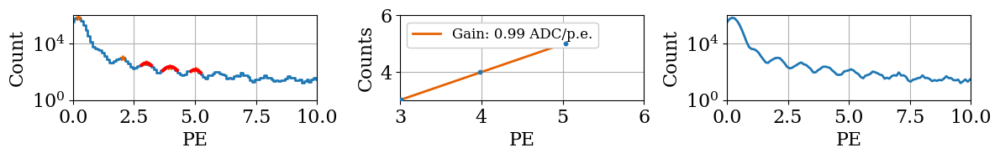

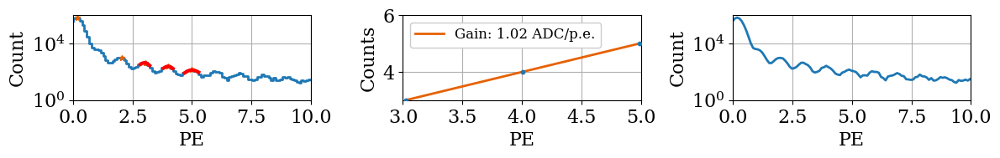

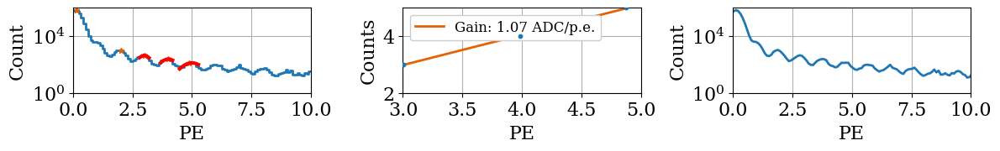

In [17]:
NEG_FIELD_pe_corrected_gain=[]
NEG_FIELD_pe_corrected_gain_err=[]
NEG_FIELD_calib_pe_updated=[]

for x,y in zip(NEG_FIELD_calib_pe,NEG_FIELD_calib_count):
    plt.figure(figsize=(12,2))
    plt.subplot(1,3,1)
    plt.step(x,y)
    plt.yscale('log')
    plt.xlim(0,10)
    plt.grid()
    plt.xlabel('PE')
    plt.ylabel('Count')
    
    
    N_peaks=4
    PROMINENCE=1E3 #This prominence is re-set here to ensure that every file starts out with a high prominence
    
    peaks,pdict=find_peaks(y,prominence=PROMINENCE,distance=5)
    peak_length=len(peaks)
    
#     We want to ensure that using a high prominence gives us at least N_peaks peaks to fit a straight line to. If it doesn't we reduce prominence till we get at least 3 peaks. N_peaks is set above
    while (peak_length<N_peaks+1):
        PROMINENCE=PROMINENCE-1
            
        peaks,pdict=find_peaks(y,prominence=PROMINENCE,distance=5)
        peak_length=len(peaks)


        
    plt.plot(x[peaks],y[peaks],'*',ms=5) # plot the peak markers
    first_pe_max=x[peaks[2]] # The x-value of the 3rd peak.Index=1 means the second peak will be used for getting fit parameters
    max_value=y[peaks[2]] # The height of the 3rd peak
    x_idx_array=(y<0.5*max_value) & (x>first_pe_max)# returns a boolean array where both conditions are true
    right_side_x= x[np.where(x_idx_array)[0][0]] #finding the first time where x_idx_array is True
    sigma_guess=np.abs(first_pe_max-right_side_x) #We need this to fit the width of the Gaussian peaks
    cut= (x < first_pe_max+sigma_guess) & (x > first_pe_max-sigma_guess) # This cut helps to fix the width of the peak-fit
    popt,pcov=curve_fit(gauss,x[cut],y[cut],p0=[max_value,first_pe_max,sigma_guess],maxfev=100000) # We use curve_fit to return the optimal parameters and the covariance matrix
    plt.plot(x[cut],gauss(x[cut],*popt),color='r',label='Fit',lw=2) # Here we plot the fit on the 2nd peak to see if everything looks ok.
    
    params_pe = []
    params_pe_count=[]
    for i,peak in enumerate(peaks[2:]): #here we ignore the first peak because it could be the pedestal
        new_first_pe_max=x[peak] #x-value of the peak
        new_max_value=y[peak] #height of the peak
        new_x_idx_array=(y<0.5*new_max_value) & (x>new_first_pe_max) # returns a boolean array where both conditions are true
        new_right_side_x= x[np.where(new_x_idx_array)[0][0]] #finding the first time where x_idx_array is True
        new_sigma_guess=np.abs(new_first_pe_max-new_right_side_x) #We need this to fit the width of the Gaussian peaks


        new_cut= (x < new_first_pe_max+new_sigma_guess) & (x > new_first_pe_max-new_sigma_guess) # This cut helps to fix the width of the peak-fit
        popt_new,pcov_new=curve_fit(gauss,x[new_cut],y[new_cut],p0=[new_max_value,new_first_pe_max,new_sigma_guess],maxfev=100000) # We use curve_fit to return the optimal parameters and the covariance matrix
        plt.plot(x[new_cut],gauss(x[new_cut],*popt_new),color='r',label='Fit',lw=3) # Here we plot the fit on all the peaks
        params_pe.append(popt_new[1]) #Here we append the value of the peak fit mean 
        params_pe_count.append((x[peak]))

    plt.subplot(1,3,2) 
    
    plt.scatter(params_pe_count, np.array(params_pe), s=10, zorder=10)
    popt_line,pcov_line = curve_fit(line, params_pe_count, np.array(params_pe), p0=[10,0])
    plt.plot(params_pe_count, line(params_pe_count, *popt_line), color=colors[1], label='Gain: {:.2f} ADC/p.e.'.format(popt_line[0]))
    NEG_FIELD_pe_corrected_gain.append(popt_line[0])
    NEG_FIELD_pe_corrected_gain_err.append(np.sqrt(np.diag(pcov_line)[0]))
    plt.legend(loc=2)
    plt.grid()
    plt.xlabel('PE')
    plt.ylabel('Counts')


    plt.subplot(1,3,3)
    plt.plot(x/popt_line[0],y)
    NEG_FIELD_calib_pe_updated.append(x/popt_line[0])
    plt.yscale('log')
    plt.xlim(0,10)
    plt.grid()
    plt.xlabel('PE')
    plt.ylabel('Count')


    plt.tight_layout()
    plt.show()

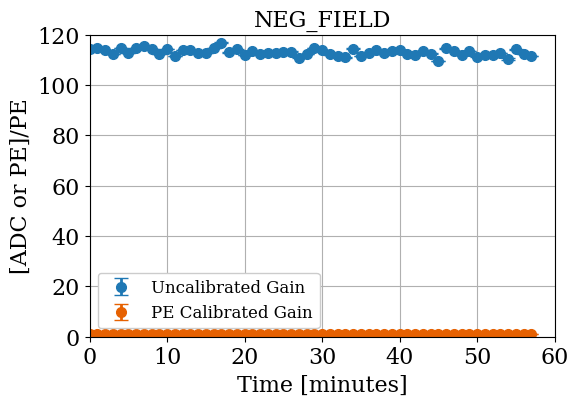

In [18]:
plt.figure(figsize=(6,4))
time_NEG_FIELD=np.arange(0,len(NEG_FIELD_gain_list))

plt.errorbar(time_NEG_FIELD,NEG_FIELD_gain_list*11,yerr=NEG_FIELD_gain_err,fmt='o',ms=7,label='Uncalibrated Gain')
plt.errorbar(time_NEG_FIELD,NEG_FIELD_pe_corrected_gain,yerr=NEG_FIELD_pe_corrected_gain_err,fmt='o',ms=7,label='PE Calibrated Gain')

plt.ylabel('[ADC or PE]/PE')
plt.xlabel('Time [minutes]')
plt.title('NEG_FIELD')
plt.grid()
plt.legend(loc='best')
plt.savefig('NEG_FIELD_gain_comparison.pdf')
plt.show()

### Plotting the mean gain for each E field

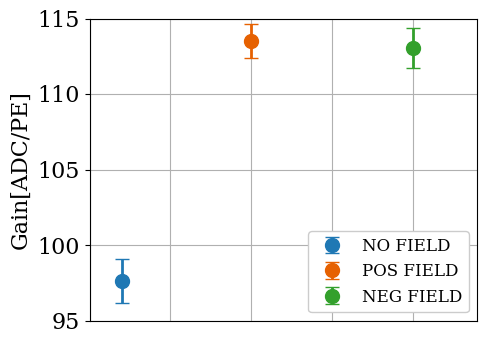

16.262338169118056 %
15.796706490142526 %


In [19]:
plt.figure(figsize=(5,4))
####### Not sure why the lists are being multiplied by 9, 10, 11 here
plt.errorbar(1,np.mean(NO_FIELD_gain_list*9),yerr=np.std(NO_FIELD_gain_list*9),label='NO FIELD',fmt='o')
plt.errorbar(5,np.mean(POS_FIELD_gain_list*10),yerr=np.std(POS_FIELD_gain_list*10),label='POS FIELD',fmt='o')
plt.errorbar(10,np.mean(NEG_FIELD_gain_list*11),yerr=np.std(NEG_FIELD_gain_list*11),label='NEG FIELD',fmt='o')
plt.legend(loc='best')
plt.xlim(0,12)
plt.xlabel('')
plt.ylabel('Gain[ADC/PE]')
plt.grid()
plt.tick_params(
    axis='x',          # changes apply to the x-axis
    which='both',      # both major and minor ticks are affected
    bottom=False,      # ticks along the bottom edge are off
    top=False,         # ticks along the top edge are off
    labelbottom=False) # labels along the bottom edge are off
plt.savefig('gain_comparison.pdf')
plt.show()

# printing the fractional change in gain
print((np.mean(POS_FIELD_gain_list*10)-np.mean(NO_FIELD_gain_list*9))/(np.mean(NO_FIELD_gain_list*9))*100,'%')
print((np.mean(NEG_FIELD_gain_list*11)-np.mean(NO_FIELD_gain_list*9))/(np.mean(NO_FIELD_gain_list*9))*100,'%')

In [20]:
frac_POS=(np.mean(POS_FIELD_gain_list*10)/np.mean(NO_FIELD_gain_list*9)) # the ratio of positive field gain to no field gain
frac_NEG=(np.mean(NEG_FIELD_gain_list*11)/np.mean(NO_FIELD_gain_list*9)) # the ratio of negitive field gain to no field gain

### Where we finally get to the PDE analysis

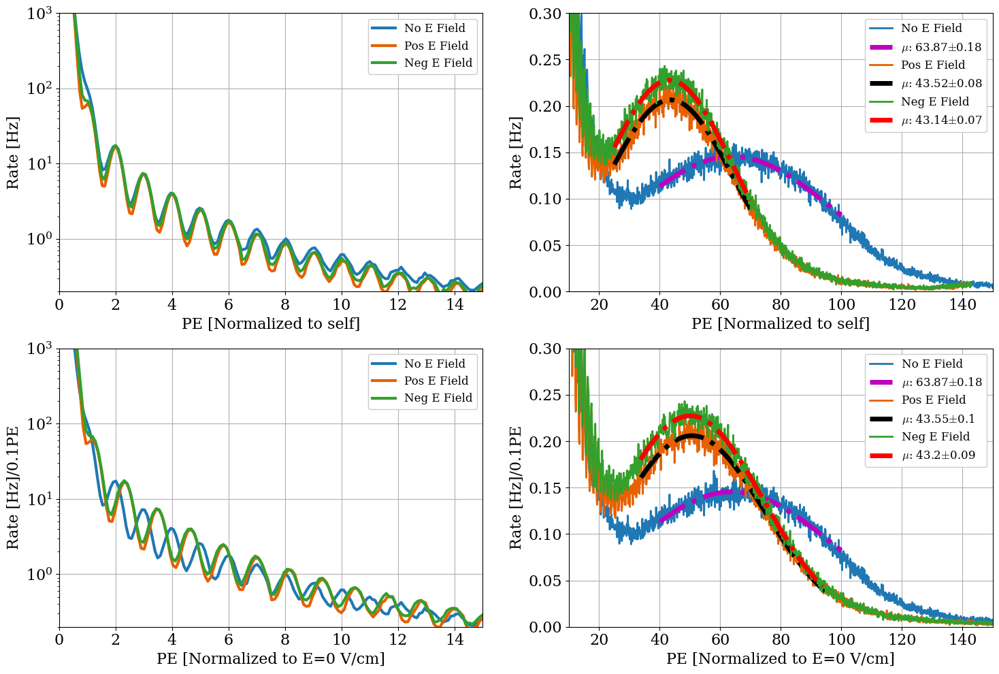

0.09266246537793786 0.08828224375539913 0.09765366644994719


In [21]:
correction_factor=0.99 ######?

avg_NO_FIELD=0
avg_POS_FIELD=0
avg_NEG_FIELD=0
plt.figure(figsize=(15,10))
n_bins=1


#--------- NO_FIELD  ------------
# iterating over calibrated data at each OV (I think)
for i in range(len(NO_FIELD_calib_pe)):
    # rebinning the calibrated data again (maybe to get rid of the single PE peaks and just see the hump from the source?)
    x_NO_FIELD,y_NO_FIELD=rebin_center(NO_FIELD_calib_pe[i]*correction_factor,NO_FIELD_calib_count[i],n_bins)
    avg_NO_FIELD+=y_NO_FIELD # summing the rebinned data
    
rate_NO_FIELD=avg_NO_FIELD/(60*len(time_NO_FIELD)) # average number of counts per second?
cut_NO_FIELD=np.where((x_NO_FIELD>40) & (x_NO_FIELD<100)) # selecting datapoints with PEs between 40 and 100
                                                          # I assume this is getting the only data that is in the source peak
# fitting the source peak
popt_NO_FIELD,pcov_NO_FIELD=curve_fit(gauss,x_NO_FIELD[cut_NO_FIELD],rate_NO_FIELD[cut_NO_FIELD],p0=[np.max(rate_NO_FIELD[cut_NO_FIELD]),65,80],maxfev=100000)

#--------- POS_FIELD  ------------
# iterating over calibrated data at each OV (I think)
for i in range(len(POS_FIELD_calib_pe_updated)):
    x_POS_FIELD,y_POS_FIELD=rebin_center(POS_FIELD_calib_pe[i]*correction_factor,POS_FIELD_calib_count[i],n_bins)
    avg_POS_FIELD+=y_POS_FIELD
    
rate_POS_FIELD=avg_POS_FIELD/(60*len(time_POS_FIELD))
cut_POS_FIELD=np.where((x_POS_FIELD>25) & (x_POS_FIELD<70)) # selecting datapoints with PEs between 25 and 70
cut_POS_FIELD_frac=np.where((x_POS_FIELD>25*frac_POS) & (x_POS_FIELD<70*frac_POS)) # doing the same but with the pos/zero data
# fitting the source peak for pos data and pos/zero data
popt_POS_FIELD,pcov_POS_FIELD=curve_fit(gauss,x_POS_FIELD[cut_POS_FIELD],rate_POS_FIELD[cut_POS_FIELD],p0=[np.max(rate_POS_FIELD[cut_POS_FIELD]),65,80],maxfev=100000)
popt_POS_FIELD_frac,pcov_POS_FIELD_frac=curve_fit(gauss,x_POS_FIELD[cut_POS_FIELD_frac],rate_POS_FIELD[cut_POS_FIELD_frac],p0=[np.max(rate_POS_FIELD[cut_POS_FIELD_frac]),65**frac_POS,80],maxfev=100000)


#--------- NEG_FIELD  ------------
# iterating over calibrated data at each OV (I think)
for i in range(len(NEG_FIELD_calib_pe)):
    x_NEG_FIELD,y_NEG_FIELD=rebin_center(NEG_FIELD_calib_pe[i]*correction_factor,NEG_FIELD_calib_count[i],n_bins)
    avg_NEG_FIELD+=y_NEG_FIELD
    
rate_NEG_FIELD=avg_NEG_FIELD/(60*len(time_NEG_FIELD))
cut_NEG_FIELD=np.where((x_NEG_FIELD>25) & (x_NEG_FIELD<70)) # selecting datapoints with PEs between 25 and 70
# fitting the source peak for neg data and neg/zero data
popt_NEG_FIELD,pcov_NEG_FIELD=curve_fit(gauss,x_NEG_FIELD[cut_NEG_FIELD],rate_NEG_FIELD[cut_NEG_FIELD],p0=[np.max(rate_NEG_FIELD[cut_NEG_FIELD]),65,80],maxfev=100000)
cut_NEG_FIELD_frac=np.where((x_NEG_FIELD>25*frac_NEG) & (x_NEG_FIELD<70*frac_NEG))
popt_NEG_FIELD_frac,pcov_NEG_FIELD_frac=curve_fit(gauss,x_NEG_FIELD[cut_NEG_FIELD_frac],
                                                  rate_NEG_FIELD[cut_NEG_FIELD_frac],
                                                  p0=[np.max(rate_NEG_FIELD[cut_NEG_FIELD_frac]),65**frac_NEG,80]
                                                  ,maxfev=100000)




# plotting the calibrated PEs on top of each other
plt.subplot(2,2,1)
plt.plot(x_NO_FIELD,rate_NO_FIELD,lw=3,label='No E Field')
plt.plot(x_POS_FIELD,rate_POS_FIELD,lw=3,label='Pos E Field')
plt.plot(x_NEG_FIELD,rate_NEG_FIELD,lw=3,label='Neg E Field')
plt.xlabel('PE [Normalized to self]')
plt.ylabel('Rate [Hz]')




###### Fitting peaks again??? I don't think that there are any plots of these fits either

N_peaks=10


#--------- NO_FIELD  ------------

PROMINENCE_NO_FIELD=1E3 #This prominence is re-set here to ensure that every file starts out with a high prominence
    
peaks_NO_FIELD,pdict_NO_FIELD=find_peaks(rate_NO_FIELD,prominence=PROMINENCE_NO_FIELD)
peak_length_NO_FIELD=len(peaks_NO_FIELD)
    
#     We want to ensure that using a high prominence gives us at least N_peaks peaks to fit a straight line to. If it doesn't we reduce prominence till we get at least 3 peaks. N_peaks is set above
while (peak_length_NO_FIELD<N_peaks+1):
    PROMINENCE_NO_FIELD=PROMINENCE_NO_FIELD-1
            
    peaks_NO_FIELD,pdict_NO_FIELD=find_peaks(rate_NO_FIELD,prominence=PROMINENCE_NO_FIELD)
    peak_length_NO_FIELD=len(peaks_NO_FIELD)
# plt.plot(x_NO_FIELD[peaks_NO_FIELD],rate_NO_FIELD[peaks_NO_FIELD],'*',ms=7) # plot the peak markers



#--------- POS_FIELD  ------------

PROMINENCE_POS_FIELD=1E3 #This prominence is re-set here to ensure that every file starts out with a high prominence
    
peaks_POS_FIELD,pdict_POS_FIELD=find_peaks(rate_POS_FIELD,prominence=PROMINENCE_POS_FIELD)
peak_length_POS_FIELD=len(peaks_POS_FIELD)
    
#     We want to ensure that using a high prominence gives us at least N_peaks peaks to fit a straight line to. If it doesn't we reduce prominence till we get at least 3 peaks. N_peaks is set above
while (peak_length_POS_FIELD<N_peaks+1):
    PROMINENCE_POS_FIELD=PROMINENCE_POS_FIELD-1
            
    peaks_POS_FIELD,pdict_POS_FIELD=find_peaks(rate_POS_FIELD,prominence=PROMINENCE_POS_FIELD)
    peak_length_POS_FIELD=len(peaks_POS_FIELD)
# plt.plot(x_POS_FIELD[peaks_POS_FIELD],rate_POS_FIELD[peaks_POS_FIELD],'*',ms=7) # plot the peak markers


#--------- NEG_FIELD  ------------


PROMINENCE_NEG_FIELD=1E3 #This prominence is re-set here to ensure that every file starts out with a high prominence
    
peaks_NEG_FIELD,pdict_NEG_FIELD=find_peaks(rate_NEG_FIELD,prominence=PROMINENCE_NEG_FIELD)
peak_length_NEG_FIELD=len(peaks_NEG_FIELD)
    
#     We want to ensure that using a high prominence gives us at least N_peaks peaks to fit a straight line to. If it doesn't we reduce prominence till we get at least 3 peaks. N_peaks is set above
while (peak_length_NEG_FIELD<N_peaks+1):
    PROMINENCE_NEG_FIELD=PROMINENCE_NEG_FIELD-1
            
    peaks_NEG_FIELD,pdict_NEG_FIELD=find_peaks(rate_NEG_FIELD,prominence=PROMINENCE_NEG_FIELD)
    peak_length_NEG_FIELD=len(peaks_NEG_FIELD)
# plt.plot(x_NEG_FIELD[peaks_NEG_FIELD],rate_NEG_FIELD[peaks_NEG_FIELD],'*',ms=7) # plot the peak markers




plt.grid()
plt.xlim(0,15)
plt.ylim(0.2,1E3)
plt.yscale('log')
plt.legend(loc='best')

# plotting the zoomed out versions with the fits of the source peak
plt.subplot(2,2,2)
plt.plot(x_NO_FIELD,rate_NO_FIELD,color=colors[0],label='No E Field')
plt.plot(x_NO_FIELD[cut_NO_FIELD],gauss(x_NO_FIELD[cut_NO_FIELD],*popt_NO_FIELD),'m-.',lw=5,label="$\mu$: "+str(np.round(popt_NO_FIELD[1],2))+'$\pm$'+str(np.round(np.sqrt(np.diag(pcov_NO_FIELD)[1]),2)))


plt.plot(x_POS_FIELD,rate_POS_FIELD,color=colors[1],label='Pos E Field')
plt.plot(x_POS_FIELD[cut_POS_FIELD],gauss(x_POS_FIELD[cut_POS_FIELD],*popt_POS_FIELD),'k-.',lw=5,label="$\mu$: "+str(np.round(popt_POS_FIELD[1],2))+'$\pm$'+str(np.round(np.sqrt(np.diag(pcov_POS_FIELD)[1]),2)))


plt.plot(x_NEG_FIELD,rate_NEG_FIELD,color=colors[2],label='Neg E Field')
plt.plot(x_NEG_FIELD[cut_NEG_FIELD],gauss(x_NEG_FIELD[cut_NEG_FIELD],*popt_NEG_FIELD),'r-.',lw=5,label="$\mu$: "+str(np.round(popt_NEG_FIELD[1],2))+'$\pm$'+str(np.round(np.sqrt(np.diag(pcov_NEG_FIELD)[1]),2)))

plt.xlim(10,150)
plt.ylim(0,0.3)
plt.legend(loc='best')
plt.grid()
plt.xlabel('PE [Normalized to self]')
plt.ylabel('Rate [Hz]')

# plotting the pos/zero and neg/zero data   ###### still not sure what this is for
plt.subplot(2,2,3)
plt.plot(x_NO_FIELD,rate_NO_FIELD,lw=3,label='No E Field')
plt.plot(x_POS_FIELD*frac_POS,rate_POS_FIELD,lw=3,label='Pos E Field')
plt.plot(x_NEG_FIELD*frac_NEG,rate_NEG_FIELD,lw=3,label='Neg E Field')
plt.grid()
plt.xlim(0,15)
plt.ylim(0.2,1E3)
plt.yscale('log')
plt.legend(loc='best')
plt.xlabel('PE [Normalized to E=0 V/cm]')
plt.ylabel('Rate [Hz]/'+str(np.round(x_NO_FIELD[1]-x_NO_FIELD[0],1))+'PE')

# plotting the zoomed out pos/zero and neg/zero data with the source peak fits
plt.subplot(2,2,4)
plt.plot(x_NO_FIELD,rate_NO_FIELD,color=colors[0],label='No E Field')
plt.plot(x_NO_FIELD[cut_NO_FIELD],gauss(x_NO_FIELD[cut_NO_FIELD],*popt_NO_FIELD),'m-.',lw=5,label="$\mu$: "+str(np.round(popt_NO_FIELD[1],2))+'$\pm$'+str(np.round(np.sqrt(np.diag(pcov_NO_FIELD)[1]),2)))


plt.plot(x_POS_FIELD*frac_POS,rate_POS_FIELD,color=colors[1],label='Pos E Field')
plt.plot(x_POS_FIELD[cut_POS_FIELD_frac]*frac_POS,gauss(x_POS_FIELD[cut_POS_FIELD_frac],*popt_POS_FIELD_frac),'k-.',lw=5,label="$\mu$: "+str(np.round(popt_POS_FIELD_frac[1],2))+'$\pm$'+str(np.round(np.sqrt(np.diag(pcov_POS_FIELD_frac)[1]),2)))


plt.plot(x_NEG_FIELD*frac_NEG,rate_NEG_FIELD,color=colors[2],label='Neg E Field')
plt.plot(x_NEG_FIELD[cut_NEG_FIELD_frac]*frac_NEG,gauss(x_NEG_FIELD[cut_NEG_FIELD_frac],*popt_NEG_FIELD_frac),'r-.',lw=5,label="$\mu$: "+str(np.round(popt_NEG_FIELD_frac[1],2))+'$\pm$'+str(np.round(np.sqrt(np.diag(pcov_NEG_FIELD_frac)[1]),2)))




plt.xlim(10,150)
plt.ylim(0,0.3)
# plt.yscale('log')
plt.legend(loc='best')
plt.grid()
plt.xlabel('PE [Normalized to E=0 V/cm]')
plt.ylabel('Rate [Hz]/'+str(np.round(x_NO_FIELD[1]-x_NO_FIELD[0],1))+'PE')
plt.tight_layout()

plt.savefig('Source_PDE.pdf')
plt.show()

print(x_NO_FIELD[1]-x_NO_FIELD[0],x_POS_FIELD[1]-x_POS_FIELD[0],x_NEG_FIELD[1]-x_NEG_FIELD[0])
